In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)

#Since the NaN values of GHI are gone which is used in data preparation, simulate these in solar activity instead
df['solar_activity'].loc[df['Year'] > 2020] = np.nan
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['GHI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

C:\Users\User\AppData\Local\Temp\ipykernel_30820\3453849465.py:375: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['solar_activity'].loc[df['Year'] > 2020] = np.nan


Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
(84, 1, 1, 1875)
(11, 1, 1, 1875)
(10, 1, 1, 1875)
(84, 1, 1875)
(11, 1, 1875)
(10, 1, 1875)
(84, 1875)
(11, 1875)
(10, 1875)
[[0.38166311 0.62313675 0.34639831 ... 0.51507767 0.37861712 0.40511727]
 [0.39415169 0.71548931 0.32450565 ... 0.45933597 0.43070362 0.37892172]
 [0.45872677 0.53175632 0.4180791  ... 0.49558331 0.47822114 0.3898873 ]
 ...
 [0.54249162 0.47861309 0.465

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-21 15:46:51,200] A new study created in memory with name: no-name-c1b0867d-f963-4095-8f4a-87918c4a0bf1
[I 2025-05-21 15:49:44,595] Trial 0 finished with value: 0.05199993997812271 and parameters: {'lr': 0.5367063289855805, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2600278418039466}. Best is trial 0 with value: 0.05199993997812271.


Cross Validation Accuracies:
[0.04781362786889076, 0.041120242327451706, 0.05805576965212822, 0.06360948830842972, 0.04940057173371315]
Mean Cross Validation Accuracy:
0.05199993997812271
Standard Deviation of Cross Validation Accuracy:
0.007925962790604847


[I 2025-05-21 15:51:53,567] Trial 1 finished with value: 0.05115852653980255 and parameters: {'lr': 0.008287484823659947, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10682135490186934}. Best is trial 1 with value: 0.05115852653980255.


Cross Validation Accuracies:
[0.042333416640758514, 0.04488983750343323, 0.05690058693289757, 0.06341332197189331, 0.048255469650030136]
Mean Cross Validation Accuracy:
0.05115852653980255
Standard Deviation of Cross Validation Accuracy:
0.00785821907190809


[I 2025-05-21 15:55:57,790] Trial 2 finished with value: 0.054520221799612044 and parameters: {'lr': 0.7005347317909746, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.21842290515861704}. Best is trial 1 with value: 0.05115852653980255.


Cross Validation Accuracies:
[0.04914763197302818, 0.0513019785284996, 0.055475588887929916, 0.06523526459932327, 0.05144064500927925]
Mean Cross Validation Accuracy:
0.054520221799612044
Standard Deviation of Cross Validation Accuracy:
0.005734639881935286


[I 2025-05-21 16:02:21,322] Trial 3 finished with value: 0.051155208796262744 and parameters: {'lr': 0.010660510865656678, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.48708154472616727}. Best is trial 3 with value: 0.051155208796262744.


Cross Validation Accuracies:
[0.04097555950284004, 0.04704228416085243, 0.055976901203393936, 0.06262435764074326, 0.04915694147348404]
Mean Cross Validation Accuracy:
0.051155208796262744
Standard Deviation of Cross Validation Accuracy:
0.007474283563964733


[I 2025-05-21 16:06:38,194] Trial 4 finished with value: 0.05177406817674637 and parameters: {'lr': 0.03246529364413676, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.4387455501946578}. Best is trial 3 with value: 0.051155208796262744.


Cross Validation Accuracies:
[0.043590474873781204, 0.0460018664598465, 0.05639667436480522, 0.06370604783296585, 0.04917527735233307]
Mean Cross Validation Accuracy:
0.05177406817674637
Standard Deviation of Cross Validation Accuracy:
0.007359128375620152


[I 2025-05-21 16:11:01,053] Trial 5 finished with value: 0.05109989047050476 and parameters: {'lr': 0.020320603449508427, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10577016642136275}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.041645295917987823, 0.04541497305035591, 0.05785540118813515, 0.06249860301613808, 0.048085179179906845]
Mean Cross Validation Accuracy:
0.05109989047050476
Standard Deviation of Cross Validation Accuracy:
0.00782769060638003


[I 2025-05-21 16:17:31,058] Trial 6 finished with value: 2.975352096557617 and parameters: {'lr': 0.03791672712479481, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2863994054596582}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[3.1636812686920166, 3.435154914855957, 2.684617757797241, 3.40975022315979, 2.183556318283081]
Mean Cross Validation Accuracy:
2.975352096557617
Standard Deviation of Cross Validation Accuracy:
0.47896873622715985


[I 2025-05-21 16:26:20,313] Trial 7 finished with value: 0.15967389643192292 and parameters: {'lr': 0.02483118345227777, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2552740628339979}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.13935695588588715, 0.15995657444000244, 0.2000197321176529, 0.15064182877540588, 0.1483943909406662]
Mean Cross Validation Accuracy:
0.15967389643192292
Standard Deviation of Cross Validation Accuracy:
0.021210610210300494


[I 2025-05-21 16:31:59,624] Trial 8 finished with value: 0.4980153560638428 and parameters: {'lr': 0.9675207239889425, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31792931573305283}. Best is trial 5 with value: 0.05109989047050476.


Cross Validation Accuracies:
[0.512074887752533, 0.48834484815597534, 0.5186828374862671, 0.48603466153144836, 0.4849395453929901]
Mean Cross Validation Accuracy:
0.4980153560638428
Standard Deviation of Cross Validation Accuracy:
0.014372528024159103


[I 2025-05-21 16:36:03,096] Trial 9 finished with value: 0.04514648094773292 and parameters: {'lr': 0.003286726221520146, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.2585695216538211}. Best is trial 9 with value: 0.04514648094773292.


Cross Validation Accuracies:
[0.03133869916200638, 0.04040450230240822, 0.04218244552612305, 0.06275535374879837, 0.04905140399932861]
Mean Cross Validation Accuracy:
0.04514648094773292
Standard Deviation of Cross Validation Accuracy:
0.010461811799669322


[I 2025-05-21 16:40:05,729] Trial 10 finished with value: 0.03817020021378994 and parameters: {'lr': 0.0010583716223997207, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.37323061819939696}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.02975851483643055, 0.03720781207084656, 0.041305962949991226, 0.04666930064558983, 0.03590941056609154]
Mean Cross Validation Accuracy:
0.03817020021378994
Standard Deviation of Cross Validation Accuracy:
0.0056366927846755975


[I 2025-05-21 16:44:41,651] Trial 11 finished with value: 0.0397310383617878 and parameters: {'lr': 0.0010763499915200688, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36825629732807896}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.03165171667933464, 0.03826012462377548, 0.040624383836984634, 0.05081460252404213, 0.037304364144802094]
Mean Cross Validation Accuracy:
0.0397310383617878
Standard Deviation of Cross Validation Accuracy:
0.006276483641426583


[I 2025-05-21 16:48:45,808] Trial 12 finished with value: 0.03894238919019699 and parameters: {'lr': 0.0010674553214811628, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3781063240374232}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.0327211394906044, 0.03663536533713341, 0.04005802422761917, 0.04858759418129921, 0.036709822714328766]
Mean Cross Validation Accuracy:
0.03894238919019699
Standard Deviation of Cross Validation Accuracy:
0.005353228573665859


[I 2025-05-21 16:52:40,021] Trial 13 finished with value: 0.041448541730642316 and parameters: {'lr': 0.0013000507115914826, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.38111157272962953}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.031001828610897064, 0.04167769476771355, 0.04360818490386009, 0.055822886526584625, 0.035132113844156265]
Mean Cross Validation Accuracy:
0.041448541730642316
Standard Deviation of Cross Validation Accuracy:
0.008489634082975485


[I 2025-05-21 16:57:02,128] Trial 14 finished with value: 0.6271363615989685 and parameters: {'lr': 0.11967417561455986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3919742246678335}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.8841409683227539, 0.8717362880706787, 0.28585466742515564, 0.4602387249469757, 0.6337111592292786]
Mean Cross Validation Accuracy:
0.6271363615989685
Standard Deviation of Cross Validation Accuracy:
0.23248730536064188


[I 2025-05-21 17:01:23,593] Trial 15 finished with value: 0.059423422813415526 and parameters: {'lr': 0.0023608506858124522, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.33273344324870985}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.05373198166489601, 0.05325426161289215, 0.06515631824731827, 0.06882456690073013, 0.056149985641241074]
Mean Cross Validation Accuracy:
0.059423422813415526
Standard Deviation of Cross Validation Accuracy:
0.006362610209525504


[I 2025-05-21 17:04:50,968] Trial 16 finished with value: 0.05152829214930534 and parameters: {'lr': 0.006051498953872824, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.44070552722454404}. Best is trial 10 with value: 0.03817020021378994.


Cross Validation Accuracies:
[0.043136343359947205, 0.045617666095495224, 0.05622965097427368, 0.06385859847068787, 0.04879920184612274]
Mean Cross Validation Accuracy:
0.05152829214930534
Standard Deviation of Cross Validation Accuracy:
0.007575585356846655


[I 2025-05-21 17:08:33,816] Trial 17 finished with value: 0.03508567549288273 and parameters: {'lr': 0.0025376029520190455, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.18406667272917732}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.02767619490623474, 0.02977210469543934, 0.03967413678765297, 0.043495792895555496, 0.0348101481795311]
Mean Cross Validation Accuracy:
0.03508567549288273
Standard Deviation of Cross Validation Accuracy:
0.005915985197143469


[I 2025-05-21 17:12:31,687] Trial 18 finished with value: 0.11583567783236504 and parameters: {'lr': 0.0030324731393012393, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.17304305708233164}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.05819198861718178, 0.05202613025903702, 0.19801336526870728, 0.0712188333272934, 0.1997280716896057]
Mean Cross Validation Accuracy:
0.11583567783236504
Standard Deviation of Cross Validation Accuracy:
0.06808262941591305


[I 2025-05-21 17:16:46,861] Trial 19 finished with value: 0.05256204828619957 and parameters: {'lr': 0.004682858155407816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18483959785921394}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.04288094490766525, 0.045588091015815735, 0.056240323930978775, 0.06342683732509613, 0.054674044251441956]
Mean Cross Validation Accuracy:
0.05256204828619957
Standard Deviation of Cross Validation Accuracy:
0.007461819110256037


[I 2025-05-21 17:21:57,534] Trial 20 finished with value: 0.6501985192298889 and parameters: {'lr': 0.13216439674729222, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.15260184359147128}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5217109322547913, 0.7289558053016663, 0.7323848605155945, 0.5640122890472412, 0.7039287090301514]
Mean Cross Validation Accuracy:
0.6501985192298889
Standard Deviation of Cross Validation Accuracy:
0.08919794210526844


[I 2025-05-21 17:27:32,587] Trial 21 finished with value: 0.04200686290860176 and parameters: {'lr': 0.0015365710028637065, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4239184994948487}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03192845731973648, 0.03748690336942673, 0.0445360504090786, 0.05622271075844765, 0.03986019268631935]
Mean Cross Validation Accuracy:
0.04200686290860176
Standard Deviation of Cross Validation Accuracy:
0.008186569562340755


[I 2025-05-21 17:33:27,168] Trial 22 finished with value: 0.04041237086057663 and parameters: {'lr': 0.001003142050135009, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3467361738877537}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03568063676357269, 0.03794915974140167, 0.03961888328194618, 0.051180433481931686, 0.037632741034030914]
Mean Cross Validation Accuracy:
0.04041237086057663
Standard Deviation of Cross Validation Accuracy:
0.00552745608231968


[I 2025-05-21 17:39:09,589] Trial 23 finished with value: 0.04637047126889229 and parameters: {'lr': 0.002010523652225059, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4785374882325337}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03889380395412445, 0.03864968195557594, 0.046957049518823624, 0.05979626998305321, 0.047555550932884216]
Mean Cross Validation Accuracy:
0.04637047126889229
Standard Deviation of Cross Validation Accuracy:
0.007713775997821071


[I 2025-05-21 17:44:28,861] Trial 24 finished with value: 0.04962418302893638 and parameters: {'lr': 0.004213482547322365, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.30005689058746954}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.043672896921634674, 0.04467921704053879, 0.05712553486227989, 0.0535152442753315, 0.04912802204489708]
Mean Cross Validation Accuracy:
0.04962418302893638
Standard Deviation of Cross Validation Accuracy:
0.005128885017823232


[I 2025-05-21 17:50:01,547] Trial 25 finished with value: 0.041553229093551636 and parameters: {'lr': 0.0019676269398779716, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3980556491546715}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03162789344787598, 0.04010188579559326, 0.04182058945298195, 0.05712100490927696, 0.03709477186203003]
Mean Cross Validation Accuracy:
0.041553229093551636
Standard Deviation of Cross Validation Accuracy:
0.008519667262794163


[I 2025-05-21 17:55:24,525] Trial 26 finished with value: 0.08846233189105987 and parameters: {'lr': 0.012463854652285168, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3488537090348909}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.09654068201780319, 0.07647063583135605, 0.08107995986938477, 0.09162872284650803, 0.09659165889024734]
Mean Cross Validation Accuracy:
0.08846233189105987
Standard Deviation of Cross Validation Accuracy:
0.008242231748348788


[I 2025-05-21 18:01:44,794] Trial 27 finished with value: 0.41895580291748047 and parameters: {'lr': 0.07308620098548559, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22365171635345713}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5994972586631775, 0.29174333810806274, 0.43263718485832214, 0.4031469523906708, 0.3677542805671692]
Mean Cross Validation Accuracy:
0.41895580291748047
Standard Deviation of Cross Validation Accuracy:
0.10182035582676231


[I 2025-05-21 18:09:12,788] Trial 28 finished with value: 0.4403856873512268 and parameters: {'lr': 0.006861412948722606, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4058613062907154}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.4584769010543823, 0.451722651720047, 0.4149291217327118, 0.4173416197299957, 0.4594581425189972]
Mean Cross Validation Accuracy:
0.4403856873512268
Standard Deviation of Cross Validation Accuracy:
0.01999321437939074


[I 2025-05-21 18:15:07,986] Trial 29 finished with value: 3.9579779624938967 and parameters: {'lr': 0.3705118144933907, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.28548922490580486}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[3.7542378902435303, 4.464481353759766, 5.017624855041504, 3.4032557010650635, 3.150290012359619]
Mean Cross Validation Accuracy:
3.9579779624938967
Standard Deviation of Cross Validation Accuracy:
0.6900701198294331


[I 2025-05-21 18:22:15,560] Trial 30 finished with value: 0.5041079044342041 and parameters: {'lr': 0.0016658304889657573, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4622656390699808}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.5057419538497925, 0.5073257684707642, 0.5050042867660522, 0.49208128452301025, 0.5103862285614014]
Mean Cross Validation Accuracy:
0.5041079044342041
Standard Deviation of Cross Validation Accuracy:
0.006291028661032987


[I 2025-05-21 18:28:17,845] Trial 31 finished with value: 0.038822729140520096 and parameters: {'lr': 0.001053450415927842, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3675357160426811}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.02919403836131096, 0.040230534970760345, 0.04021932929754257, 0.049056485295295715, 0.03541325777769089]
Mean Cross Validation Accuracy:
0.038822729140520096
Standard Deviation of Cross Validation Accuracy:
0.006526842351171676


[I 2025-05-21 18:34:53,921] Trial 32 finished with value: 0.038203117251396176 and parameters: {'lr': 0.0010095188925284665, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36209493175957647}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.03064456582069397, 0.03500598669052124, 0.03876829147338867, 0.04925745353102684, 0.037339288741350174]
Mean Cross Validation Accuracy:
0.038203117251396176
Standard Deviation of Cross Validation Accuracy:
0.006174420065609121


[I 2025-05-21 18:41:00,681] Trial 33 finished with value: 0.03933131359517574 and parameters: {'lr': 0.002768722236476756, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.35042707640338777}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.029886716976761818, 0.03459519147872925, 0.04004630446434021, 0.05217178910970688, 0.03995656594634056]
Mean Cross Validation Accuracy:
0.03933131359517574
Standard Deviation of Cross Validation Accuracy:
0.007448640437977239


[I 2025-05-21 18:46:42,898] Trial 34 finished with value: 0.038003386557102205 and parameters: {'lr': 0.0016443819888292957, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3161220368407825}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.028783150017261505, 0.03360815718770027, 0.0401422418653965, 0.05006469786167145, 0.03741868585348129]
Mean Cross Validation Accuracy:
0.038003386557102205
Standard Deviation of Cross Validation Accuracy:
0.007137543140165672


[I 2025-05-21 18:52:22,238] Trial 35 finished with value: 0.04591743536293506 and parameters: {'lr': 0.0038899559977332884, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31639152221706746}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.030107663944363594, 0.04556605964899063, 0.04619773477315903, 0.05880323797464371, 0.04891248047351837]
Mean Cross Validation Accuracy:
0.04591743536293506
Standard Deviation of Cross Validation Accuracy:
0.009221335143259327


[I 2025-05-21 18:57:40,842] Trial 36 finished with value: 0.05227598175406456 and parameters: {'lr': 0.01099396039247167, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.23173281604974877}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.04274599626660347, 0.04647019878029823, 0.05737115070223808, 0.06393977254629135, 0.05085279047489166]
Mean Cross Validation Accuracy:
0.05227598175406456
Standard Deviation of Cross Validation Accuracy:
0.007596814793083663


[I 2025-05-21 19:02:24,891] Trial 37 finished with value: 0.4341666638851166 and parameters: {'lr': 0.0018710587546656736, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27559881301936495}. Best is trial 17 with value: 0.03508567549288273.


Cross Validation Accuracies:
[0.4554091691970825, 0.4470885097980499, 0.4436272382736206, 0.377798855304718, 0.4469095468521118]
Mean Cross Validation Accuracy:
0.4341666638851166
Standard Deviation of Cross Validation Accuracy:
0.02845147276312389


[I 2025-05-21 19:08:04,174] Trial 38 finished with value: 0.03374846093356609 and parameters: {'lr': 0.002444996215470414, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13131063644327787}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.029605813324451447, 0.02719116397202015, 0.03304717689752579, 0.04206646606326103, 0.03683168441057205]
Mean Cross Validation Accuracy:
0.03374846093356609
Standard Deviation of Cross Validation Accuracy:
0.00527914667917458


[I 2025-05-21 19:13:36,799] Trial 39 finished with value: 0.11537515372037888 and parameters: {'lr': 0.018227869210686087, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13193855983099917}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.10020744800567627, 0.10276060551404953, 0.13792972266674042, 0.144145205616951, 0.09183278679847717]
Mean Cross Validation Accuracy:
0.11537515372037888
Standard Deviation of Cross Validation Accuracy:
0.02135347105212972


[I 2025-05-21 19:20:07,055] Trial 40 finished with value: 0.48830243945121765 and parameters: {'lr': 0.0062617409677038095, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12199425027577912}. Best is trial 38 with value: 0.03374846093356609.


Cross Validation Accuracies:
[0.40876856446266174, 0.5134032964706421, 0.4361172616481781, 0.44233158230781555, 0.6408914923667908]
Mean Cross Validation Accuracy:
0.48830243945121765
Standard Deviation of Cross Validation Accuracy:
0.08375645867908975


[I 2025-05-21 19:25:45,929] Trial 41 finished with value: 0.031514284759759904 and parameters: {'lr': 0.00152039778703965, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15123019069489207}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.026474719867110252, 0.034645963460206985, 0.02954523079097271, 0.03986732289195061, 0.02703818678855896]
Mean Cross Validation Accuracy:
0.031514284759759904
Standard Deviation of Cross Validation Accuracy:
0.005077213771502605


[I 2025-05-21 19:31:15,779] Trial 42 finished with value: 0.036035004258155826 and parameters: {'lr': 0.0025254616296883706, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1978956696669701}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.02672129124403, 0.032475437968969345, 0.03319913148880005, 0.049404583871364594, 0.03837457671761513]
Mean Cross Validation Accuracy:
0.036035004258155826
Standard Deviation of Cross Validation Accuracy:
0.00763776400483245


[I 2025-05-21 19:36:45,232] Trial 43 finished with value: 0.036643259972333905 and parameters: {'lr': 0.0024798064187342215, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20567546596658043}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.028662651777267456, 0.0378100723028183, 0.040867239236831665, 0.04568171873688698, 0.030194617807865143]
Mean Cross Validation Accuracy:
0.036643259972333905
Standard Deviation of Cross Validation Accuracy:
0.006421406101603135


[I 2025-05-21 19:42:29,125] Trial 44 finished with value: 0.04186854436993599 and parameters: {'lr': 0.0028512908184137966, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.19607594429356964}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.04250924289226532, 0.03151252493262291, 0.03856782242655754, 0.04756595194339752, 0.049187179654836655]
Mean Cross Validation Accuracy:
0.04186854436993599
Standard Deviation of Cross Validation Accuracy:
0.006396487692813161


[I 2025-05-21 19:49:13,045] Trial 45 finished with value: 0.05311012417078018 and parameters: {'lr': 0.008091924051074902, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15943009121258586}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.043063998222351074, 0.048161569982767105, 0.05979349836707115, 0.06468131393194199, 0.04985024034976959]
Mean Cross Validation Accuracy:
0.05311012417078018
Standard Deviation of Cross Validation Accuracy:
0.007932207773203533


[I 2025-05-21 19:55:55,520] Trial 46 finished with value: 0.06509028151631355 and parameters: {'lr': 0.004858414371056381, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20196860733573632}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.06013678014278412, 0.06722386181354523, 0.06210136041045189, 0.07765255123376846, 0.058336853981018066]
Mean Cross Validation Accuracy:
0.06509028151631355
Standard Deviation of Cross Validation Accuracy:
0.00694899120805215


[I 2025-05-21 20:02:48,911] Trial 47 finished with value: 0.043023969233036044 and parameters: {'lr': 0.0035893764175710186, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14210700064486576}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.04371040314435959, 0.04143354296684265, 0.04674939811229706, 0.05002523958683014, 0.03320126235485077]
Mean Cross Validation Accuracy:
0.043023969233036044
Standard Deviation of Cross Validation Accuracy:
0.005698821361280053


[I 2025-05-21 20:09:40,125] Trial 48 finished with value: 0.0330107145011425 and parameters: {'lr': 0.0025108525869140283, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10840325460642822}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.030580490827560425, 0.029423832893371582, 0.03434870392084122, 0.040605612099170685, 0.0300949327647686]
Mean Cross Validation Accuracy:
0.0330107145011425
Standard Deviation of Cross Validation Accuracy:
0.004165241292355957


[I 2025-05-21 20:16:13,599] Trial 49 finished with value: 0.050992104411125186 and parameters: {'lr': 0.014162496817388766, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10313853236602719}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.042069997638463974, 0.045350879430770874, 0.05615202337503433, 0.06260023266077042, 0.04878738895058632]
Mean Cross Validation Accuracy:
0.050992104411125186
Standard Deviation of Cross Validation Accuracy:
0.00745200085853458


[I 2025-05-21 20:24:24,860] Trial 50 finished with value: 4.723494625091552 and parameters: {'lr': 0.0521107102237265, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11918094604332355}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[4.81771183013916, 4.638731479644775, 4.991872787475586, 4.778892993927002, 4.39026403427124]
Mean Cross Validation Accuracy:
4.723494625091552
Standard Deviation of Cross Validation Accuracy:
0.20109704946902027


[I 2025-05-21 20:31:47,445] Trial 51 finished with value: 0.03439026065170765 and parameters: {'lr': 0.0023750450875939418, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16752180997031513}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.028641266748309135, 0.02750477008521557, 0.039616428315639496, 0.04540061950683594, 0.03078821860253811]
Mean Cross Validation Accuracy:
0.03439026065170765
Standard Deviation of Cross Validation Accuracy:
0.006956672318526711


[I 2025-05-21 20:38:17,456] Trial 52 finished with value: 0.0322361271828413 and parameters: {'lr': 0.001402938552975304, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1712023053947087}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.026081638410687447, 0.033987872302532196, 0.0317973718047142, 0.03751622885465622, 0.03179752454161644]
Mean Cross Validation Accuracy:
0.0322361271828413
Standard Deviation of Cross Validation Accuracy:
0.0037205025261208007


[I 2025-05-21 20:44:54,915] Trial 53 finished with value: 0.03448401764035225 and parameters: {'lr': 0.0015941178163232919, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1671811047732614}. Best is trial 41 with value: 0.031514284759759904.


Cross Validation Accuracies:
[0.03197616711258888, 0.028094761073589325, 0.03808991238474846, 0.043319977819919586, 0.030939269810914993]
Mean Cross Validation Accuracy:
0.03448401764035225
Standard Deviation of Cross Validation Accuracy:
0.005490971136736927


[I 2025-05-21 20:51:59,359] Trial 54 finished with value: 0.030120401829481124 and parameters: {'lr': 0.001388878826187802, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15313304309588235}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02618018537759781, 0.028687985613942146, 0.030987108126282692, 0.038287512958049774, 0.026459217071533203]
Mean Cross Validation Accuracy:
0.030120401829481124
Standard Deviation of Cross Validation Accuracy:
0.004436987259962924


[I 2025-05-21 20:58:35,087] Trial 55 finished with value: 0.03225643970072269 and parameters: {'lr': 0.0013592825407083863, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14372542833836444}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02633334882557392, 0.032268594950437546, 0.031320955604314804, 0.042584747076034546, 0.028774552047252655]
Mean Cross Validation Accuracy:
0.03225643970072269
Standard Deviation of Cross Validation Accuracy:
0.0055633759288817915


[I 2025-05-21 21:04:42,024] Trial 56 finished with value: 0.030828387290239335 and parameters: {'lr': 0.0013018495528727293, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14013868581009667}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.023663276806473732, 0.02556437812745571, 0.031247170642018318, 0.04791684448719025, 0.025750266388058662]
Mean Cross Validation Accuracy:
0.030828387290239335
Standard Deviation of Cross Validation Accuracy:
0.008910966967454796


[I 2025-05-21 21:10:25,399] Trial 57 finished with value: 0.03173478879034519 and parameters: {'lr': 0.0013512733312997381, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14627018018961405}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.026315174996852875, 0.025288863107562065, 0.03244899585843086, 0.040992069989442825, 0.03362883999943733]
Mean Cross Validation Accuracy:
0.03173478879034519
Standard Deviation of Cross Validation Accuracy:
0.005669514062007585


[I 2025-05-21 21:17:18,774] Trial 58 finished with value: 0.03274599239230156 and parameters: {'lr': 0.0013277053691459191, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.148533233581966}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02915218286216259, 0.02607862278819084, 0.036346014589071274, 0.04302007704973221, 0.029133064672350883]
Mean Cross Validation Accuracy:
0.03274599239230156
Standard Deviation of Cross Validation Accuracy:
0.0061471864531932275


[I 2025-05-21 21:22:43,104] Trial 59 finished with value: 0.03907153308391571 and parameters: {'lr': 0.001349920849102556, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1396644596841725}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02644713595509529, 0.03547630459070206, 0.05372735112905502, 0.049364615231752396, 0.030342258512973785]
Mean Cross Validation Accuracy:
0.03907153308391571
Standard Deviation of Cross Validation Accuracy:
0.010669975145180267


[I 2025-05-21 21:27:46,001] Trial 60 finished with value: 0.034249170869588855 and parameters: {'lr': 0.0013434203698688793, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.18334272566229393}. Best is trial 54 with value: 0.030120401829481124.


Cross Validation Accuracies:
[0.02974197082221508, 0.026468781754374504, 0.039749693125486374, 0.04276100918650627, 0.03252439945936203]
Mean Cross Validation Accuracy:
0.034249170869588855
Standard Deviation of Cross Validation Accuracy:
0.006107884741703881


[I 2025-05-21 21:32:29,711] Trial 61 finished with value: 0.02871493771672249 and parameters: {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023278212174773216, 0.02557617425918579, 0.029494179412722588, 0.03798072785139084, 0.02724539488554001]
Mean Cross Validation Accuracy:
0.02871493771672249
Standard Deviation of Cross Validation Accuracy:
0.005060266025300125


[I 2025-05-21 21:37:36,207] Trial 62 finished with value: 0.030507874116301535 and parameters: {'lr': 0.0012597557450634324, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15601806196950443}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.025590360164642334, 0.027263082563877106, 0.033361002802848816, 0.03919710963964462, 0.027127815410494804]
Mean Cross Validation Accuracy:
0.030507874116301535
Standard Deviation of Cross Validation Accuracy:
0.00509467505971233


[I 2025-05-21 21:43:10,191] Trial 63 finished with value: 0.03284641988575458 and parameters: {'lr': 0.0018709679517419338, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15865078975812688}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.028108807280659676, 0.028797926381230354, 0.039683423936367035, 0.0391971580684185, 0.02844478376209736]
Mean Cross Validation Accuracy:
0.03284641988575458
Standard Deviation of Cross Validation Accuracy:
0.005390476291943964


[I 2025-05-21 21:47:08,339] Trial 64 finished with value: 0.051043270528316496 and parameters: {'lr': 0.002026293521398254, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2375843830276696}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.038515426218509674, 0.04683062061667442, 0.05668039619922638, 0.06253603100776672, 0.05065387859940529]
Mean Cross Validation Accuracy:
0.051043270528316496
Standard Deviation of Cross Validation Accuracy:
0.008230500078011816


[I 2025-05-21 21:52:30,445] Trial 65 finished with value: 0.029548521712422372 and parameters: {'lr': 0.001222819848233763, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1841425278250464}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.024557262659072876, 0.028300948441028595, 0.029578281566500664, 0.038868725299835205, 0.026437390595674515]
Mean Cross Validation Accuracy:
0.029548521712422372
Standard Deviation of Cross Validation Accuracy:
0.004960147646803955


[I 2025-05-21 21:59:43,468] Trial 66 finished with value: 0.06061236783862114 and parameters: {'lr': 0.0011519207816884762, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.18180968790605878}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.0584496408700943, 0.056963756680488586, 0.06191358342766762, 0.06825724989175797, 0.05747760832309723]
Mean Cross Validation Accuracy:
0.06061236783862114
Standard Deviation of Cross Validation Accuracy:
0.0041941352424394104


[I 2025-05-21 22:07:42,454] Trial 67 finished with value: 0.04082373157143593 and parameters: {'lr': 0.0032558338062201203, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11760077975245738}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03348293900489807, 0.032879479229450226, 0.04433732107281685, 0.054072678089141846, 0.03934624046087265]
Mean Cross Validation Accuracy:
0.04082373157143593
Standard Deviation of Cross Validation Accuracy:
0.007836596911582505


[I 2025-05-21 22:11:46,257] Trial 68 finished with value: 0.050201470404863356 and parameters: {'lr': 0.3121468381249421, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15254207286709806}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03929493948817253, 0.04596487432718277, 0.05455705150961876, 0.06201735511422157, 0.049173131585121155]
Mean Cross Validation Accuracy:
0.050201470404863356
Standard Deviation of Cross Validation Accuracy:
0.007701231874385912


[I 2025-05-21 22:15:40,991] Trial 69 finished with value: 0.03281532004475594 and parameters: {'lr': 0.001760736183629806, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.21517271933072904}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027970094233751297, 0.03181303292512894, 0.03225080668926239, 0.04082223027944565, 0.031220436096191406]
Mean Cross Validation Accuracy:
0.03281532004475594
Standard Deviation of Cross Validation Accuracy:
0.004276768272284435


[I 2025-05-21 22:19:26,999] Trial 70 finished with value: 0.030499214306473732 and parameters: {'lr': 0.0011874279806505339, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1277086854995138}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.029596984386444092, 0.028336765244603157, 0.03001958690583706, 0.03723113611340523, 0.027311598882079124]
Mean Cross Validation Accuracy:
0.030499214306473732
Standard Deviation of Cross Validation Accuracy:
0.003498568579453641


[I 2025-05-21 22:23:17,841] Trial 71 finished with value: 0.03233265094459057 and parameters: {'lr': 0.0011951318039143933, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13023991393034387}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02480226755142212, 0.03147304058074951, 0.03546464443206787, 0.039378877729177475, 0.030544424429535866]
Mean Cross Validation Accuracy:
0.03233265094459057
Standard Deviation of Cross Validation Accuracy:
0.004901062195081898


[I 2025-05-21 22:27:09,471] Trial 72 finished with value: 0.031151299923658372 and parameters: {'lr': 0.0020941801917703233, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11224512877206946}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027814092114567757, 0.02948089689016342, 0.03192497789859772, 0.03774929419159889, 0.028787238523364067]
Mean Cross Validation Accuracy:
0.031151299923658372
Standard Deviation of Cross Validation Accuracy:
0.00356785914880081


[I 2025-05-21 22:29:39,724] Trial 73 finished with value: 0.03635205551981926 and parameters: {'lr': 0.0010151400421388509, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.11178982865502833}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.0263363104313612, 0.0352933369576931, 0.03905607387423515, 0.050682369619607925, 0.03039218671619892]
Mean Cross Validation Accuracy:
0.03635205551981926
Standard Deviation of Cross Validation Accuracy:
0.008362125187854449


[I 2025-05-21 22:33:30,500] Trial 74 finished with value: 0.0315429400652647 and parameters: {'lr': 0.0019445187331174148, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12847604887609995}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.025083569809794426, 0.027383653447031975, 0.03171957656741142, 0.04809950292110443, 0.025428397580981255]
Mean Cross Validation Accuracy:
0.0315429400652647
Standard Deviation of Cross Validation Accuracy:
0.00860885280528403


[I 2025-05-21 22:37:15,587] Trial 75 finished with value: 0.03269367143511772 and parameters: {'lr': 0.0016507629950458175, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15812335868995508}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027469396591186523, 0.03130987286567688, 0.032380297780036926, 0.039576612412929535, 0.03273217752575874]
Mean Cross Validation Accuracy:
0.03269367143511772
Standard Deviation of Cross Validation Accuracy:
0.003916184581872388


[I 2025-05-21 22:41:00,154] Trial 76 finished with value: 0.07003968879580498 and parameters: {'lr': 0.004509844095985281, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10323132675133004}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.07619284093379974, 0.06907538324594498, 0.06945093721151352, 0.07968336343765259, 0.05579591915011406]
Mean Cross Validation Accuracy:
0.07003968879580498
Standard Deviation of Cross Validation Accuracy:
0.008185636556458228


[I 2025-05-21 22:45:24,063] Trial 77 finished with value: 0.05202709510922432 and parameters: {'lr': 0.0021971972149984736, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1773853004615619}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.04487472027540207, 0.045318447053432465, 0.05824068933725357, 0.06254696846008301, 0.049154650419950485]
Mean Cross Validation Accuracy:
0.05202709510922432
Standard Deviation of Cross Validation Accuracy:
0.007123059055512826


[I 2025-05-21 22:49:15,169] Trial 78 finished with value: 0.03389032036066055 and parameters: {'lr': 0.0011779354644720565, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12294269469178372}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027729542925953865, 0.03552057966589928, 0.032496701925992966, 0.043101754039525986, 0.03060302324593067]
Mean Cross Validation Accuracy:
0.03389032036066055
Standard Deviation of Cross Validation Accuracy:
0.005257602668220597


[I 2025-05-21 22:51:45,193] Trial 79 finished with value: 0.062118486315011975 and parameters: {'lr': 0.0015687909165690696, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13644420883545003}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.058187175542116165, 0.05821514502167702, 0.06321349740028381, 0.07145357131958008, 0.05952304229140282]
Mean Cross Validation Accuracy:
0.062118486315011975
Standard Deviation of Cross Validation Accuracy:
0.0050153857009089435


[I 2025-05-21 22:55:28,558] Trial 80 finished with value: 0.03434886895120144 and parameters: {'lr': 0.002112139895286163, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.19456982165748707}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.026264848187565804, 0.03250301256775856, 0.03867868706583977, 0.04024678096175194, 0.034051015973091125]
Mean Cross Validation Accuracy:
0.03434886895120144
Standard Deviation of Cross Validation Accuracy:
0.004947322202602214


[I 2025-05-21 22:59:15,807] Trial 81 finished with value: 0.037111996114253996 and parameters: {'lr': 0.0031622261018946062, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12544471965808687}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.03226664289832115, 0.029865799471735954, 0.038748081773519516, 0.054026518017053604, 0.030652938410639763]
Mean Cross Validation Accuracy:
0.037111996114253996
Standard Deviation of Cross Validation Accuracy:
0.009016452378541694


[I 2025-05-21 23:04:07,028] Trial 82 finished with value: 0.03296422362327576 and parameters: {'lr': 0.0018729792202505265, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16269839182266466}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027270197868347168, 0.03129046410322189, 0.03580957651138306, 0.04048769548535347, 0.029963184148073196]
Mean Cross Validation Accuracy:
0.03296422362327576
Standard Deviation of Cross Validation Accuracy:
0.004667511115740823


[I 2025-05-21 23:09:47,492] Trial 83 finished with value: 0.03100132681429386 and parameters: {'lr': 0.001532745868953075, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11622140527223689}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02664574235677719, 0.026034152135252953, 0.034398578107357025, 0.041764382272958755, 0.026163779199123383]
Mean Cross Validation Accuracy:
0.03100132681429386
Standard Deviation of Cross Validation Accuracy:
0.0062358718130221865


[I 2025-05-21 23:15:40,673] Trial 84 finished with value: 0.029147764667868614 and parameters: {'lr': 0.001018984858573717, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10060387812842395}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.020852701738476753, 0.027057163417339325, 0.029801689088344574, 0.0368637777864933, 0.031163491308689117]
Mean Cross Validation Accuracy:
0.029147764667868614
Standard Deviation of Cross Validation Accuracy:
0.005238440838193791


[I 2025-05-21 23:21:41,625] Trial 85 finished with value: 0.030529095232486723 and parameters: {'lr': 0.0011749981539883093, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11182042206018412}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.024155618622899055, 0.02977869100868702, 0.028968097642064095, 0.04166474565863609, 0.028078323230147362]
Mean Cross Validation Accuracy:
0.030529095232486723
Standard Deviation of Cross Validation Accuracy:
0.005892877359833885


[I 2025-05-21 23:27:44,993] Trial 86 finished with value: 0.4928761005401611 and parameters: {'lr': 0.0010086340687041754, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11400333705426843}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.49295979738235474, 0.4987201392650604, 0.49448907375335693, 0.4794238805770874, 0.49878761172294617]
Mean Cross Validation Accuracy:
0.4928761005401611
Standard Deviation of Cross Validation Accuracy:
0.007108722286953048


[I 2025-05-21 23:33:33,667] Trial 87 finished with value: 0.030339252576231955 and parameters: {'lr': 0.0011979613669086144, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10248389036081577}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02222360484302044, 0.032383546233177185, 0.02935478277504444, 0.038884878158569336, 0.02884945087134838]
Mean Cross Validation Accuracy:
0.030339252576231955
Standard Deviation of Cross Validation Accuracy:
0.00540849851970454


[I 2025-05-21 23:39:09,464] Trial 88 finished with value: 0.029694798961281778 and parameters: {'lr': 0.00118722640647267, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10212397881829748}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023982621729373932, 0.02734283357858658, 0.031076274812221527, 0.03982261195778847, 0.026249652728438377]
Mean Cross Validation Accuracy:
0.029694798961281778
Standard Deviation of Cross Validation Accuracy:
0.005558971381015332


[I 2025-05-21 23:43:39,713] Trial 89 finished with value: 0.17927946150302887 and parameters: {'lr': 0.028956104140429848, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10250136412870217}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.17706754803657532, 0.1419592946767807, 0.21086658537387848, 0.1729004681110382, 0.19360341131687164]
Mean Cross Validation Accuracy:
0.17927946150302887
Standard Deviation of Cross Validation Accuracy:
0.022983911340409478


[I 2025-05-21 23:49:42,869] Trial 90 finished with value: 0.031169069930911064 and parameters: {'lr': 0.0011929800460707368, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1323727850683514}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.022919107228517532, 0.02533070556819439, 0.03384276106953621, 0.04010814055800438, 0.03364463523030281]
Mean Cross Validation Accuracy:
0.031169069930911064
Standard Deviation of Cross Validation Accuracy:
0.006250318624761495


[I 2025-05-21 23:55:37,876] Trial 91 finished with value: 0.031129783764481545 and parameters: {'lr': 0.001207260785489512, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1001908714504679}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02145661599934101, 0.03255533054471016, 0.0341925323009491, 0.040676016360521317, 0.02676842361688614]
Mean Cross Validation Accuracy:
0.031129783764481545
Standard Deviation of Cross Validation Accuracy:
0.006559493973585674


[I 2025-05-22 00:01:35,789] Trial 92 finished with value: 0.03476814217865467 and parameters: {'lr': 0.0010717519706836265, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.13857130798295242}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.033121366053819656, 0.031821854412555695, 0.03535496070981026, 0.042667366564273834, 0.03087516315281391]
Mean Cross Validation Accuracy:
0.03476814217865467
Standard Deviation of Cross Validation Accuracy:
0.004225869633211494


[I 2025-05-22 00:07:05,432] Trial 93 finished with value: 0.031066696718335153 and parameters: {'lr': 0.0014759573554631426, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12188029832829114}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.023922892287373543, 0.027662105858325958, 0.03434906154870987, 0.042687371373176575, 0.026712052524089813]
Mean Cross Validation Accuracy:
0.031066696718335153
Standard Deviation of Cross Validation Accuracy:
0.006743917334067999


[I 2025-05-22 00:13:06,274] Trial 94 finished with value: 0.028811102360486986 and parameters: {'lr': 0.0010050969450089498, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.110287634254824}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02251180075109005, 0.026700859889388084, 0.031104983761906624, 0.03838392719626427, 0.025353940203785896]
Mean Cross Validation Accuracy:
0.028811102360486986
Standard Deviation of Cross Validation Accuracy:
0.005531494580146667


[I 2025-05-22 00:19:13,873] Trial 95 finished with value: 0.03939655907452107 and parameters: {'lr': 0.0017227827319304912, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10939083508996567}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.027555687353014946, 0.054253533482551575, 0.04041396081447601, 0.04259954392910004, 0.03216006979346275]
Mean Cross Validation Accuracy:
0.03939655907452107
Standard Deviation of Cross Validation Accuracy:
0.009215171480553515


[I 2025-05-22 00:23:08,968] Trial 96 finished with value: 0.03042110688984394 and parameters: {'lr': 0.0010098904145752938, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12692234950427045}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.02516804449260235, 0.025759493932127953, 0.03503218665719032, 0.03734508156776428, 0.028800727799534798]
Mean Cross Validation Accuracy:
0.03042110688984394
Standard Deviation of Cross Validation Accuracy:
0.004922487384940332


[I 2025-05-22 00:26:50,639] Trial 97 finished with value: 0.05114068239927292 and parameters: {'lr': 0.0010006318146744064, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10006731350855712}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.041962072253227234, 0.04475398361682892, 0.05846337974071503, 0.062098946422338486, 0.04842502996325493]
Mean Cross Validation Accuracy:
0.05114068239927292
Standard Deviation of Cross Validation Accuracy:
0.007824538586493027


[I 2025-05-22 00:30:38,731] Trial 98 finished with value: 0.05159495696425438 and parameters: {'lr': 0.002775664129623467, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.15163123295933678}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.043593134731054306, 0.046984732151031494, 0.05582263320684433, 0.06275103241205215, 0.04882325232028961]
Mean Cross Validation Accuracy:
0.05159495696425438
Standard Deviation of Cross Validation Accuracy:
0.006859984611100563


[I 2025-05-22 00:39:50,840] Trial 99 finished with value: 0.09037808179855347 and parameters: {'lr': 0.0014463172965424203, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.12809082895058638}. Best is trial 61 with value: 0.02871493771672249.


Cross Validation Accuracies:
[0.05336480960249901, 0.10153187066316605, 0.10975546389818192, 0.1256950944662094, 0.06154317036271095]
Mean Cross Validation Accuracy:
0.09037808179855347
Standard Deviation of Cross Validation Accuracy:
0.02810201331937207
Number of finished trials: 100
Best trial: {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}
Best hyperparameters:  {'lr': 0.0012821726838092452, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15053071753197886}
Fold 1:
Epoch 1/100
84/84 [==============================] - 37s 183ms/step - loss: 0.1154 - val_loss: 0.0713
Epoch 2/100
84/84 [==============================] - 10s 121ms/step - loss: 0.0884 - val_loss: 0.0682
Epoch 3/100
84/84 [==============================] - 11s 129ms/step - loss: 0.0714 - val_loss: 0.0680
Epoch 4/100
84/84 [==============================] - 11

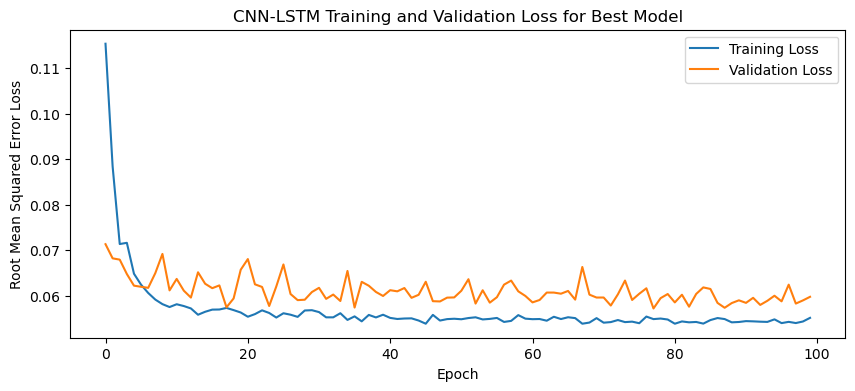

1/1 - 4s - loss: 0.0432 - 4s/epoch - 4s/step
Test Loss: 0.04324109107255936
1/1 [==============================] - 0s 75ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    print(np.mean(rmse_list))
    print(np.std(rmse_list))

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = [forecasts[j]]
        
        plot_forecasts(series_ws, forecasts_ws, n_test+2, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    # Plotting the results
    plt.figure(figsize=(15, 6))
    plt.plot(results_df['ws'], results_df['Actual'], label='Actual')
    plt.plot(results_df['ws'], results_df['Predicted'], label='Predicted', alpha=0.7)
    plt.title('CNN-LSTM Model Comparison Temperature Prediction')
    plt.xlabel('Weather Station')
    plt.ylabel('Temperature')
    plt.legend()
    plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('CNN-LSTM Training and Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

    # Plot training & validation accuracy
    #plt.subplot(1, 2, 2)
    #plt.plot(history.history['accuracy'], label='Training Accuracy')
    #plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    #plt.title('Model Accuracy')
    #plt.xlabel('Epoch')
    #plt.ylabel('Accuracy')
    #plt.legend(['Training', 'Validation'])
    #plt.tight_layout()

# Plot model architecture
filename = "cnnlstm_model_optimized.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

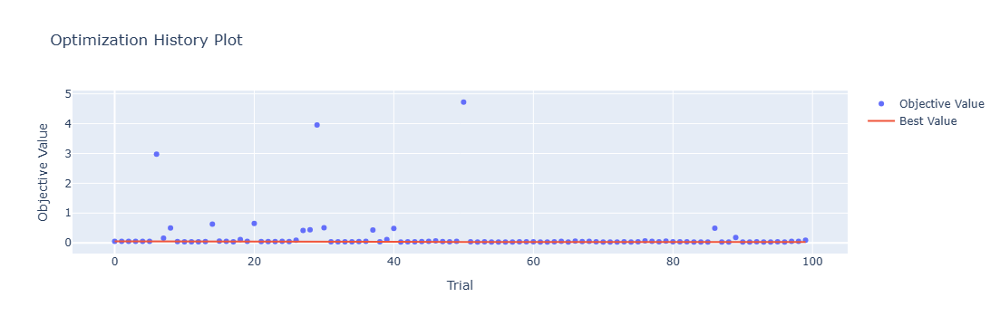

In [4]:
optuna.visualization.plot_optimization_history(study)

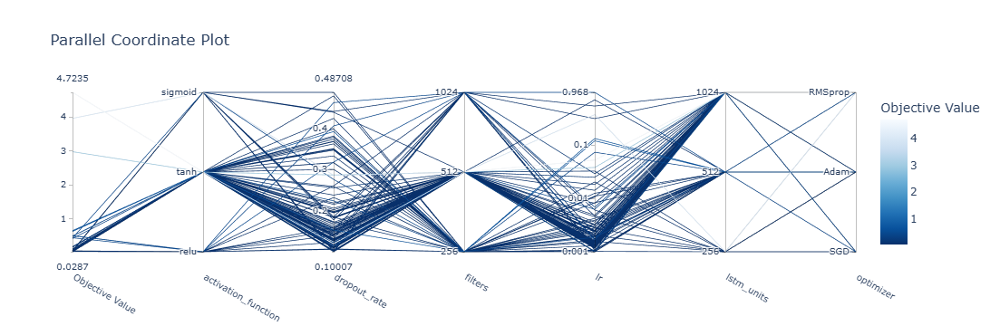

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

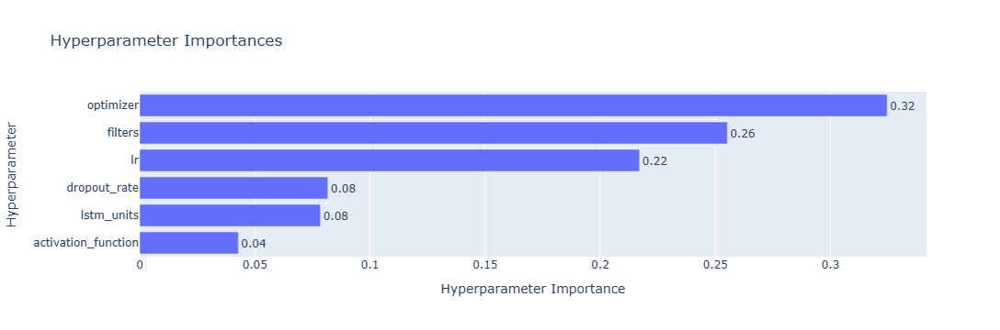

In [6]:
optuna.visualization.plot_param_importances(study)

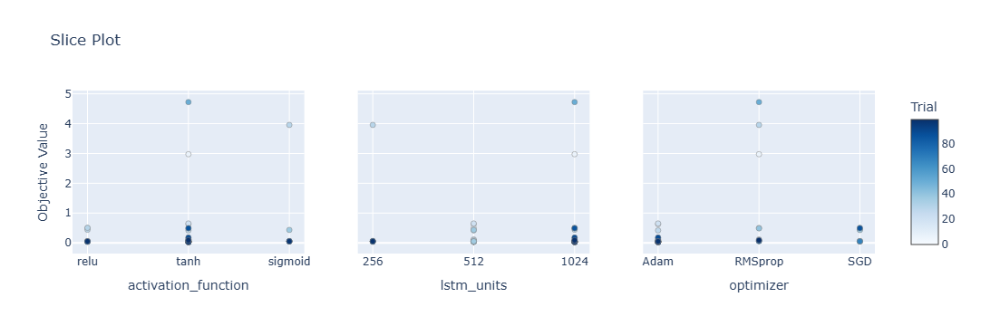

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

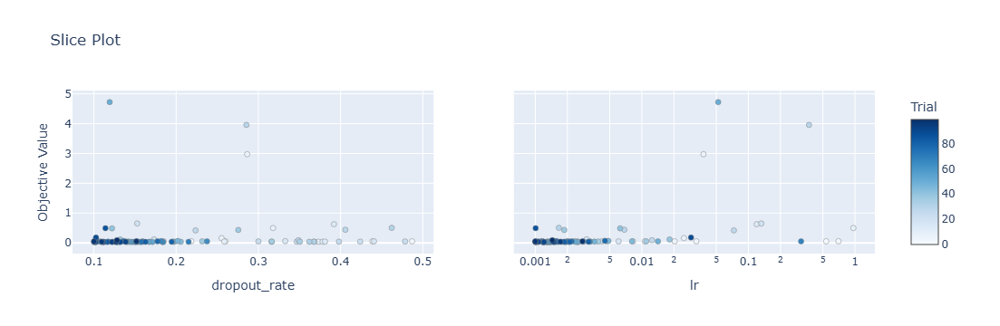

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 35s 174ms/step - loss: 0.1197 - accuracy: 0.2024 - mae: 0.0976 - rmse: 0.1197 - mape: inf - pearson: 0.6310 - val_loss: 0.0886 - val_accuracy: 0.3000 - val_mae: 0.0717 - val_rmse: 0.0886 - val_mape: 16.8479 - val_pearson: 0.6675
Epoch 2/100
84/84 [==============================] - 9s 111ms/step - loss: 0.0789 - accuracy: 0.3929 - mae: 0.0632 - rmse: 0.0789 - mape: inf - pearson: 0.7890 - val_loss: 0.0858 - val_accuracy: 0.3000 - val_mae: 0.0680 - val_rmse: 0.0858 - val_mape: 14.3651 - val_pearson: 0.7218
Epoch 3/100
84/84 [==============================] - 10s 120ms/step - loss: 0.0751 - accuracy: 0.5238 - mae: 0.0606 - rmse: 0.0751 - mape: inf - pearson: 0.8054 - val_loss: 

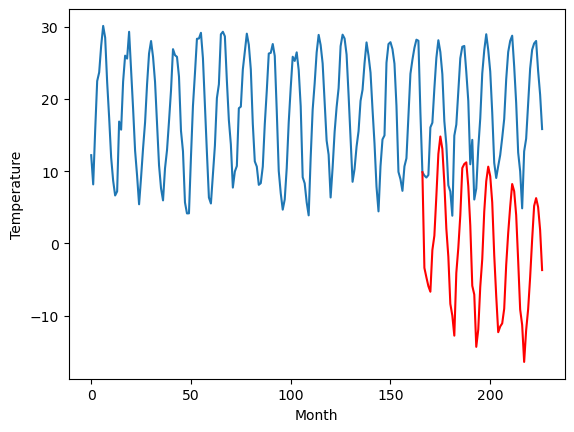

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.55		0.16
2.49		2.25		-0.24
2.11		1.02		-1.09
2.86		0.25		-2.61
8.69		6.01		-2.68
9.18		8.00		-1.18
11.95		13.50		1.55
15.70		19.29		3.59
16.18		21.71		5.53
16.81		19.99		3.18
13.83		15.26		1.43
11.20		8.97		-2.23
7.78		5.10		-2.68
0.57		-1.43		-2.00
1.23		-3.05		-4.28
1.14		-5.82		-6.96
6.20		2.85		-3.35
7.60		6.31		-1.29
11.62		10.81		-0.81
15.10		17.36		2.26
16.32		17.91		1.59
16.66		18.14		1.48
14.53		14.84		0.31
11.90		9.41		-2.49
6.39		1.07		-5.32
6.15		-0.14		-6.29
-0.53		-7.37		-6.84
2.24		-4.97		-7.21
6.10		0.93		-5.17
9.07		4.76		-4.31
13.38		11.34		-2.04
17.07		15.54		-1.53
17.21		17.55		0.34
16.66		16.22		-0.44
15.64		12.61		-3.03
10.04		5.31		-4.73
7.35		-0.34		-7.69
3.50		-5.34		-8.84
4.29		-4.55		-8.84
5.39		-4.13		-9.52
6.98		-2.10		-9.08
9.13		3.95		-5.18
12.31		8.37		-3.94
15.39		12.00		-3.39
17.22		15.14		-2.08
18.81		14.14		-4.67
15.43		10.85		-4.58
10.32		4.55		-5.

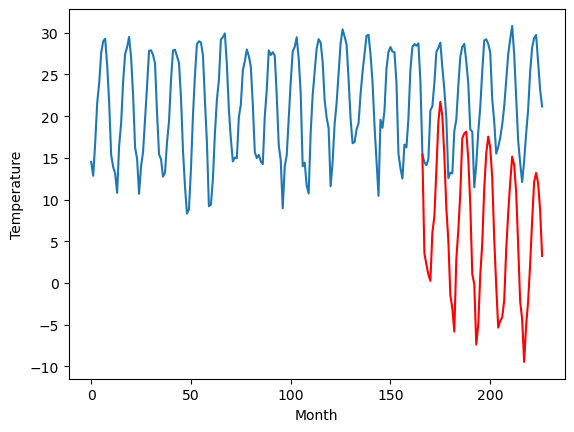

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		5.86		0.93
4.82		4.56		-0.26
4.20		3.33		-0.87
4.82		2.56		-2.26
11.07		8.32		-2.75
10.83		10.31		-0.52
14.52		15.81		1.29
18.24		21.60		3.36
20.61		24.02		3.41
19.85		22.29		2.44
16.46		17.57		1.11
12.74		11.28		-1.46
7.81		7.41		-0.40
0.81		0.88		0.07
1.63		-0.74		-2.37
2.49		-3.51		-6.00
8.47		5.16		-3.31
10.11		8.62		-1.49
14.09		13.12		-0.97
18.23		19.67		1.44
19.99		20.22		0.23
20.27		20.45		0.18
16.70		17.15		0.45
12.82		11.72		-1.10
4.46		3.38		-1.08
6.64		2.17		-4.47
0.63		-5.06		-5.69
4.58		-2.66		-7.24
8.08		3.24		-4.84
10.82		7.07		-3.75
16.58		13.65		-2.93
20.36		17.85		-2.51
21.28		19.86		-1.42
20.05		18.53		-1.52
16.93		14.92		-2.01
9.79		7.62		-2.17
7.31		1.97		-5.34
2.79		-3.03		-5.82
4.74		-2.24		-6.98
7.52		-1.82		-9.34
7.50		0.21		-7.29
10.57		6.26		-4.31
13.98		10.68		-3.30
17.30		14.31		-2.99
20.40		17.45		-2.95
20.01		16.45		-3.56
16.56		13.16		-3.40
10.58		6.86		

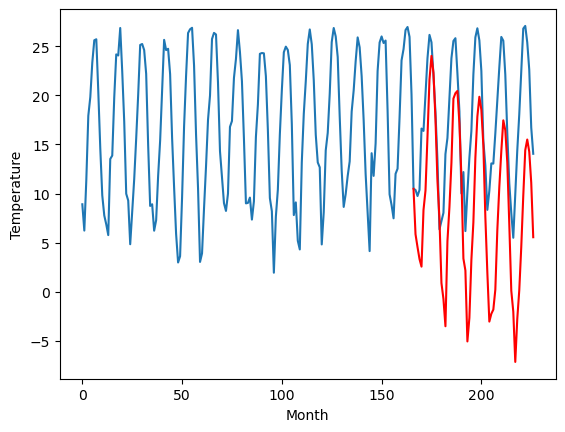

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.25		-0.88
1.11		-1.05		-2.16
1.15		-2.28		-3.43
1.15		-3.05		-4.20
8.07		2.71		-5.36
8.15		4.70		-3.45
11.04		10.20		-0.84
13.95		15.99		2.04
14.92		18.41		3.49
15.26		16.69		1.43
12.93		11.96		-0.97
8.87		5.67		-3.20
6.03		1.80		-4.23
-1.43		-4.73		-3.30
-1.34		-6.35		-5.01
-2.91		-9.12		-6.21
5.00		-0.45		-5.45
6.79		3.01		-3.78
10.76		7.51		-3.25
14.04		14.06		0.02
14.67		14.61		-0.06
14.72		14.84		0.12
12.21		11.54		-0.67
9.90		6.11		-3.79
1.81		-2.23		-4.04
4.58		-3.44		-8.02
-2.77		-10.67		-7.90
-0.33		-8.27		-7.94
3.46		-2.37		-5.83
8.25		1.46		-6.79
12.77		8.04		-4.73
15.20		12.24		-2.96
15.18		14.25		-0.93
13.99		12.92		-1.07
12.75		9.31		-3.44
7.13		2.01		-5.12
3.02		-3.64		-6.66
0.84		-8.64		-9.48
2.28		-7.85		-10.13
2.69		-7.43		-10.12
6.21		-5.40		-11.61
7.63		0.65		-6.98
12.06		5.07		-6.99
15.81		8.70		-7.11
16.93		11.84		-5.09
18.46		10.84		-7.62
15.02		7.55		-7.47
8.77

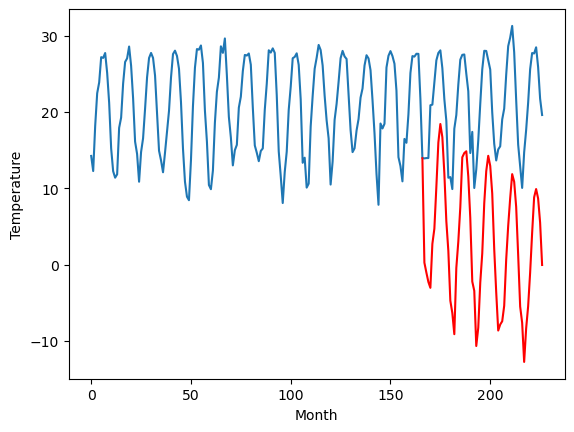

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.57		-1.77
5.29		4.27		-1.02
6.03		3.04		-2.99
5.36		2.27		-3.09
13.11		8.03		-5.08
13.36		10.02		-3.34
18.34		15.52		-2.82
22.54		21.31		-1.23
24.15		23.73		-0.42
24.64		22.01		-2.63
18.93		17.28		-1.65
14.05		10.99		-3.06
11.53		7.12		-4.41
5.06		0.59		-4.47
4.18		-1.03		-5.21
1.09		-3.80		-4.89
10.99		4.87		-6.12
12.92		8.33		-4.59
16.78		12.83		-3.95
21.98		19.38		-2.60
22.41		19.93		-2.48
23.17		20.16		-3.01
21.16		16.86		-4.30
16.81		11.43		-5.38
9.24		3.09		-6.15
11.57		1.88		-9.69
3.12		-5.35		-8.47
2.89		-2.95		-5.84
9.38		2.95		-6.43
15.42		6.78		-8.64
20.13		13.36		-6.77
24.47		17.56		-6.91
26.83		19.57		-7.26
24.47		18.24		-6.23
21.52		14.63		-6.89
15.60		7.33		-8.27
8.67		1.68		-6.99
5.94		-3.32		-9.26
6.91		-2.53		-9.44
7.04		-2.11		-9.15
11.76		-0.08		-11.84
13.26		5.97		-7.29
18.79		10.39		-8.40
23.34		14.02		-9.32
26.33		17.16		-9.17
28.07		16.16		-11.91
23.59		12.87		

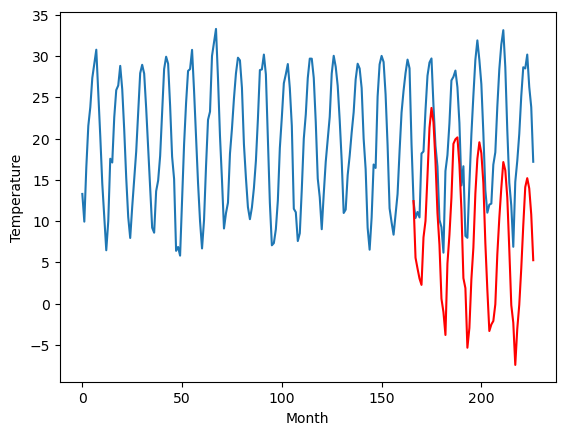

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.64		0.01
4.06		3.34		-0.72
3.53		2.11		-1.42
3.22		1.34		-1.88
6.81		7.10		0.29
8.78		9.09		0.31
12.47		14.59		2.12
16.82		20.38		3.56
20.56		22.80		2.24
19.71		21.07		1.36
16.68		16.35		-0.33
12.59		10.06		-2.53
8.47		6.19		-2.28
1.72		-0.34		-2.06
-0.06		-1.96		-1.90
0.59		-4.73		-5.32
5.49		3.94		-1.55
8.86		7.40		-1.46
12.37		11.90		-0.47
16.94		18.45		1.51
18.93		19.00		0.07
19.41		19.23		-0.18
16.40		15.93		-0.47
12.80		10.50		-2.30
4.63		2.16		-2.47
5.68		0.95		-4.73
-0.70		-6.28		-5.58
2.91		-3.88		-6.79
6.83		2.02		-4.81
9.70		5.85		-3.85
14.33		12.43		-1.90
17.90		16.63		-1.27
20.04		18.64		-1.40
19.19		17.31		-1.88
16.54		13.70		-2.84
9.98		6.40		-3.58
8.29		0.75		-7.54
1.77		-4.25		-6.02
3.46		-3.46		-6.92
4.95		-3.04		-7.99
5.86		-1.01		-6.87
10.54		5.04		-5.50
12.06		9.46		-2.60
15.88		13.09		-2.79
19.71		16.23		-3.48
19.23		15.23		-4.00
15.71		11.94		-3.77
11.36		5.64		

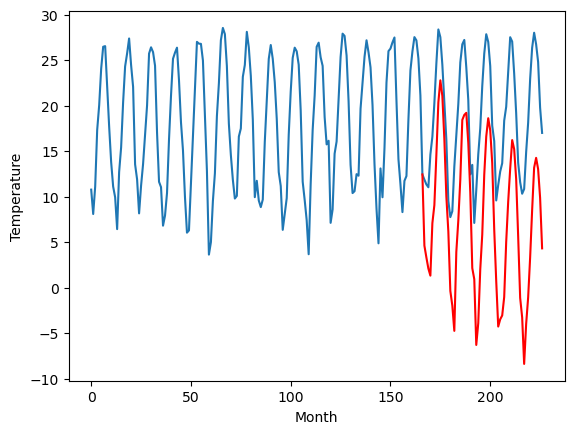

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.13		1.45
0.32		0.83		0.51
-0.15		-0.40		-0.25
0.96		-1.17		-2.13
6.38		4.59		-1.79
7.62		6.58		-1.04
9.96		12.08		2.12
15.21		17.87		2.66
18.28		20.29		2.01
17.25		18.56		1.31
13.36		13.84		0.48
9.36		7.55		-1.81
5.18		3.68		-1.50
-1.75		-2.85		-1.10
-2.33		-4.47		-2.14
-1.69		-7.24		-5.55
5.29		1.43		-3.86
6.32		4.89		-1.43
10.03		9.39		-0.64
14.36		15.94		1.58
15.98		16.49		0.51
15.92		16.72		0.80
11.87		13.42		1.55
8.64		7.99		-0.65
-0.01		-0.35		-0.34
1.93		-1.56		-3.49
-4.72		-8.79		-4.07
-0.74		-6.39		-5.65
3.60		-0.49		-4.09
6.52		3.34		-3.18
11.59		9.92		-1.67
15.50		14.12		-1.38
16.60		16.13		-0.47
15.31		14.80		-0.51
12.25		11.19		-1.06
5.31		3.89		-1.42
3.08		-1.76		-4.84
-3.43		-6.76		-3.33
-0.24		-5.97		-5.73
2.76		-5.55		-8.31
3.24		-3.52		-6.76
6.80		2.53		-4.27
9.49		6.95		-2.54
12.84		10.58		-2.26
16.55		13.72		-2.83
15.86		12.72		-3.14
12.35		9.43		-2.92
7.14		3.13		

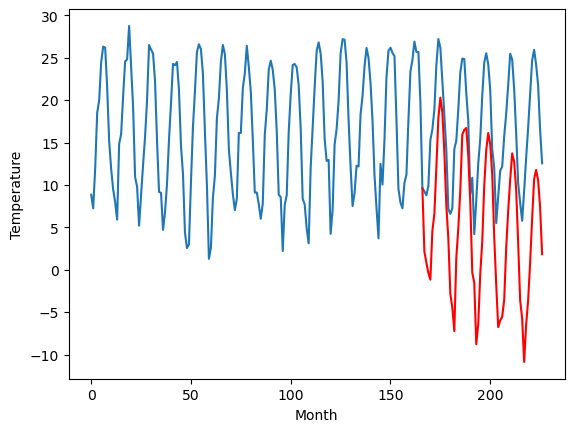

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.19		1.56
-1.74		-1.11		0.63
-1.86		-2.34		-0.48
-0.82		-3.11		-2.29
4.76		2.65		-2.11
5.66		4.64		-1.02
8.78		10.14		1.36
14.30		15.93		1.63
17.56		18.35		0.79
16.19		16.63		0.44
11.32		11.90		0.58
7.48		5.61		-1.87
3.25		1.74		-1.51
-3.68		-4.79		-1.11
-4.62		-6.41		-1.79
-4.00		-9.18		-5.18
2.52		-0.51		-3.03
6.15		2.95		-3.20
9.17		7.45		-1.72
13.96		14.00		0.04
16.08		14.55		-1.53
16.03		14.78		-1.25
11.52		11.48		-0.04
7.67		6.05		-1.62
-1.83		-2.29		-0.46
0.23		-3.50		-3.73
-6.95		-10.73		-3.78
-2.71		-8.33		-5.62
2.13		-2.43		-4.56
5.45		1.40		-4.05
10.43		7.98		-2.45
14.43		12.18		-2.25
16.30		14.19		-2.11
14.62		12.86		-1.76
10.92		9.25		-1.67
3.73		1.95		-1.78
1.53		-3.70		-5.23
-5.64		-8.70		-3.06
-2.47		-7.91		-5.44
0.50		-7.49		-7.99
1.18		-5.46		-6.64
5.80		0.59		-5.21
8.09		5.01		-3.08
11.84		8.64		-3.20
15.98		11.78		-4.20
14.84		10.78		-4.06
11.08		7.49		-3.59
5.69		

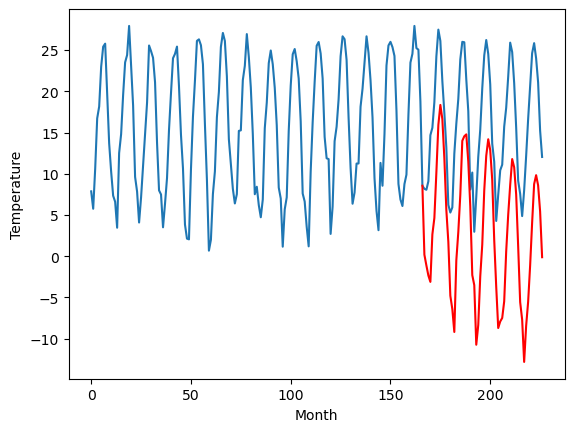

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.79		0.16
-1.11		-2.09		-0.98
-2.30		-3.32		-1.02
-1.80		-4.09		-2.29
4.77		1.67		-3.10
7.05		3.66		-3.39
11.93		9.16		-2.77
17.86		14.95		-2.91
20.60		17.37		-3.23
17.59		15.65		-1.94
14.03		10.92		-3.11
6.77		4.63		-2.14
3.91		0.76		-3.15
-2.80		-5.77		-2.97
-3.59		-7.39		-3.80
-7.86		-10.16		-2.30
4.61		-1.49		-6.10
7.21		1.97		-5.24
11.90		6.47		-5.43
18.09		13.02		-5.07
18.66		13.57		-5.09
18.60		13.80		-4.80
14.86		10.50		-4.36
10.90		5.07		-5.83
0.86		-3.27		-4.13
2.66		-4.48		-7.14
-5.85		-11.71		-5.86
-3.81		-9.31		-5.50
3.41		-3.41		-6.82
7.36		0.42		-6.94
14.20		7.00		-7.20
18.72		11.20		-7.52
21.05		13.21		-7.84
18.17		11.88		-6.29
14.53		8.27		-6.26
7.97		0.97		-7.00
2.00		-4.68		-6.68
-3.29		-9.68		-6.39
-0.73		-8.89		-8.16
0.88		-8.47		-9.35
2.70		-6.44		-9.14
8.48		-0.39		-8.87
14.07		4.03		-10.04
17.94		7.66		-10.28
19.43		10.80		-8.63
18.17		9.80		-8.37
15.00		6.51	

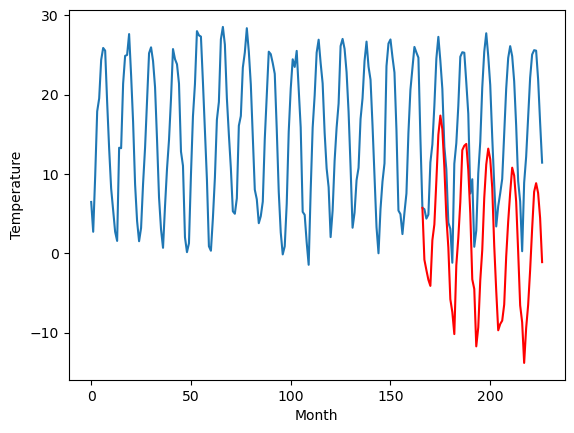

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-2.17		2.39
-4.38		-3.47		0.91
-5.66		-4.70		0.96
-6.53		-5.47		1.06
0.66		0.29		-0.37
2.32		2.28		-0.04
7.41		7.78		0.37
14.39		13.57		-0.82
17.02		15.99		-1.03
14.64		14.27		-0.37
10.97		9.54		-1.43
4.58		3.25		-1.33
0.90		-0.62		-1.52
-6.61		-7.15		-0.54
-8.20		-8.77		-0.57
-10.37		-11.54		-1.17
0.38		-2.87		-3.25
3.44		0.59		-2.85
7.91		5.09		-2.82
14.39		11.64		-2.75
15.40		12.19		-3.21
16.00		12.42		-3.58
12.14		9.12		-3.02
7.67		3.69		-3.98
-2.99		-4.65		-1.66
-1.76		-5.86		-4.10
-10.73		-13.09		-2.36
-7.15		-10.69		-3.54
-0.17		-4.79		-4.62
2.56		-0.96		-3.52
10.73		5.62		-5.11
14.63		9.82		-4.81
16.66		11.83		-4.83
14.75		10.50		-4.25
11.02		6.89		-4.13
3.98		-0.41		-4.39
-1.04		-6.06		-5.02
-6.75		-11.06		-4.31
-4.86		-10.27		-5.41
-2.82		-9.85		-7.03
-2.48		-7.82		-5.34
3.80		-1.77		-5.57
8.76		2.65		-6.11
12.60		6.28		-6.32
15.43		9.42		-6.01
14.63		8.42		-6.21
12.02		5.13

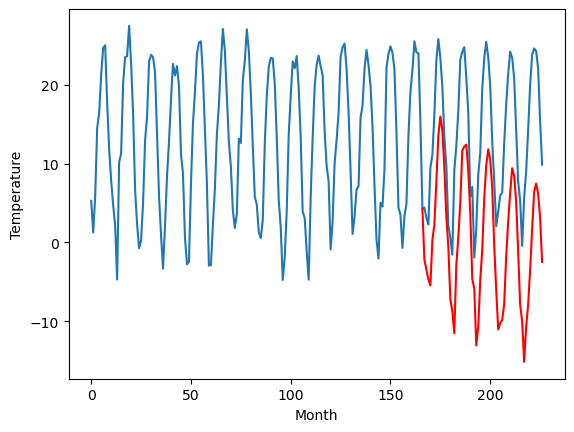

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.37		1.69
-5.73		-4.67		1.06
-6.76		-5.90		0.86
-8.22		-6.67		1.55
-2.08		-0.91		1.17
0.57		1.08		0.51
7.00		6.58		-0.42
14.96		12.37		-2.59
18.12		14.79		-3.33
15.43		13.07		-2.36
10.60		8.34		-2.26
3.85		2.05		-1.80
0.37		-1.82		-2.19
-6.66		-8.35		-1.69
-8.27		-9.97		-1.70
-12.58		-12.74		-0.16
-0.85		-4.07		-3.22
3.12		-0.61		-3.73
8.27		3.89		-4.38
15.58		10.44		-5.14
16.17		10.99		-5.18
16.88		11.22		-5.66
12.83		7.92		-4.91
8.48		2.49		-5.99
-2.38		-5.85		-3.47
-3.28		-7.06		-3.78
-12.23		-14.29		-2.06
-8.99		-11.89		-2.90
-2.08		-5.99		-3.91
1.53		-2.16		-3.69
10.85		4.42		-6.43
15.61		8.62		-6.99
16.72		10.63		-6.09
15.60		9.30		-6.30
11.76		5.69		-6.07
4.52		-1.61		-6.13
-0.51		-7.26		-6.75
-6.69		-12.26		-5.57
-5.56		-11.47		-5.91
-5.15		-11.05		-5.90
-3.29		-9.02		-5.73
3.56		-2.97		-6.53
8.58		1.45		-7.13
14.09		5.08		-9.01
16.55		8.22		-8.33
14.74		7.22		-7.52
12.36		3

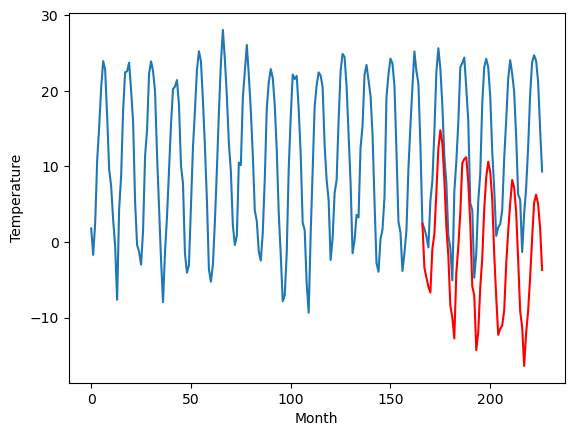

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.371385
1                 1    3.39   3.548618
2                 2    4.93   5.858617
3                 3    1.13   0.248617
4                 4    7.34   5.568616
5                 5    4.63   4.638618
6                 6    0.68   2.128617
7                 7   -1.37   0.188617
8                 8   -0.95  -0.791384
9                 9   -4.56  -2.171384
10               10   -5.06  -3.371385


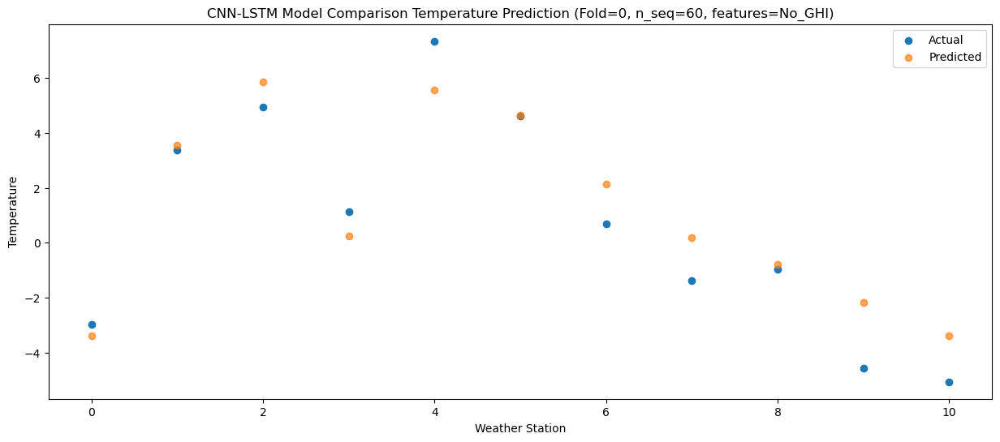

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -4.674811
1                 1    2.49   2.245194
2                 2    4.82   4.555191
3                 3    1.11  -1.054808
4                 4    5.29   4.265191
5                 5    4.06   3.335191
6                 6    0.32   0.825192
7                 7   -1.74  -1.114809
8                 8   -1.11  -2.094807
9                 9   -4.38  -3.474808
10               10   -5.73  -4.674810


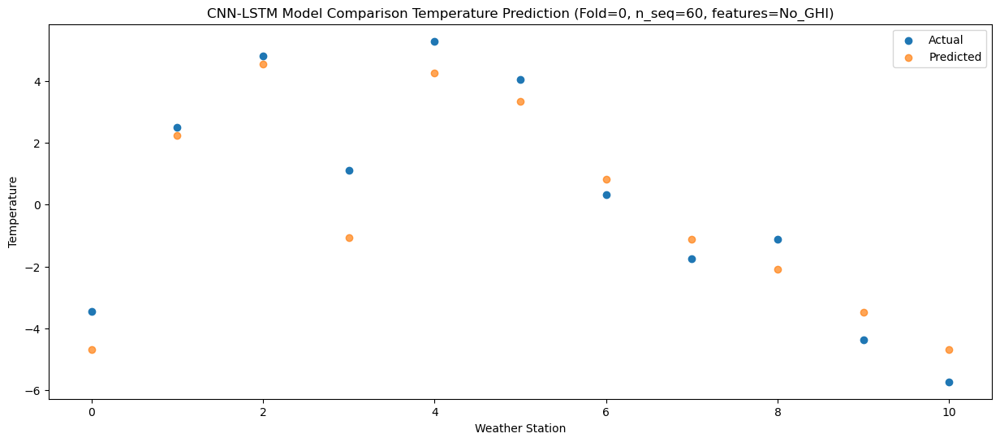

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -5.898569
1                 1    2.11   1.021434
2                 2    4.20   3.331431
3                 3    1.15  -2.278568
4                 4    6.03   3.041431
5                 5    3.53   2.111431
6                 6   -0.15  -0.398566
7                 7   -1.86  -2.338569
8                 8   -2.30  -3.318565
9                 9   -5.66  -4.698568
10               10   -6.76  -5.898566


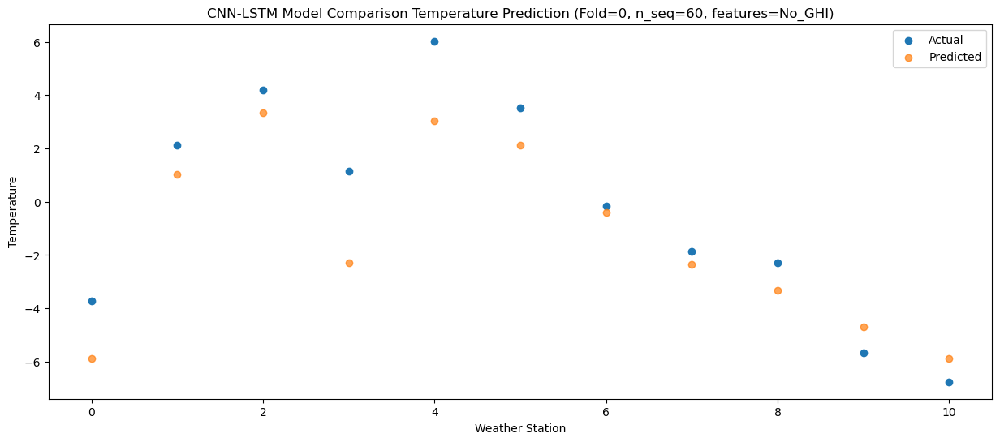

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -6.668968
1                 1    2.86   0.251034
2                 2    4.82   2.561030
3                 3    1.15  -3.048968
4                 4    5.36   2.271034
5                 5    3.22   1.341030
6                 6    0.96  -1.168967
7                 7   -0.82  -3.108969
8                 8   -1.80  -4.088960
9                 9   -6.53  -5.468965
10               10   -8.22  -6.668959


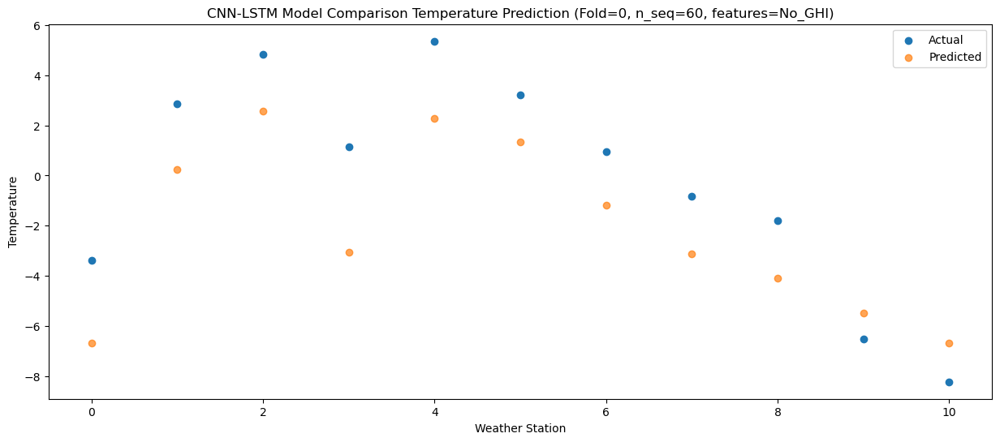

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21  -0.906490
1                 1    8.69   6.013512
2                 2   11.07   8.323506
3                 3    8.07   2.713508
4                 4   13.11   8.033511
5                 5    6.81   7.103508
6                 6    6.38   4.593508
7                 7    4.76   2.653505
8                 8    4.77   1.673512
9                 9    0.66   0.293510
10               10   -2.08  -0.906488


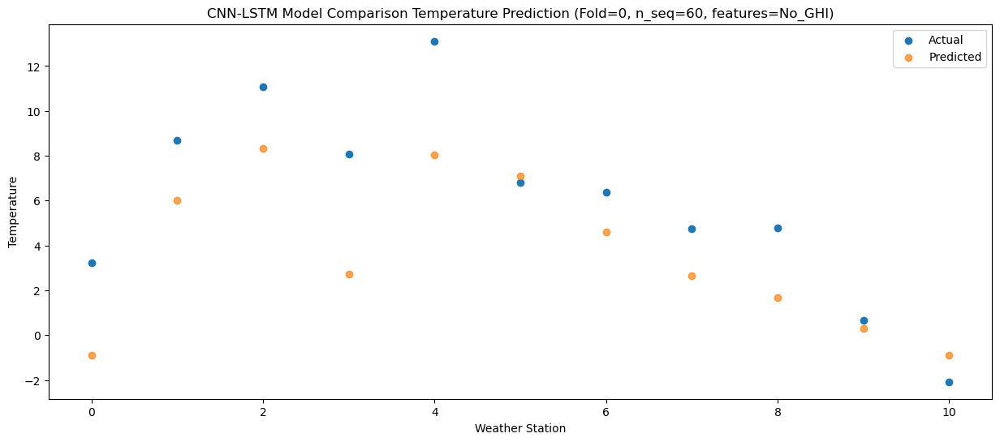

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   1.077026
1                 1    9.18   7.997032
2                 2   10.83  10.307022
3                 3    8.15   4.697026
4                 4   13.36  10.017027
5                 5    8.78   9.087026
6                 6    7.62   6.577023
7                 7    5.66   4.637023
8                 8    7.05   3.657024
9                 9    2.32   2.277022
10               10    0.57   1.077020


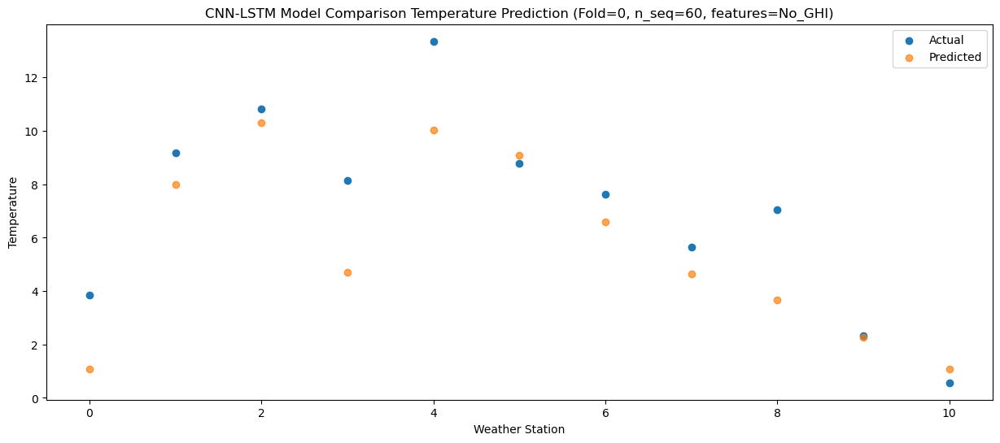

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   6.575899
1                 1   11.95  13.495914
2                 2   14.52  15.805904
3                 3   11.04  10.195904
4                 4   18.34  15.515898
5                 5   12.47  14.585908
6                 6    9.96  12.075905
7                 7    8.78  10.135903
8                 8   11.93   9.155892
9                 9    7.41   7.775888
10               10    7.00   6.575882


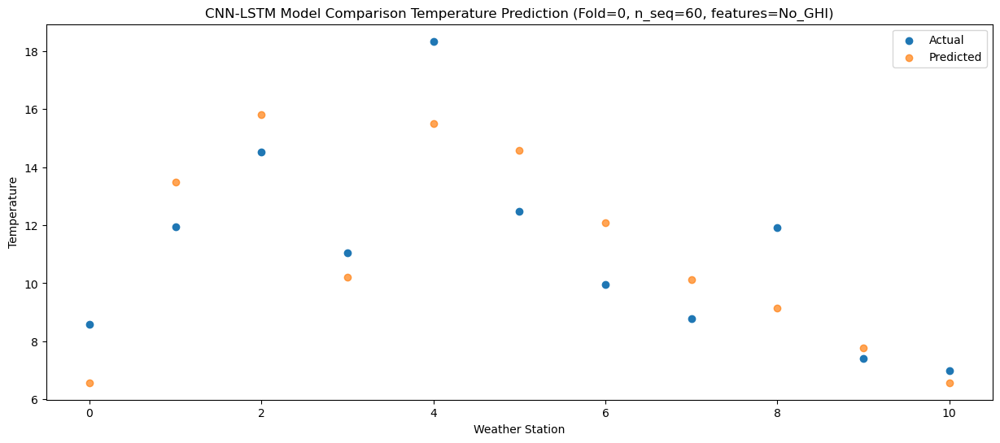

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  12.373117
1                 1   15.70  19.293129
2                 2   18.24  21.603119
3                 3   13.95  15.993119
4                 4   22.54  21.313114
5                 5   16.82  20.383123
6                 6   15.21  17.873120
7                 7   14.30  15.933118
8                 8   17.86  14.953111
9                 9   14.39  13.573104
10               10   14.96  12.373102


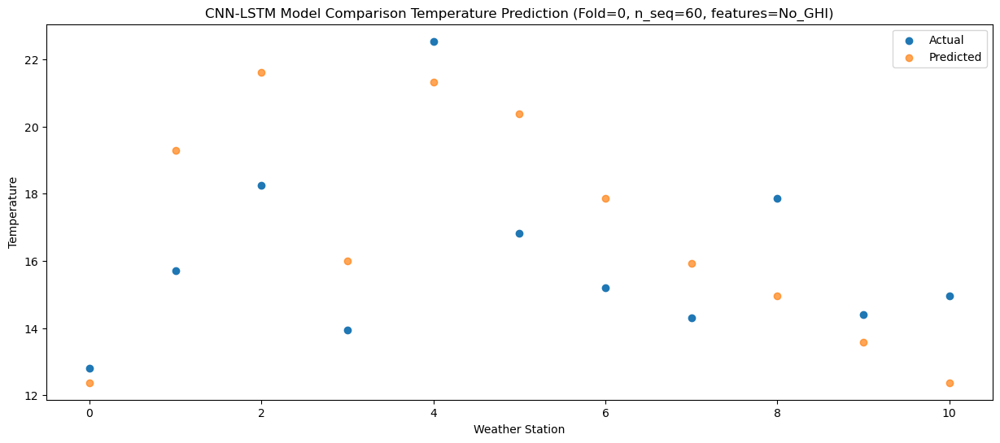

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  14.790533
1                 1   16.18  21.710537
2                 2   20.61  24.020531
3                 3   14.92  18.410533
4                 4   24.15  23.730532
5                 5   20.56  22.800531
6                 6   18.28  20.290530
7                 7   17.56  18.350530
8                 8   20.60  17.370534
9                 9   17.02  15.990524
10               10   18.12  14.790528


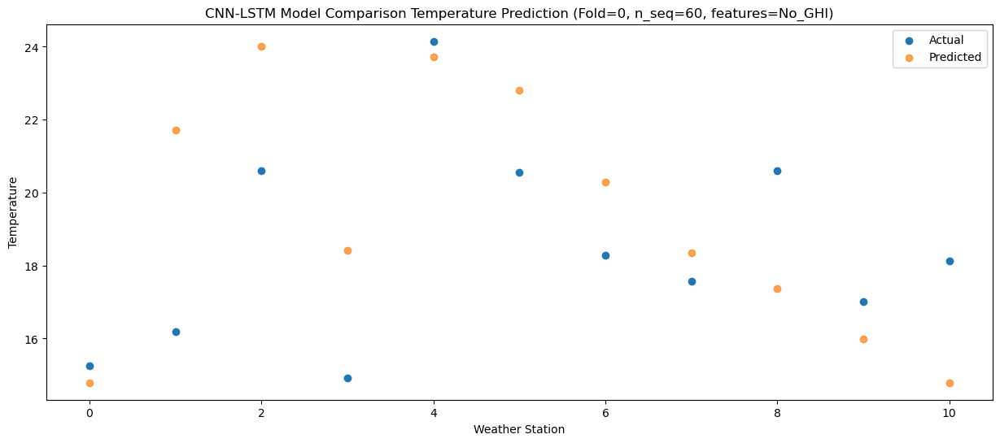

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  13.065002
1                 1   16.81  19.985004
2                 2   19.85  22.295000
3                 3   15.26  16.685002
4                 4   24.64  22.005001
5                 5   19.71  21.074998
6                 6   17.25  18.564999
7                 7   16.19  16.625000
8                 8   17.59  15.645013
9                 9   14.64  14.265000
10               10   15.43  13.065003


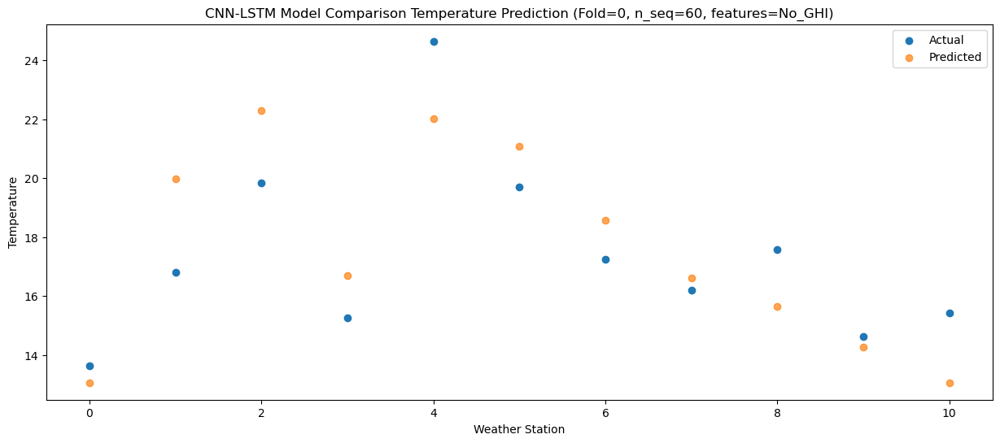

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57   8.342660
1                 1   13.83  15.262661
2                 2   16.46  17.572658
3                 3   12.93  11.962660
4                 4   18.93  17.282660
5                 5   16.68  16.352656
6                 6   13.36  13.842658
7                 7   11.32  11.902658
8                 8   14.03  10.922671
9                 9   10.97   9.542658
10               10   10.60   8.342662


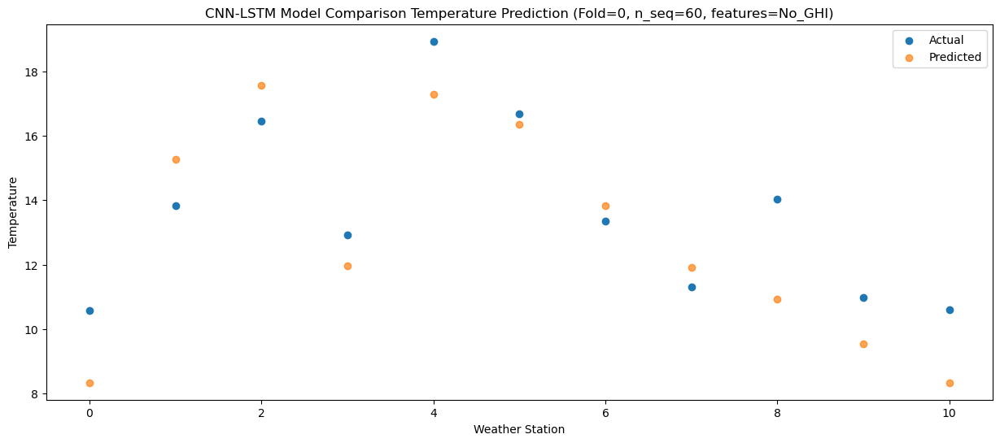

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   2.049949
1                 1   11.20   8.969954
2                 2   12.74  11.279950
3                 3    8.87   5.669952
4                 4   14.05  10.989949
5                 5   12.59  10.059949
6                 6    9.36   7.549949
7                 7    7.48   5.609952
8                 8    6.77   4.629963
9                 9    4.58   3.249950
10               10    3.85   2.049953


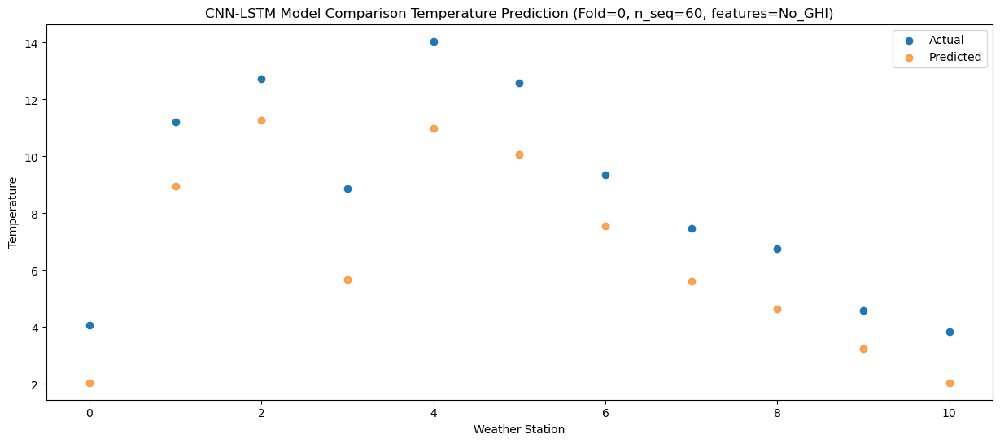

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83  -1.820410
1                 1    7.78   5.099593
2                 2    7.81   7.409589
3                 3    6.03   1.799593
4                 4   11.53   7.119593
5                 5    8.47   6.189590
6                 6    5.18   3.679590
7                 7    3.25   1.739593
8                 8    3.91   0.759604
9                 9    0.90  -0.620407
10               10    0.37  -1.820402


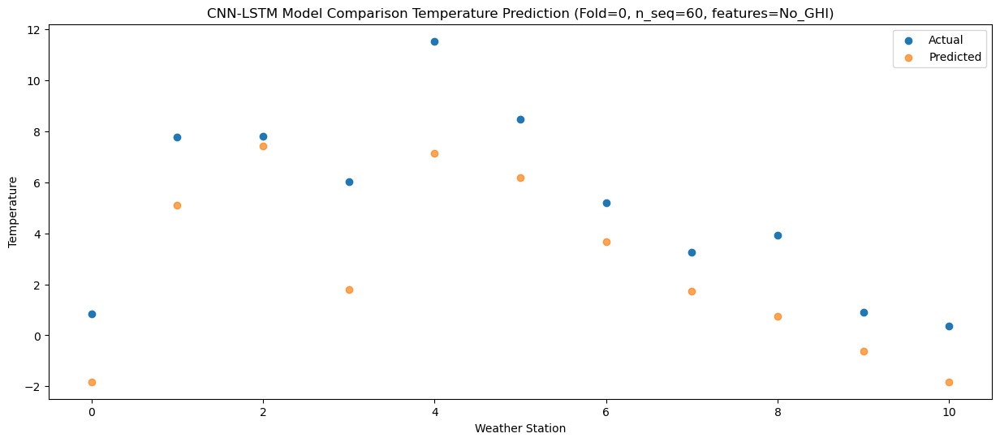

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -8.348254
1                 1    0.57  -1.428249
2                 2    0.81   0.881746
3                 3   -1.43  -4.728249
4                 4    5.06   0.591749
5                 5    1.72  -0.338252
6                 6   -1.75  -2.848253
7                 7   -3.68  -4.788250
8                 8   -2.80  -5.768244
9                 9   -6.61  -7.148253
10               10   -6.66  -8.348251


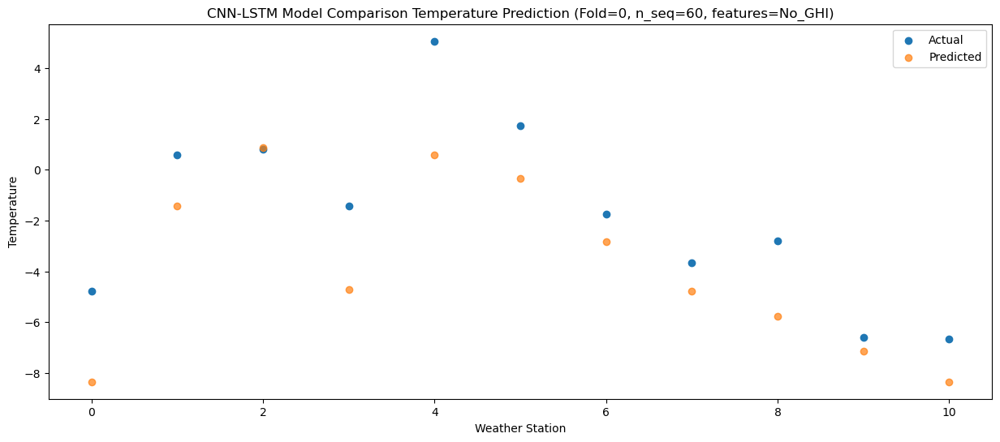

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -9.970725
1                 1    1.23  -3.050724
2                 2    1.63  -0.740727
3                 3   -1.34  -6.350722
4                 4    4.18  -1.030723
5                 5   -0.06  -1.960725
6                 6   -2.33  -4.470726
7                 7   -4.62  -6.410723
8                 8   -3.59  -7.390720
9                 9   -8.20  -8.770729
10               10   -8.27  -9.970727


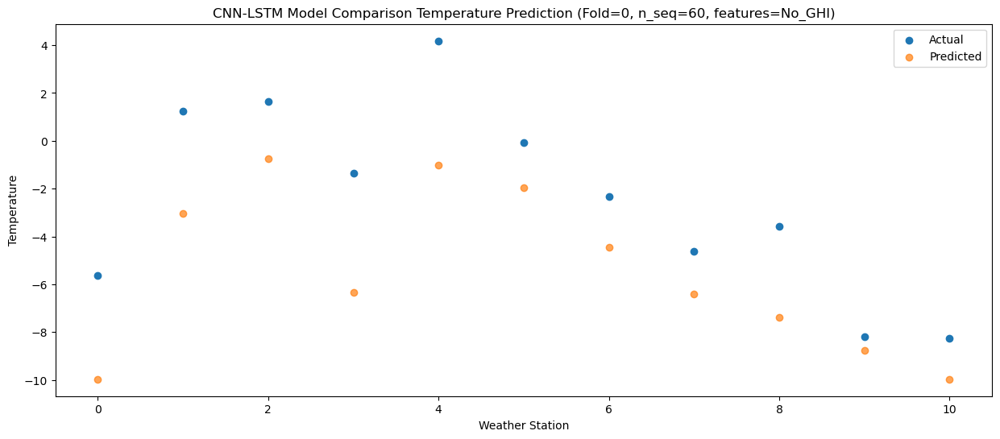

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00 -12.741450
1                 1    1.14  -5.821445
2                 2    2.49  -3.511450
3                 3   -2.91  -9.121445
4                 4    1.09  -3.801446
5                 5    0.59  -4.731448
6                 6   -1.69  -7.241451
7                 7   -4.00  -9.181450
8                 8   -7.86 -10.161449
9                 9  -10.37 -11.541458
10               10  -12.58 -12.741455


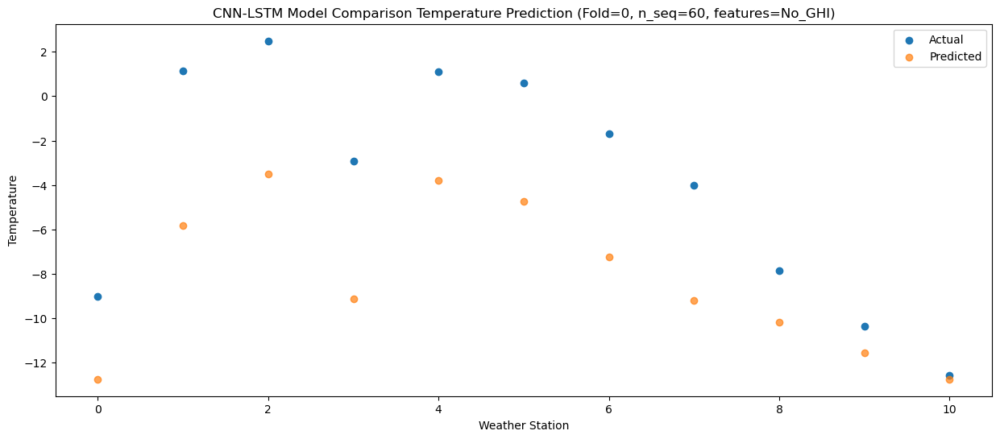

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07  -4.069495
1                 1    6.20   2.850514
2                 2    8.47   5.160500
3                 3    5.00  -0.449495
4                 4   10.99   4.870509
5                 5    5.49   3.940507
6                 6    5.29   1.430495
7                 7    2.52  -0.509504
8                 8    4.61  -1.489499
9                 9    0.38  -2.869511
10               10   -0.85  -4.069509


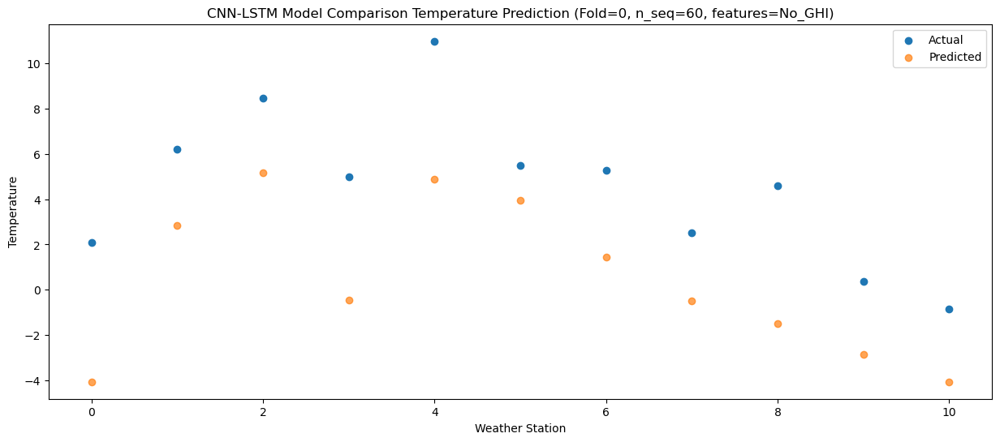

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60  -0.606352
1                 1    7.60   6.313656
2                 2   10.11   8.623648
3                 3    6.79   3.013653
4                 4   12.92   8.333654
5                 5    8.86   7.403655
6                 6    6.32   4.893644
7                 7    6.15   2.953643
8                 8    7.21   1.973648
9                 9    3.44   0.593635
10               10    3.12  -0.606362


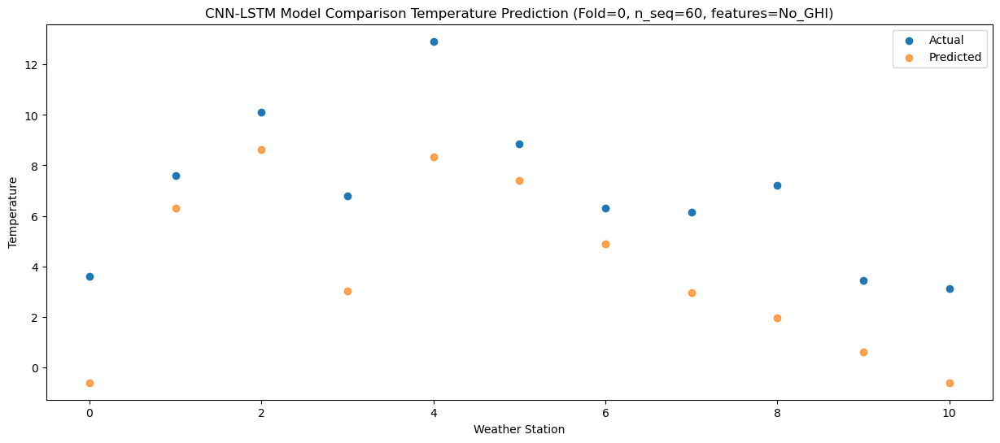

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   3.894639
1                 1   11.62  10.814643
2                 2   14.09  13.124634
3                 3   10.76   7.514640
4                 4   16.78  12.834645
5                 5   12.37  11.904640
6                 6   10.03   9.394629
7                 7    9.17   7.454630
8                 8   11.90   6.474639
9                 9    7.91   5.094627
10               10    8.27   3.894629


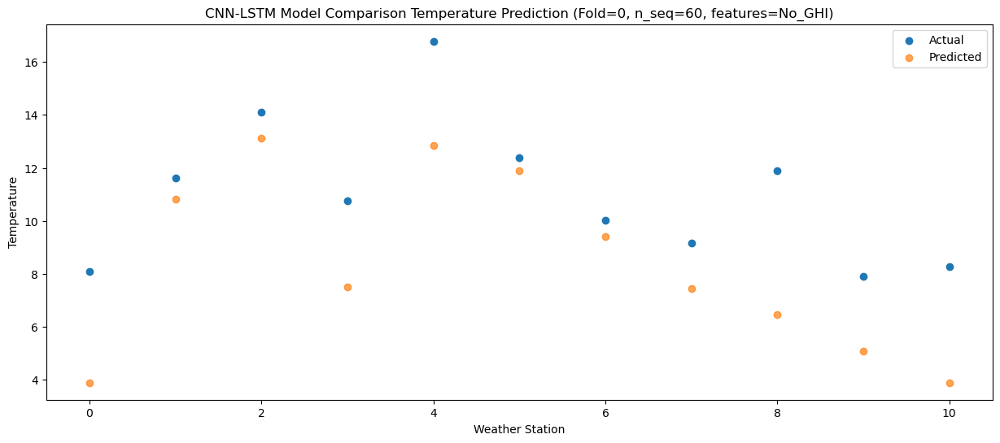

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  10.437605
1                 1   15.10  17.357608
2                 2   18.23  19.667600
3                 3   14.04  14.057605
4                 4   21.98  19.377611
5                 5   16.94  18.447605
6                 6   14.36  15.937593
7                 7   13.96  13.997594
8                 8   18.09  13.017602
9                 9   14.39  11.637587
10               10   15.58  10.437590


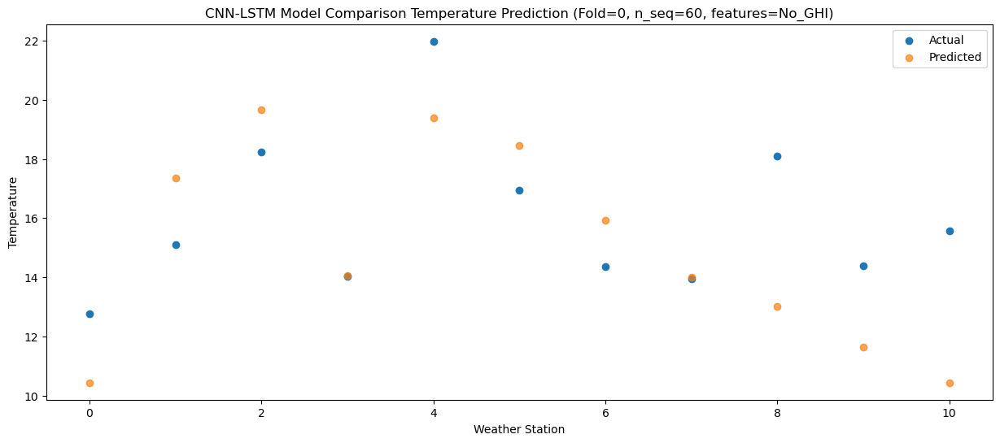

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  10.990577
1                 1   16.32  17.910583
2                 2   19.99  20.220575
3                 3   14.67  14.610580
4                 4   22.41  19.930583
5                 5   18.93  19.000580
6                 6   15.98  16.490569
7                 7   16.08  14.550570
8                 8   18.66  13.570573
9                 9   15.40  12.190558
10               10   16.17  10.990559


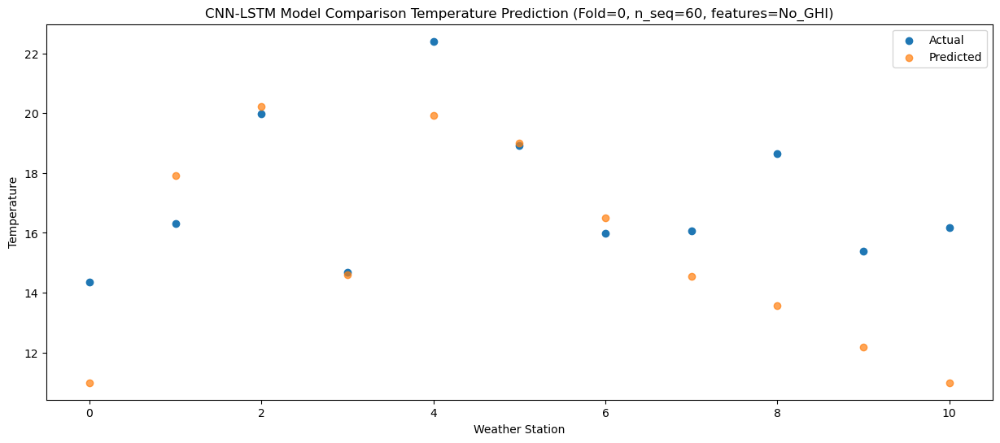

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  11.218871
1                 1   16.66  18.138881
2                 2   20.27  20.448874
3                 3   14.72  14.838878
4                 4   23.17  20.158877
5                 5   19.41  19.228880
6                 6   15.92  16.718867
7                 7   16.03  14.778866
8                 8   18.60  13.798863
9                 9   16.00  12.418849
10               10   16.88  11.218843


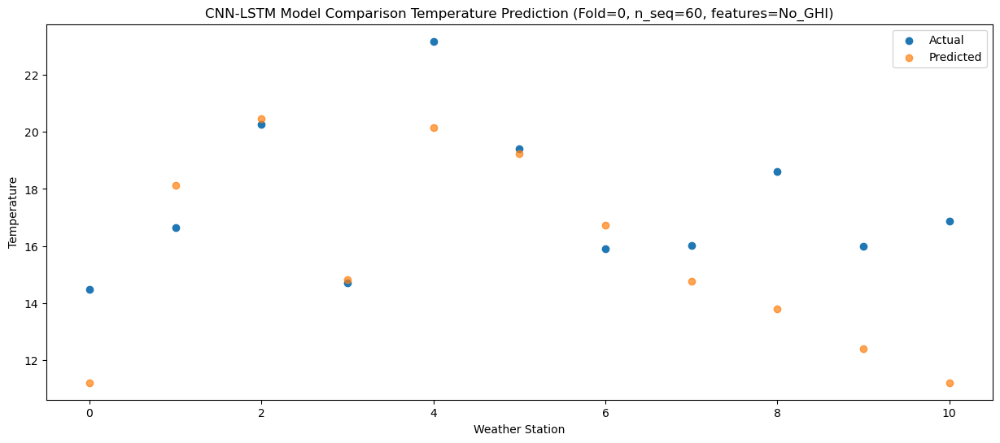

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89   7.924135
1                 1   14.53  14.844148
2                 2   16.70  17.154140
3                 3   12.21  11.544144
4                 4   21.16  16.864142
5                 5   16.40  15.934146
6                 6   11.87  13.424134
7                 7   11.52  11.484131
8                 8   14.86  10.504129
9                 9   12.14   9.124113
10               10   12.83   7.924108


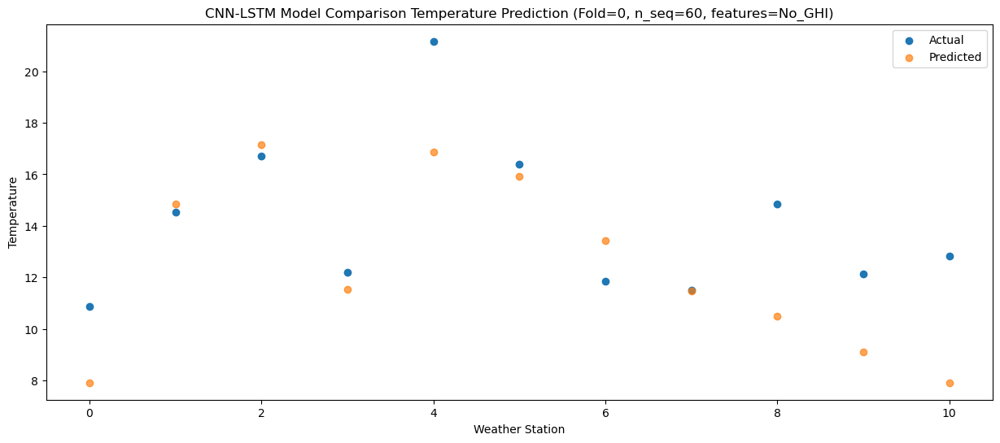

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   2.486493
1                 1   11.90   9.406516
2                 2   12.82  11.716506
3                 3    9.90   6.106510
4                 4   16.81  11.426501
5                 5   12.80  10.496514
6                 6    8.64   7.986502
7                 7    7.67   6.046499
8                 8   10.90   5.066484
9                 9    7.67   3.686470
10               10    8.48   2.486460


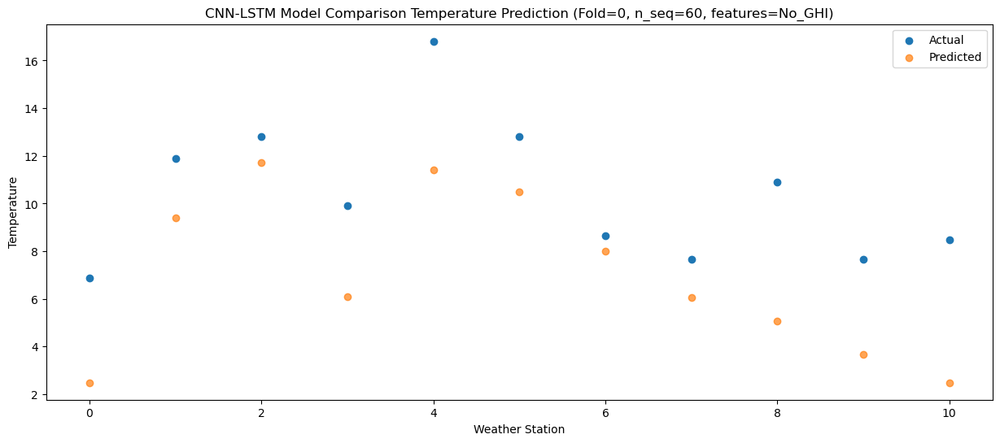

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -5.848311
1                 1    6.39   1.071716
2                 2    4.46   3.381705
3                 3    1.81  -2.228291
4                 4    9.24   3.091699
5                 5    4.63   2.161713
6                 6   -0.01  -0.348298
7                 7   -1.83  -2.288304
8                 8    0.86  -3.268323
9                 9   -2.99  -4.648337
10               10   -2.38  -5.848352


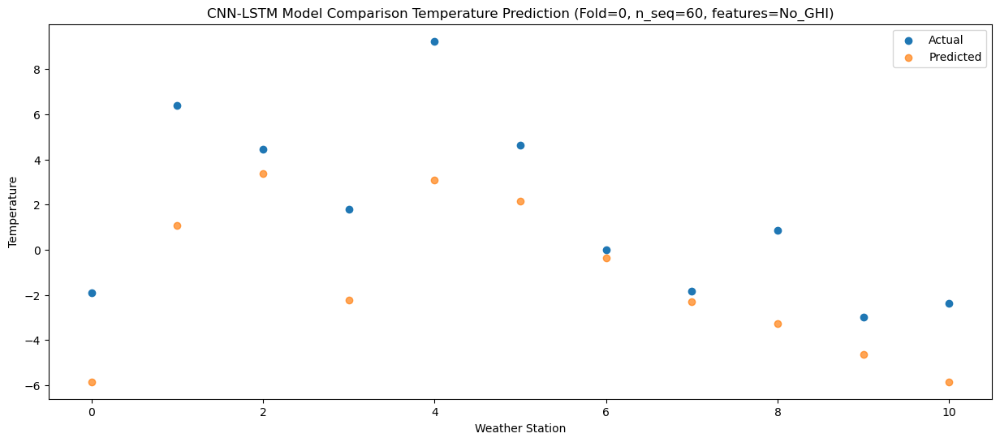

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -7.059677
1                 1    6.15  -0.139647
2                 2    6.64   2.170341
3                 3    4.58  -3.439656
4                 4   11.57   1.880332
5                 5    5.68   0.950351
6                 6    1.93  -1.559662
7                 7    0.23  -3.499670
8                 8    2.66  -4.479690
9                 9   -1.76  -5.859703
10               10   -3.28  -7.059721


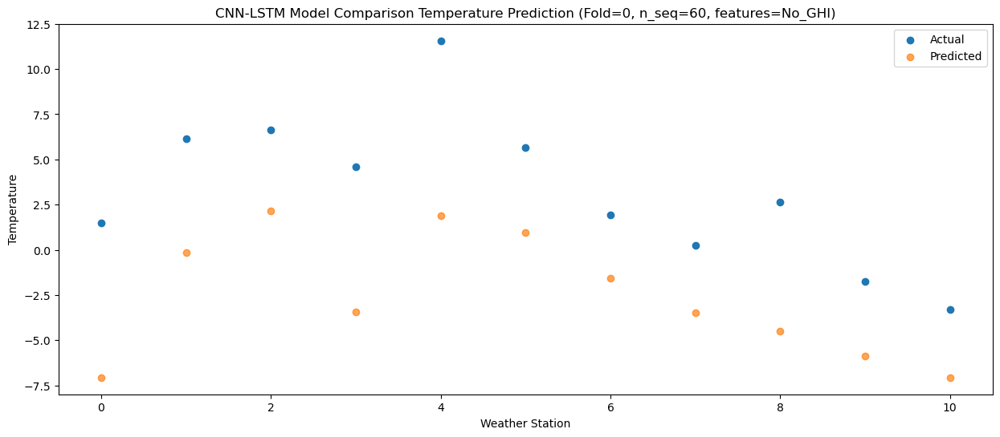

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76 -14.288210
1                 1   -0.53  -7.368179
2                 2    0.63  -5.058193
3                 3   -2.77 -10.668189
4                 4    3.12  -5.348201
5                 5   -0.70  -6.278181
6                 6   -4.72  -8.788195
7                 7   -6.95 -10.728202
8                 8   -5.85 -11.708223
9                 9  -10.73 -13.088235
10               10  -12.23 -14.288252


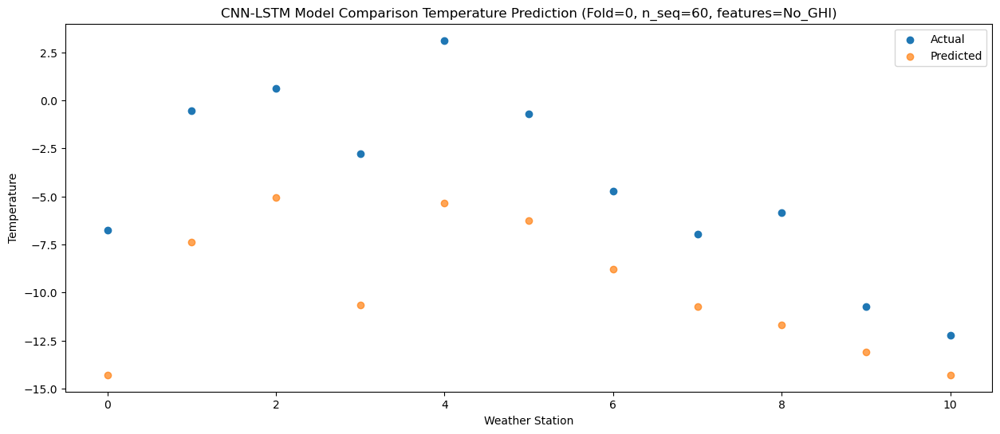

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24 -11.889615
1                 1    2.24  -4.969583
2                 2    4.58  -2.659598
3                 3   -0.33  -8.269594
4                 4    2.89  -2.949606
5                 5    2.91  -3.879585
6                 6   -0.74  -6.389600
7                 7   -2.71  -8.329607
8                 8   -3.81  -9.309632
9                 9   -7.15 -10.689644
10               10   -8.99 -11.889663


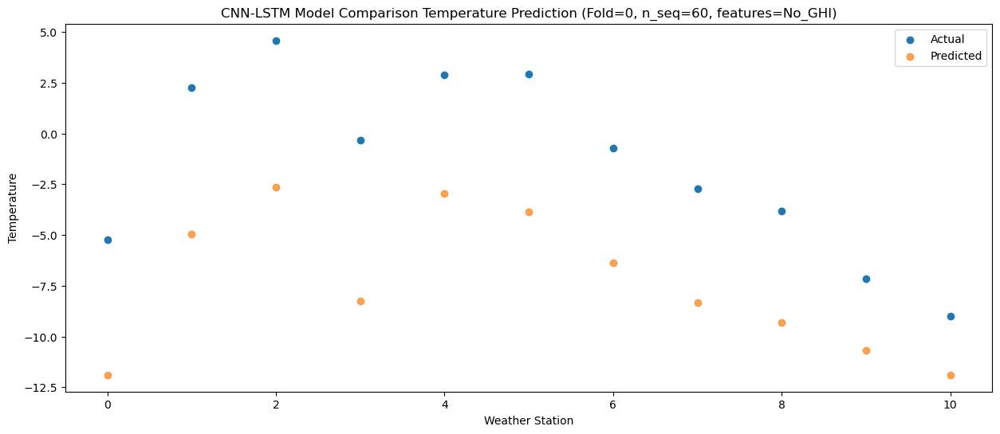

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -5.991912
1                 1    6.10   0.928117
2                 2    8.08   3.238102
3                 3    3.46  -2.371894
4                 4    9.38   2.948102
5                 5    6.83   2.018115
6                 6    3.60  -0.491901
7                 7    2.13  -2.431908
8                 8    3.41  -3.411932
9                 9   -0.17  -4.791944
10               10   -2.08  -5.991967


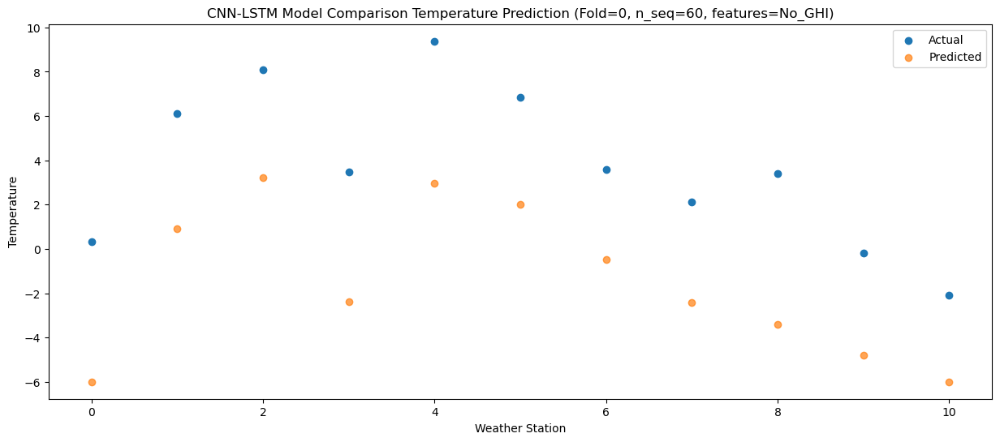

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47  -2.156336
1                 1    9.07   4.763694
2                 2   10.82   7.073677
3                 3    8.25   1.463679
4                 4   15.42   6.783677
5                 5    9.70   5.853688
6                 6    6.52   3.343675
7                 7    5.45   1.403667
8                 8    7.36   0.423645
9                 9    2.56  -0.956369
10               10    1.53  -2.156384


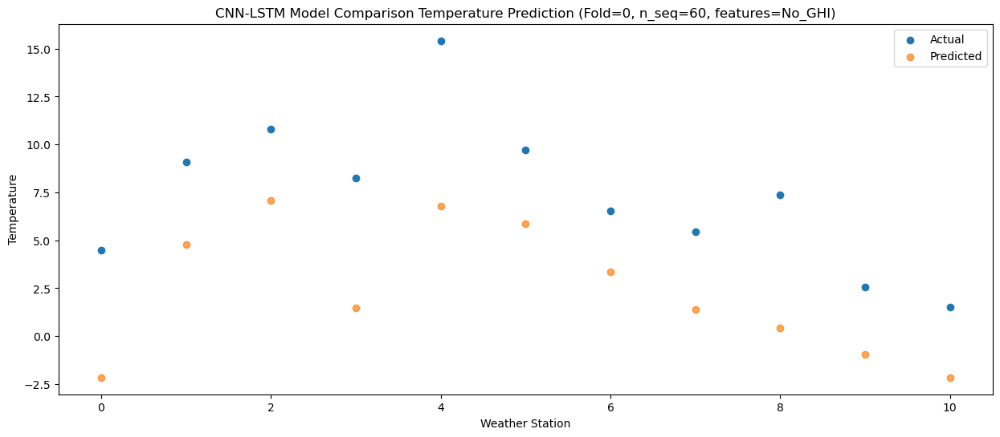

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66   4.418082
1                 1   13.38  11.338108
2                 2   16.58  13.648093
3                 3   12.77   8.038095
4                 4   20.13  13.358095
5                 5   14.33  12.428104
6                 6   11.59   9.918091
7                 7   10.43   7.978084
8                 8   14.20   6.998065
9                 9   10.73   5.618049
10               10   10.85   4.418038


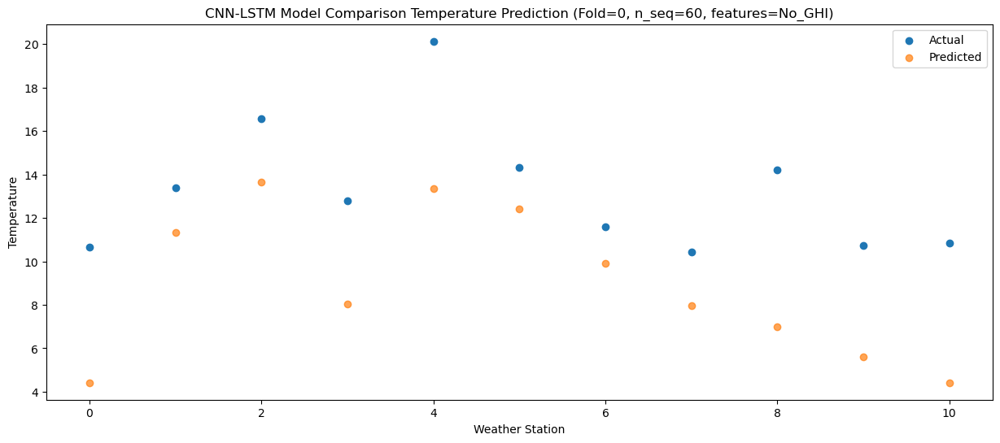

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87   8.615332
1                 1   17.07  15.535363
2                 2   20.36  17.845350
3                 3   15.20  12.235350
4                 4   24.47  17.555346
5                 5   17.90  16.625361
6                 6   15.50  14.115345
7                 7   14.43  12.175338
8                 8   18.72  11.195314
9                 9   14.63   9.815298
10               10   15.61   8.615285


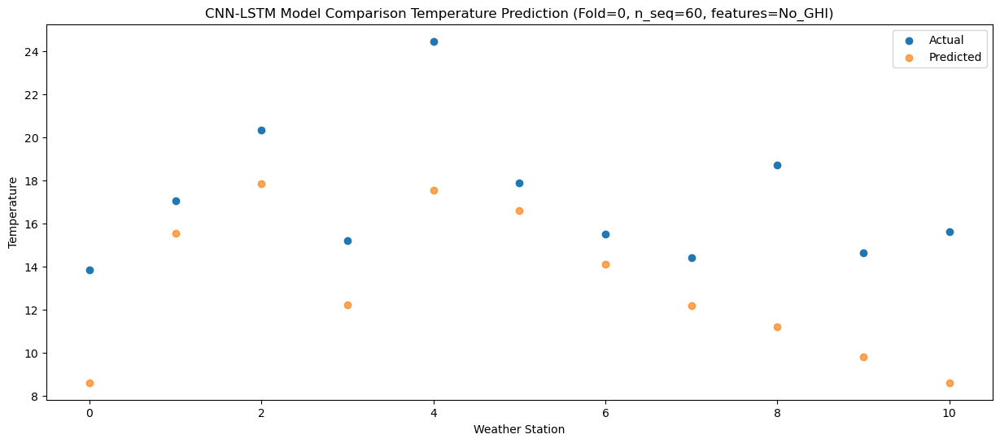

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  10.625387
1                 1   17.21  17.545413
2                 2   21.28  19.855400
3                 3   15.18  14.245400
4                 4   26.83  19.565396
5                 5   20.04  18.635415
6                 6   16.60  16.125398
7                 7   16.30  14.185389
8                 8   21.05  13.205369
9                 9   16.66  11.825353
10               10   16.72  10.625340


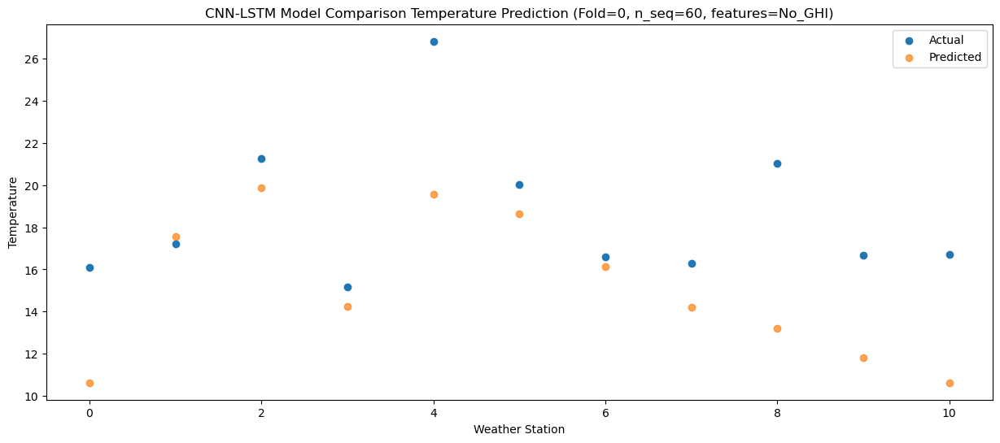

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91   9.299227
1                 1   16.66  16.219252
2                 2   20.05  18.529239
3                 3   13.99  12.919240
4                 4   24.47  18.239236
5                 5   19.19  17.309254
6                 6   15.31  14.799238
7                 7   14.62  12.859231
8                 8   18.17  11.879209
9                 9   14.75  10.499191
10               10   15.60   9.299181


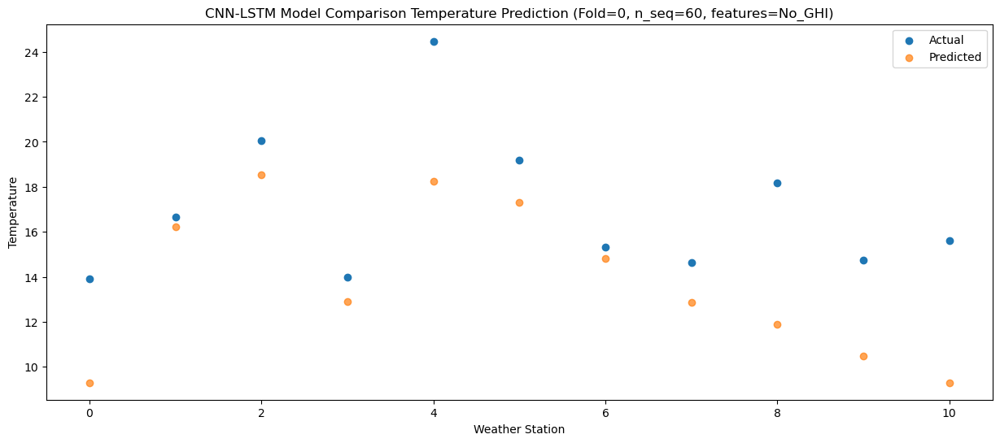

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94   5.689993
1                 1   15.64  12.610018
2                 2   16.93  14.920010
3                 3   12.75   9.310009
4                 4   21.52  14.629999
5                 5   16.54  13.700024
6                 6   12.25  11.190006
7                 7   10.92   9.249998
8                 8   14.53   8.269975
9                 9   11.02   6.889956
10               10   11.76   5.689943


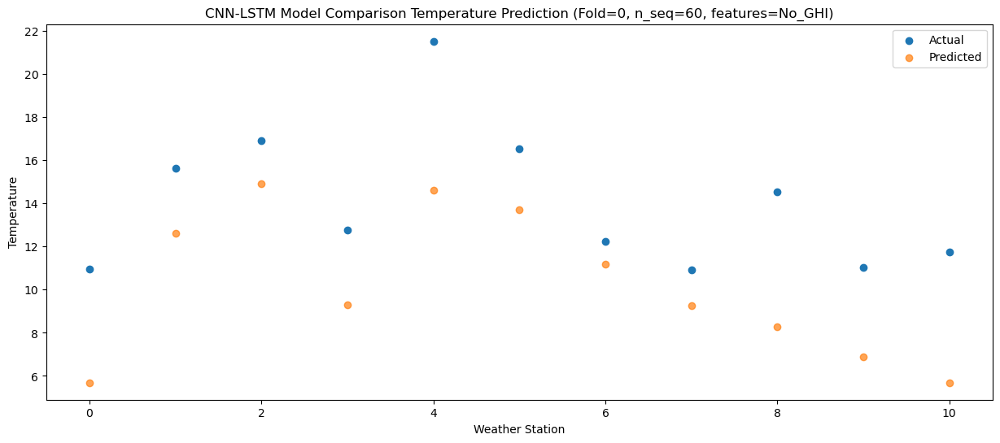

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26  -1.609525
1                 1   10.04   5.310496
2                 2    9.79   7.620489
3                 3    7.13   2.010490
4                 4   15.60   7.330481
5                 5    9.98   6.400504
6                 6    5.31   3.890486
7                 7    3.73   1.950479
8                 8    7.97   0.970457
9                 9    3.98  -0.409564
10               10    4.52  -1.609575


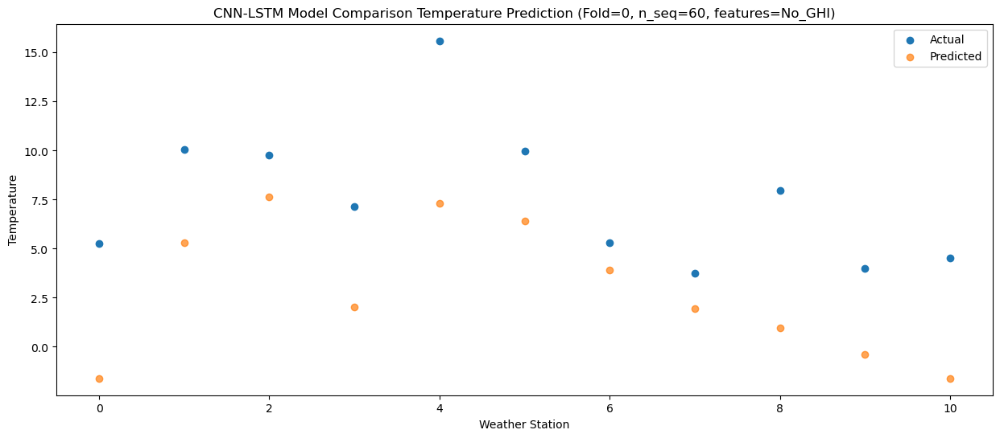

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -7.263090
1                 1    7.35  -0.343069
2                 2    7.31   1.966921
3                 3    3.02  -3.643078
4                 4    8.67   1.676916
5                 5    8.29   0.746937
6                 6    3.08  -1.763080
7                 7    1.53  -3.703088
8                 8    2.00  -4.683108
9                 9   -1.04  -6.063128
10               10   -0.51  -7.263138


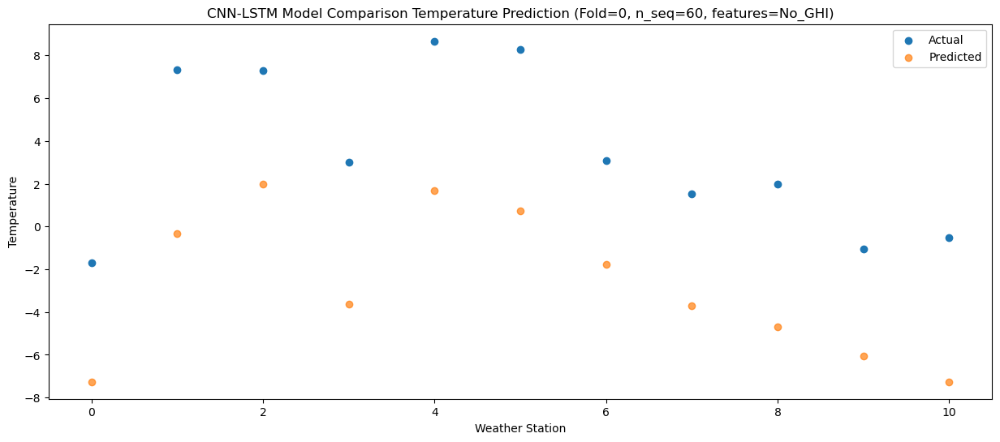

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78 -12.264889
1                 1    3.50  -5.344866
2                 2    2.79  -3.034876
3                 3    0.84  -8.644875
4                 4    5.94  -3.324881
5                 5    1.77  -4.254859
6                 6   -3.43  -6.764877
7                 7   -5.64  -8.704884
8                 8   -3.29  -9.684906
9                 9   -6.75 -11.064926
10               10   -6.69 -12.264935


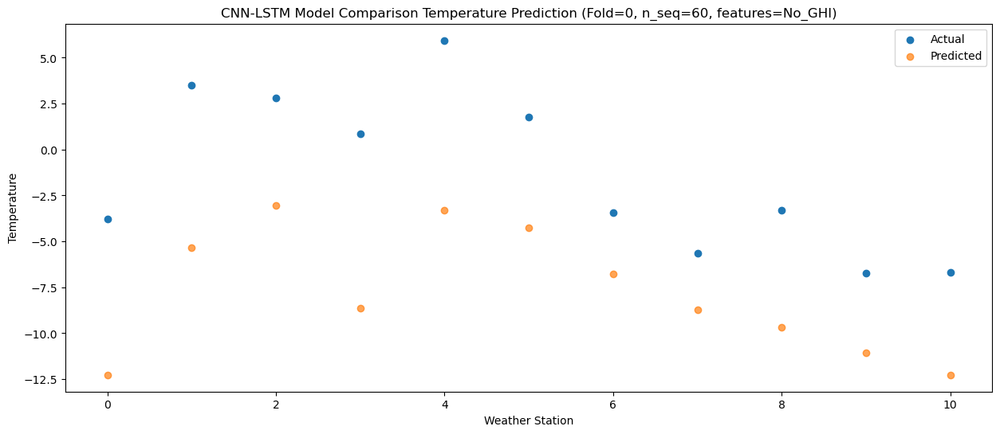

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14 -11.473775
1                 1    4.29  -4.553755
2                 2    4.74  -2.243766
3                 3    2.28  -7.853765
4                 4    6.91  -2.533767
5                 5    3.46  -3.463747
6                 6   -0.24  -5.973767
7                 7   -2.47  -7.913772
8                 8   -0.73  -8.893791
9                 9   -4.86 -10.273812
10               10   -5.56 -11.473817


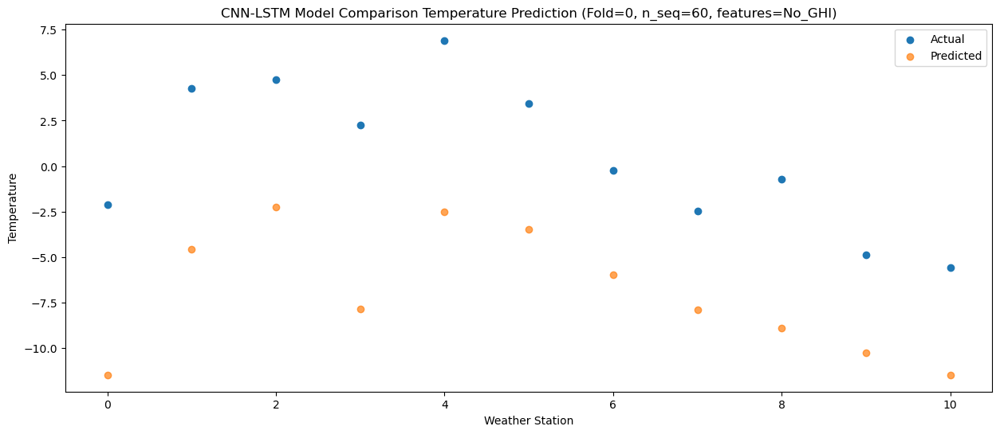

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61 -11.045634
1                 1    5.39  -4.125612
2                 2    7.52  -1.815627
3                 3    2.69  -7.425624
4                 4    7.04  -2.105626
5                 5    4.95  -3.035606
6                 6    2.76  -5.545626
7                 7    0.50  -7.485633
8                 8    0.88  -8.465652
9                 9   -2.82  -9.845670
10               10   -5.15 -11.045678


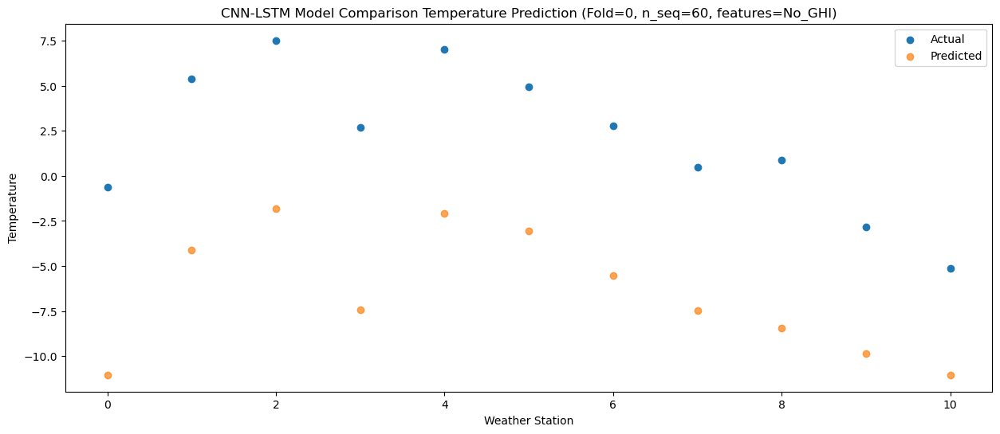

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -9.018811
1                 1    6.98  -2.098796
2                 2    7.50   0.211189
3                 3    6.21  -5.398809
4                 4   11.76  -0.078803
5                 5    5.86  -1.008790
6                 6    3.24  -3.518811
7                 7    1.18  -5.458818
8                 8    2.70  -6.438826
9                 9   -2.48  -7.818846
10               10   -3.29  -9.018851


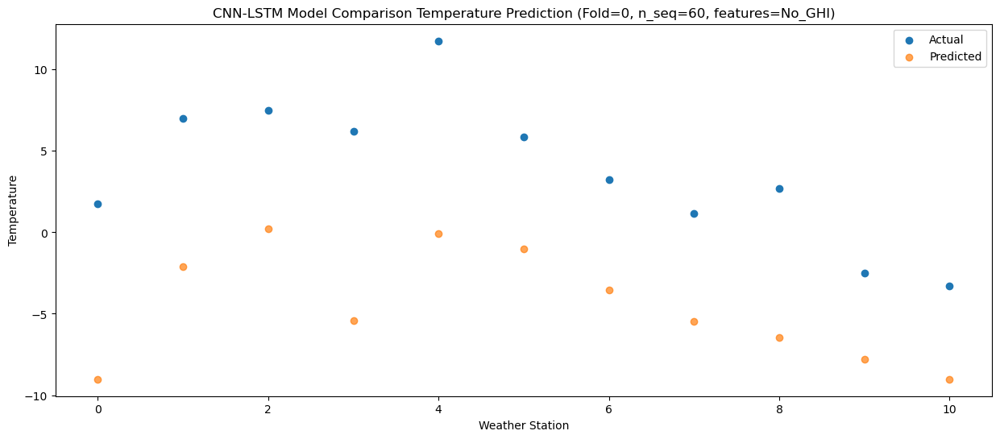

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38  -2.966954
1                 1    9.13   3.953055
2                 2   10.57   6.263040
3                 3    7.63   0.653043
4                 4   13.26   5.973052
5                 5   10.54   5.043059
6                 6    6.80   2.533042
7                 7    5.80   0.593037
8                 8    8.48  -0.386964
9                 9    3.80  -1.766987
10               10    3.56  -2.966986


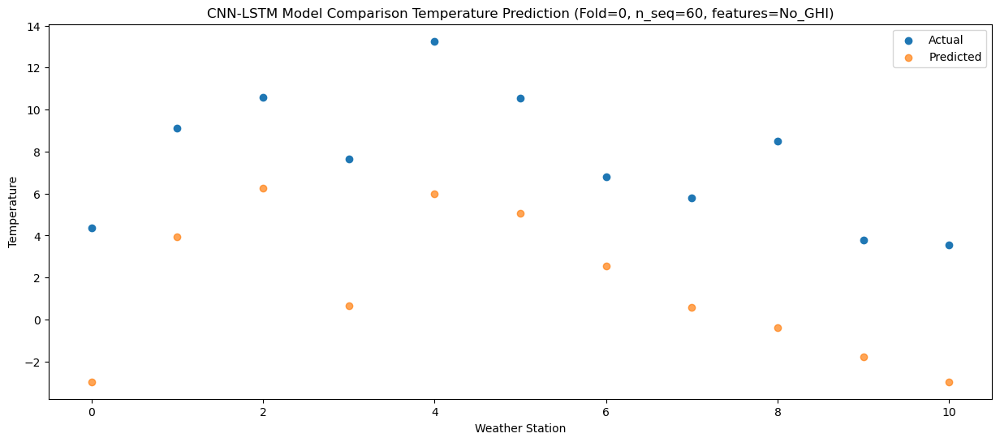

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   1.446757
1                 1   12.31   8.366764
2                 2   13.98  10.676751
3                 3   12.06   5.066754
4                 4   18.79  10.386764
5                 5   12.06   9.456768
6                 6    9.49   6.946753
7                 7    8.09   5.006746
8                 8   14.07   4.026747
9                 9    8.76   2.646724
10               10    8.58   1.446725


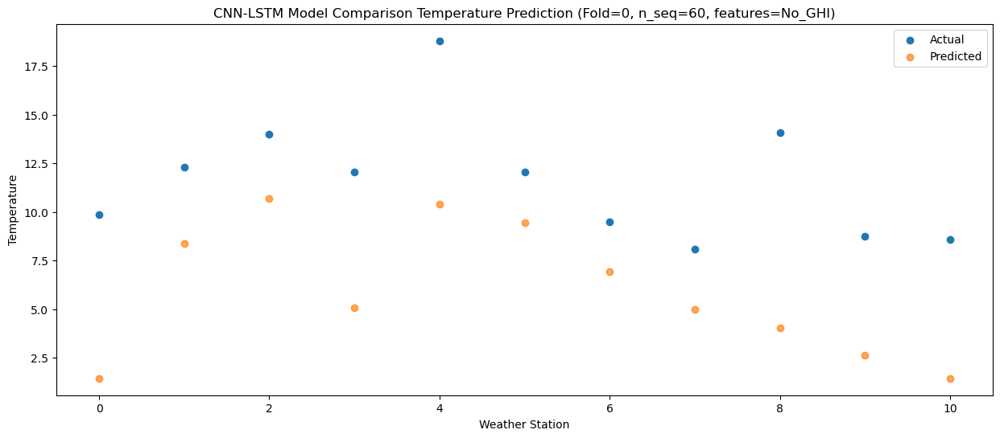

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63   5.076866
1                 1   15.39  11.996869
2                 2   17.30  14.306854
3                 3   15.81   8.696857
4                 4   23.34  14.016872
5                 5   15.88  13.086873
6                 6   12.84  10.576856
7                 7   11.84   8.636851
8                 8   17.94   7.656850
9                 9   12.60   6.276825
10               10   14.09   5.076826


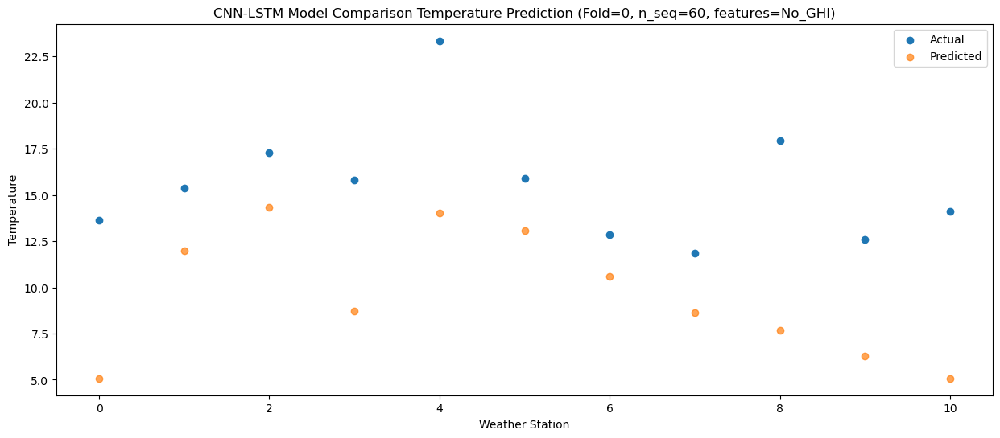

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17   8.224334
1                 1   17.22  15.144325
2                 2   20.40  17.454312
3                 3   16.93  11.844317
4                 4   26.33  17.164339
5                 5   19.71  16.234329
6                 6   16.55  13.724315
7                 7   15.98  11.784311
8                 8   19.43  10.804315
9                 9   15.43   9.424289
10               10   16.55   8.224290


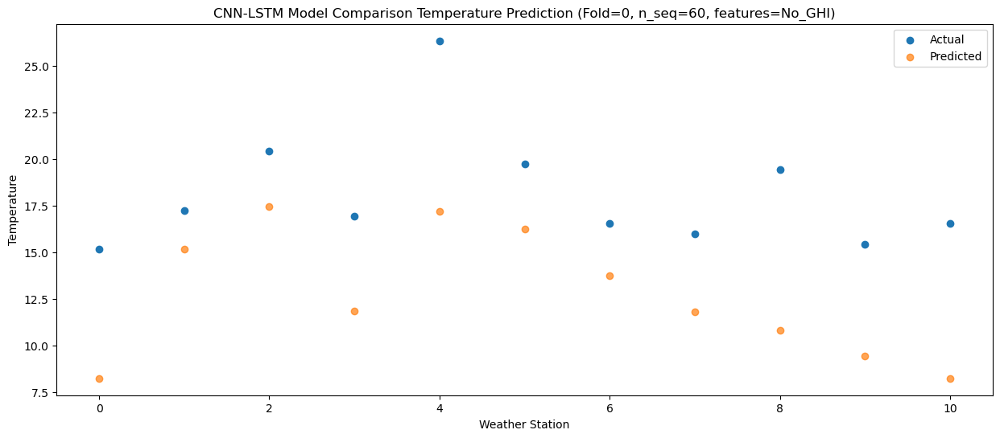

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89   7.223257
1                 1   18.81  14.143247
2                 2   20.01  16.453233
3                 3   18.46  10.843239
4                 4   28.07  16.163261
5                 5   19.23  15.233252
6                 6   15.86  12.723237
7                 7   14.84  10.783234
8                 8   18.17   9.803232
9                 9   14.63   8.423209
10               10   14.74   7.223209
84/84 [==============================] - 10s 115ms/step - loss: 0.0721 - accuracy: 0.5238 - mae: 0.0582 - rmse: 0.0721 - mape: inf - pearson: 0.8181 - val_loss: 0.0712 - val_accuracy: 0.6000 - val_mae: 0.0583 - val_rmse: 0.0712 - val_mape: 12.1924 - val_pearson: 0.8243
Epoch 4/100
84/84 [==============================] - 10s 116ms/step - loss: 0.0690 - accuracy: 0.4643 - mae: 0.0550 - rmse: 0.0690 - mape: inf - pearson: 0.8220 - val_loss: 0.0566 - val_accuracy: 0.6000 - val_mae: 0.0454 - val_rmse: 0.056

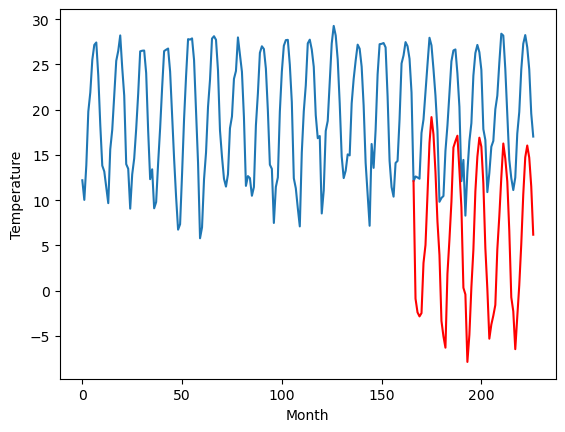

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		3.35		-0.17
2.61		1.84		-0.77
1.50		1.39		-0.11
1.59		1.76		0.17
7.59		7.30		-0.29
8.81		9.29		0.48
12.16		14.83		2.67
16.51		20.56		4.05
19.88		23.42		3.54
18.47		21.51		3.04
14.93		17.35		2.42
11.21		11.86		0.65
7.11		8.17		1.06
0.22		0.90		0.68
0.02		-0.81		-0.83
0.68		-2.06		-2.74
7.45		6.11		-1.34
9.59		9.88		0.29
13.32		14.06		0.74
17.46		20.06		2.60
18.84		20.76		1.92
19.11		21.37		2.26
15.37		17.57		2.20
11.59		13.46		1.87
3.93		4.56		0.63
5.56		3.82		-1.74
-1.17		-3.64		-2.47
3.06		-0.63		-3.69
6.63		4.61		-2.02
9.63		8.73		-0.90
15.51		15.21		-0.30
19.48		19.04		-0.44
19.98		21.15		1.17
18.52		20.15		1.63
15.43		16.08		0.65
9.09		8.95		-0.14
6.09		4.44		-1.65
0.28		-1.07		-1.35
2.47		0.49		-1.98
5.84		1.48		-4.36
6.61		2.65		-3.96
9.88		8.79		-1.09
13.16		12.47		-0.69
16.35		16.74		0.39
19.95		20.50		0.55
19.41		18.83		-0.58
15.90		16.30		0.40
10.89		10.83		-0.06
5.27		3.50		-

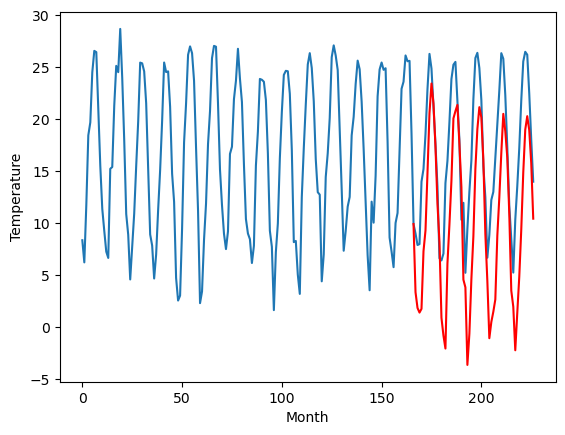

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		-0.50		0.98
-1.05		-2.01		-0.96
-1.58		-2.46		-0.88
-1.30		-2.09		-0.79
5.80		3.45		-2.35
4.83		5.44		0.61
8.98		10.98		2.00
13.21		16.71		3.50
14.68		19.57		4.89
14.67		17.66		2.99
11.87		13.50		1.63
7.52		8.01		0.49
2.72		4.32		1.60
-4.34		-2.95		1.39
-3.92		-4.66		-0.74
-3.43		-5.91		-2.48
3.63		2.26		-1.37
5.03		6.03		1.00
9.15		10.21		1.06
13.03		16.21		3.18
13.80		16.91		3.11
14.46		17.52		3.06
11.44		13.72		2.28
7.66		9.61		1.95
-0.08		0.71		0.79
2.52		-0.03		-2.55
-4.37		-7.49		-3.12
-1.02		-4.48		-3.46
2.98		0.76		-2.22
6.57		4.88		-1.69
11.93		11.36		-0.57
14.90		15.19		0.29
15.61		17.30		1.69
14.00		16.30		2.30
11.61		12.23		0.62
4.92		5.10		0.18
1.60		0.59		-1.01
-1.56		-4.92		-3.36
-0.56		-3.36		-2.80
2.03		-2.37		-4.40
3.46		-1.20		-4.66
6.15		4.94		-1.21
9.39		8.62		-0.77
13.14		12.89		-0.25
15.51		16.65		1.14
15.95		14.98		-0.97
12.99		12.45		-0.54
6.95		6.98		0.03
0.39

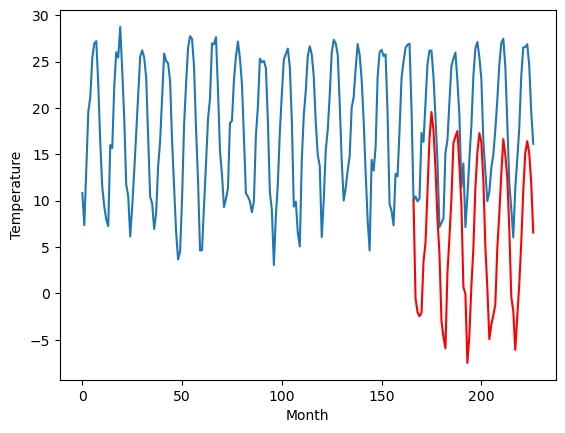

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		1.97		-2.08
2.63		0.46		-2.17
3.38		0.01		-3.37
2.85		0.38		-2.47
10.49		5.92		-4.57
10.37		7.91		-2.46
14.12		13.45		-0.67
16.90		19.18		2.28
18.55		22.04		3.49
18.79		20.13		1.34
15.38		15.97		0.59
10.84		10.48		-0.36
7.94		6.79		-1.15
1.76		-0.48		-2.24
1.66		-2.19		-3.85
0.07		-3.44		-3.51
7.44		4.73		-2.71
9.78		8.50		-1.28
13.67		12.68		-0.99
17.56		18.68		1.12
17.44		19.38		1.94
18.41		19.99		1.58
15.40		16.19		0.79
12.71		12.08		-0.63
5.55		3.18		-2.37
8.92		2.44		-6.48
0.87		-5.02		-5.89
0.40		-2.01		-2.41
6.24		3.23		-3.01
12.24		7.35		-4.89
16.67		13.83		-2.84
19.67		17.66		-2.01
20.61		19.77		-0.84
18.97		18.77		-0.20
16.20		14.70		-1.50
10.64		7.57		-3.07
5.59		3.06		-2.53
3.50		-2.45		-5.95
4.21		-0.89		-5.10
5.21		0.10		-5.11
9.04		1.27		-7.77
9.88		7.41		-2.47
14.47		11.09		-3.38
18.62		15.36		-3.26
20.34		19.12		-1.22
22.31		17.45		-4.86
19.23		14.92		-4.31
11.97		9.45	

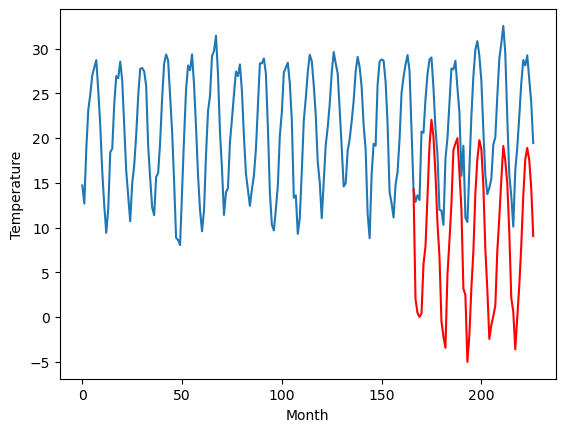

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		5.86		-2.25
6.22		4.35		-1.87
7.03		3.90		-3.13
6.65		4.27		-2.38
14.69		9.81		-4.88
14.43		11.80		-2.63
18.23		17.34		-0.89
21.26		23.07		1.81
23.30		25.93		2.63
23.54		24.02		0.48
19.96		19.86		-0.10
15.02		14.37		-0.65
11.92		10.68		-1.24
5.56		3.41		-2.15
5.55		1.70		-3.85
3.85		0.45		-3.40
11.46		8.62		-2.84
13.76		12.39		-1.37
17.88		16.57		-1.31
21.35		22.57		1.22
21.44		23.27		1.83
22.41		23.88		1.47
18.83		20.08		1.25
15.79		15.97		0.18
8.24		7.07		-1.17
12.12		6.33		-5.79
3.64		-1.13		-4.77
3.33		1.88		-1.45
9.11		7.12		-1.99
15.38		11.24		-4.14
20.00		17.72		-2.28
23.37		21.55		-1.82
24.46		23.66		-0.80
22.45		22.66		0.21
19.27		18.59		-0.68
13.88		11.46		-2.42
8.88		6.95		-1.93
6.86		1.44		-5.42
7.34		3.00		-4.34
8.52		3.99		-4.53
12.34		5.16		-7.18
13.30		11.30		-2.00
17.94		14.98		-2.96
22.83		19.25		-3.58
24.78		23.01		-1.77
26.21		21.34		-4.87
22.36		18.81		-3.55
14.96		

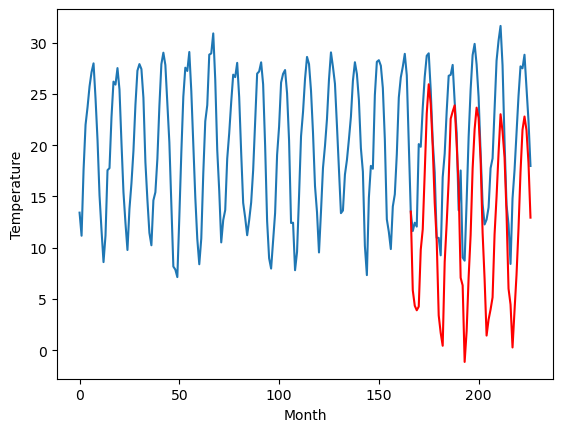

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		4.57		-3.23
5.77		3.06		-2.71
5.11		2.61		-2.50
4.59		2.98		-1.61
11.94		8.52		-3.42
14.73		10.51		-4.22
19.92		16.05		-3.87
22.64		21.78		-0.86
25.34		24.64		-0.70
25.19		22.73		-2.46
17.66		18.57		0.91
14.82		13.08		-1.74
11.10		9.39		-1.71
4.35		2.12		-2.23
2.84		0.41		-2.43
3.22		-0.84		-4.06
10.56		7.33		-3.23
12.83		11.10		-1.73
18.42		15.28		-3.14
22.69		21.28		-1.41
22.03		21.98		-0.05
21.44		22.59		1.15
21.08		18.79		-2.29
16.76		14.68		-2.08
10.29		5.78		-4.51
10.55		5.04		-5.51
3.23		-2.42		-5.65
3.12		0.59		-2.53
10.07		5.83		-4.24
16.98		9.95		-7.03
22.38		16.43		-5.95
24.44		20.26		-4.18
25.36		22.37		-2.99
22.51		21.37		-1.14
19.46		17.30		-2.16
13.38		10.17		-3.21
6.42		5.66		-0.76
5.30		0.15		-5.15
5.76		1.71		-4.05
5.90		2.70		-3.20
10.96		3.87		-7.09
14.12		10.01		-4.11
18.73		13.69		-5.04
25.42		17.96		-7.46
26.52		21.72		-4.80
25.71		20.05		-5.66
23.43		17.52		-5.91

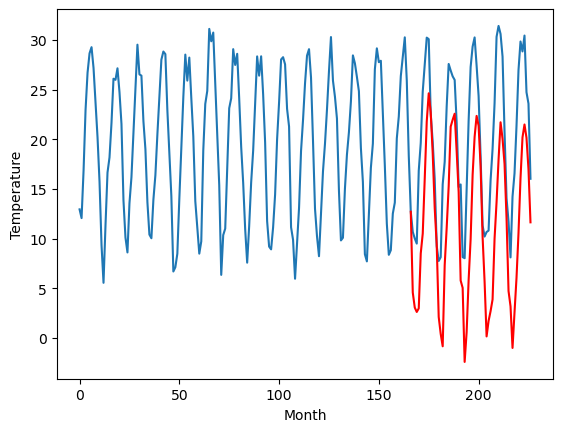

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		4.10		0.22
3.15		2.59		-0.56
2.34		2.14		-0.20
2.41		2.51		0.10
8.08		8.05		-0.03
9.71		10.04		0.33
12.49		15.58		3.09
17.16		21.31		4.15
20.34		24.17		3.83
18.71		22.26		3.55
15.29		18.10		2.81
11.80		12.61		0.81
7.65		8.92		1.27
0.44		1.65		1.21
0.24		-0.06		-0.30
1.02		-1.31		-2.33
7.30		6.86		-0.44
9.87		10.63		0.76
13.64		14.81		1.17
17.65		20.81		3.16
19.01		21.51		2.50
19.27		22.12		2.85
15.94		18.32		2.38
11.99		14.21		2.22
4.39		5.31		0.92
5.91		4.57		-1.34
-0.48		-2.89		-2.41
3.33		0.12		-3.21
7.17		5.36		-1.81
9.93		9.48		-0.45
15.85		15.96		0.11
19.43		19.79		0.36
20.17		21.90		1.73
18.67		20.90		2.23
15.78		16.83		1.05
9.44		9.70		0.26
6.55		5.19		-1.36
0.54		-0.32		-0.86
2.67		1.24		-1.43
6.26		2.23		-4.03
6.93		3.40		-3.53
10.19		9.54		-0.65
13.19		13.22		0.03
16.47		17.49		1.02
19.92		21.25		1.33
19.50		19.58		0.08
16.33		17.05		0.72
11.32		11.58		0.26
5.63		4.25		-1.38


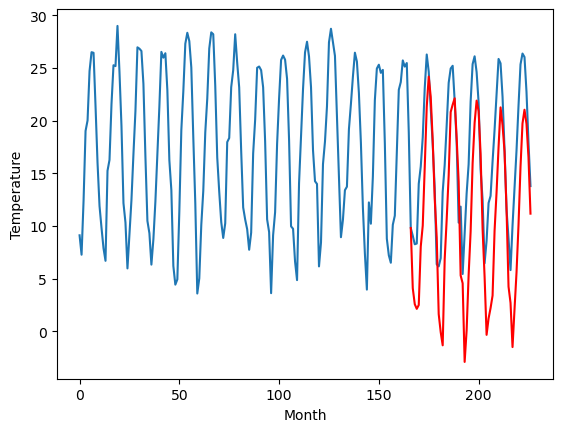

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.27		-0.65
0.30		-1.24		-1.54
-0.55		-1.69		-1.14
0.13		-1.32		-1.45
7.05		4.22		-2.83
8.19		6.21		-1.98
12.69		11.75		-0.94
18.25		17.48		-0.77
20.79		20.34		-0.45
18.77		18.43		-0.34
15.47		14.27		-1.20
8.70		8.78		0.08
5.03		5.09		0.06
-1.57		-2.18		-0.61
-1.88		-3.89		-2.01
-4.88		-5.14		-0.26
6.44		3.03		-3.41
8.15		6.80		-1.35
12.81		10.98		-1.83
18.89		16.98		-1.91
19.88		17.68		-2.20
21.10		18.29		-2.81
17.39		14.49		-2.90
12.19		10.38		-1.81
2.89		1.48		-1.41
5.30		0.74		-4.56
-3.53		-6.72		-3.19
-1.48		-3.71		-2.23
4.47		1.53		-2.94
9.66		5.65		-4.01
15.13		12.13		-3.00
19.19		15.96		-3.23
23.32		18.07		-5.25
20.45		17.07		-3.38
16.61		13.00		-3.61
9.94		5.87		-4.07
3.34		1.36		-1.98
-0.40		-4.15		-3.75
0.79		-2.59		-3.38
2.29		-1.60		-3.89
5.12		-0.43		-5.55
9.52		5.71		-3.81
14.87		9.39		-5.48
18.68		13.66		-5.02
20.98		17.42		-3.56
21.48		15.75		-5.73
17.86		13.22		-4.64
1

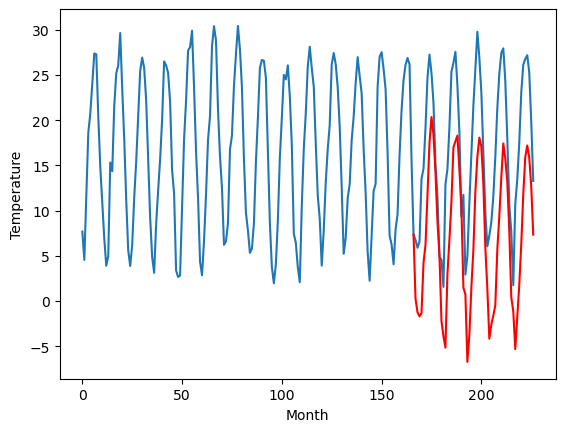

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-1.16		-1.60
-1.41		-2.67		-1.26
-1.23		-3.12		-1.89
-1.74		-2.75		-1.01
6.09		2.79		-3.30
7.47		4.78		-2.69
13.58		10.32		-3.26
18.69		16.05		-2.64
21.23		18.91		-2.32
20.30		17.00		-3.30
13.65		12.84		-0.81
7.47		7.35		-0.12
4.59		3.66		-0.93
-2.09		-3.61		-1.52
-2.44		-5.32		-2.88
-7.22		-6.57		0.65
5.34		1.60		-3.74
7.14		5.37		-1.77
11.95		9.55		-2.40
17.98		15.55		-2.43
19.49		16.25		-3.24
19.88		16.86		-3.02
17.37		13.06		-4.31
11.12		8.95		-2.17
3.37		0.05		-3.32
2.56		-0.69		-3.25
-5.06		-8.15		-3.09
-4.08		-5.14		-1.06
3.17		0.10		-3.07
10.28		4.22		-6.06
15.64		10.70		-4.94
19.93		14.53		-5.40
24.08		16.64		-7.44
21.41		15.64		-5.77
17.58		11.57		-6.01
9.35		4.44		-4.91
1.50		-0.07		-1.57
-2.13		-5.58		-3.45
-1.27		-4.02		-2.75
-0.90		-3.03		-2.13
3.53		-1.86		-5.39
7.86		4.28		-3.58
13.55		7.96		-5.59
18.48		12.23		-6.25
21.36		15.99		-5.37
23.17		14.32		-8.85
18.53		11.79		

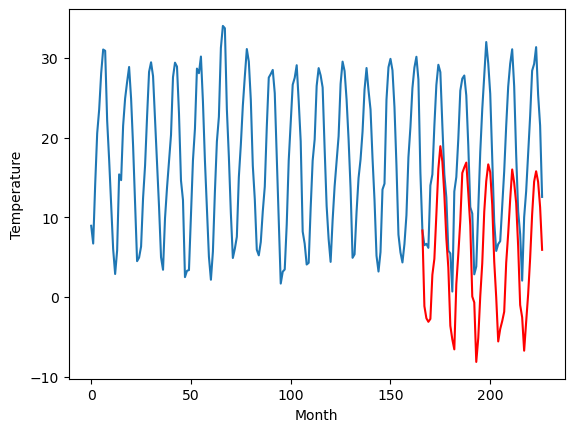

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.08		-4.60
3.32		-1.43		-4.75
2.87		-1.88		-4.75
1.63		-1.51		-3.14
9.59		4.03		-5.56
11.90		6.02		-5.88
18.43		11.56		-6.87
24.81		17.29		-7.52
26.39		20.15		-6.24
25.16		18.24		-6.92
18.41		14.08		-4.33
11.81		8.59		-3.22
8.63		4.90		-3.73
1.36		-2.37		-3.73
1.47		-4.08		-5.55
-2.90		-5.33		-2.43
7.81		2.84		-4.97
11.57		6.61		-4.96
16.12		10.79		-5.33
23.23		16.79		-6.44
23.90		17.49		-6.41
23.75		18.10		-5.65
21.80		14.30		-7.50
14.36		10.19		-4.17
8.11		1.29		-6.82
6.50		0.55		-5.95
-0.42		-6.91		-6.49
-0.36		-3.90		-3.54
6.57		1.34		-5.23
13.05		5.46		-7.59
18.50		11.94		-6.56
23.07		15.77		-7.30
26.67		17.88		-8.79
23.84		16.88		-6.96
21.43		12.81		-8.62
12.89		5.68		-7.21
3.90		1.17		-2.73
1.55		-4.34		-5.89
1.83		-2.78		-4.61
2.98		-1.79		-4.77
6.71		-0.62		-7.33
12.06		5.52		-6.54
17.17		9.20		-7.97
20.40		13.47		-6.93
25.02		17.23		-7.79
25.42		15.56		-9.86
21.90		13.03		-8

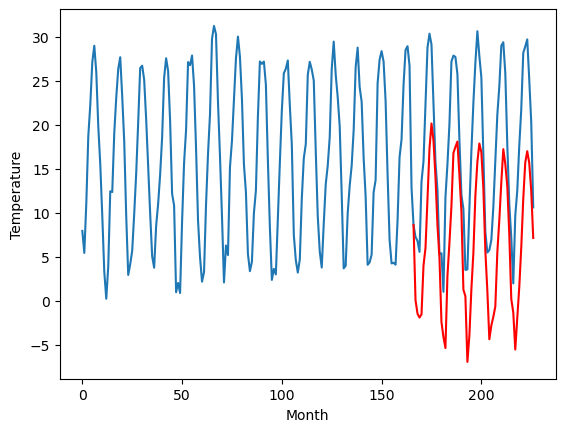

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-0.89		0.67
-4.37		-2.40		1.97
-4.03		-2.85		1.18
-3.29		-2.48		0.81
1.03		3.06		2.03
2.66		5.05		2.39
8.12		10.59		2.47
15.44		16.32		0.88
19.31		19.18		-0.13
17.12		17.27		0.15
12.59		13.11		0.52
7.05		7.62		0.57
2.85		3.93		1.08
-4.16		-3.34		0.82
-6.00		-5.05		0.95
-6.96		-6.30		0.66
0.26		1.87		1.61
4.91		5.64		0.73
9.45		9.82		0.37
15.54		15.82		0.28
17.77		16.52		-1.25
17.55		17.13		-0.42
13.85		13.33		-0.52
9.43		9.22		-0.21
0.11		0.32		0.21
-0.66		-0.42		0.24
-7.68		-7.88		-0.20
-3.78		-4.87		-1.09
0.78		0.37		-0.41
4.13		4.49		0.36
11.11		10.97		-0.14
15.50		14.80		-0.70
19.44		16.91		-2.53
18.90		15.91		-2.99
13.99		11.84		-2.15
5.89		4.71		-1.18
2.38		0.20		-2.18
-4.77		-5.31		-0.54
-1.81		-3.75		-1.94
-2.13		-2.76		-0.63
-1.01		-1.59		-0.58
6.21		4.55		-1.66
8.77		8.23		-0.54
13.14		12.50		-0.64
18.28		16.26		-2.02
16.54		14.59		-1.95
13.35		12.06		-1.29
8.00		6.59		-1.41

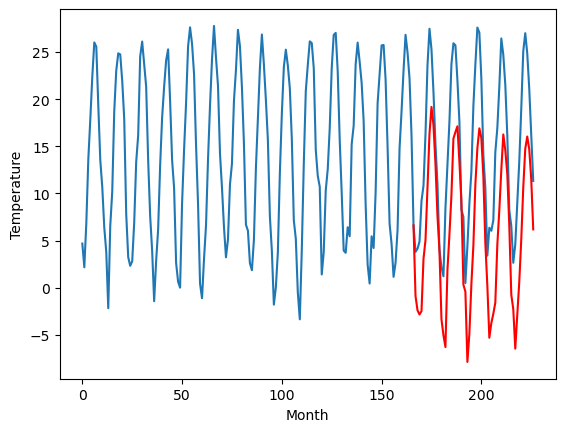

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -0.887640
1                 1    3.52   3.352363
2                 2   -1.48  -0.497638
3                 3    4.05   1.972363
4                 4    8.11   5.862363
5                 5    7.80   4.572363
6                 6    3.88   4.102363
7                 7    0.92   0.272365
8                 8    0.44  -1.157635
9                 9    4.68   0.082364
10               10   -1.56  -0.887637


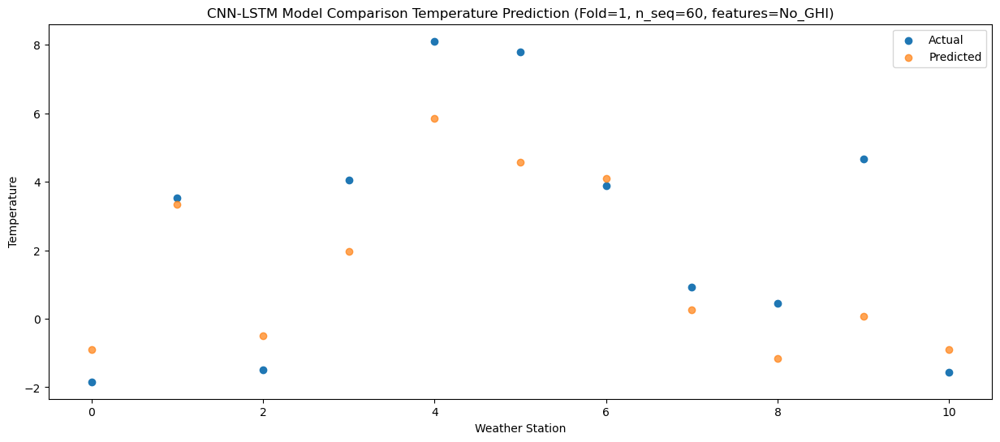

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -2.401541
1                 1    2.61   1.838458
2                 2   -1.05  -2.011541
3                 3    2.63   0.458460
4                 4    6.22   4.348458
5                 5    5.77   3.058459
6                 6    3.15   2.588459
7                 7    0.30  -1.241549
8                 8   -1.41  -2.671548
9                 9    3.32  -1.431550
10               10   -4.37  -2.401545


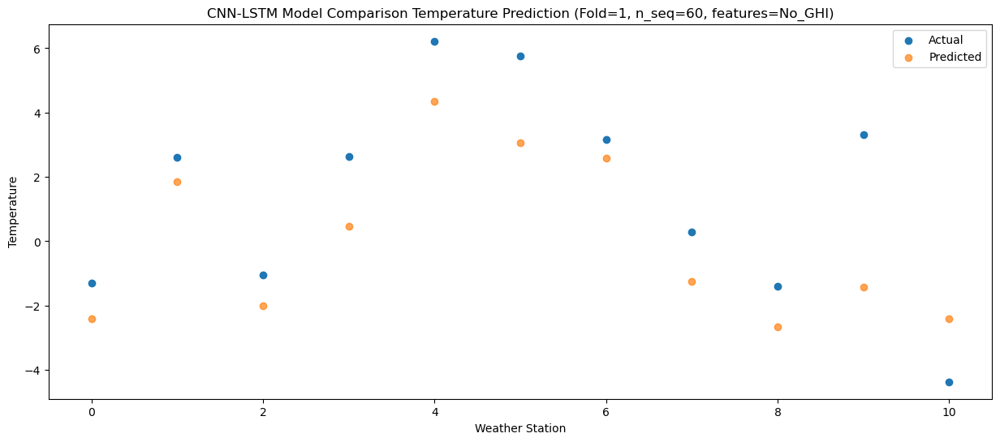

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.846343
1                 1    1.50   1.393645
2                 2   -1.58  -2.456351
3                 3    3.38   0.013648
4                 4    7.03   3.903645
5                 5    5.11   2.613646
6                 6    2.34   2.143646
7                 7   -0.55  -1.686382
8                 8   -1.23  -3.116383
9                 9    2.87  -1.876381
10               10   -4.03  -2.846369


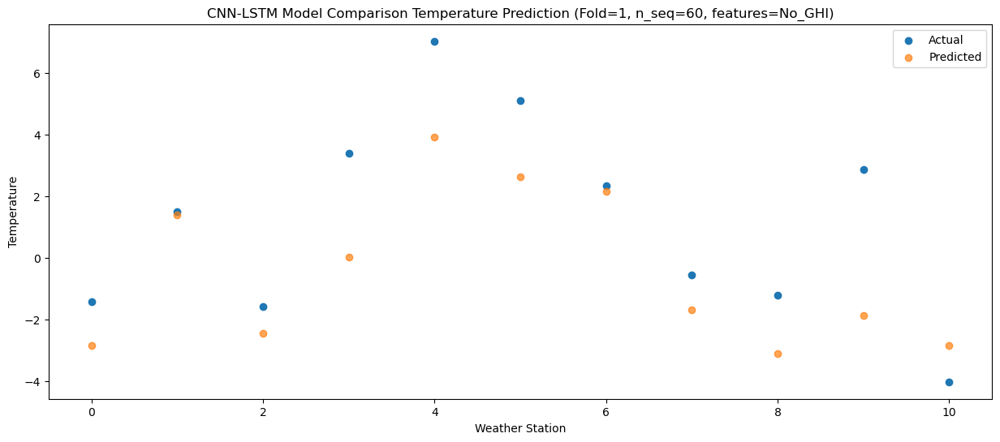

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -2.484424
1                 1    1.59   1.755568
2                 2   -1.30  -2.094428
3                 3    2.85   0.375571
4                 4    6.65   4.265566
5                 5    4.59   2.975569
6                 6    2.41   2.505567
7                 7    0.13  -1.324460
8                 8   -1.74  -2.754463
9                 9    1.63  -1.514461
10               10   -3.29  -2.484451


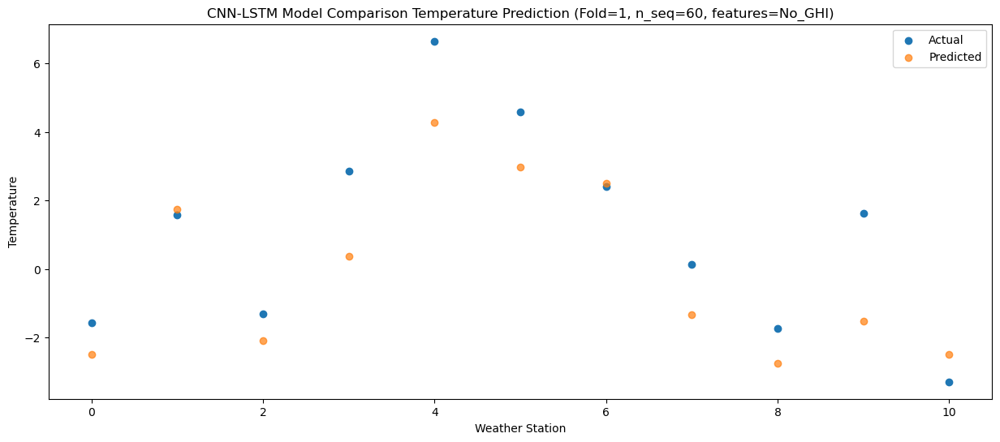

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.055593
1                 1    7.59   7.295583
2                 2    5.80   3.445587
3                 3   10.49   5.915588
4                 4   14.69   9.805581
5                 5   11.94   8.515584
6                 6    8.08   8.045580
7                 7    7.05   4.215553
8                 8    6.09   2.785548
9                 9    9.59   4.025554
10               10    1.03   3.055561


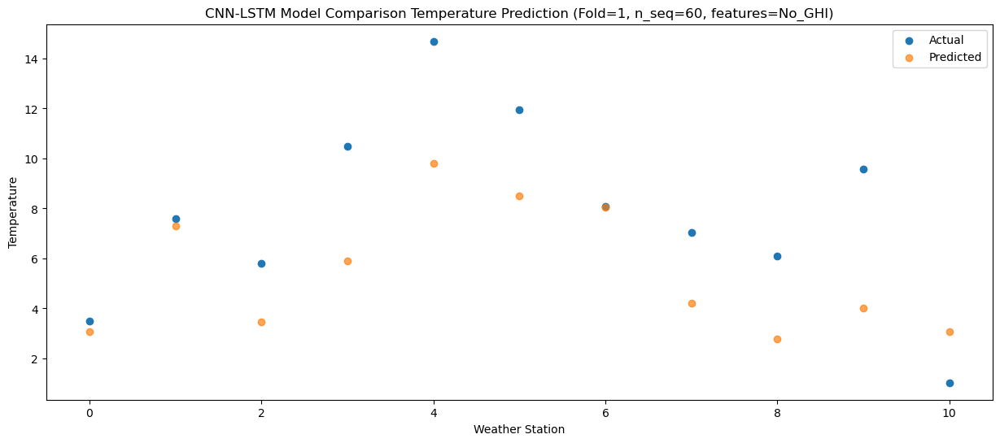

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.049773
1                 1    8.81   9.289767
2                 2    4.83   5.439771
3                 3   10.37   7.909772
4                 4   14.43  11.799765
5                 5   14.73  10.509768
6                 6    9.71  10.039764
7                 7    8.19   6.209748
8                 8    7.47   4.779745
9                 9   11.90   6.019749
10               10    2.66   5.049749


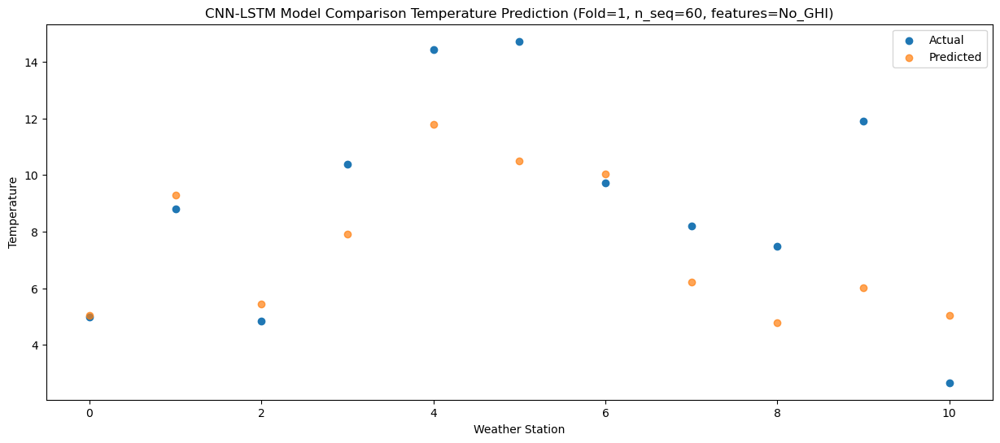

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  10.593766
1                 1   12.16  14.833756
2                 2    8.98  10.983760
3                 3   14.12  13.453761
4                 4   18.23  17.343754
5                 5   19.92  16.053757
6                 6   12.49  15.583753
7                 7   12.69  11.753729
8                 8   13.58  10.323722
9                 9   18.43  11.563730
10               10    8.12  10.593734


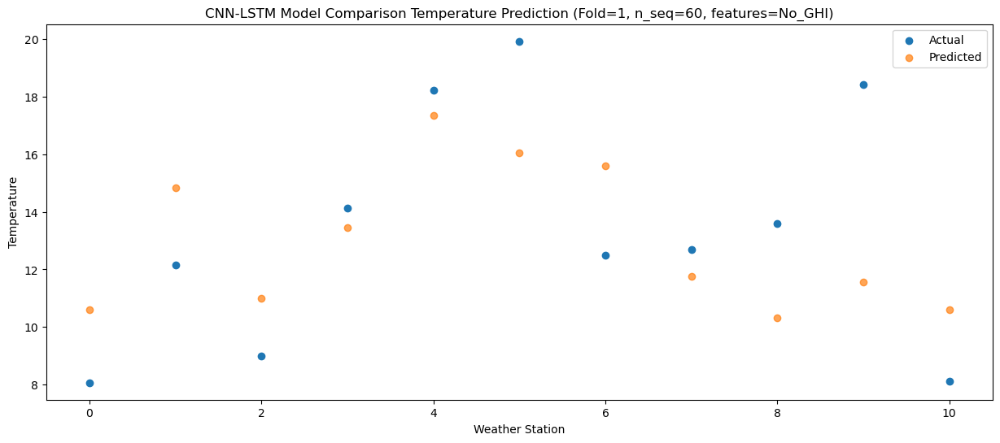

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  16.319645
1                 1   16.51  20.559622
2                 2   13.21  16.709628
3                 3   16.90  19.179628
4                 4   21.26  23.069620
5                 5   22.64  21.779625
6                 6   17.16  21.309619
7                 7   18.25  17.479587
8                 8   18.69  16.049582
9                 9   24.81  17.289590
10               10   15.44  16.319597


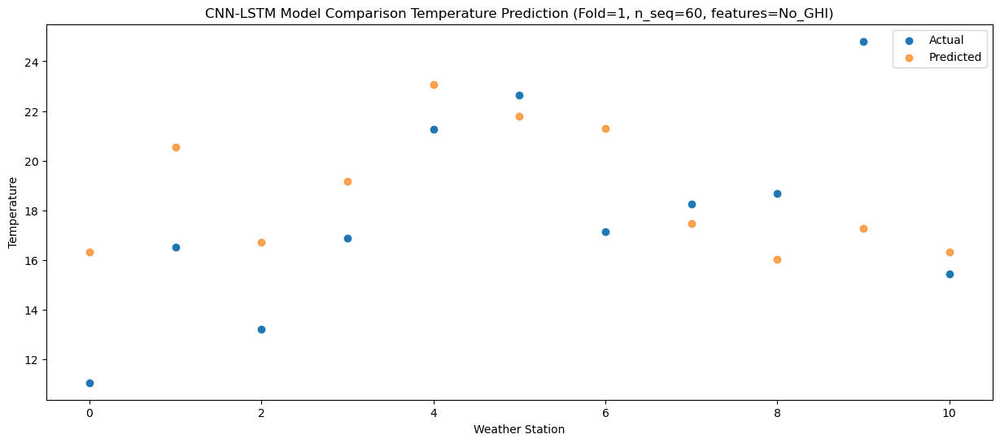

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  19.181958
1                 1   19.88  23.421935
2                 2   14.68  19.571943
3                 3   18.55  22.041946
4                 4   23.30  25.931935
5                 5   25.34  24.641940
6                 6   20.34  24.171934
7                 7   20.79  20.341904
8                 8   21.23  18.911902
9                 9   26.39  20.151905
10               10   19.31  19.181913


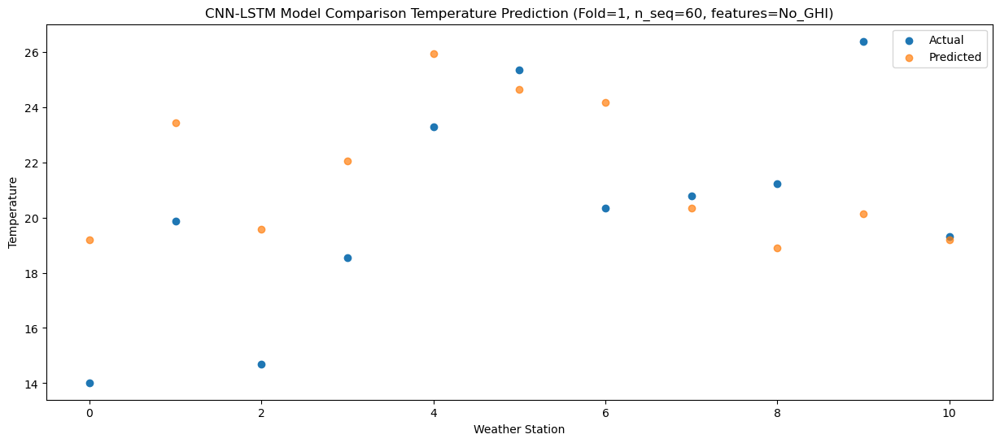

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  17.267122
1                 1   18.47  21.507096
2                 2   14.67  17.657106
3                 3   18.79  20.127109
4                 4   23.54  24.017095
5                 5   25.19  22.727100
6                 6   18.71  22.257097
7                 7   18.77  18.427059
8                 8   20.30  16.997055
9                 9   25.16  18.237058
10               10   17.12  17.267070


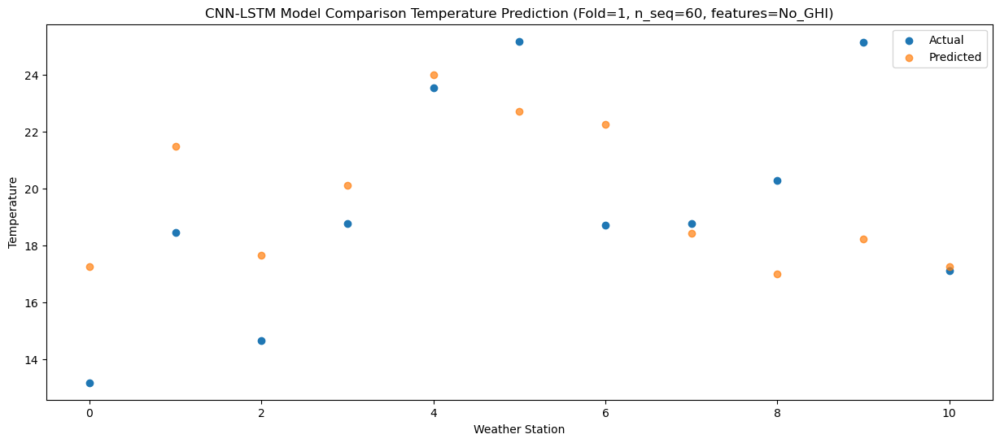

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  13.114284
1                 1   14.93  17.354259
2                 2   11.87  13.504270
3                 3   15.38  15.974271
4                 4   19.96  19.864256
5                 5   17.66  18.574261
6                 6   15.29  18.104260
7                 7   15.47  14.274221
8                 8   13.65  12.844216
9                 9   18.41  14.084220
10               10   12.59  13.114230


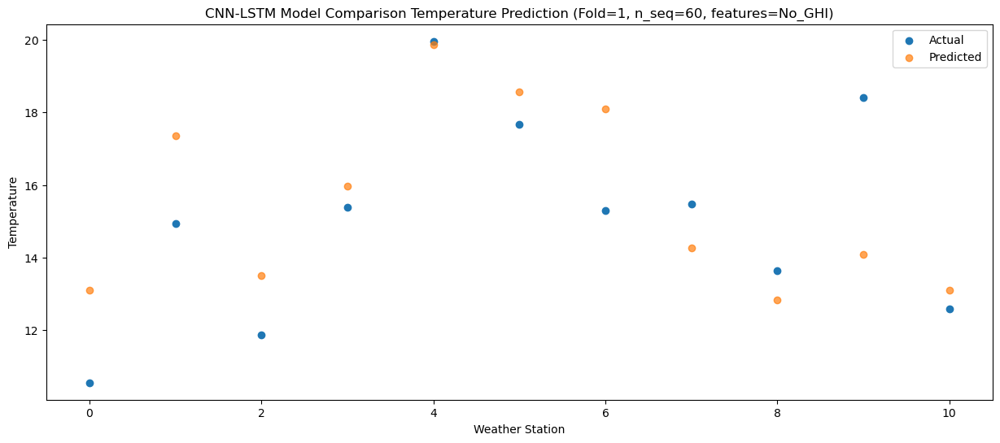

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   7.623576
1                 1   11.21  11.863546
2                 2    7.52   8.013557
3                 3   10.84  10.483560
4                 4   15.02  14.373542
5                 5   14.82  13.083548
6                 6   11.80  12.613547
7                 7    8.70   8.783499
8                 8    7.47   7.353494
9                 9   11.81   8.593501
10               10    7.05   7.623512


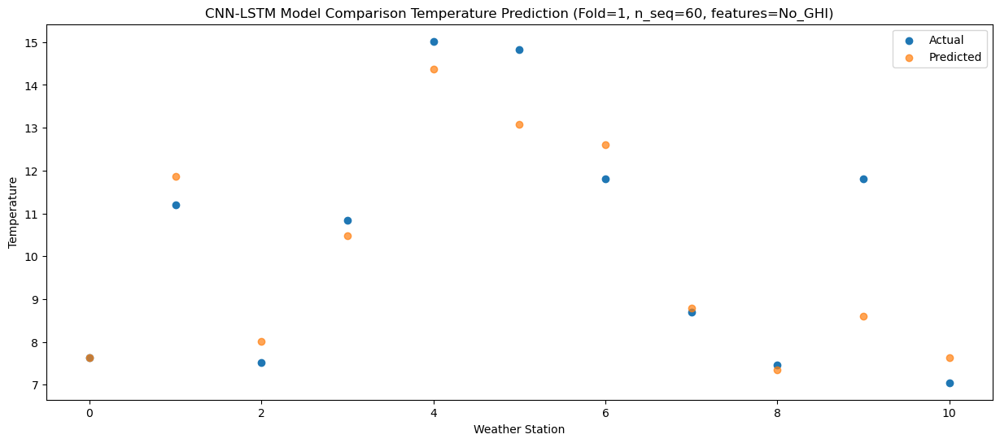

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.934568
1                 1    7.11   8.174538
2                 2    2.72   4.324551
3                 3    7.94   6.794554
4                 4   11.92  10.684536
5                 5   11.10   9.394540
6                 6    7.65   8.924541
7                 7    5.03   5.094495
8                 8    4.59   3.664492
9                 9    8.63   4.904497
10               10    2.85   3.934506


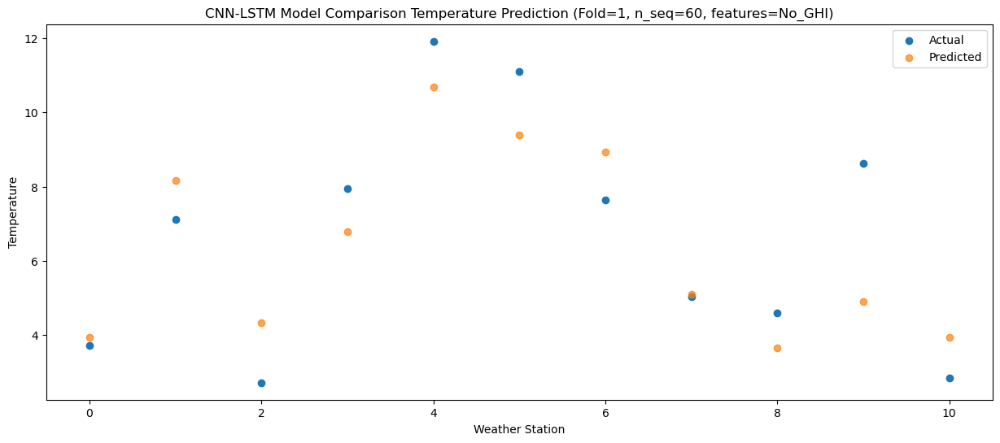

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -3.343843
1                 1    0.22   0.896127
2                 2   -4.34  -2.953861
3                 3    1.76  -0.483858
4                 4    5.56   3.406125
5                 5    4.35   2.116128
6                 6    0.44   1.646129
7                 7   -1.57  -2.183919
8                 8   -2.09  -3.613922
9                 9    1.36  -2.373917
10               10   -4.16  -3.343906


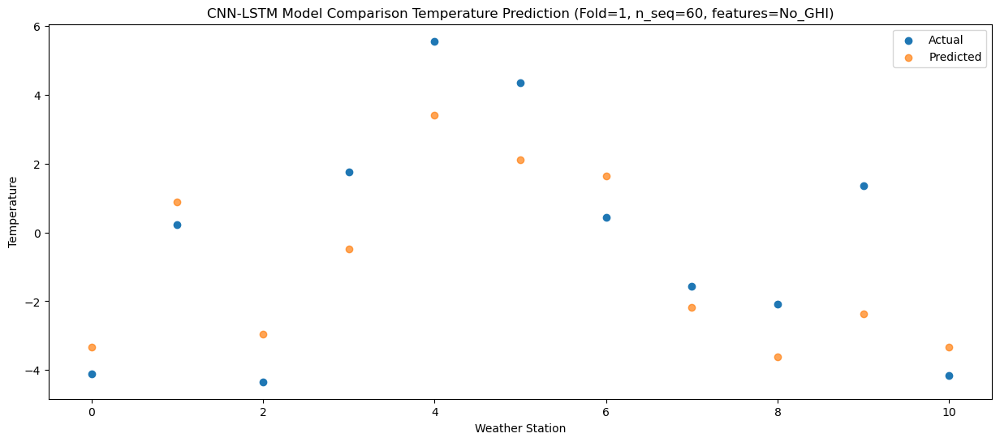

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -5.053770
1                 1    0.02  -0.813801
2                 2   -3.92  -4.663790
3                 3    1.66  -2.193785
4                 4    5.55   1.696199
5                 5    2.84   0.406202
6                 6    0.24  -0.063799
7                 7   -1.88  -3.893852
8                 8   -2.44  -5.323855
9                 9    1.47  -4.083852
10               10   -6.00  -5.053835


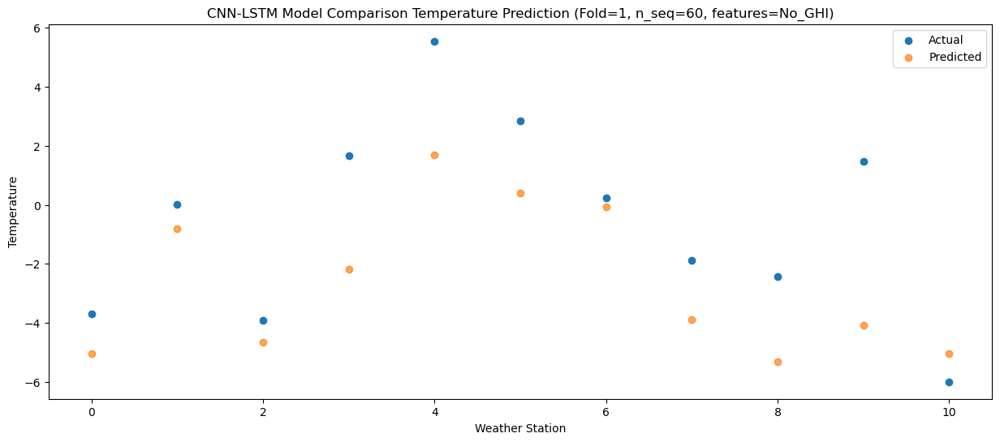

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -6.304482
1                 1    0.68  -2.064522
2                 2   -3.43  -5.914512
3                 3    0.07  -3.444508
4                 4    3.85   0.445476
5                 5    3.22  -0.844521
6                 6    1.02  -1.314521
7                 7   -4.88  -5.144590
8                 8   -7.22  -6.574597
9                 9   -2.90  -5.334588
10               10   -6.96  -6.304567


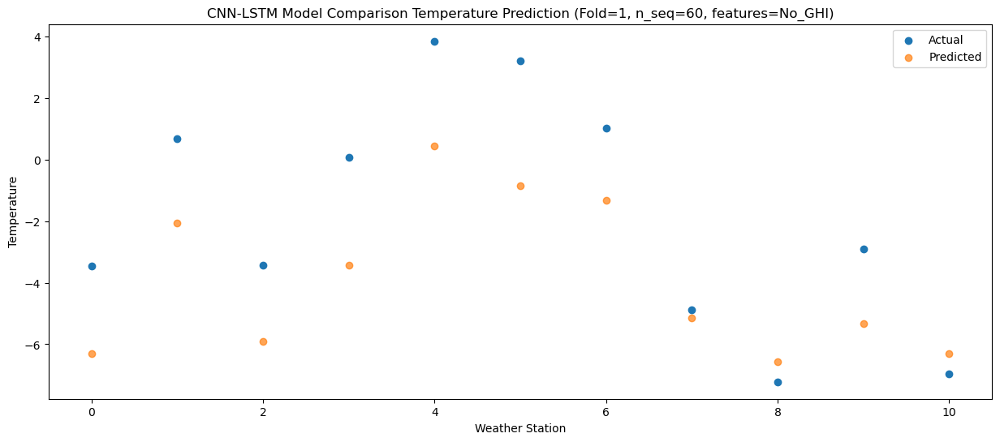

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   1.865286
1                 1    7.45   6.105246
2                 2    3.63   2.255256
3                 3    7.44   4.725257
4                 4   11.46   8.615240
5                 5   10.56   7.325243
6                 6    7.30   6.855247
7                 7    6.44   3.025190
8                 8    5.34   1.595179
9                 9    7.81   2.835188
10               10    0.26   1.865202


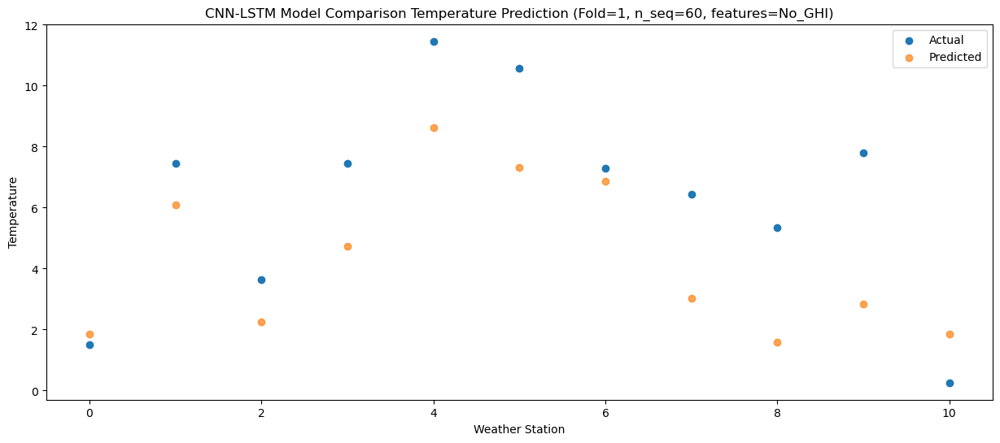

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   5.638918
1                 1    9.59   9.878879
2                 2    5.03   6.028886
3                 3    9.78   8.498891
4                 4   13.76  12.388871
5                 5   12.83  11.098876
6                 6    9.87  10.628880
7                 7    8.15   6.798818
8                 8    7.14   5.368809
9                 9   11.57   6.608816
10               10    4.91   5.638832


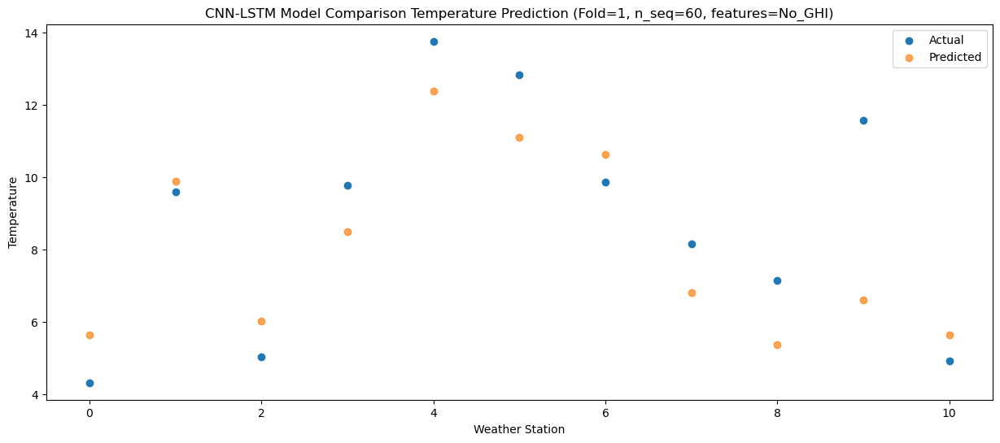

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93   9.821220
1                 1   13.32  14.061182
2                 2    9.15  10.211190
3                 3   13.67  12.681195
4                 4   17.88  16.571175
5                 5   18.42  15.281180
6                 6   13.64  14.811183
7                 7   12.81  10.981107
8                 8   11.95   9.551098
9                 9   16.12  10.791107
10               10    9.45   9.821124


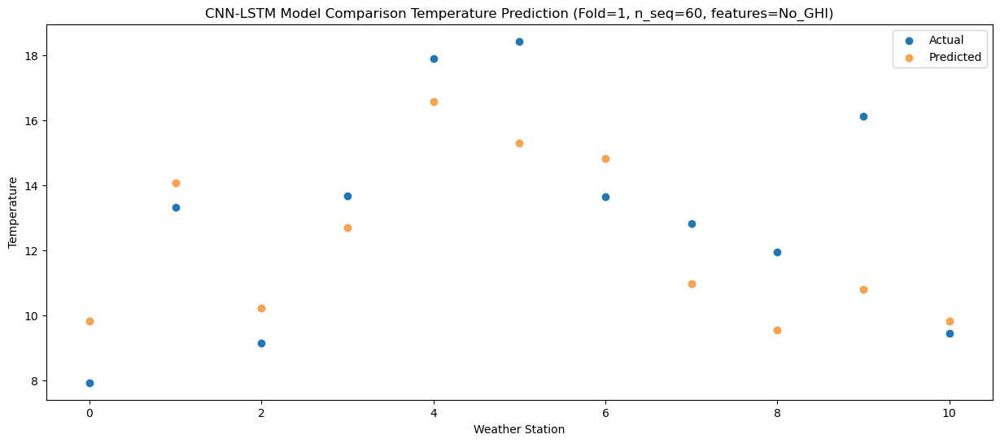

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  15.823440
1                 1   17.46  20.063406
2                 2   13.03  16.213415
3                 3   17.56  18.683422
4                 4   21.35  22.573398
5                 5   22.69  21.283403
6                 6   17.65  20.813407
7                 7   18.89  16.983328
8                 8   17.98  15.553317
9                 9   23.23  16.793328
10               10   15.54  15.823346


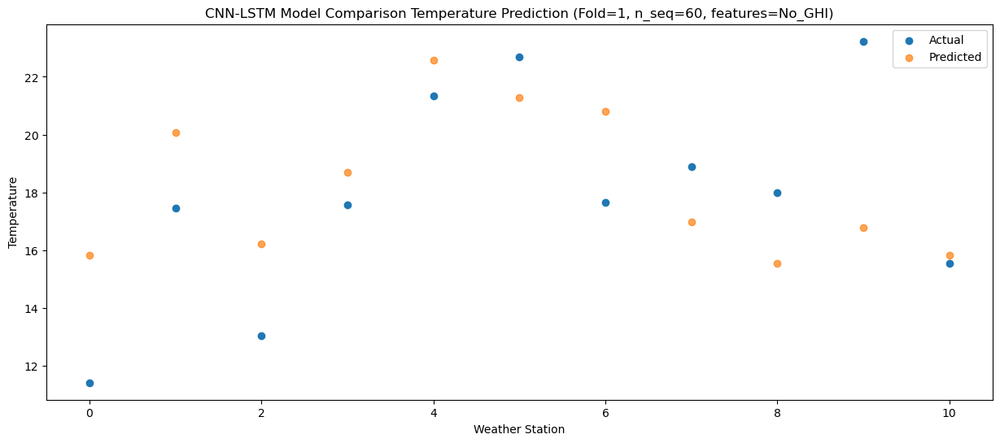

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  16.520825
1                 1   18.84  20.760797
2                 2   13.80  16.910804
3                 3   17.44  19.380811
4                 4   21.44  23.270787
5                 5   22.03  21.980792
6                 6   19.01  21.510794
7                 7   19.88  17.680721
8                 8   19.49  16.250710
9                 9   23.90  17.490717
10               10   17.77  16.520735


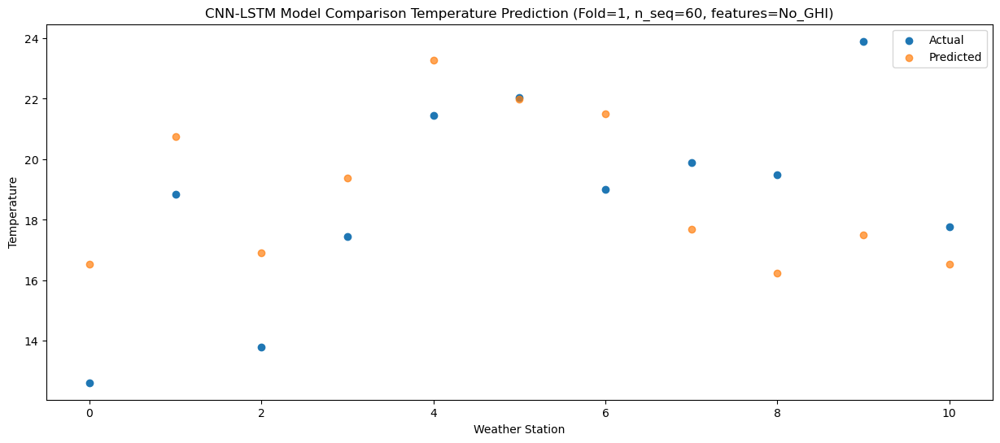

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  17.126535
1                 1   19.11  21.366507
2                 2   14.46  17.516514
3                 3   18.41  19.986521
4                 4   22.41  23.876497
5                 5   21.44  22.586498
6                 6   19.27  22.116504
7                 7   21.10  18.286423
8                 8   19.88  16.856414
9                 9   23.75  18.096417
10               10   17.55  17.126439


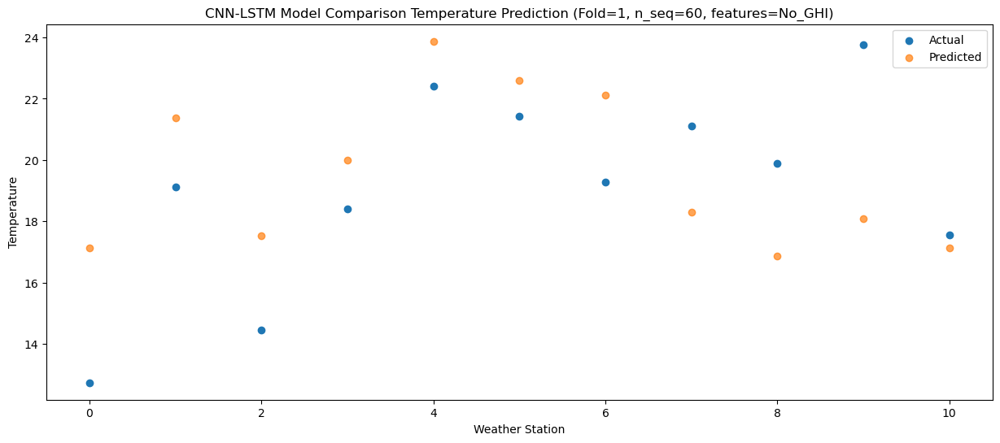

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  13.330769
1                 1   15.37  17.570747
2                 2   11.44  13.720753
3                 3   15.40  16.190760
4                 4   18.83  20.080737
5                 5   21.08  18.790738
6                 6   15.94  18.320744
7                 7   17.39  14.490674
8                 8   17.37  13.060663
9                 9   21.80  14.300666
10               10   13.85  13.330684


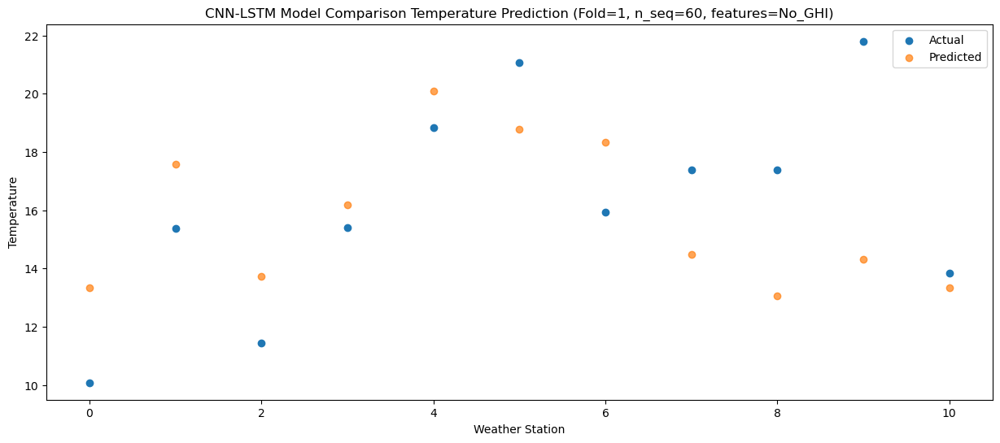

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   9.223430
1                 1   11.59  13.463399
2                 2    7.66   9.613407
3                 3   12.71  12.083416
4                 4   15.79  15.973392
5                 5   16.76  14.683391
6                 6   11.99  14.213397
7                 7   12.19  10.383315
8                 8   11.12   8.953304
9                 9   14.36  10.193308
10               10    9.43   9.223329


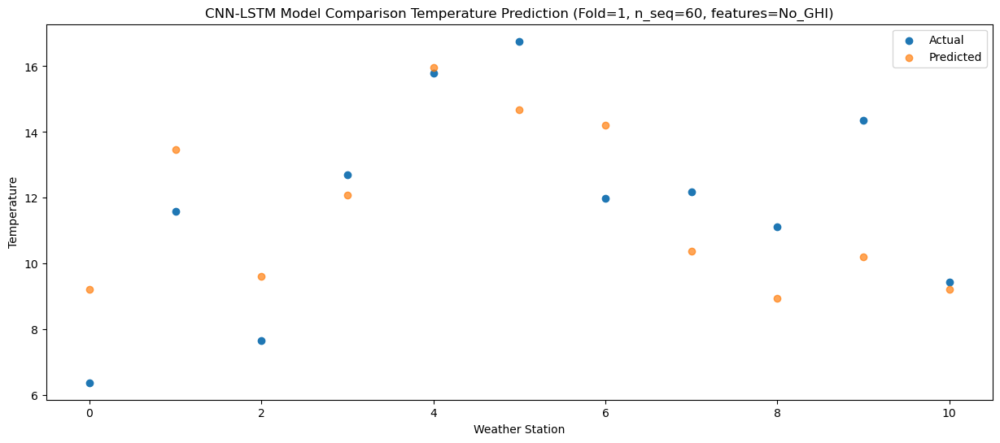

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83   0.320625
1                 1    3.93   4.560590
2                 2   -0.08   0.710598
3                 3    5.55   3.180607
4                 4    8.24   7.070583
5                 5   10.29   5.780583
6                 6    4.39   5.310588
7                 7    2.89   1.480505
8                 8    3.37   0.050494
9                 9    8.11   1.290497
10               10    0.11   0.320519


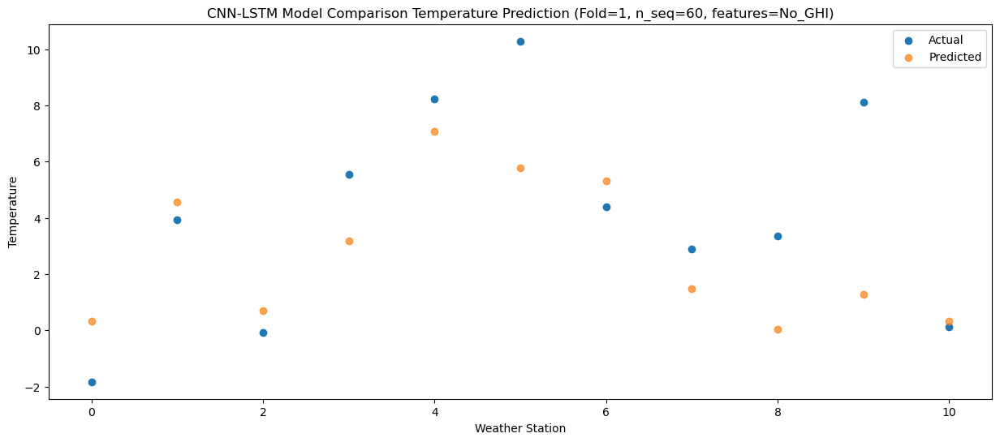

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52  -0.418823
1                 1    5.56   3.821144
2                 2    2.52  -0.028848
3                 3    8.92   2.441159
4                 4   12.12   6.331136
5                 5   10.55   5.041135
6                 6    5.91   4.571142
7                 7    5.30   0.741067
8                 8    2.56  -0.688946
9                 9    6.50   0.551057
10               10   -0.66  -0.418922


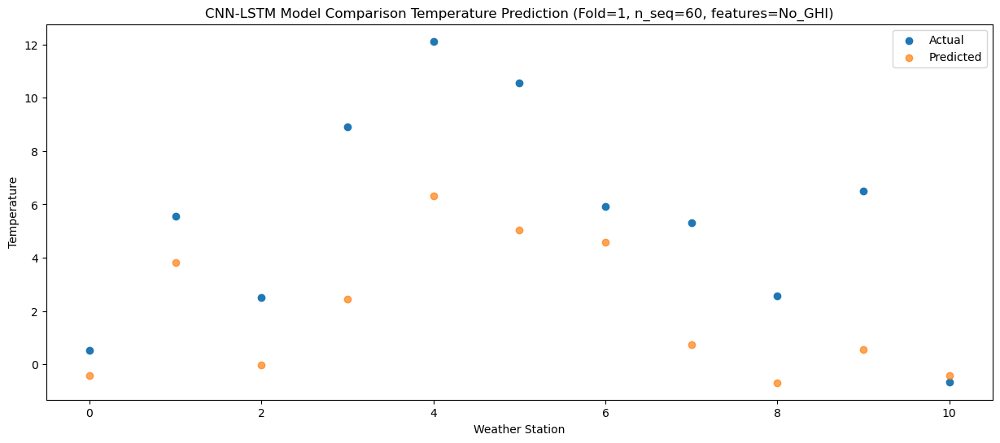

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -7.879267
1                 1   -1.17  -3.639306
2                 2   -4.37  -7.489297
3                 3    0.87  -5.019290
4                 4    3.64  -1.129313
5                 5    3.23  -2.419315
6                 6   -0.48  -2.889307
7                 7   -3.53  -6.719390
8                 8   -5.06  -8.149405
9                 9   -0.42  -6.909398
10               10   -7.68  -7.879376


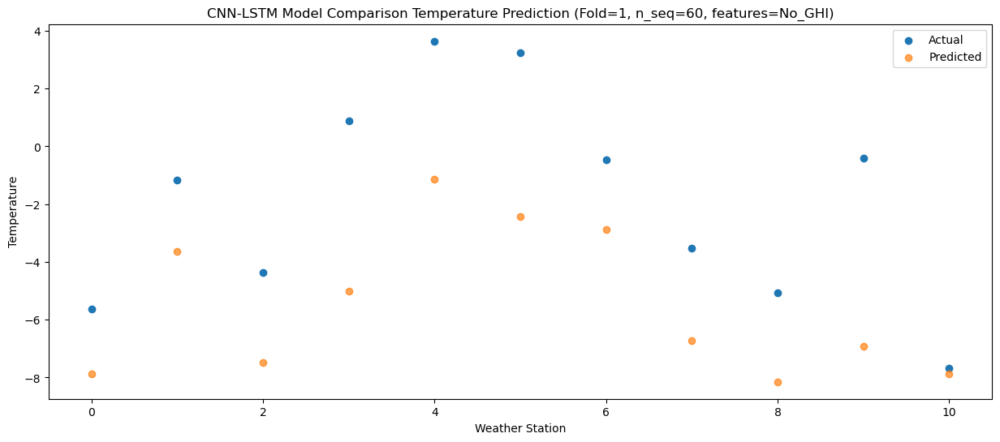

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -4.874672
1                 1    3.06  -0.634701
2                 2   -1.02  -4.484689
3                 3    0.40  -2.014684
4                 4    3.33   1.875290
5                 5    3.12   0.585291
6                 6    3.33   0.115300
7                 7   -1.48  -3.714780
8                 8   -4.08  -5.144793
9                 9   -0.36  -3.904786
10               10   -3.78  -4.874767


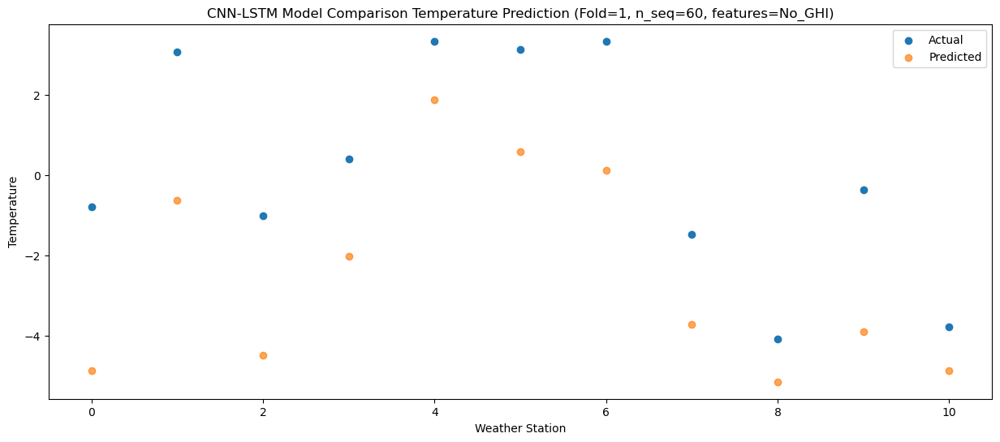

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   0.370264
1                 1    6.63   4.610235
2                 2    2.98   0.760247
3                 3    6.24   3.230255
4                 4    9.11   7.120226
5                 5   10.07   5.830227
6                 6    7.17   5.360236
7                 7    4.47   1.530152
8                 8    3.17   0.100139
9                 9    6.57   1.340150
10               10    0.78   0.370169


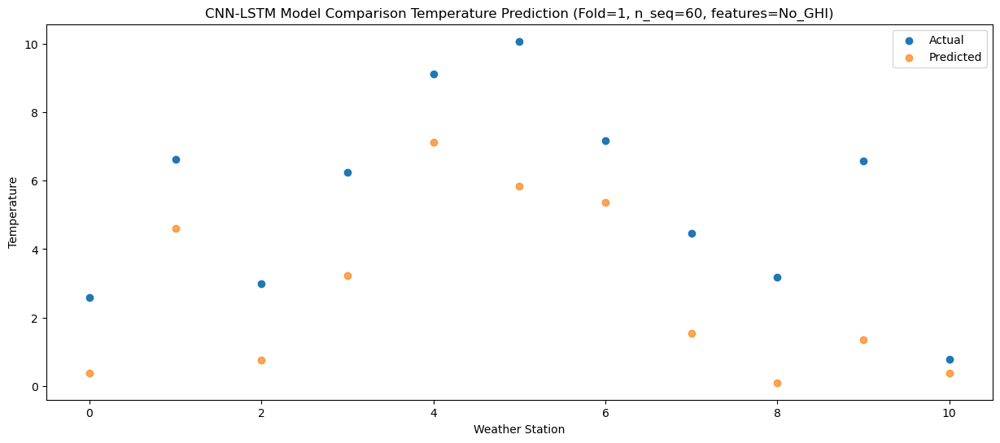

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   4.489406
1                 1    9.63   8.729375
2                 2    6.57   4.879386
3                 3   12.24   7.349397
4                 4   15.38  11.239364
5                 5   16.98   9.949364
6                 6    9.93   9.479376
7                 7    9.66   5.649290
8                 8   10.28   4.219277
9                 9   13.05   5.459292
10               10    4.13   4.489311


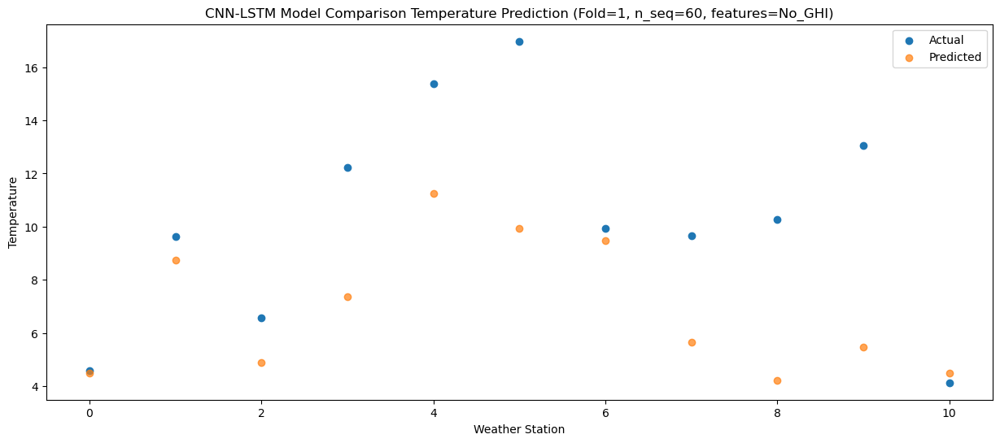

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  10.969849
1                 1   15.51  15.209820
2                 2   11.93  11.359831
3                 3   16.67  13.829844
4                 4   20.00  17.719809
5                 5   22.38  16.429809
6                 6   15.85  15.959821
7                 7   15.13  12.129735
8                 8   15.64  10.699718
9                 9   18.50  11.939733
10               10   11.11  10.969752


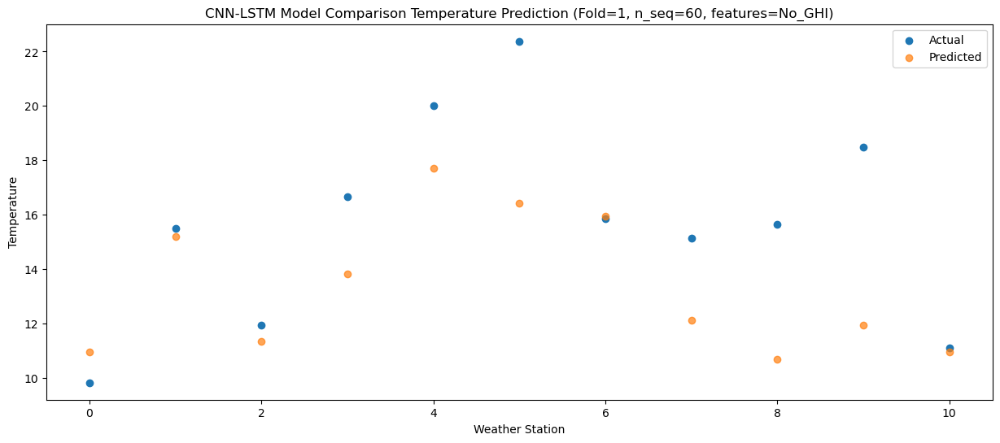

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  14.797597
1                 1   19.48  19.037568
2                 2   14.90  15.187579
3                 3   19.67  17.657592
4                 4   23.37  21.547557
5                 5   24.44  20.257554
6                 6   19.43  19.787569
7                 7   19.19  15.957483
8                 8   19.93  14.527466
9                 9   23.07  15.767483
10               10   15.50  14.797504


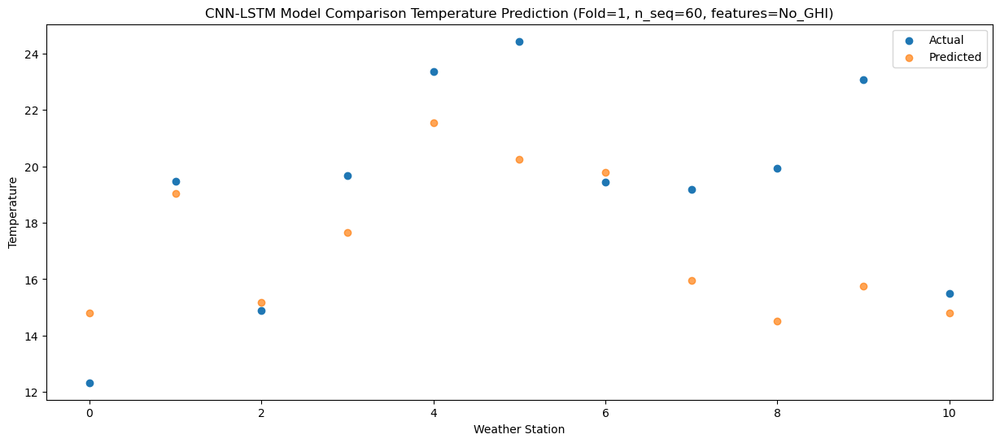

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  16.905488
1                 1   19.98  21.145461
2                 2   15.61  17.295474
3                 3   20.61  19.765485
4                 4   24.46  23.655452
5                 5   25.36  22.365448
6                 6   20.17  21.895464
7                 7   23.32  18.065362
8                 8   24.08  16.635345
9                 9   26.67  17.875364
10               10   19.44  16.905391


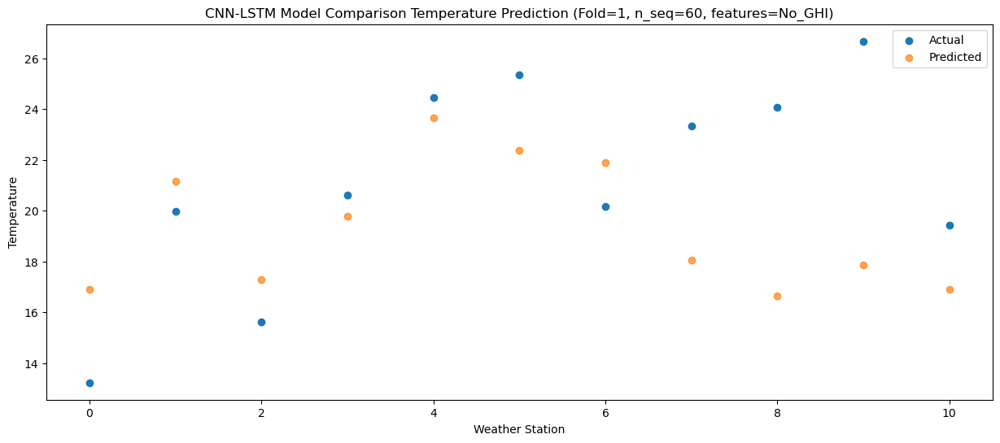

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  15.913663
1                 1   18.52  20.153633
2                 2   14.00  16.303645
3                 3   18.97  18.773655
4                 4   22.45  22.663620
5                 5   22.51  21.373619
6                 6   18.67  20.903633
7                 7   20.45  17.073538
8                 8   21.41  15.643518
9                 9   23.84  16.883538
10               10   18.90  15.913563


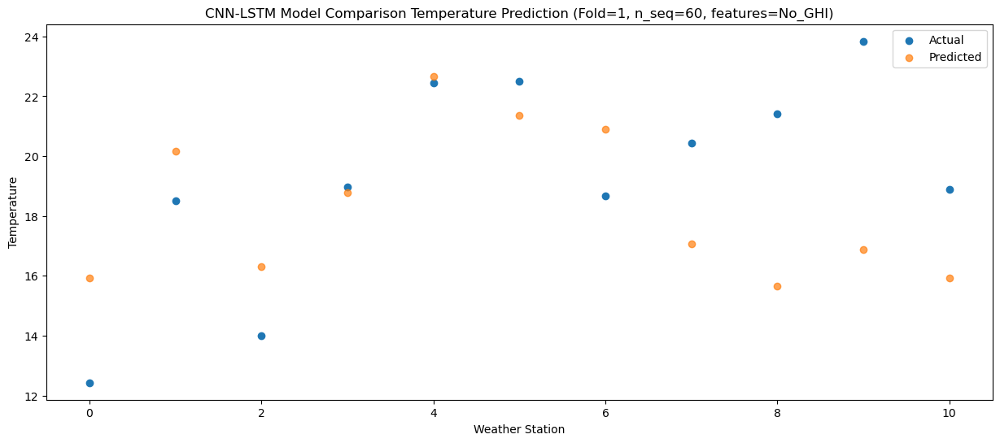

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  11.838017
1                 1   15.43  16.077986
2                 2   11.61  12.227999
3                 3   16.20  14.698009
4                 4   19.27  18.587977
5                 5   19.46  17.297973
6                 6   15.78  16.827986
7                 7   16.61  12.997896
8                 8   17.58  11.567877
9                 9   21.43  12.807897
10               10   13.99  11.837919


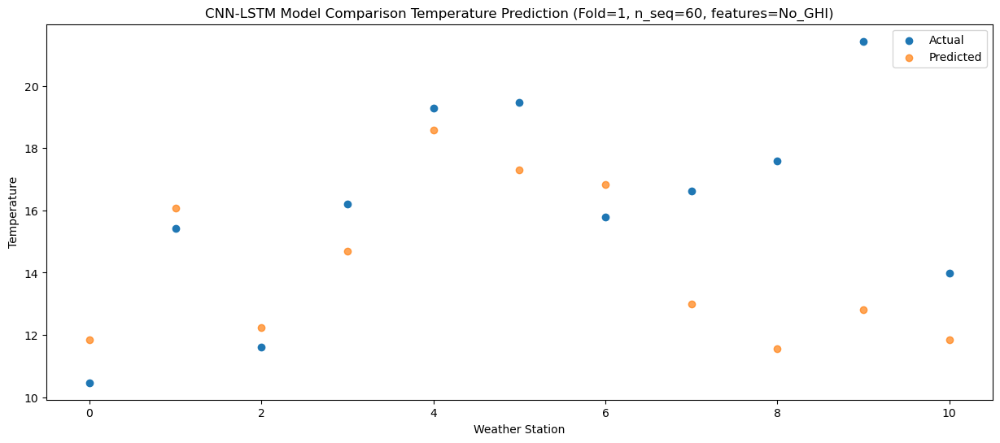

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   4.711397
1                 1    9.09   8.951372
2                 2    4.92   5.101383
3                 3   10.64   7.571392
4                 4   13.88  11.461363
5                 5   13.38  10.171360
6                 6    9.44   9.701372
7                 7    9.94   5.871291
8                 8    9.35   4.441273
9                 9   12.89   5.681289
10               10    5.89   4.711308


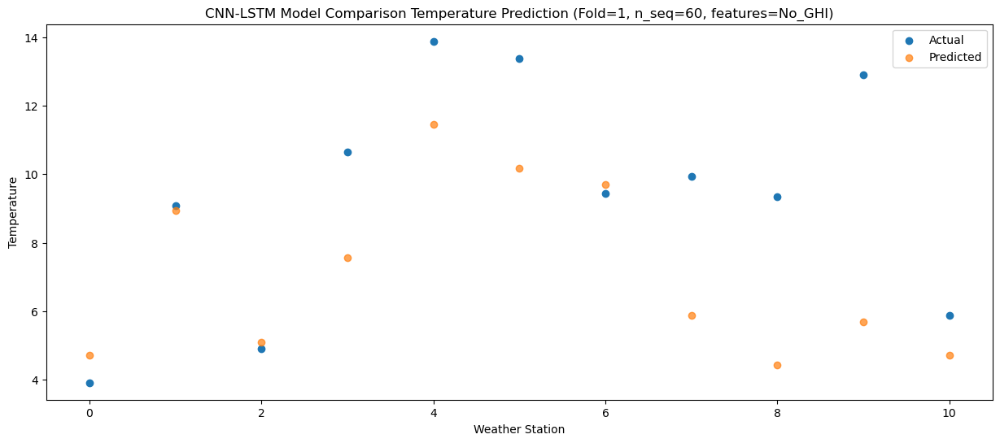

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72   0.203327
1                 1    6.09   4.443292
2                 2    1.60   0.593302
3                 3    5.59   3.063314
4                 4    8.88   6.953283
5                 5    6.42   5.663279
6                 6    6.55   5.193292
7                 7    3.34   1.363192
8                 8    1.50  -0.066826
9                 9    3.90   1.173194
10               10    2.38   0.203222


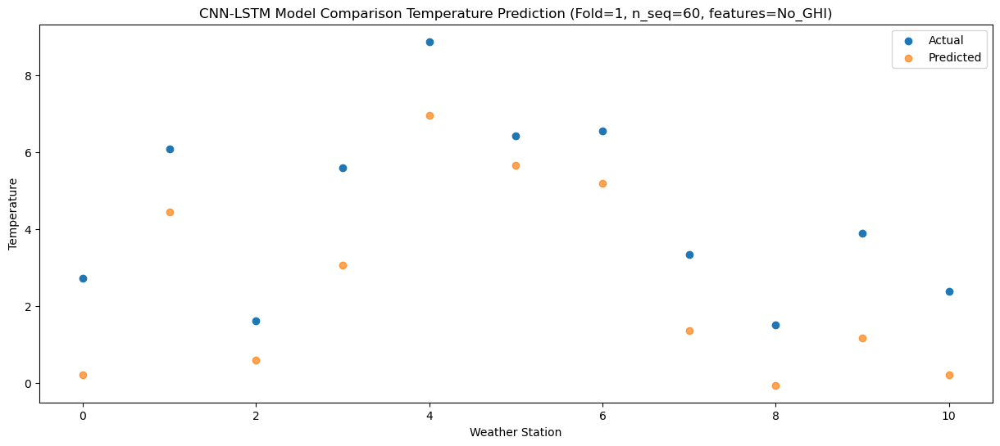

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -5.311206
1                 1    0.28  -1.071249
2                 2   -1.56  -4.921238
3                 3    3.50  -2.451226
4                 4    6.86   1.438742
5                 5    5.30   0.148740
6                 6    0.54  -0.321249
7                 7   -0.40  -4.151362
8                 8   -2.13  -5.581380
9                 9    1.55  -4.341357
10               10   -4.77  -5.311322


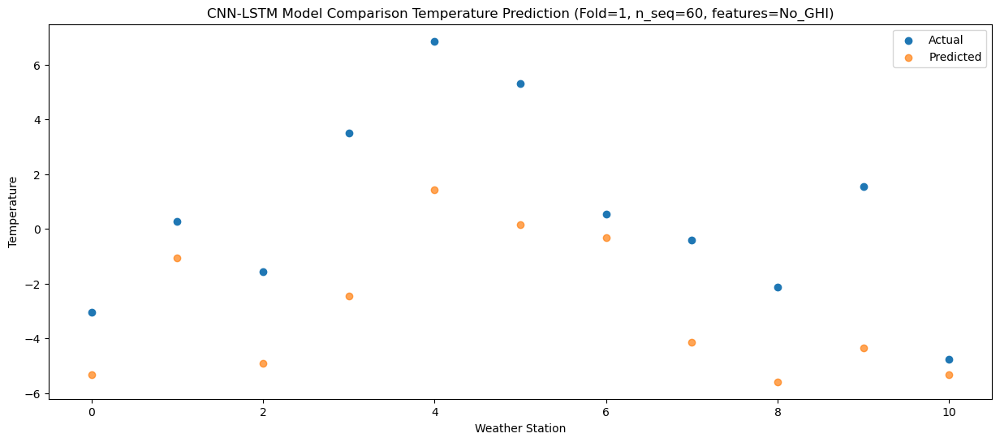

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -3.748650
1                 1    2.47   0.491311
2                 2   -0.56  -3.358678
3                 3    4.21  -0.888666
4                 4    7.34   3.001298
5                 5    5.76   1.711300
6                 6    2.67   1.241311
7                 7    0.79  -2.588798
8                 8   -1.27  -4.018816
9                 9    1.83  -2.778789
10               10   -1.81  -3.748762


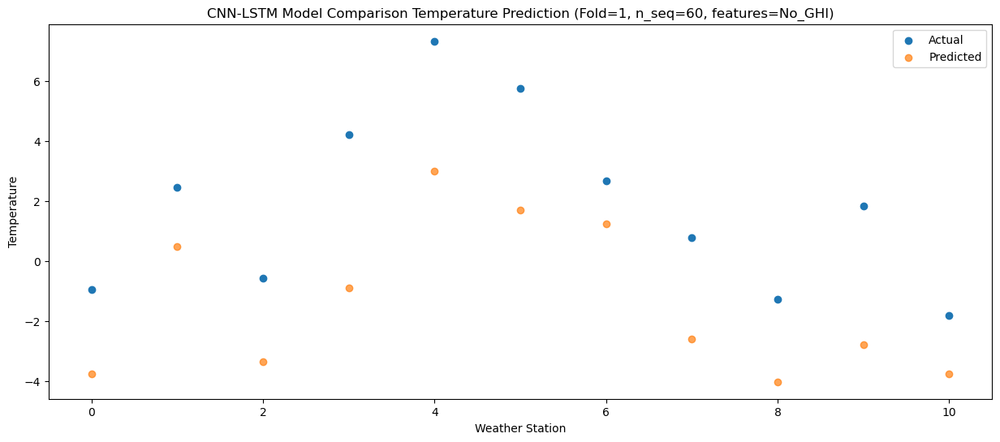

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -2.763870
1                 1    5.84   1.476093
2                 2    2.03  -2.373899
3                 3    5.21   0.096113
4                 4    8.52   3.986078
5                 5    5.90   2.696079
6                 6    6.26   2.226091
7                 7    2.29  -1.604018
8                 8   -0.90  -3.034039
9                 9    2.98  -1.794008
10               10   -2.13  -2.763985


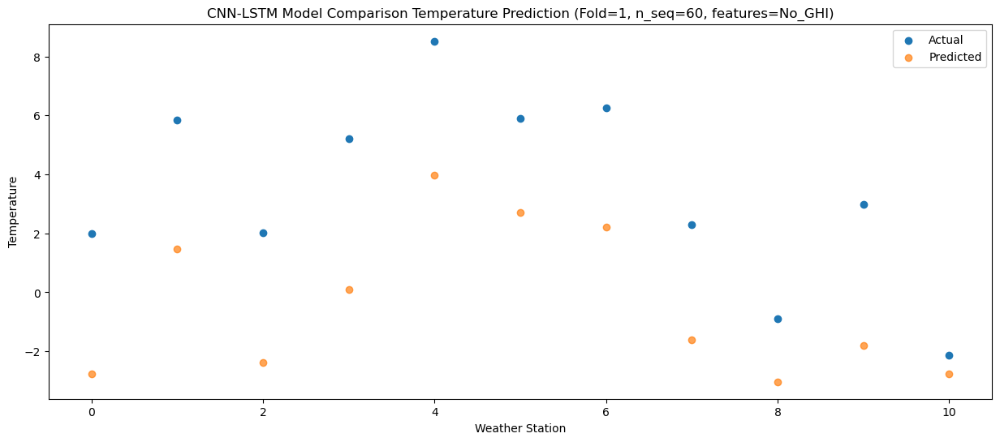

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62  -1.585430
1                 1    6.61   2.654531
2                 2    3.46  -1.195459
3                 3    9.04   1.274553
4                 4   12.34   5.164516
5                 5   10.96   3.874519
6                 6    6.93   3.404529
7                 7    5.12  -0.425580
8                 8    3.53  -1.855601
9                 9    6.71  -0.615569
10               10   -1.01  -1.585543


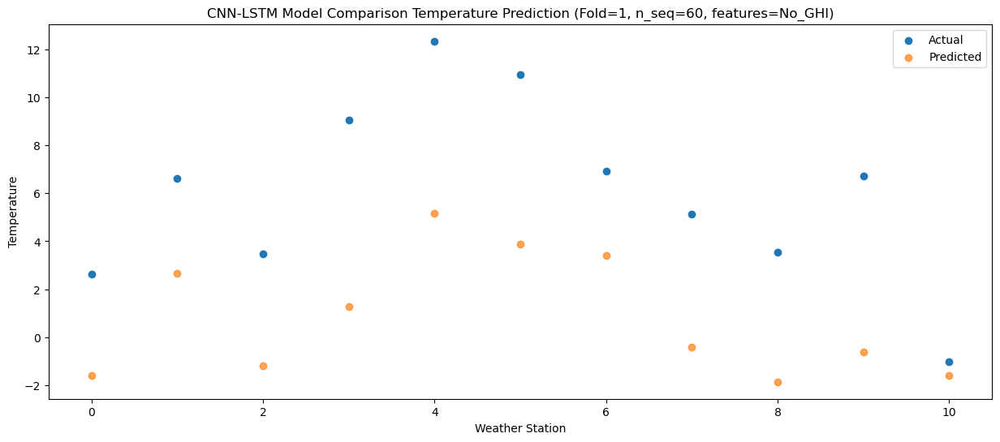

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   4.552344
1                 1    9.88   8.792309
2                 2    6.15   4.942320
3                 3    9.88   7.412330
4                 4   13.30  11.302288
5                 5   14.12  10.012296
6                 6   10.19   9.542307
7                 7    9.52   5.712193
8                 8    7.86   4.282170
9                 9   12.06   5.522203
10               10    6.21   4.552234


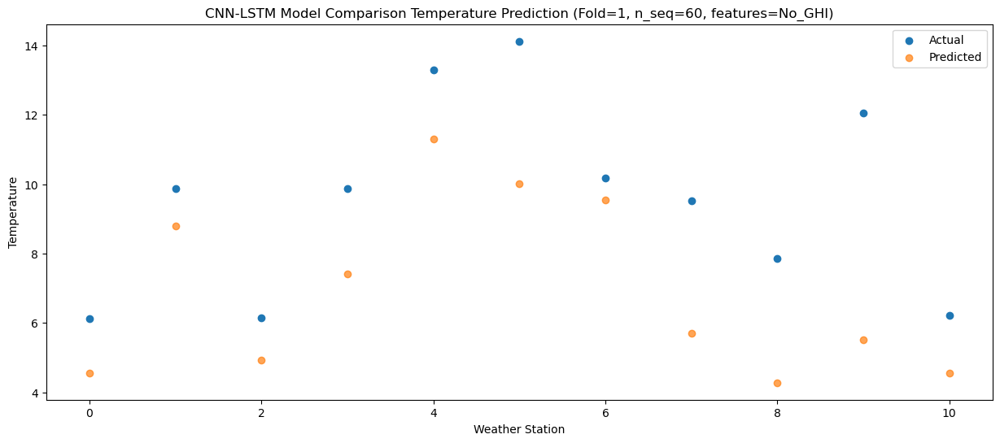

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62   8.226623
1                 1   13.16  12.466588
2                 2    9.39   8.616596
3                 3   14.47  11.086608
4                 4   17.94  14.976567
5                 5   18.73  13.686574
6                 6   13.19  13.216584
7                 7   14.87   9.386467
8                 8   13.55   7.956445
9                 9   17.17   9.196482
10               10    8.77   8.226512


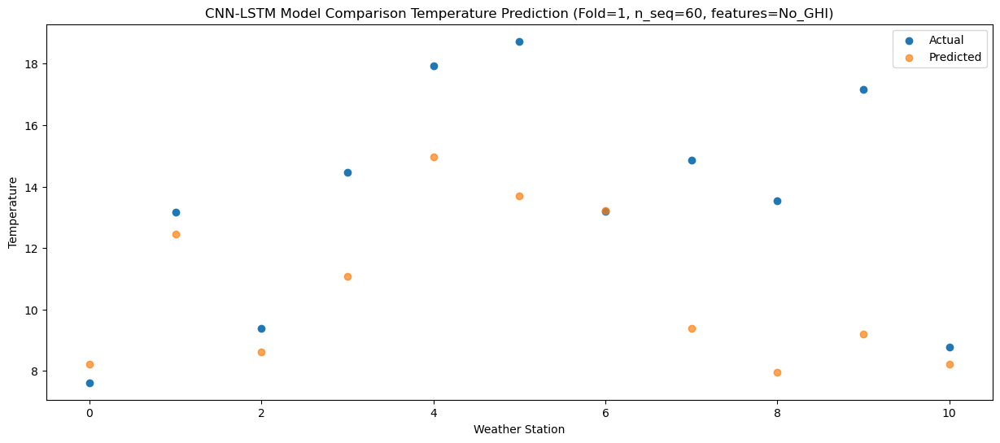

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  12.497610
1                 1   16.35  16.737579
2                 2   13.14  12.887587
3                 3   18.62  15.357601
4                 4   22.83  19.247558
5                 5   25.42  17.957561
6                 6   16.47  17.487575
7                 7   18.68  13.657466
8                 8   18.48  12.227444
9                 9   20.40  13.467481
10               10   13.14  12.497504


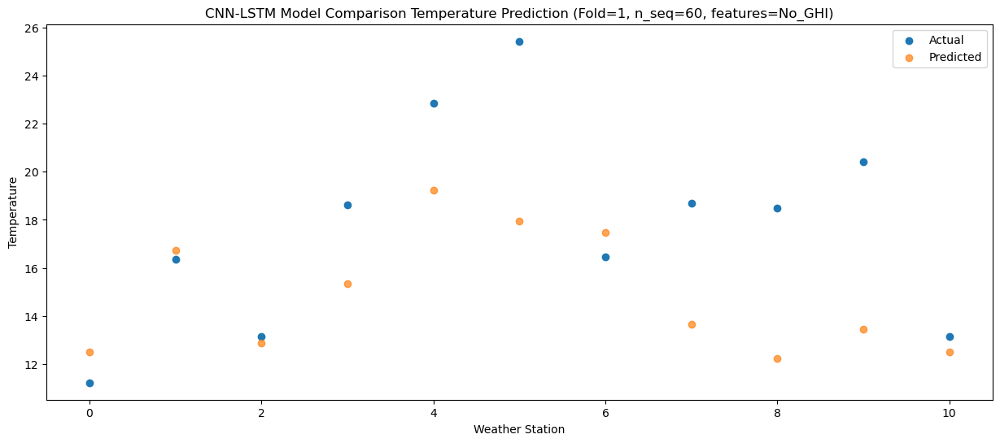

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  16.262990
1                 1   19.95  20.502955
2                 2   15.51  16.652964
3                 3   20.34  19.122976
4                 4   24.78  23.012933
5                 5   26.52  21.722934
6                 6   19.92  21.252952
7                 7   20.98  17.422839
8                 8   21.36  15.992812
9                 9   25.02  17.232853
10               10   18.28  16.262876


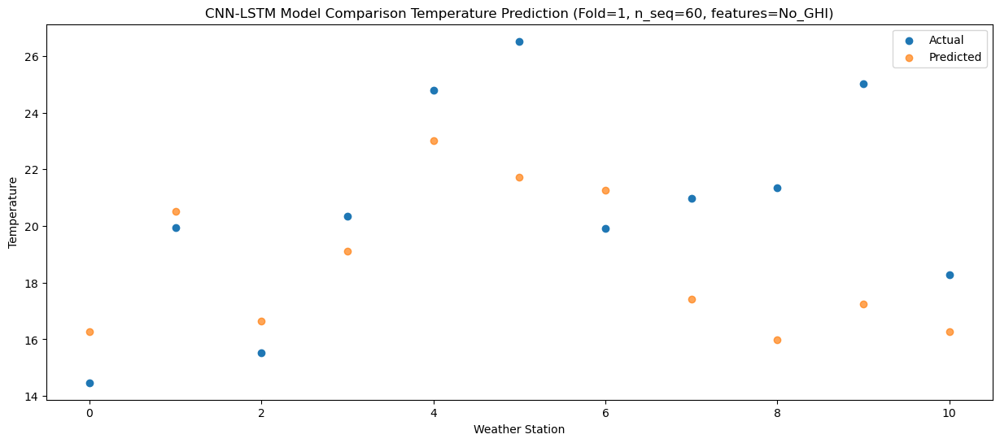

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  14.588411
1                 1   19.41  18.828376
2                 2   15.95  14.978385
3                 3   22.31  17.448398
4                 4   26.21  21.338353
5                 5   25.71  20.048355
6                 6   19.50  19.578373
7                 7   21.48  15.748258
8                 8   23.17  14.318231
9                 9   25.42  15.558275
10               10   16.54  14.588300


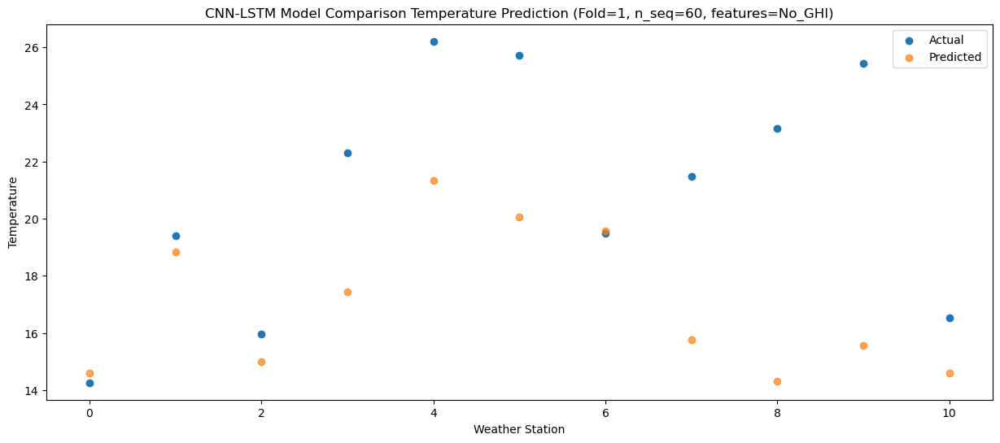

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  12.058696
1                 1   15.90  16.298663
2                 2   12.99  12.448672
3                 3   19.23  14.918685
4                 4   22.36  18.808640
5                 5   23.43  17.518642
6                 6   16.33  17.048660
7                 7   17.86  13.218553
8                 8   18.53  11.788526
9                 9   21.90  13.028568
10               10   13.35  12.058589


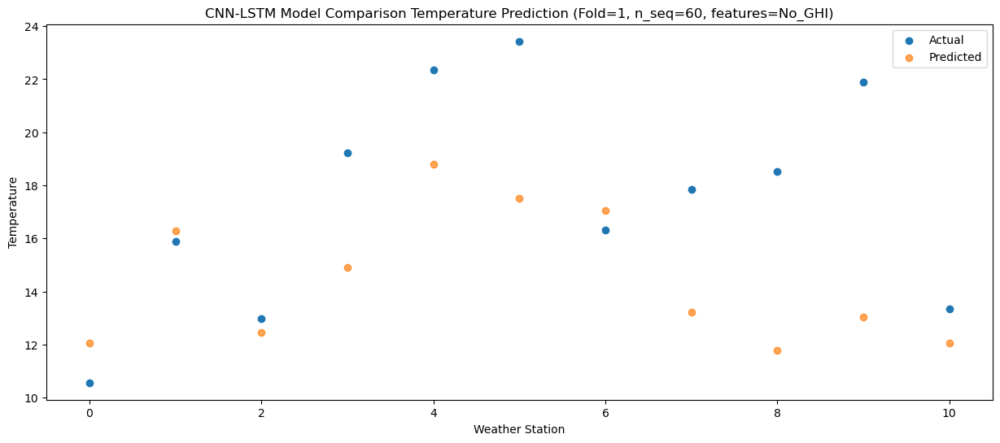

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   6.593708
1                 1   10.89  10.833669
2                 2    6.95   6.983679
3                 3   11.97   9.453692
4                 4   14.96  13.343647
5                 5   15.83  12.053649
6                 6   11.32  11.583667
7                 7   11.55   7.753549
8                 8    9.95   6.323522
9                 9   13.80   7.563565
10               10    8.00   6.593591


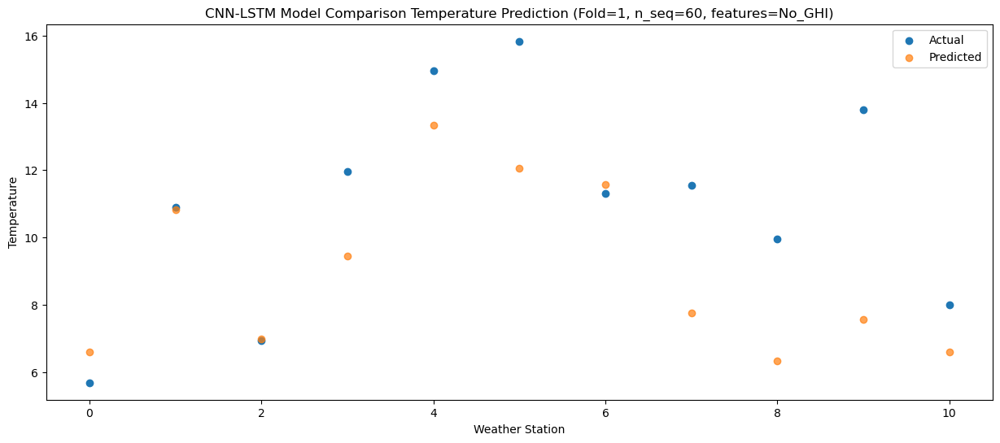

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54  -0.738523
1                 1    5.27   3.501438
2                 2    0.39  -0.348554
3                 3    5.69   2.121458
4                 4    8.76   6.011414
5                 5    9.17   4.721415
6                 6    5.63   4.251434
7                 7    4.15   0.421321
8                 8    2.83  -1.008707
9                 9    7.05   0.231337
10               10    0.06  -0.738638


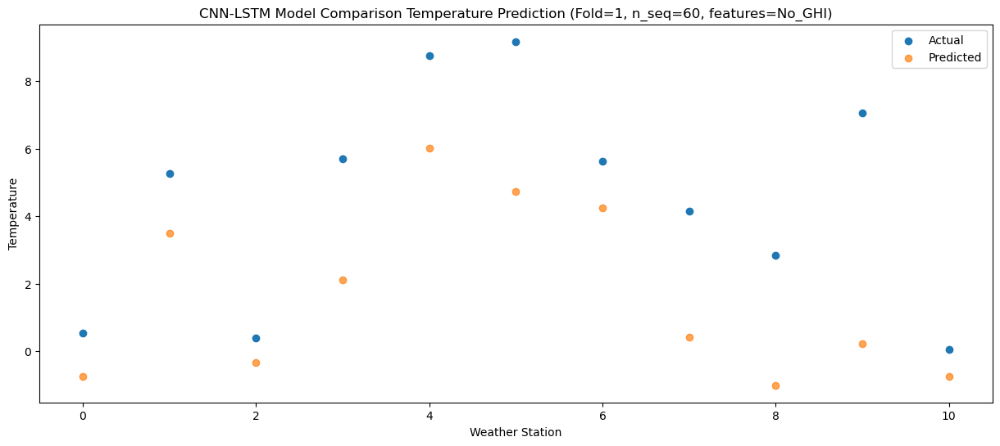

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49  -2.280623
1                 1    2.13   1.959338
2                 2   -2.39  -1.890655
3                 3    3.29   0.579357
4                 4    6.86   4.469310
5                 5    6.81   3.179315
6                 6    2.89   2.709333
7                 7    1.23  -1.120777
8                 8   -0.02  -2.550806
9                 9    3.22  -1.310762
10               10   -1.63  -2.280736


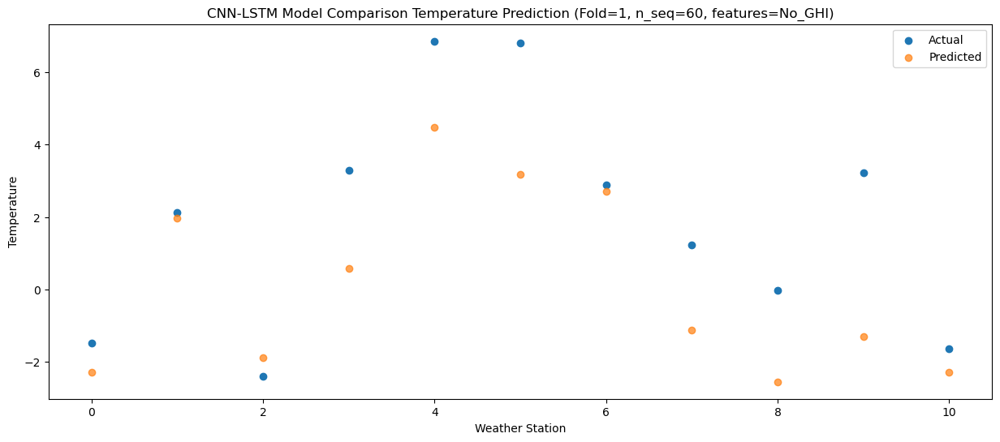

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -6.470595
1                 1   -1.15  -2.230634
2                 2   -5.47  -6.080627
3                 3   -0.13  -3.610615
4                 4    3.01   0.279337
5                 5    3.20  -1.010657
6                 6   -0.11  -1.480639
7                 7   -4.70  -5.310753
8                 8   -5.85  -6.740782
9                 9   -1.95  -5.500738
10               10   -5.53  -6.470712


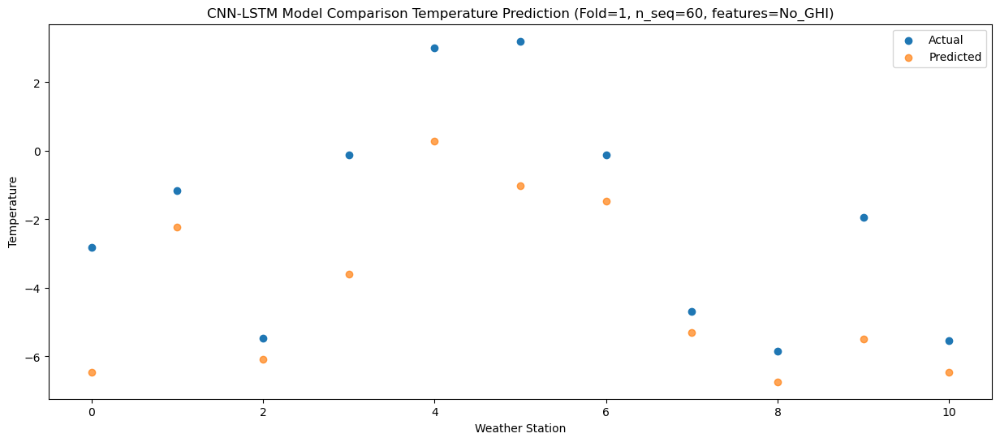

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -2.879742
1                 1    3.93   1.360227
2                 2   -0.13  -2.489765
3                 3    6.18  -0.019755
4                 4    9.38   3.870198
5                 5    9.32   2.580205
6                 6    4.10   2.110223
7                 7    4.30  -1.719884
8                 8    2.10  -3.149911
9                 9    5.76  -1.909867
10               10   -3.58  -2.879847


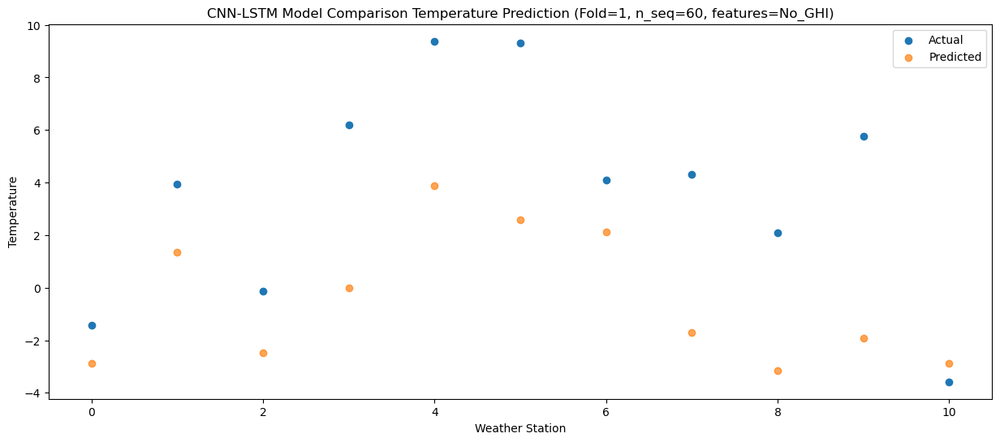

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42   0.597540
1                 1    7.15   4.837509
2                 2    2.97   0.987518
3                 3    8.69   3.457530
4                 4   12.12   7.347481
5                 5   11.67   6.057488
6                 6    7.76   5.587504
7                 7    7.02   1.757407
8                 8    5.34   0.327381
9                 9    8.59   1.567428
10               10    0.82   0.597445


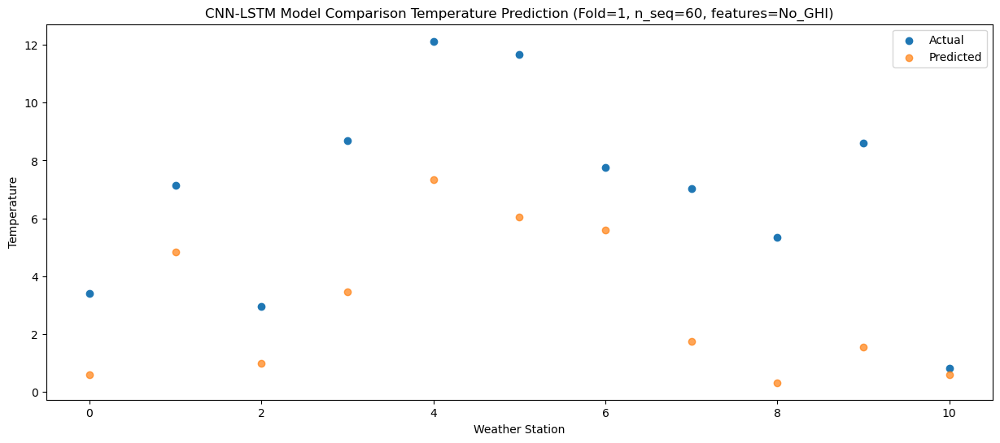

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   5.120139
1                 1   10.82   9.360106
2                 2    6.31   5.510116
3                 3   12.17   7.980127
4                 4   15.68  11.870081
5                 5   16.47  10.580085
6                 6   11.23  10.110101
7                 7   11.06   6.279994
8                 8   10.02   4.849964
9                 9   13.66   6.090014
10               10    5.21   5.120034


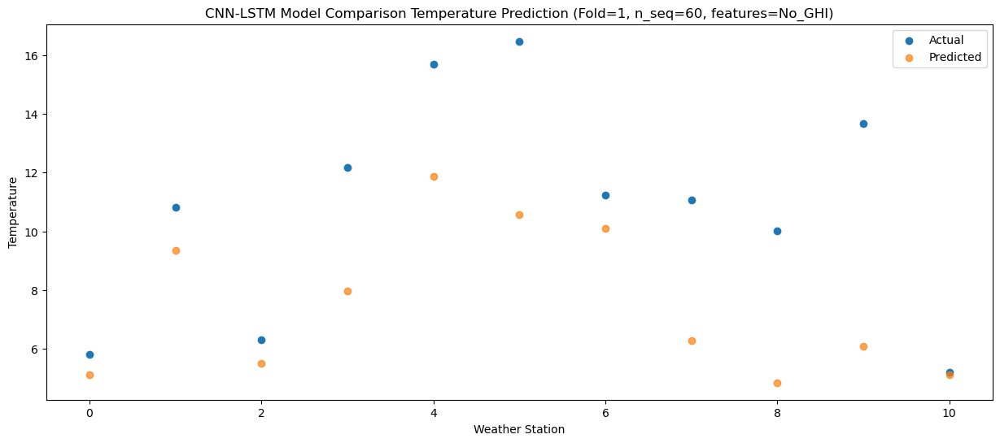

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49  10.611542
1                 1   15.39  14.851512
2                 2   11.92  11.001521
3                 3   15.87  13.471533
4                 4   19.38  17.361486
5                 5   22.09  16.071491
6                 6   15.47  15.601507
7                 7   16.60  11.771408
8                 8   14.78  10.341377
9                 9   17.80  11.581425
10               10   10.80  10.611447


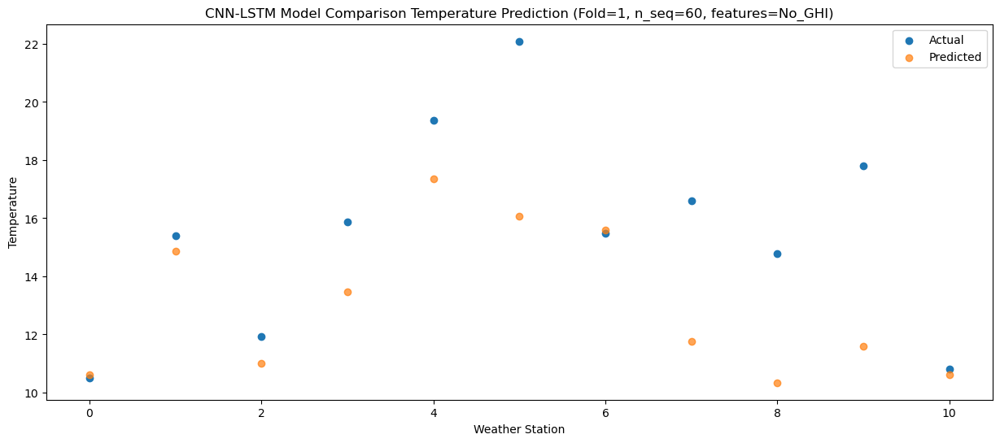

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  14.741712
1                 1   19.15  18.981678
2                 2   15.03  15.131688
3                 3   18.50  17.601699
4                 4   22.27  21.491651
5                 5   24.95  20.201655
6                 6   19.40  19.731673
7                 7   19.67  15.901560
8                 8   20.48  14.471526
9                 9   24.21  15.711576
10               10   16.91  14.741608


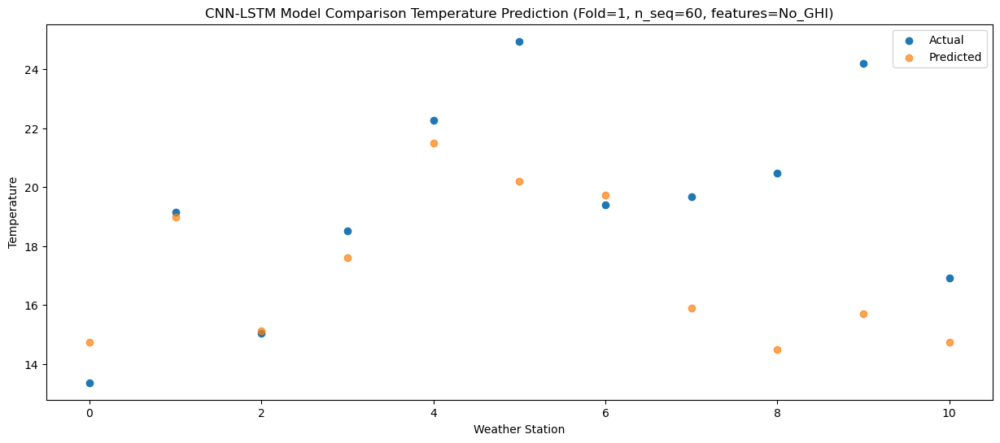

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  16.040063
1                 1   20.08  20.280022
2                 2   15.05  16.430034
3                 3   17.89  18.900046
4                 4   22.08  22.789995
5                 5   23.95  21.500002
6                 6   20.43  21.030020
7                 7   20.31  17.199901
8                 8   21.33  15.769868
9                 9   24.94  17.009918
10               10   18.84  16.039952


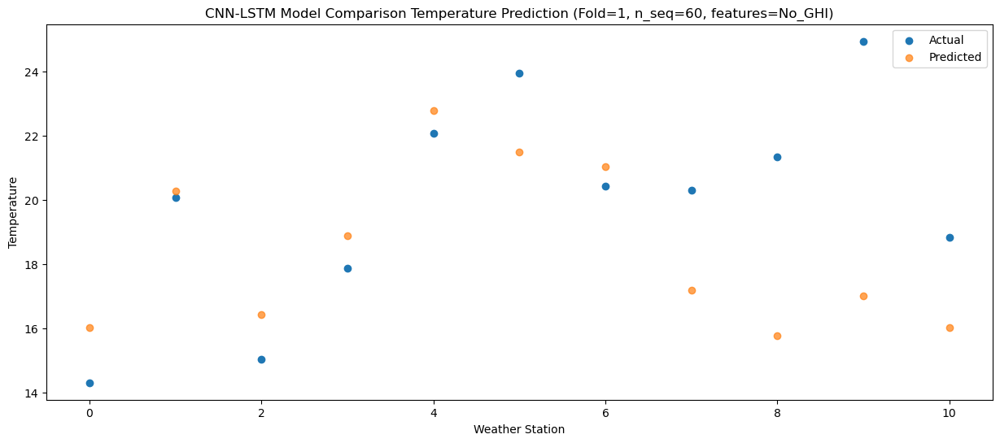

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  14.702419
1                 1   19.80  18.942381
2                 2   15.36  15.092392
3                 3   19.02  17.562404
4                 4   23.40  21.452355
5                 5   25.55  20.162360
6                 6   20.10  19.692378
7                 7   20.72  15.862271
8                 8   23.44  14.432239
9                 9   25.74  15.672284
10               10   16.69  14.702316


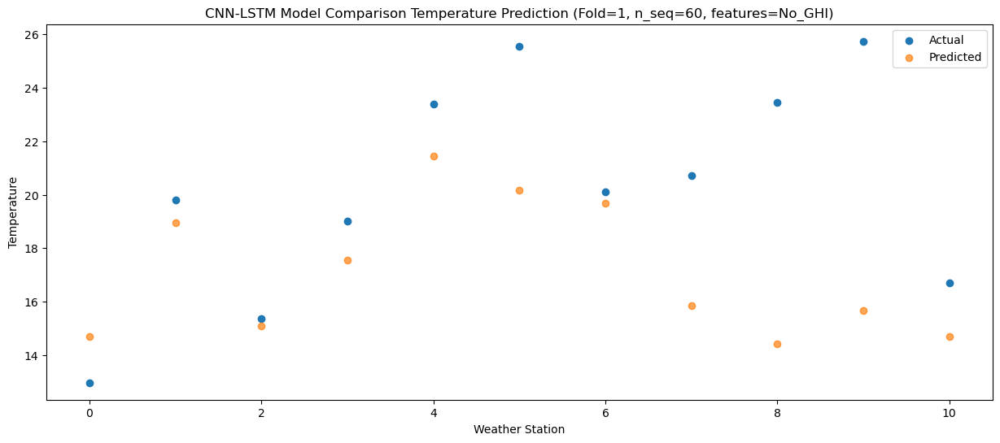

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53  11.526407
1                 1   16.08  15.766369
2                 2   13.05  11.916380
3                 3   16.42  14.386393
4                 4   20.11  18.276343
5                 5   19.84  16.986347
6                 6   16.80  16.516366
7                 7   18.85  12.686271
8                 8   17.47  11.256239
9                 9   21.18  12.496281
10               10   12.96  11.526308


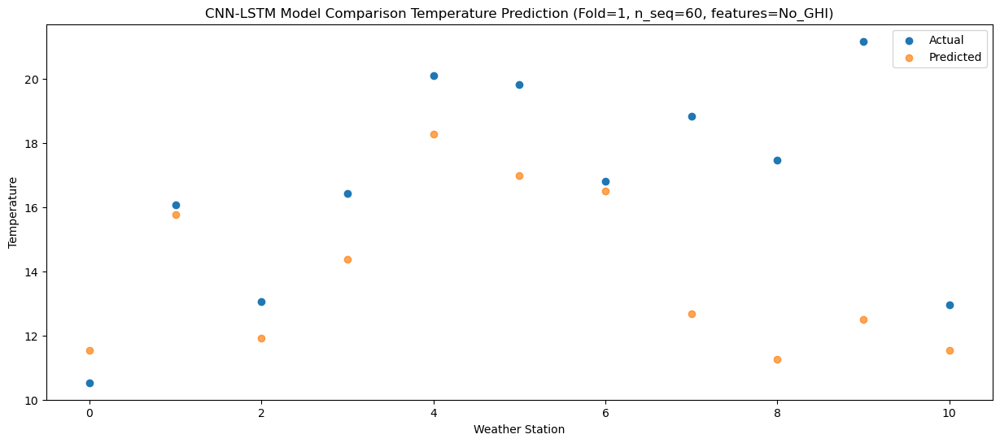

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   6.184211
1                 1   11.63  10.424169
2                 2    8.05   6.574181
3                 3   13.73   9.044192
4                 4   16.96  12.934142
5                 5   18.69  11.644145
6                 6   12.00  11.174166
7                 7   13.38   7.344066
8                 8   13.61   5.914034
9                 9   16.33   7.154078
10               10    8.09   6.184107


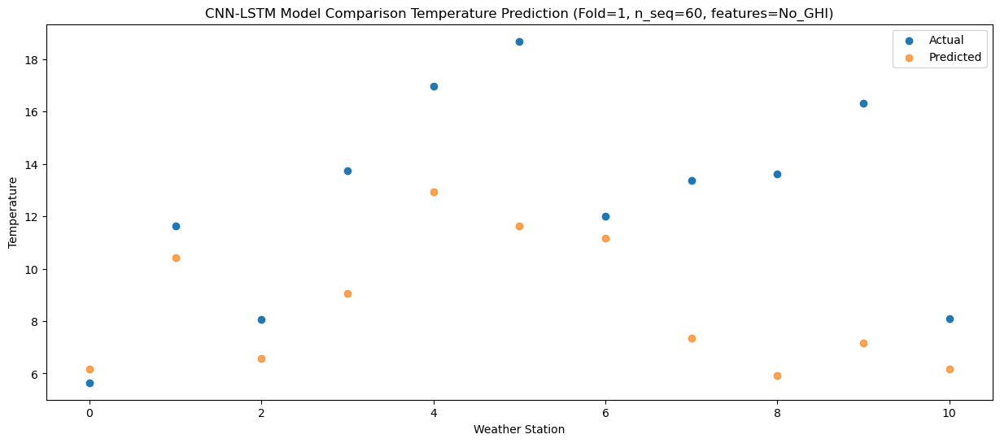

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

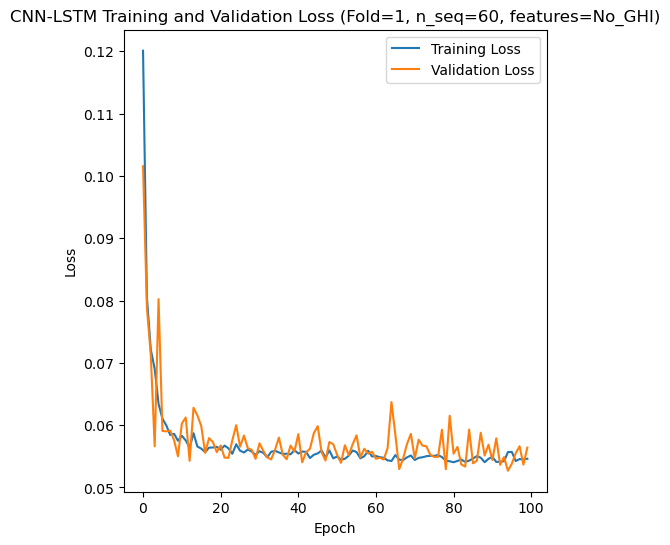

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 40s 212ms/step - loss: 0.1171 - accuracy: 0.1905 - mae: 0.0954 - rmse: 0.1171 - mape: inf - pearson: 0.6442 - val_loss: 0.0643 - val_accuracy: 0.6000 - val_mae: 0.0510 - val_rmse: 0.0643 - val_mape: 11.1968 - val_pearson: 0.8336
Epoch 2/100
84/84 [==============================] - 11s 133ms/step - loss: 0.0798 - accuracy: 0.4286 - mae: 0.0641 - rmse: 0.0798 - mape: inf - pearson: 0.7829 - val_loss: 0.0579 - val_accuracy: 0.6000 - val_mae: 0.0455 - val_rmse: 0.0579 - val_mape: 10.3305 - val_pearson: 0.8643
Epoch 3/100
84/84 [==============================] - 12s 137ms/step - loss: 0.0829 - accuracy: 0.4762 - mae: 0.0672 - rmse: 0.0829 - mape: inf - pearson: 0.8034 - val_loss:

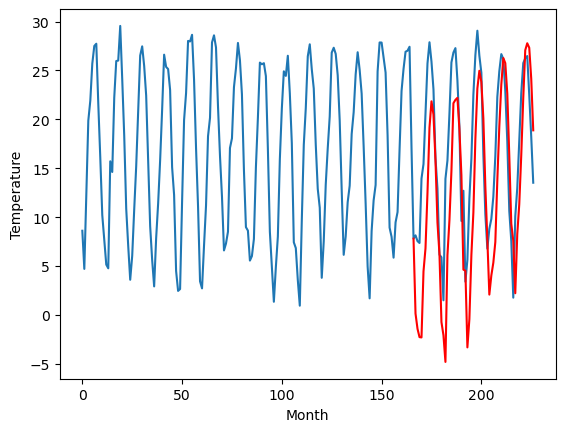

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		0.18		-3.23
1.13		-1.37		-2.50
0.89		-2.23		-3.12
0.16		-2.26		-2.42
8.17		4.49		-3.68
10.40		6.85		-3.55
17.20		12.54		-4.66
24.40		19.19		-5.21
24.43		21.88		-2.55
23.10		20.53		-2.57
16.97		15.88		-1.09
9.98		9.49		-0.49
6.86		6.26		-0.60
0.23		-0.69		-0.92
0.15		-2.03		-2.18
-3.89		-4.76		-0.87
6.30		6.15		-0.15
10.06		9.72		-0.34
15.24		14.77		-0.47
22.49		21.69		-0.80
23.18		22.03		-1.15
23.94		22.24		-1.70
21.70		19.03		-2.67
13.44		14.33		0.89
6.73		4.68		-2.05
4.34		4.57		0.23
-0.35		-3.27		-2.92
-0.36		-0.38		-0.02
6.62		6.16		-0.46
13.30		10.52		-2.78
19.10		18.05		-1.05
22.90		23.19		0.29
26.14		25.01		-1.13
23.83		23.87		0.04
21.07		20.15		-0.92
12.69		13.17		0.48
2.70		7.76		5.06
-0.01		2.12		2.13
-0.26		4.08		4.34
1.34		5.38		4.04
5.41		7.50		2.09
11.27		13.81		2.54
16.76		19.29		2.53
19.37		23.58		4.21
23.47		26.31		2.84
23.96		25.79		1.83
21.09		22.66		1.57
12.05		16.31

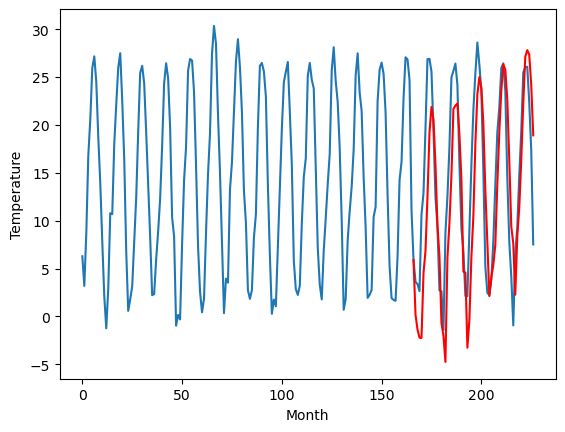

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-2.15		-2.05
-1.22		-3.70		-2.48
-2.37		-4.56		-2.19
-1.33		-4.59		-3.26
2.29		2.16		-0.13
3.68		4.52		0.84
4.99		10.21		5.22
7.58		16.86		9.28
8.22		19.55		11.33
7.91		18.20		10.29
6.65		13.55		6.90
5.38		7.16		1.78
1.96		3.93		1.97
-5.03		-3.02		2.01
-4.37		-4.36		0.01
-1.64		-7.09		-5.45
0.17		3.82		3.65
1.98		7.39		5.41
5.56		12.44		6.88
6.78		19.36		12.58
7.57		19.70		12.13
7.62		19.91		12.29
6.34		16.70		10.36
5.20		12.00		6.80
-1.65		2.35		4.00
-0.75		2.24		2.99
-5.01		-5.60		-0.59
-2.68		-2.71		-0.03
0.79		3.83		3.04
2.60		8.19		5.59
5.36		15.72		10.36
7.17		20.86		13.69
7.35		22.68		15.33
6.78		21.54		14.76
5.37		17.82		12.45
2.74		10.84		8.10
0.98		5.43		4.45
-3.12		-0.21		2.91
-3.32		1.75		5.07
-0.26		3.05		3.31
0.76		5.17		4.41
3.30		11.48		8.18
4.28		16.96		12.68
6.69		21.25		14.56
8.60		23.98		15.38
8.78		23.46		14.68
6.83		20.33		13.50
3.25		13.98		10.73
-0.73		7.05		7.7

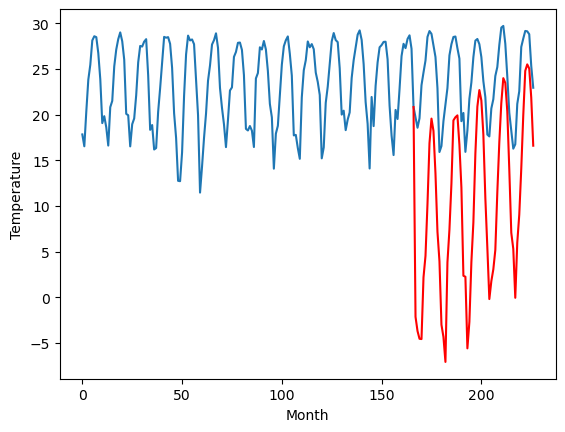

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.39		0.15
6.18		7.84		1.66
6.45		6.98		0.53
6.60		6.95		0.35
10.15		13.70		3.55
11.38		16.06		4.68
17.27		21.75		4.48
23.33		28.40		5.07
27.61		31.09		3.48
25.76		29.74		3.98
21.18		25.09		3.91
15.96		18.70		2.74
12.00		15.47		3.47
5.17		8.52		3.35
2.09		7.18		5.09
2.11		4.45		2.34
6.22		15.36		9.14
10.72		18.93		8.21
15.98		23.98		8.00
21.55		30.90		9.35
23.55		31.24		7.69
24.61		31.45		6.84
21.44		28.24		6.80
17.61		23.54		5.93
9.53		13.89		4.36
7.61		13.78		6.17
1.46		5.94		4.48
3.78		8.83		5.05
7.64		15.37		7.73
12.08		19.73		7.65
17.42		27.26		9.84
21.66		32.40		10.74
26.28		34.22		7.94
26.20		33.08		6.88
21.16		29.36		8.20
15.72		22.38		6.66
11.92		16.97		5.05
5.75		11.33		5.58
7.04		13.29		6.25
5.16		14.59		9.43
7.60		16.71		9.11
13.32		23.02		9.70
16.95		28.50		11.55
20.74		32.79		12.05
26.31		35.52		9.21
24.30		35.00		10.70
21.88		31.87		9.99
16.86		25.52		8.66
8.88		18.59		9.

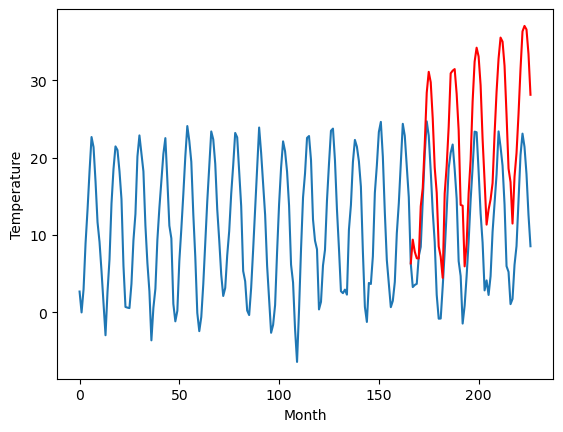

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-5.75		0.50
-5.90		-7.30		-1.40
-5.56		-8.16		-2.60
-4.92		-8.19		-3.27
1.77		-1.44		-3.21
1.24		0.92		-0.32
4.21		6.61		2.40
7.25		13.26		6.01
7.99		15.95		7.96
8.36		14.60		6.24
6.01		9.95		3.94
2.32		3.56		1.24
-1.80		0.33		2.13
-8.10		-6.62		1.48
-7.75		-7.96		-0.21
-8.49		-10.69		-2.20
-1.16		0.22		1.38
-0.29		3.79		4.08
4.18		8.84		4.66
7.66		15.76		8.10
8.25		16.10		7.85
8.42		16.31		7.89
5.88		13.10		7.22
3.14		8.40		5.26
-5.13		-1.25		3.88
-1.72		-1.36		0.36
-9.45		-9.20		0.25
-6.31		-6.31		0.00
-2.55		0.23		2.78
1.25		4.59		3.34
6.41		12.12		5.71
9.00		17.26		8.26
8.83		19.08		10.25
8.01		17.94		9.93
6.04		14.22		8.18
-0.15		7.24		7.39
-3.22		1.83		5.05
-5.73		-3.81		1.92
-4.56		-1.85		2.71
-2.43		-0.55		1.88
-0.60		1.57		2.17
1.32		7.88		6.56
5.35		13.36		8.01
9.00		17.65		8.65
10.44		20.38		9.94
11.74		19.86		8.12
7.31		16.73		9.42
1.15		10.38		9.23
-3.96		3.45		7.41
-6.56	

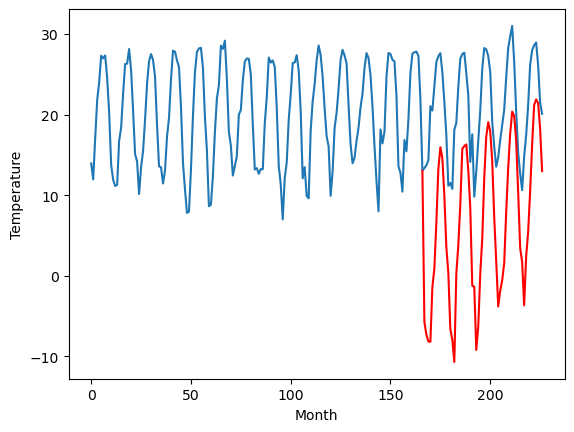

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		5.51		-1.76
5.84		3.96		-1.88
6.21		3.10		-3.11
5.45		3.07		-2.38
13.54		9.82		-3.72
13.51		12.18		-1.33
17.35		17.87		0.52
20.96		24.52		3.56
22.66		27.21		4.55
22.96		25.86		2.90
18.56		21.21		2.65
14.09		14.82		0.73
11.41		11.59		0.18
5.30		4.64		-0.66
4.71		3.30		-1.41
2.36		0.57		-1.79
10.74		11.48		0.74
12.86		15.05		2.19
16.90		20.10		3.20
21.45		27.02		5.57
21.53		27.36		5.83
22.64		27.57		4.93
19.90		24.36		4.46
16.60		19.66		3.06
8.96		10.01		1.05
12.20		9.90		-2.30
3.77		2.06		-1.71
3.39		4.95		1.56
9.51		11.49		1.98
15.66		15.85		0.19
20.26		23.38		3.12
23.98		28.52		4.54
25.34		30.34		5.00
22.62		29.20		6.58
19.96		25.48		5.52
14.39		18.50		4.11
8.51		13.09		4.58
6.28		7.45		1.17
7.04		9.41		2.37
8.23		10.71		2.48
12.03		12.83		0.80
12.95		19.14		6.19
18.03		24.62		6.59
22.95		28.91		5.96
25.11		31.64		6.53
26.81		31.12		4.31
22.33		27.99		5.66
14.44		21.64		7.20
8.16		14.7

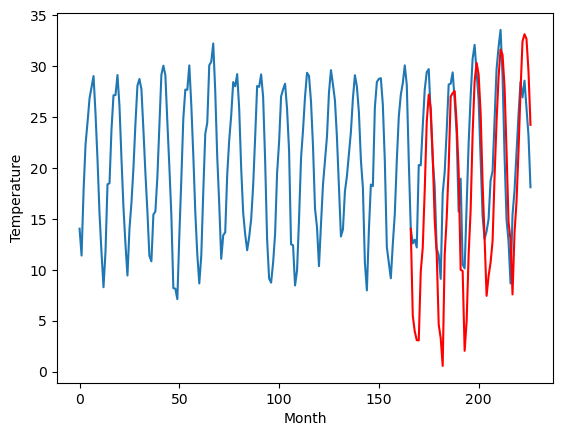

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		5.62		-1.03
4.84		4.07		-0.77
5.19		3.21		-1.98
4.63		3.18		-1.45
12.28		9.93		-2.35
12.59		12.29		-0.30
17.49		17.98		0.49
22.23		24.63		2.40
23.41		27.32		3.91
23.64		25.97		2.33
17.70		21.32		3.62
12.22		14.93		2.71
9.73		11.70		1.97
3.27		4.75		1.48
2.57		3.41		0.84
-0.54		0.68		1.22
9.83		11.59		1.76
11.53		15.16		3.63
15.61		20.21		4.60
21.17		27.13		5.96
22.06		27.47		5.41
22.62		27.68		5.06
20.35		24.47		4.12
15.84		19.77		3.93
7.87		10.12		2.25
10.16		10.01		-0.15
1.68		2.17		0.49
1.51		5.06		3.55
8.09		11.60		3.51
14.36		15.96		1.60
19.38		23.49		4.11
24.09		28.63		4.54
26.88		30.45		3.57
24.07		29.31		5.24
20.24		25.59		5.35
13.86		18.61		4.75
7.19		13.20		6.01
4.57		7.56		2.99
5.45		9.52		4.07
5.64		10.82		5.18
10.29		12.94		2.65
12.11		19.25		7.14
17.85		24.73		6.88
22.00		29.02		7.02
24.56		31.75		7.19
26.90		31.23		4.33
22.12		28.10		5.98
13.40		21.75		8.35
8.06		14.82		6

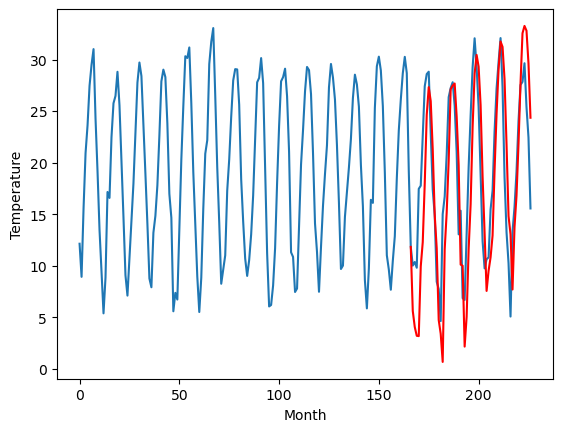

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		3.71		-2.32
1.50		2.16		0.66
2.75		1.30		-1.45
3.56		1.27		-2.29
8.06		8.02		-0.04
13.04		10.38		-2.66
19.33		16.07		-3.26
22.85		22.72		-0.13
24.95		25.41		0.46
25.39		24.06		-1.33
19.14		19.41		0.27
13.54		13.02		-0.52
7.98		9.79		1.81
0.33		2.84		2.51
0.87		1.50		0.63
3.79		-1.23		-5.02
6.89		9.68		2.79
13.55		13.25		-0.30
18.56		18.30		-0.26
23.55		25.22		1.67
22.35		25.56		3.21
21.83		25.77		3.94
19.65		22.56		2.91
13.09		17.86		4.77
7.69		8.21		0.52
4.34		8.10		3.76
1.34		0.26		-1.08
2.31		3.15		0.84
7.37		9.69		2.32
14.56		14.05		-0.51
19.26		21.58		2.32
23.12		26.72		3.60
24.26		28.54		4.28
21.24		27.40		6.16
19.51		23.68		4.17
11.30		16.70		5.40
4.41		11.29		6.88
2.24		5.65		3.41
1.53		7.61		6.08
2.74		8.91		6.17
7.44		11.03		3.59
13.08		17.34		4.26
17.73		22.82		5.09
22.39		27.11		4.72
27.14		29.84		2.70
24.14		29.32		5.18
21.48		26.19		4.71
14.74		19.84		5.10
7.63		12.91		5.2

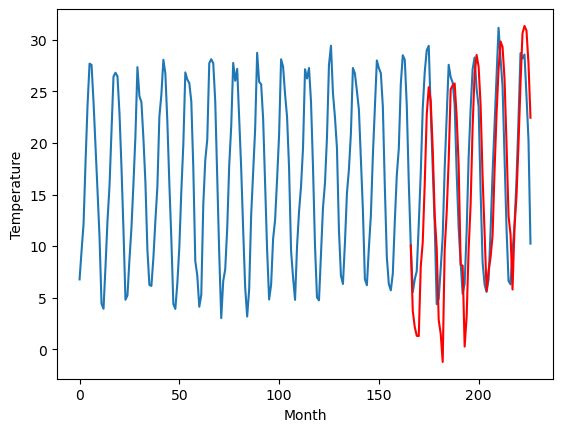

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-1.66		-3.83
-1.37		-3.21		-1.84
-0.83		-4.07		-3.24
1.28		-4.10		-5.38
1.35		2.65		1.30
4.56		5.01		0.45
8.61		10.70		2.09
9.90		17.35		7.45
12.31		20.04		7.73
14.71		18.69		3.98
13.11		14.04		0.93
9.87		7.65		-2.22
3.15		4.42		1.27
1.10		-2.53		-3.63
1.04		-3.87		-4.91
0.12		-6.60		-6.72
-0.28		4.31		4.59
3.58		7.88		4.30
5.80		12.93		7.13
10.04		19.85		9.81
13.02		20.19		7.17
12.62		20.40		7.78
10.84		17.19		6.35
5.86		12.49		6.63
4.60		2.84		-1.76
-1.91		2.73		4.64
0.50		-5.11		-5.61
1.37		-2.22		-3.59
3.16		4.32		1.16
5.28		8.68		3.40
6.24		16.21		9.97
11.16		21.35		10.19
11.97		23.17		11.20
14.01		22.03		8.02
13.60		18.31		4.71
7.33		11.33		4.00
1.10		5.92		4.82
-1.60		0.28		1.88
-1.94		2.24		4.18
-2.26		3.54		5.80
-1.25		5.66		6.91
2.59		11.97		9.38
3.80		17.45		13.65
5.76		21.74		15.98
12.68		24.47		11.79
12.31		23.95		11.64
8.81		20.82		12.01
7.22		14.47		7.25
2.83		7.54		4.71


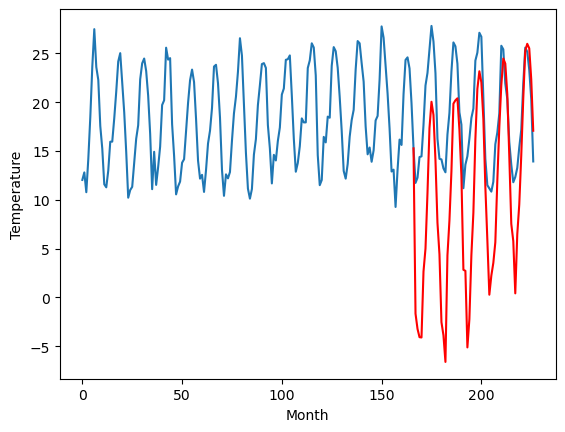

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.61		1.57
1.63		2.06		0.43
1.34		1.20		-0.14
2.38		1.17		-1.21
7.61		7.92		0.31
8.91		10.28		1.37
11.51		15.97		4.46
16.80		22.62		5.82
19.79		25.31		5.52
18.79		23.96		5.17
14.76		19.31		4.55
10.84		12.92		2.08
6.23		9.69		3.46
-0.77		2.74		3.51
-1.18		1.40		2.58
-0.68		-1.33		-0.65
6.20		9.58		3.38
8.99		13.15		4.16
13.01		18.20		5.19
17.30		25.12		7.82
18.87		25.46		6.59
18.96		25.67		6.71
14.85		22.46		7.61
11.57		17.76		6.19
2.66		8.11		5.45
4.58		8.00		3.42
-1.90		0.16		2.06
2.12		3.05		0.93
6.23		9.59		3.36
9.52		13.95		4.43
14.37		21.48		7.11
18.13		26.62		8.49
19.57		28.44		8.87
18.19		27.30		9.11
14.88		23.58		8.70
7.57		16.60		9.03
5.45		11.19		5.74
-1.08		5.55		6.63
2.12		7.51		5.39
5.14		8.81		3.67
5.59		10.93		5.34
9.11		17.24		8.13
11.89		22.72		10.83
15.55		27.01		11.46
19.14		29.74		10.60
18.59		29.22		10.63
14.63		26.09		11.46
9.34		19.74		10.40
3.44		12.81		9.37
0.9

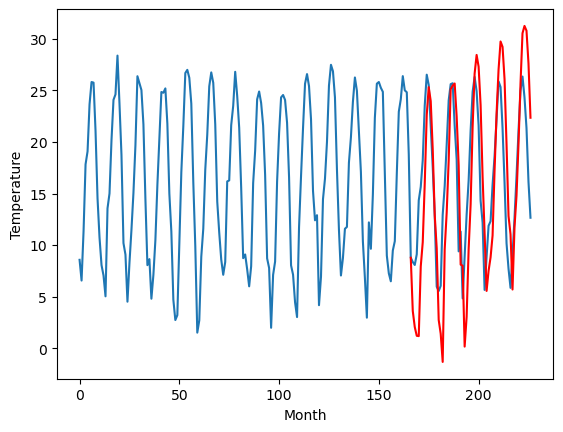

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		0.14		2.06
-1.32		-1.41		-0.09
-1.76		-2.27		-0.51
-1.96		-2.30		-0.34
4.08		4.45		0.37
4.51		6.81		2.30
8.55		12.50		3.95
13.92		19.15		5.23
17.21		21.84		4.63
15.95		20.49		4.54
12.00		15.84		3.84
7.34		9.45		2.11
2.29		6.22		3.93
-4.77		-0.73		4.04
-4.44		-2.07		2.37
-3.09		-4.80		-1.71
3.12		6.11		2.99
5.09		9.68		4.59
10.00		14.73		4.73
15.41		21.65		6.24
16.72		21.99		5.27
16.80		22.20		5.40
12.31		18.99		6.68
8.55		14.29		5.74
-1.67		4.64		6.31
0.43		4.53		4.10
-6.44		-3.31		3.13
-1.85		-0.42		1.43
2.70		6.12		3.42
5.86		10.48		4.62
12.10		18.01		5.91
15.75		23.15		7.40
17.10		24.97		7.87
15.85		23.83		7.98
11.70		20.11		8.41
4.42		13.13		8.71
1.97		7.72		5.75
-3.49		2.08		5.57
-1.57		4.04		5.61
1.22		5.34		4.12
1.75		7.46		5.71
6.64		13.77		7.13
9.99		19.25		9.26
12.90		23.54		10.64
16.45		26.27		9.82
15.74		25.75		10.01
12.96		22.62		9.66
6.91		16.27		9.36
0.70		9.34		8.64
-2

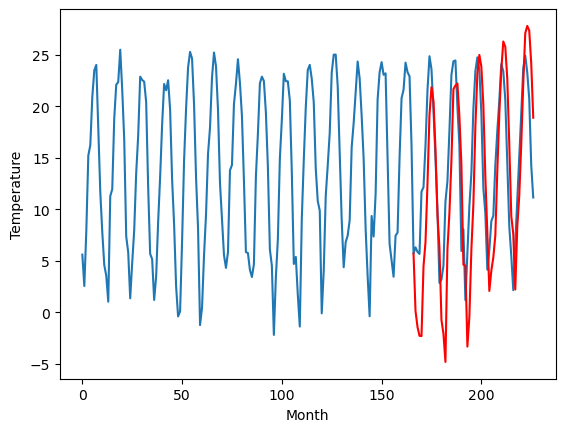

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65   0.140486
1                 1    3.41   0.180480
2                 2   -0.10  -2.149507
3                 3    9.24   9.390503
4                 4   -6.25  -5.749512
5                 5    7.27   5.510481
6                 6    6.65   5.620481
7                 7    6.03   3.710482
8                 8    2.17  -1.659513
9                 9    2.04   3.610499
10               10   -1.92   0.140498


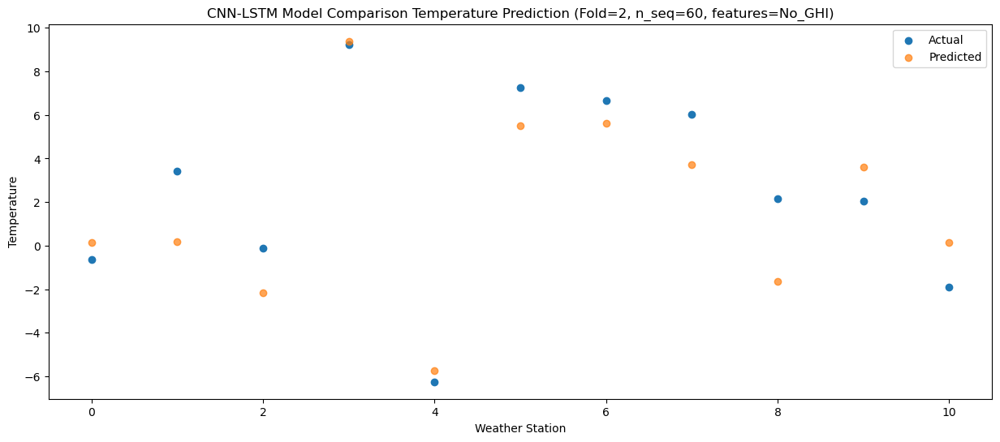

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -1.414852
1                 1    1.13  -1.374863
2                 2   -1.22  -3.704810
3                 3    6.18   7.835198
4                 4   -5.90  -7.304830
5                 5    5.84   3.955146
6                 6    4.84   4.065137
7                 7    1.50   2.155151
8                 8   -1.37  -3.214826
9                 9    1.63   2.055194
10               10   -1.32  -1.414812


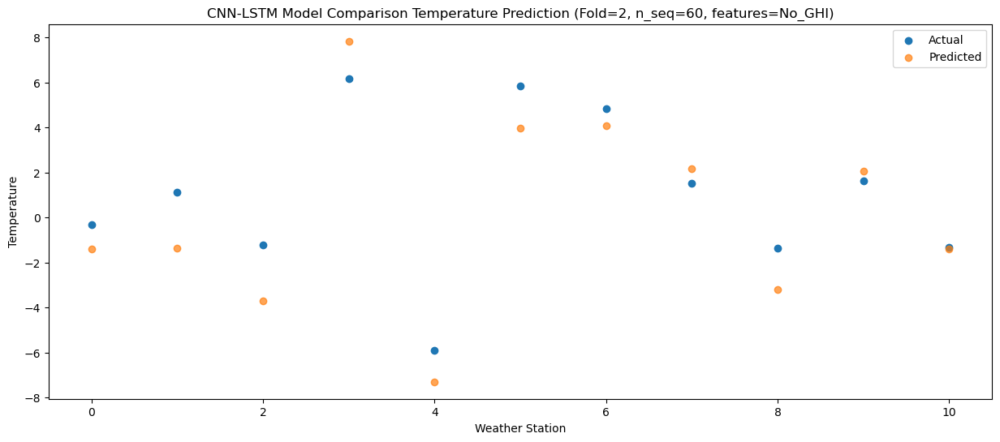

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -2.265958
1                 1    0.89  -2.225976
2                 2   -2.37  -4.555914
3                 3    6.45   6.984102
4                 4   -5.56  -8.155937
5                 5    6.21   3.104034
6                 6    5.19   3.214022
7                 7    2.75   1.304039
8                 8   -0.83  -4.065934
9                 9    1.34   1.204097
10               10   -1.76  -2.265908


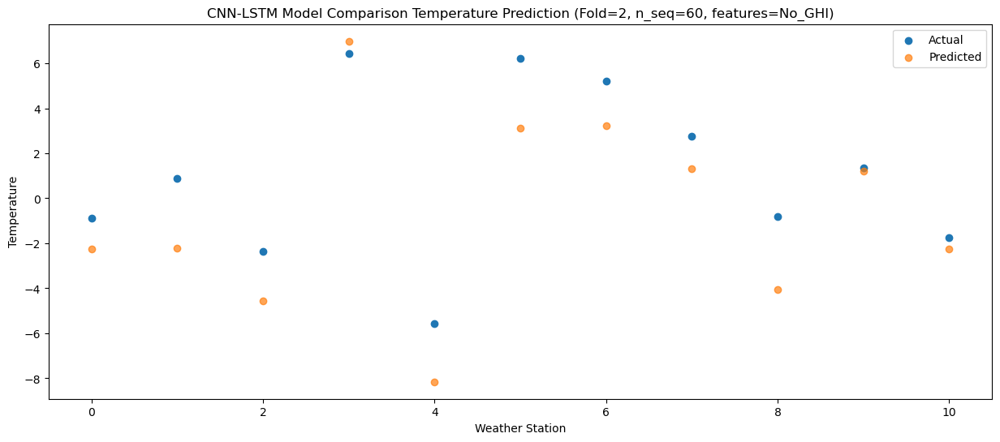

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -2.297657
1                 1    0.16  -2.257681
2                 2   -1.33  -4.587595
3                 3    6.60   6.952417
4                 4   -4.92  -8.187627
5                 5    5.45   3.072337
6                 6    4.63   3.182321
7                 7    3.56   1.272342
8                 8    1.28  -4.097626
9                 9    2.38   1.172413
10               10   -1.96  -2.297594


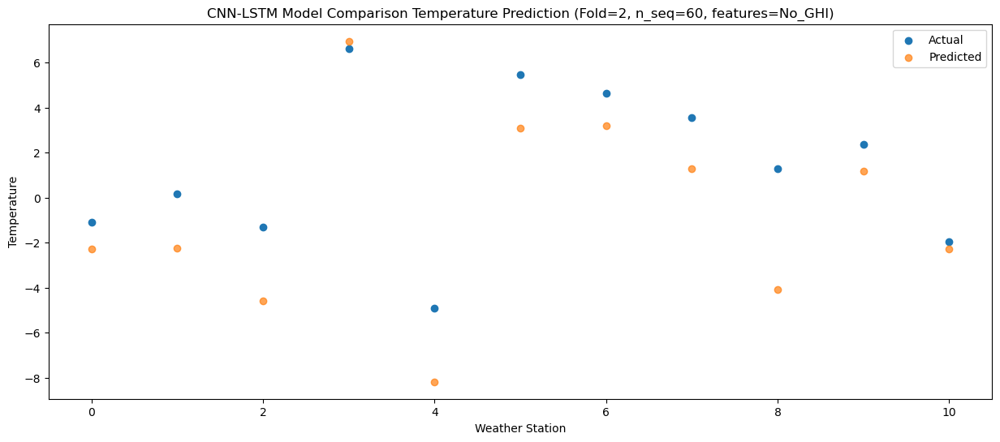

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   4.454092
1                 1    8.17   4.494067
2                 2    2.29   2.164134
3                 3   10.15  13.704150
4                 4    1.77  -1.435889
5                 5   13.54   9.824082
6                 6   12.28   9.934069
7                 7    8.06   8.024079
8                 8    1.35   2.654096
9                 9    7.61   7.924150
10               10    4.08   4.454139


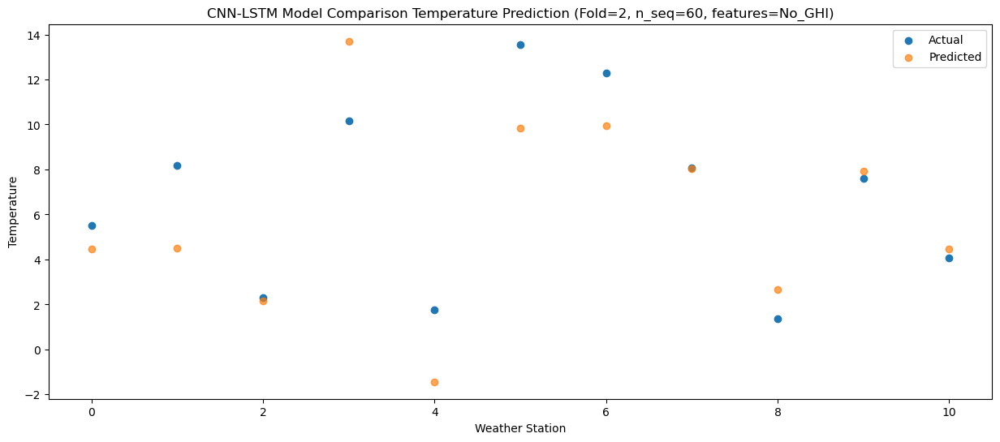

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   6.809618
1                 1   10.40   6.849588
2                 2    3.68   4.519650
3                 3   11.38  16.059670
4                 4    1.24   0.919631
5                 5   13.51  12.179601
6                 6   12.59  12.289592
7                 7   13.04  10.379592
8                 8    4.56   5.009616
9                 9    8.91  10.279667
10               10    4.51   6.809660


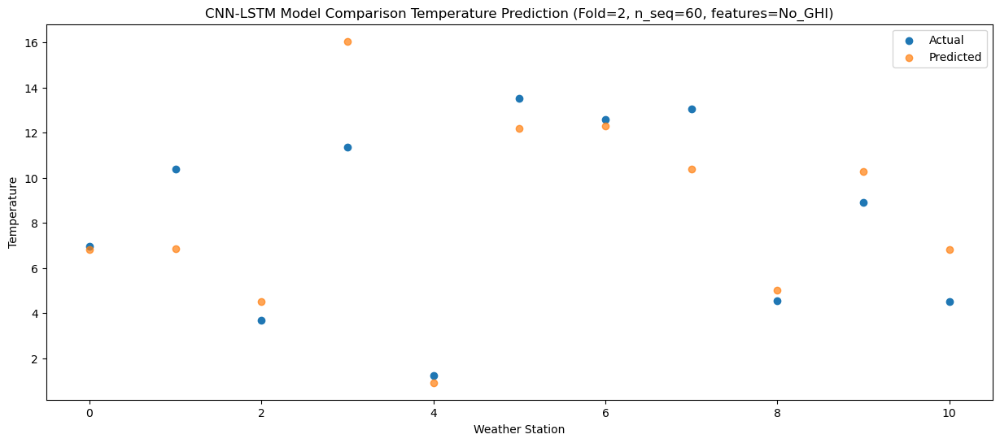

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  12.499389
1                 1   17.20  12.539343
2                 2    4.99  10.209449
3                 3   17.27  21.749469
4                 4    4.21   6.609414
5                 5   17.35  17.869368
6                 6   17.49  17.979347
7                 7   19.33  16.069355
8                 8    8.61  10.699399
9                 9   11.51  15.969470
10               10    8.55  12.499454


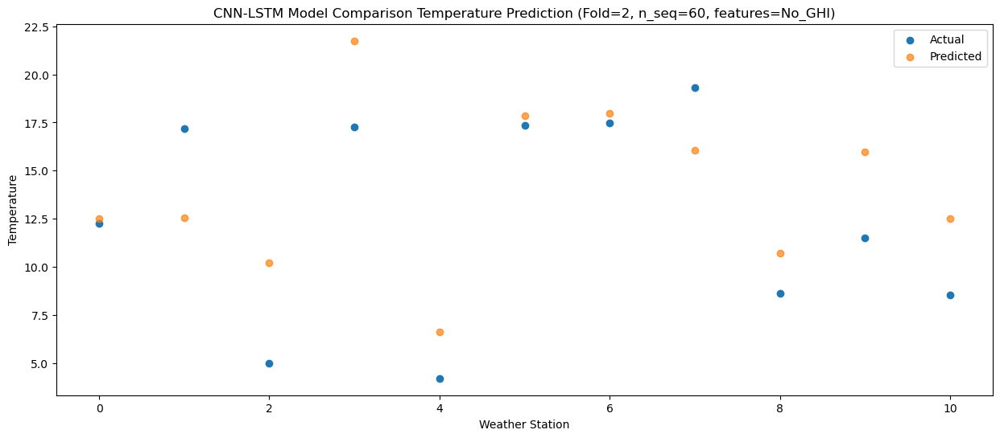

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  19.145404
1                 1   24.40  19.185364
2                 2    7.58  16.855412
3                 3   23.33  28.395432
4                 4    7.25  13.255401
5                 5   20.96  24.515375
6                 6   22.23  24.625364
7                 7   22.85  22.715360
8                 8    9.90  17.345373
9                 9   16.80  22.615441
10               10   13.92  19.145428


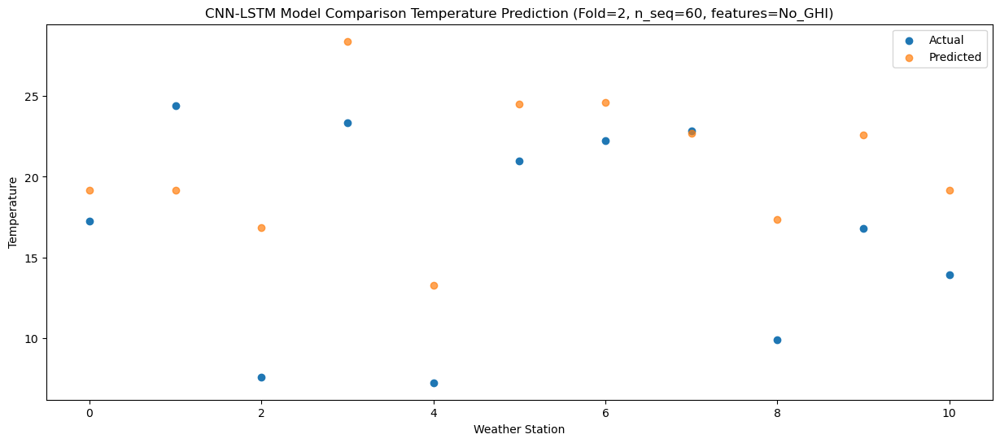

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  21.841552
1                 1   24.43  21.881523
2                 2    8.22  19.551531
3                 3   27.61  31.091555
4                 4    7.99  15.951535
5                 5   22.66  27.211519
6                 6   23.41  27.321516
7                 7   24.95  25.411504
8                 8   12.31  20.041501
9                 9   19.79  25.311563
10               10   17.21  21.841558


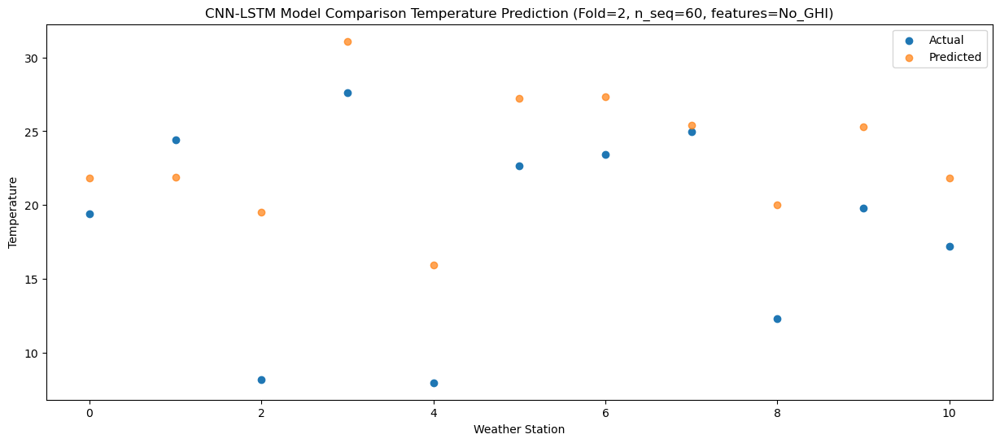

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  20.492481
1                 1   23.10  20.532456
2                 2    7.91  18.202479
3                 3   25.76  29.742497
4                 4    8.36  14.602476
5                 5   22.96  25.862461
6                 6   23.64  25.972445
7                 7   25.39  24.062444
8                 8   14.71  18.692449
9                 9   18.79  23.962504
10               10   15.95  20.492495


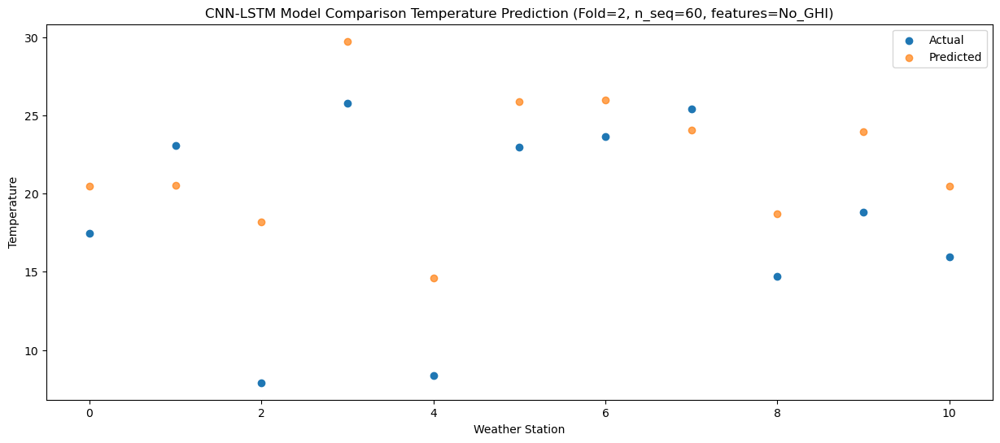

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  15.836777
1                 1   16.97  15.876756
2                 2    6.65  13.546783
3                 3   21.18  25.086799
4                 4    6.01   9.946777
5                 5   18.56  21.206761
6                 6   17.70  21.316742
7                 7   19.14  19.406749
8                 8   13.11  14.036758
9                 9   14.76  19.306805
10               10   12.00  15.836795


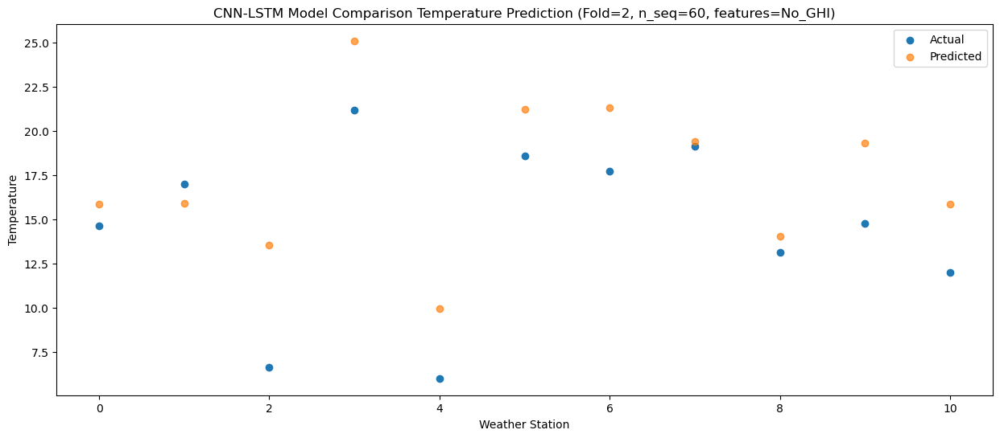

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   9.454832
1                 1    9.98   9.494816
2                 2    5.38   7.164856
3                 3   15.96  18.704865
4                 4    2.32   3.564847
5                 5   14.09  14.824826
6                 6   12.22  14.934804
7                 7   13.54  13.024820
8                 8    9.87   7.654836
9                 9   10.84  12.924871
10               10    7.34   9.454858


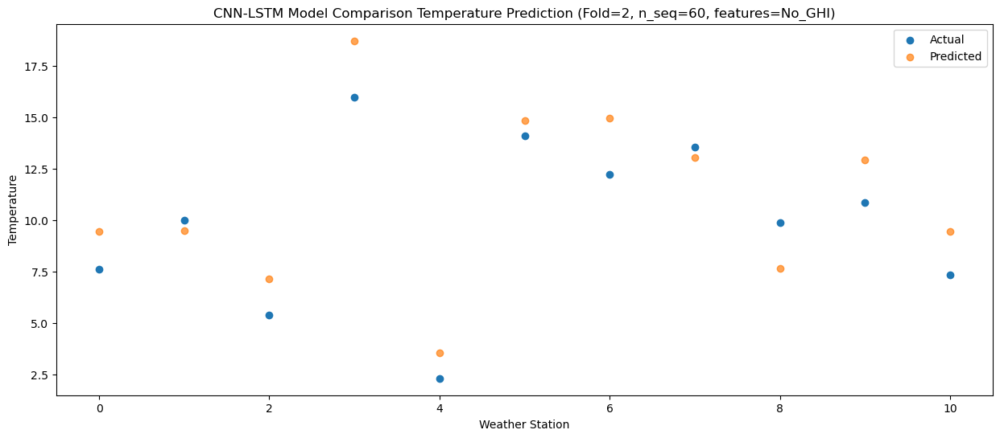

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   6.223520
1                 1    6.86   6.263511
2                 2    1.96   3.933529
3                 3   12.00  15.473539
4                 4   -1.80   0.333529
5                 5   11.41  11.593512
6                 6    9.73  11.703499
7                 7    7.98   9.793506
8                 8    3.15   4.423515
9                 9    6.23   9.693546
10               10    2.29   6.223532


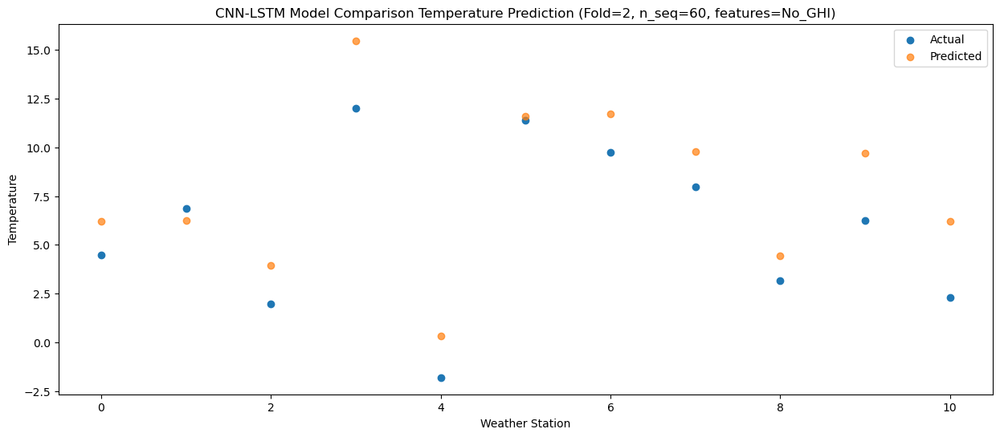

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -0.730254
1                 1    0.23  -0.690269
2                 2   -5.03  -3.020215
3                 3    5.17   8.519787
4                 4   -8.10  -6.620226
5                 5    5.30   4.639745
6                 6    3.27   4.749723
7                 7    0.33   2.839738
8                 8    1.10  -2.530237
9                 9   -0.77   2.739794
10               10   -4.77  -0.730222


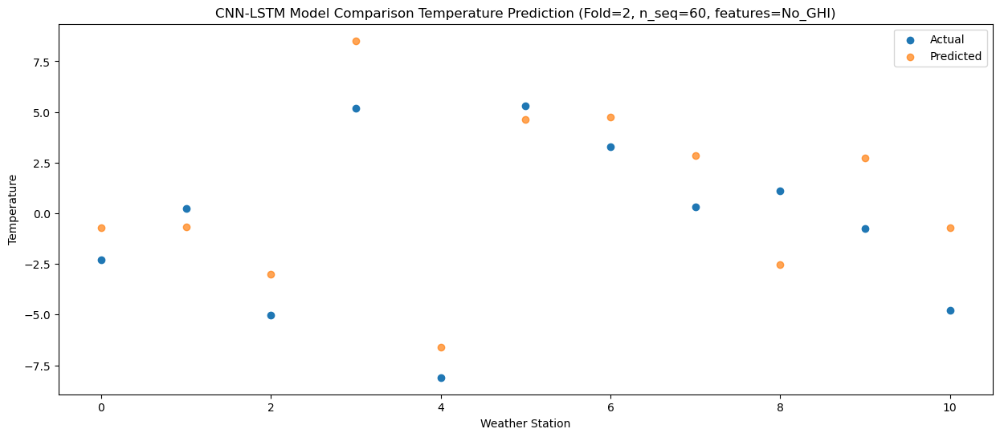

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -2.070971
1                 1    0.15  -2.030983
2                 2   -4.37  -4.360933
3                 3    2.09   7.179063
4                 4   -7.75  -7.960941
5                 5    4.71   3.299031
6                 6    2.57   3.409008
7                 7    0.87   1.499027
8                 8    1.04  -3.870951
9                 9   -1.18   1.399072
10               10   -4.44  -2.070942


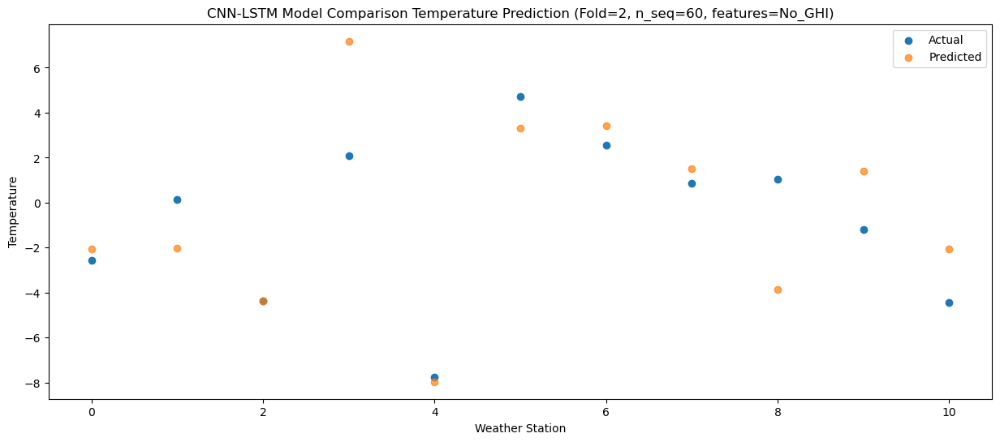

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -4.799581
1                 1   -3.89  -4.759606
2                 2   -1.64  -7.089561
3                 3    2.11   4.450443
4                 4   -8.49 -10.689564
5                 5    2.36   0.570411
6                 6   -0.54   0.680388
7                 7    3.79  -1.229598
8                 8    0.12  -6.599581
9                 9   -0.68  -1.329548
10               10   -3.09  -4.799559


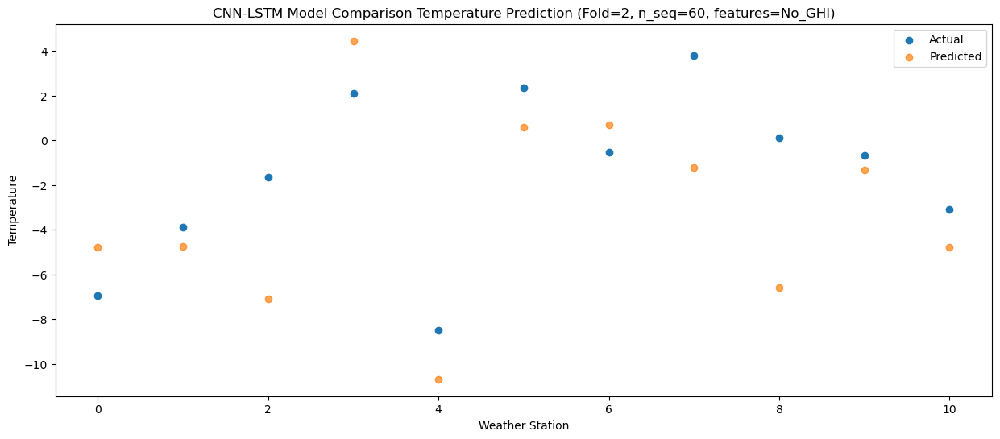

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   6.110316
1                 1    6.30   6.150284
2                 2    0.17   3.820328
3                 3    6.22  15.360328
4                 4   -1.16   0.220329
5                 5   10.74  11.480296
6                 6    9.83  11.590281
7                 7    6.89   9.680288
8                 8   -0.28   4.310304
9                 9    6.20   9.580346
10               10    3.12   6.110334


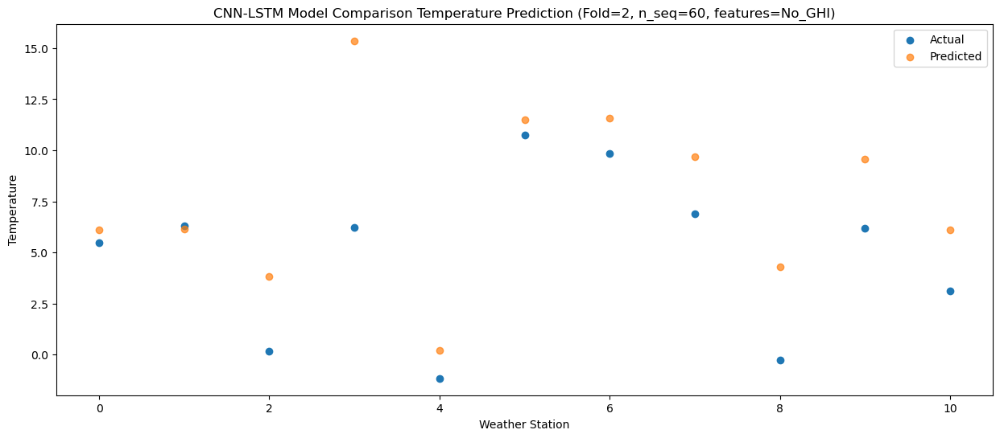

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   9.684336
1                 1   10.06   9.724301
2                 2    1.98   7.394328
3                 3   10.72  18.934335
4                 4   -0.29   3.794339
5                 5   12.86  15.054312
6                 6   11.53  15.164305
7                 7   13.55  13.254304
8                 8    3.58   7.884316
9                 9    8.99  13.154352
10               10    5.09   9.684344


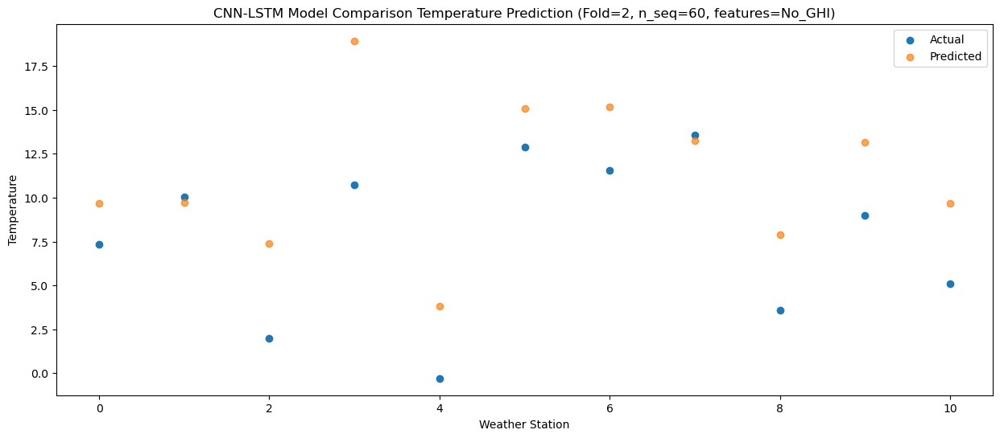

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  14.725558
1                 1   15.24  14.765545
2                 2    5.56  12.435574
3                 3   15.98  23.975560
4                 4    4.18   8.835580
5                 5   16.90  20.095554
6                 6   15.61  20.205547
7                 7   18.56  18.295565
8                 8    5.80  12.925581
9                 9   13.01  18.195576
10               10   10.00  14.725564


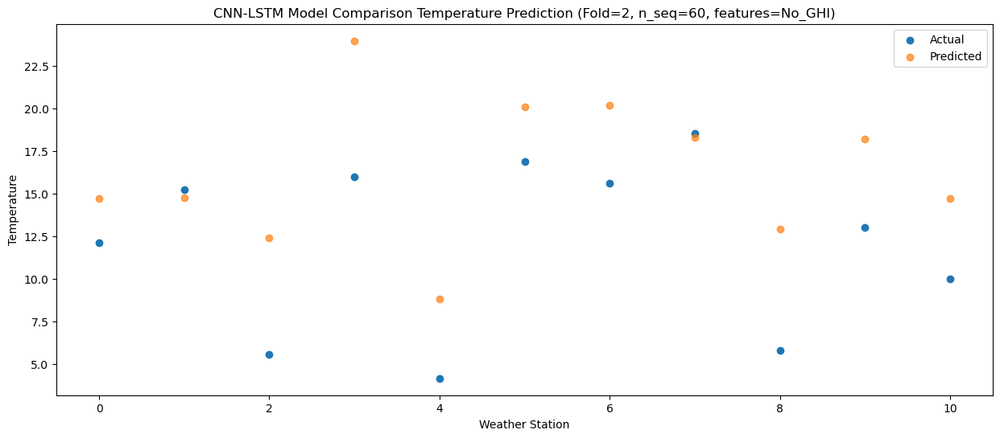

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  21.645982
1                 1   22.49  21.685987
2                 2    6.78  19.355986
3                 3   21.55  30.895977
4                 4    7.66  15.755999
5                 5   21.45  27.015981
6                 6   21.17  27.125984
7                 7   23.55  25.215997
8                 8   10.04  19.846007
9                 9   17.30  25.115992
10               10   15.41  21.645976


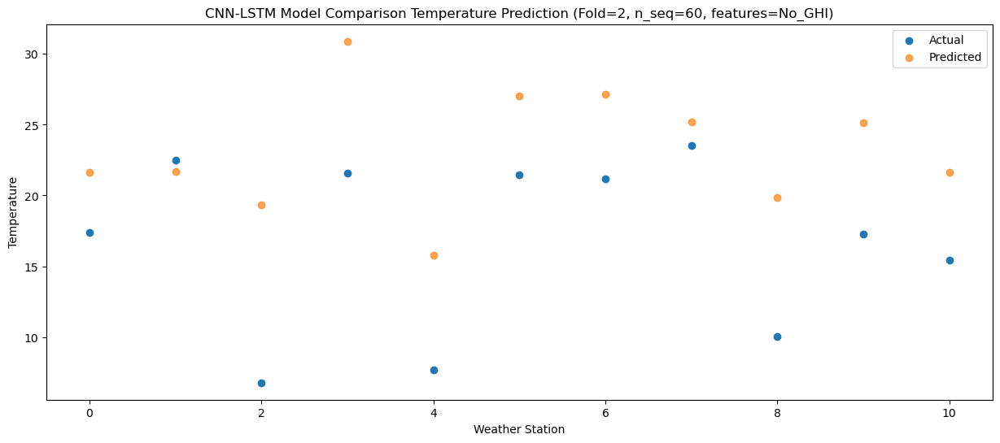

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  21.993220
1                 1   23.18  22.033233
2                 2    7.57  19.703240
3                 3   23.55  31.243229
4                 4    8.25  16.103245
5                 5   21.53  27.363229
6                 6   22.06  27.473225
7                 7   22.35  25.563257
8                 8   13.02  20.193274
9                 9   18.87  25.463236
10               10   16.72  21.993222


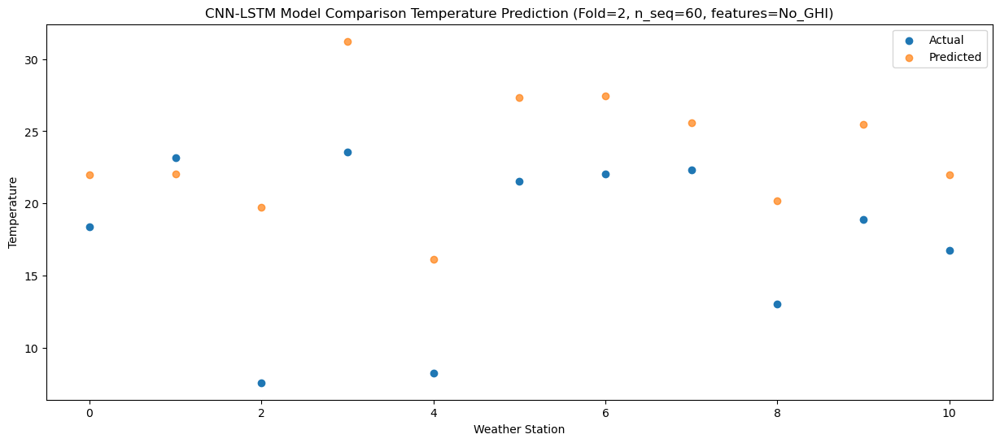

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  22.196365
1                 1   23.94  22.236382
2                 2    7.62  19.906377
3                 3   24.61  31.446366
4                 4    8.42  16.306386
5                 5   22.64  27.566373
6                 6   22.62  27.676376
7                 7   21.83  25.766404
8                 8   12.62  20.396415
9                 9   18.96  25.666373
10               10   16.80  22.196359


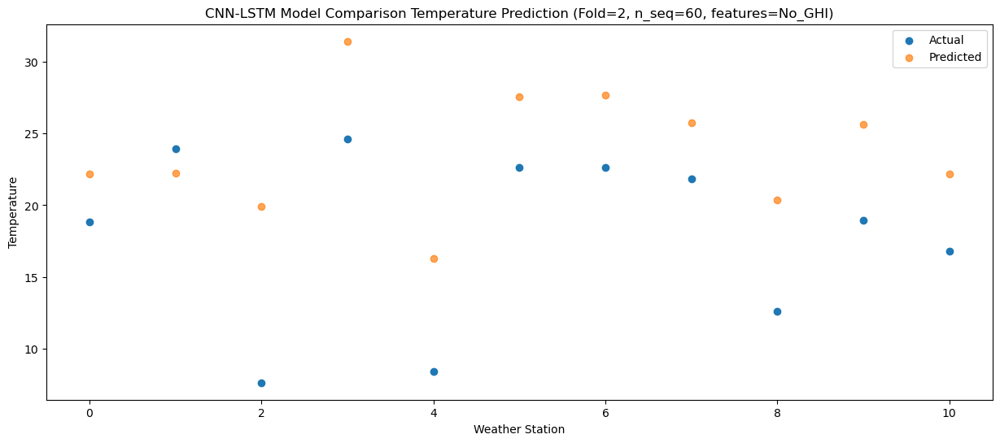

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  18.988850
1                 1   21.70  19.028865
2                 2    6.34  16.698870
3                 3   21.44  28.238859
4                 4    5.88  13.098877
5                 5   19.90  24.358860
6                 6   20.35  24.468860
7                 7   19.65  22.558892
8                 8   10.84  17.188902
9                 9   14.85  22.458867
10               10   12.31  18.988854


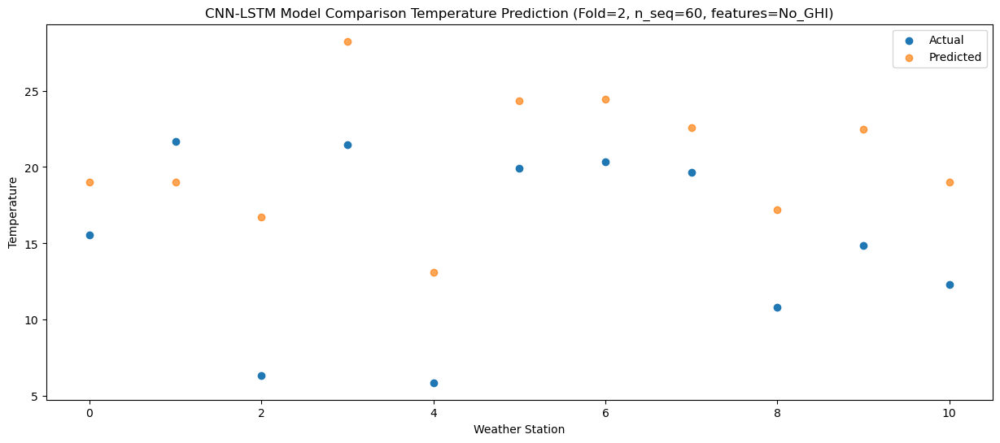

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  14.290016
1                 1   13.44  14.330025
2                 2    5.20  12.000077
3                 3   17.61  23.540059
4                 4    3.14   8.400067
5                 5   16.60  19.660034
6                 6   15.84  19.770025
7                 7   13.09  17.860070
8                 8    5.86  12.490100
9                 9   11.57  17.760066
10               10    8.55  14.290047


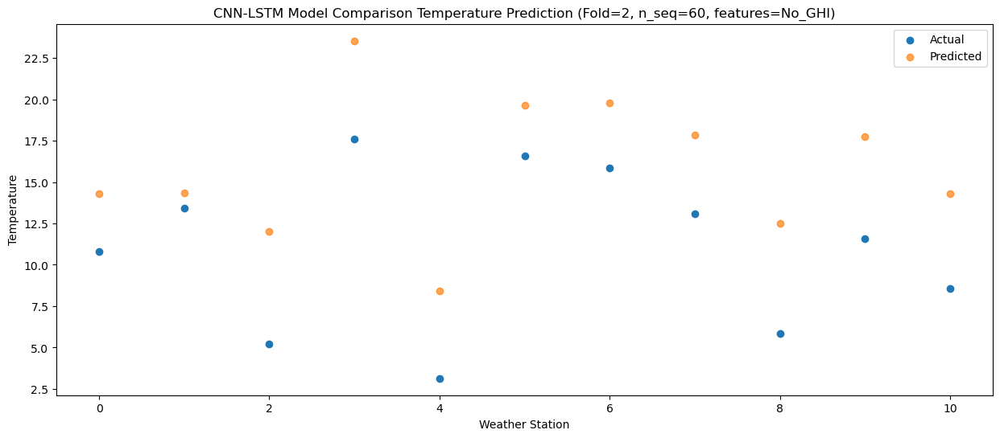

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   4.636780
1                 1    6.73   4.676785
2                 2   -1.65   2.346830
3                 3    9.53  13.886811
4                 4   -5.13  -1.253175
5                 5    8.96  10.006794
6                 6    7.87  10.116789
7                 7    7.69   8.206827
8                 8    4.60   2.836852
9                 9    2.66   8.106822
10               10   -1.67   4.636802


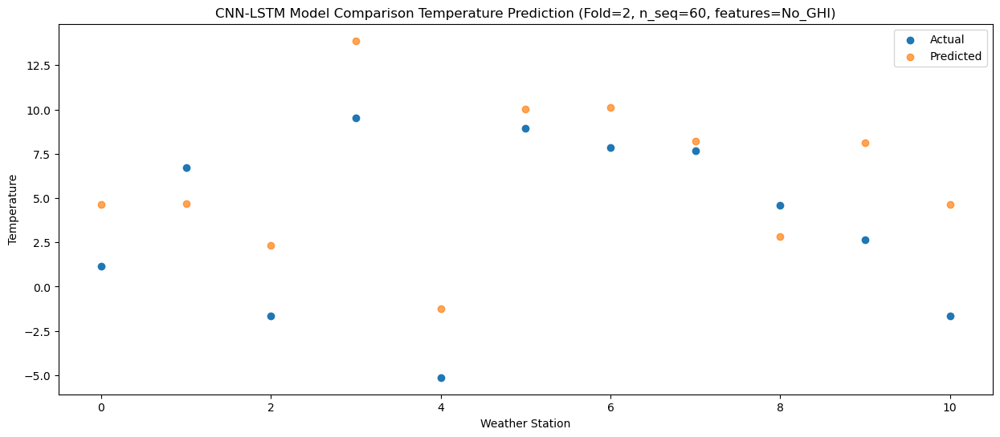

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   4.526806
1                 1    4.34   4.566821
2                 2   -0.75   2.236819
3                 3    7.61  13.776806
4                 4   -1.72  -1.363171
5                 5   12.20   9.896810
6                 6   10.16  10.006820
7                 7    4.34   8.096843
8                 8   -1.91   2.726851
9                 9    4.58   7.996818
10               10    0.43   4.526800


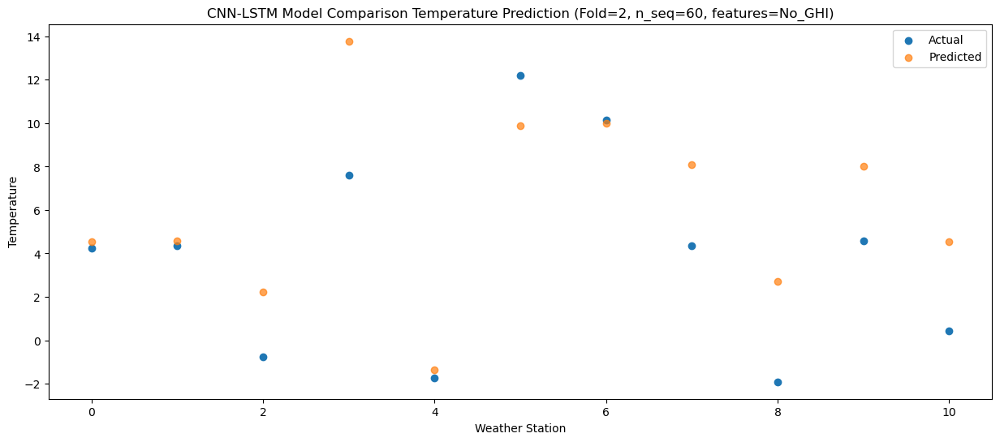

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -3.314549
1                 1   -0.35  -3.274530
2                 2   -5.01  -5.604555
3                 3    1.46   5.935446
4                 4   -9.45  -9.204539
5                 5    3.77   2.055449
6                 6    1.68   2.165465
7                 7    1.34   0.255484
8                 8    0.50  -5.114515
9                 9   -1.90   0.155453
10               10   -6.44  -3.314562


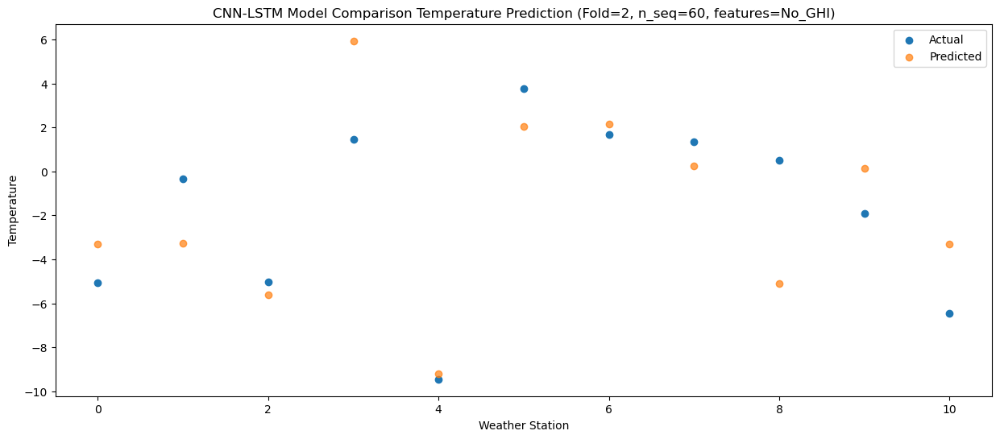

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -0.417483
1                 1   -0.36  -0.377453
2                 2   -2.68  -2.707494
3                 3    3.78   8.832510
4                 4   -6.31  -6.307471
5                 5    3.39   4.952522
6                 6    1.51   5.062537
7                 7    2.31   3.152558
8                 8    1.37  -2.217443
9                 9    2.12   3.052517
10               10   -1.85  -0.417499


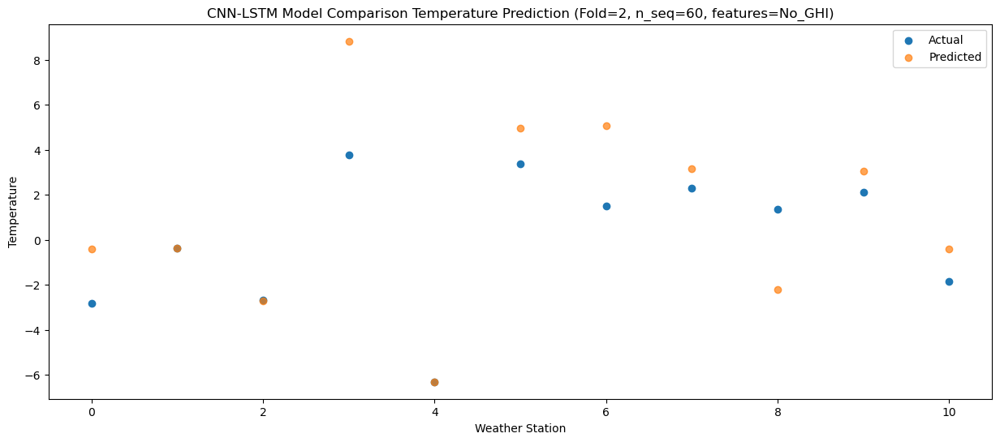

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   6.122463
1                 1    6.62   6.162492
2                 2    0.79   3.832472
3                 3    7.64  15.372476
4                 4   -2.55   0.232482
5                 5    9.51  11.492463
6                 6    8.09  11.602480
7                 7    7.37   9.692510
8                 8    3.16   4.322515
9                 9    6.23   9.592483
10               10    2.70   6.122461


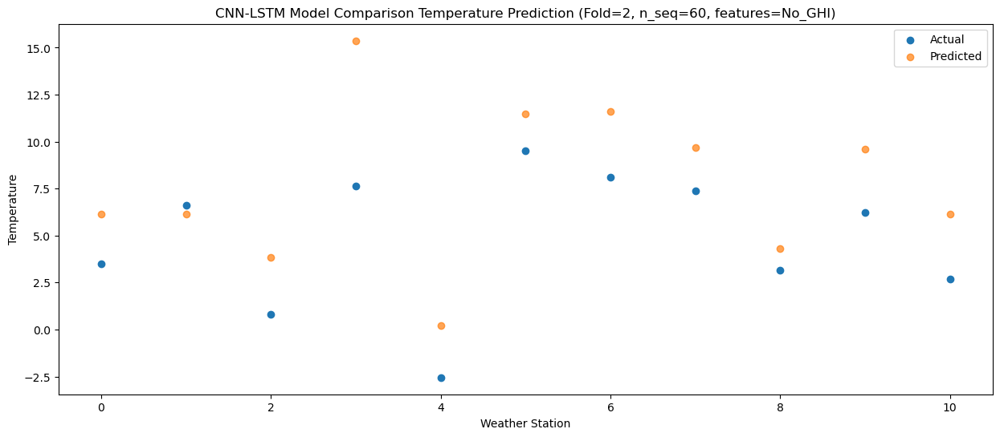

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51  10.475257
1                 1   13.30  10.515291
2                 2    2.60   8.185275
3                 3   12.08  19.725282
4                 4    1.25   4.585285
5                 5   15.66  15.845260
6                 6   14.36  15.955277
7                 7   14.56  14.045307
8                 8    5.28   8.675322
9                 9    9.52  13.945282
10               10    5.86  10.475260


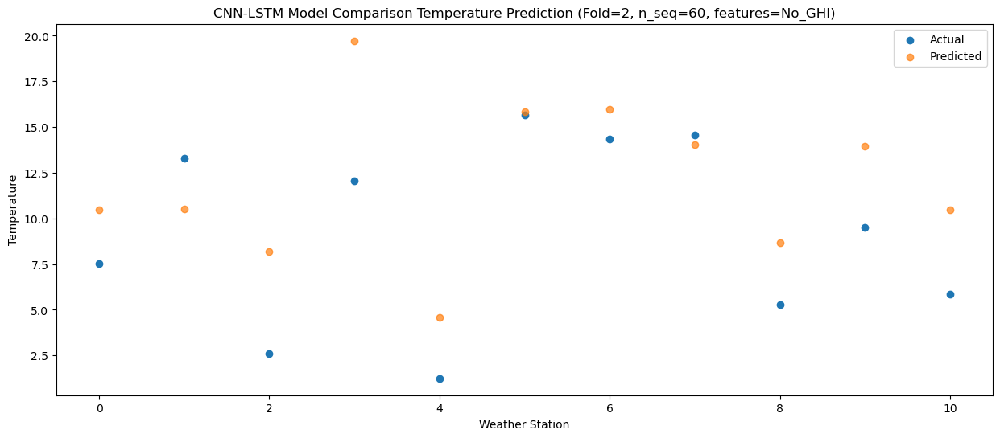

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  18.006142
1                 1   19.10  18.046176
2                 2    5.36  15.716144
3                 3   17.42  27.256161
4                 4    6.41  12.116161
5                 5   20.26  23.376136
6                 6   19.38  23.486160
7                 7   19.26  21.576187
8                 8    6.24  16.206195
9                 9   14.37  21.476162
10               10   12.10  18.006137


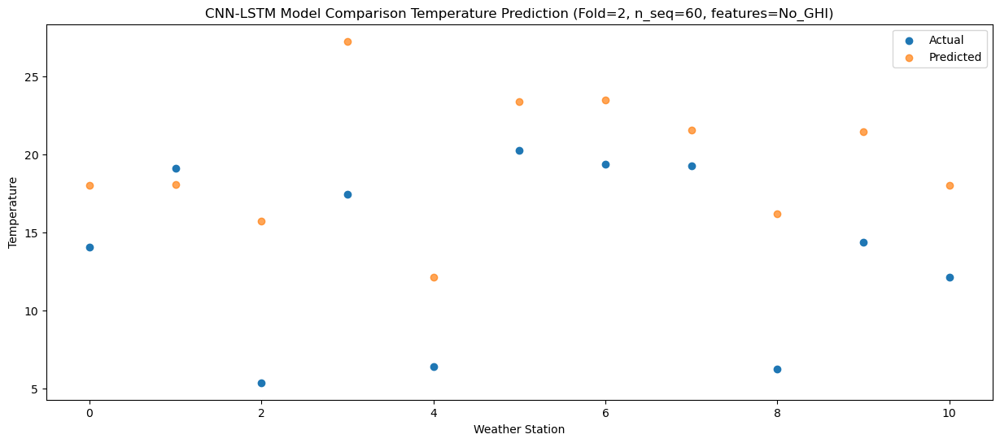

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  23.154426
1                 1   22.90  23.194455
2                 2    7.17  20.864415
3                 3   21.66  32.404440
4                 4    9.00  17.264432
5                 5   23.98  28.524407
6                 6   24.09  28.634441
7                 7   23.12  26.724450
8                 8   11.16  21.354460
9                 9   18.13  26.624440
10               10   15.75  23.154418


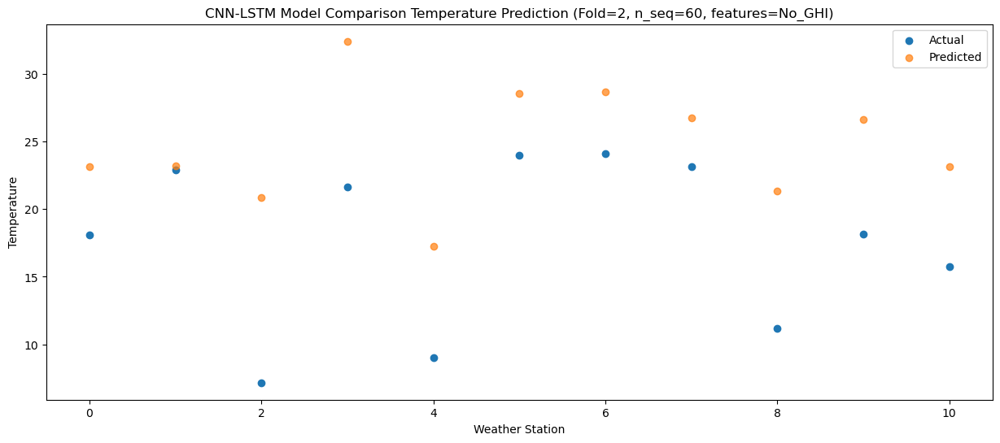

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  24.965358
1                 1   26.14  25.005391
2                 2    7.35  22.675351
3                 3   26.28  34.215374
4                 4    8.83  19.075364
5                 5   25.34  30.335343
6                 6   26.88  30.445377
7                 7   24.26  28.535385
8                 8   11.97  23.165400
9                 9   19.57  28.435370
10               10   17.10  24.965350


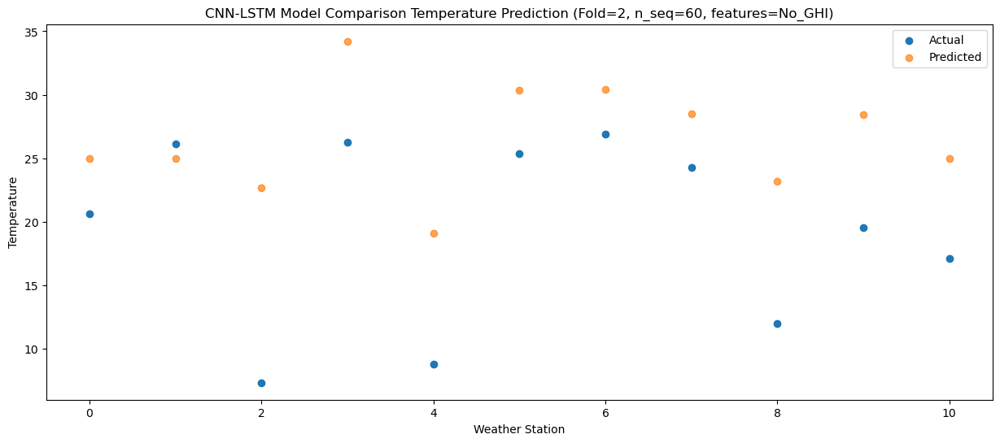

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  23.830782
1                 1   23.83  23.870807
2                 2    6.78  21.540793
3                 3   26.20  33.080815
4                 4    8.01  17.940799
5                 5   22.62  29.200766
6                 6   24.07  29.310794
7                 7   21.24  27.400813
8                 8   14.01  22.030835
9                 9   18.19  27.300808
10               10   15.85  23.830787


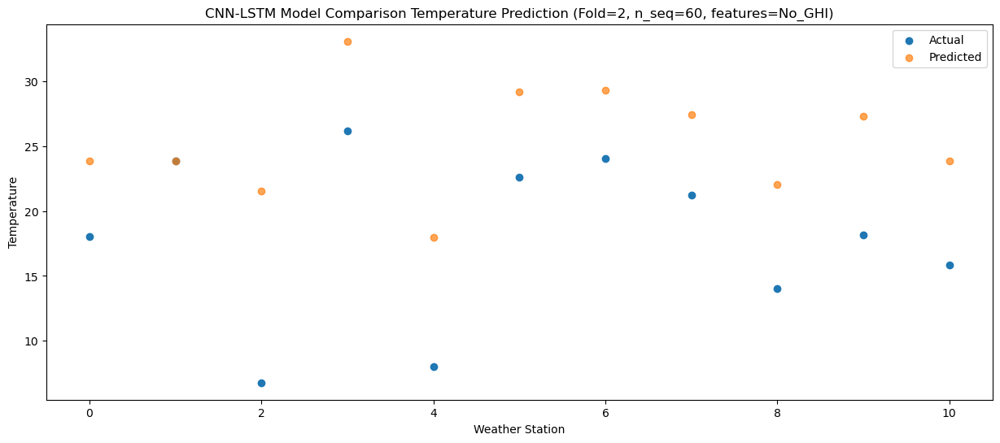

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  20.110446
1                 1   21.07  20.150472
2                 2    5.37  17.820450
3                 3   21.16  29.360468
4                 4    6.04  14.220460
5                 5   19.96  25.480427
6                 6   20.24  25.590460
7                 7   19.51  23.680473
8                 8   13.60  18.310495
9                 9   14.88  23.580467
10               10   11.70  20.110444


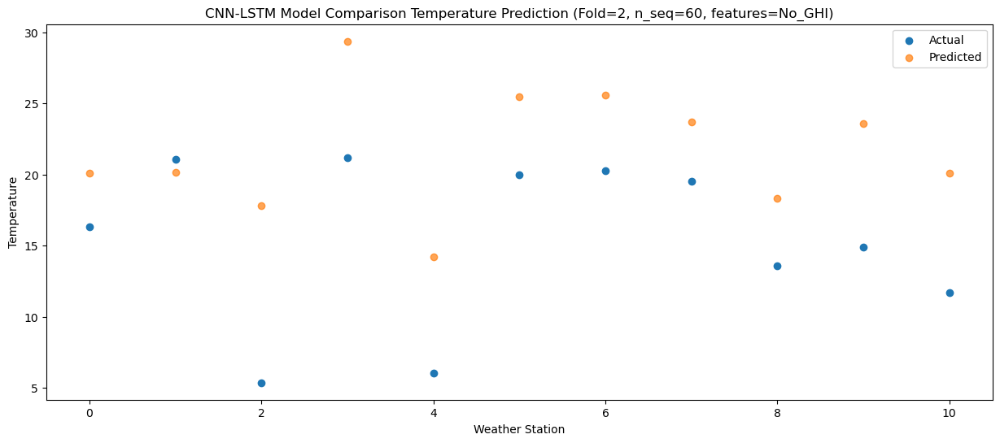

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97  13.133043
1                 1   12.69  13.173069
2                 2    2.74  10.843068
3                 3   15.72  22.383091
4                 4   -0.15   7.243067
5                 5   14.39  18.503031
6                 6   13.86  18.613056
7                 7   11.30  16.703077
8                 8    7.33  11.333112
9                 9    7.57  16.603083
10               10    4.42  13.133058


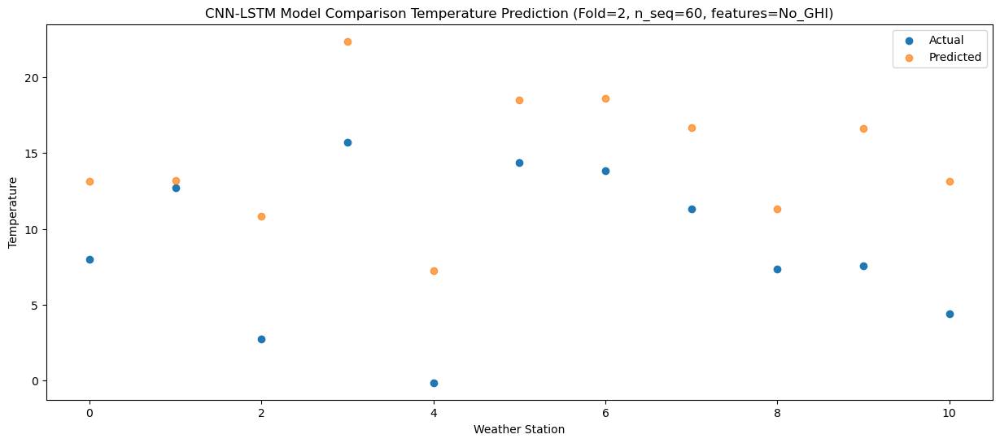

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   7.717699
1                 1    2.70   7.757718
2                 2    0.98   5.427706
3                 3   11.92  16.967741
4                 4   -3.22   1.827709
5                 5    8.51  13.087677
6                 6    7.19  13.197701
7                 7    4.41  11.287716
8                 8    1.10   5.917744
9                 9    5.45  11.187733
10               10    1.97   7.717712


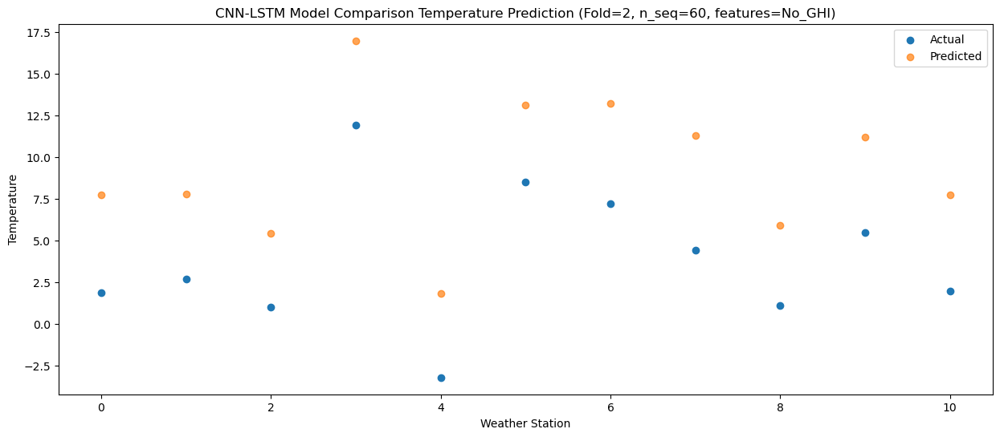

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67   2.083751
1                 1   -0.01   2.123775
2                 2   -3.12  -0.206252
3                 3    5.75  11.333780
4                 4   -5.73  -3.806243
5                 5    6.28   7.453732
6                 6    4.57   7.563757
7                 7    2.24   5.653770
8                 8   -1.60   0.283790
9                 9   -1.08   5.553773
10               10   -3.49   2.083754


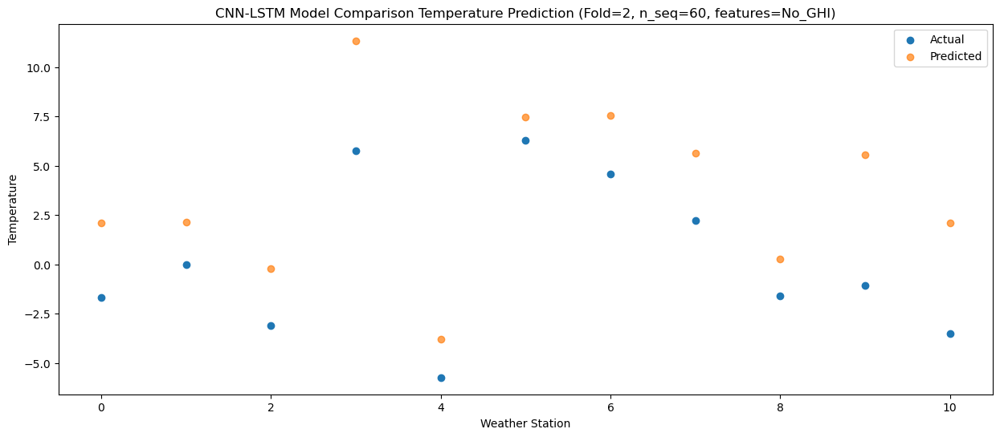

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35   4.037999
1                 1   -0.26   4.078019
2                 2   -3.32   1.747990
3                 3    7.04  13.288020
4                 4   -4.56  -1.851995
5                 5    7.04   9.407980
6                 6    5.45   9.518007
7                 7    1.53   7.608014
8                 8   -1.94   2.238030
9                 9    2.12   7.508013
10               10   -1.57   4.037997


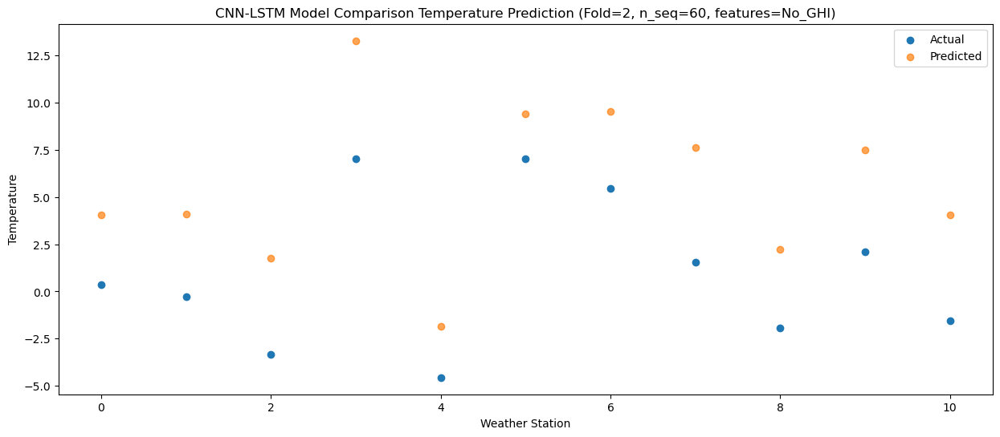

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37   5.344282
1                 1    1.34   5.384299
2                 2   -0.26   3.054286
3                 3    5.16  14.594308
4                 4   -2.43  -0.545702
5                 5    8.23  10.714273
6                 6    5.64  10.824291
7                 7    2.74   8.914305
8                 8   -2.26   3.544325
9                 9    5.14   8.814301
10               10    1.22   5.344278


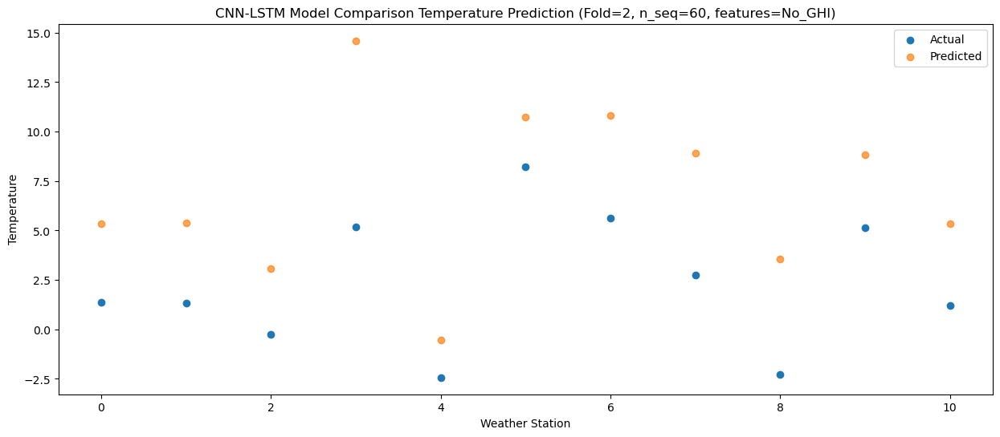

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   7.455876
1                 1    5.41   7.495892
2                 2    0.76   5.165863
3                 3    7.60  16.705886
4                 4   -0.60   1.565886
5                 5   12.03  12.825867
6                 6   10.29  12.935886
7                 7    7.44  11.025897
8                 8   -1.25   5.655909
9                 9    5.59  10.925883
10               10    1.75   7.455860


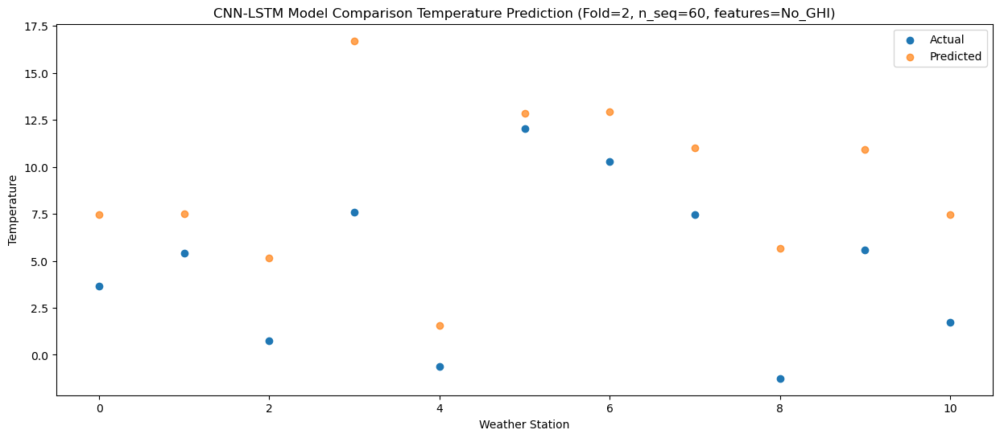

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79  13.773250
1                 1   11.27  13.813270
2                 2    3.30  11.483218
3                 3   13.32  23.023238
4                 4    1.32   7.883248
5                 5   12.95  19.143243
6                 6   12.11  19.253270
7                 7   13.08  17.343269
8                 8    2.59  11.973269
9                 9    9.11  17.243235
10               10    6.64  13.773210


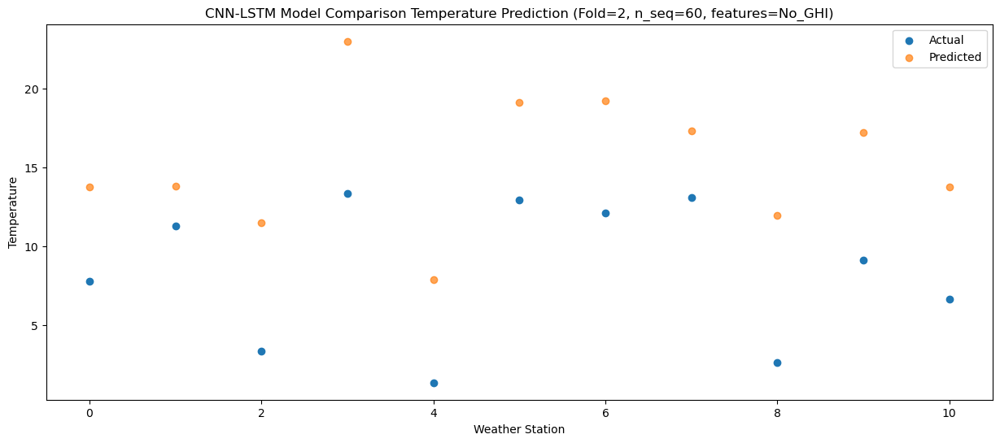

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  19.250748
1                 1   16.76  19.290772
2                 2    4.28  16.960723
3                 3   16.95  28.500728
4                 4    5.35  13.360750
5                 5   18.03  24.620748
6                 6   17.85  24.730772
7                 7   17.73  22.820771
8                 8    3.80  17.450771
9                 9   11.89  22.720733
10               10    9.99  19.250705


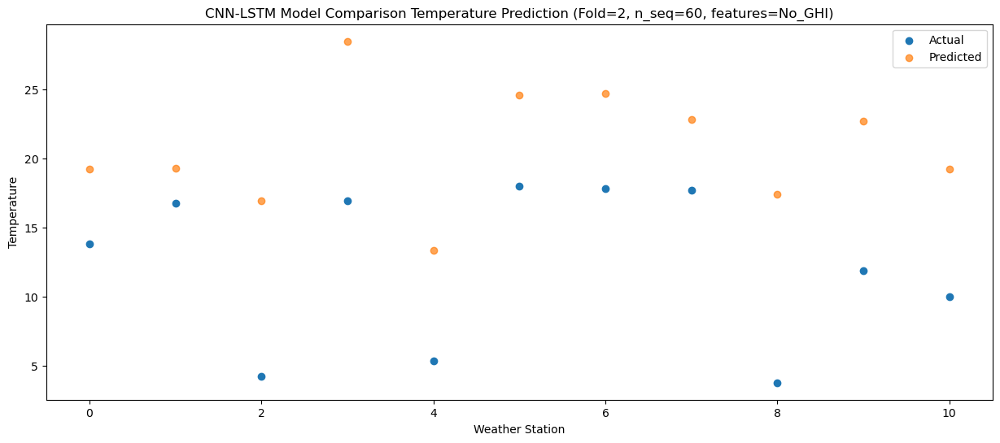

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  23.542841
1                 1   19.37  23.582858
2                 2    6.69  21.252881
3                 3   20.74  32.792876
4                 4    9.00  17.652876
5                 5   22.95  28.912855
6                 6   22.00  29.022857
7                 7   22.39  27.112885
8                 8    5.76  21.742925
9                 9   15.55  27.012873
10               10   12.90  23.542841


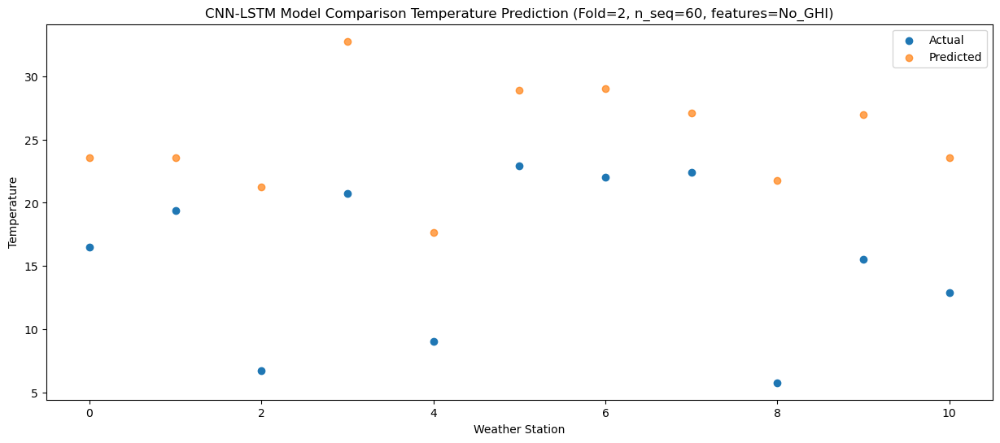

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  26.270375
1                 1   23.47  26.310383
2                 2    8.60  23.980446
3                 3   26.31  35.520439
4                 4   10.44  20.380427
5                 5   25.11  31.640392
6                 6   24.56  31.750388
7                 7   27.14  29.840420
8                 8   12.68  24.470476
9                 9   19.14  29.740430
10               10   16.45  26.270401


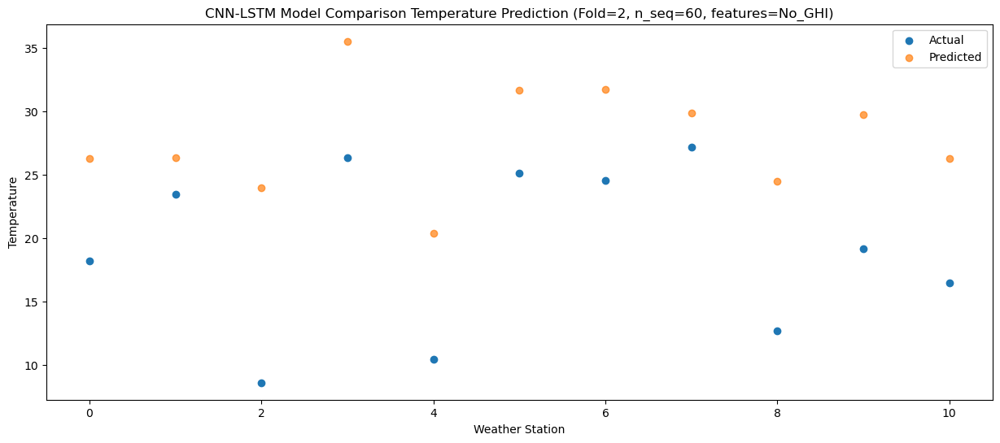

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  25.746934
1                 1   23.96  25.786946
2                 2    8.78  23.457027
3                 3   24.30  34.997012
4                 4   11.74  19.856997
5                 5   26.81  31.116960
6                 6   26.90  31.226946
7                 7   24.14  29.316990
8                 8   12.31  23.947057
9                 9   18.59  29.217003
10               10   15.74  25.746973


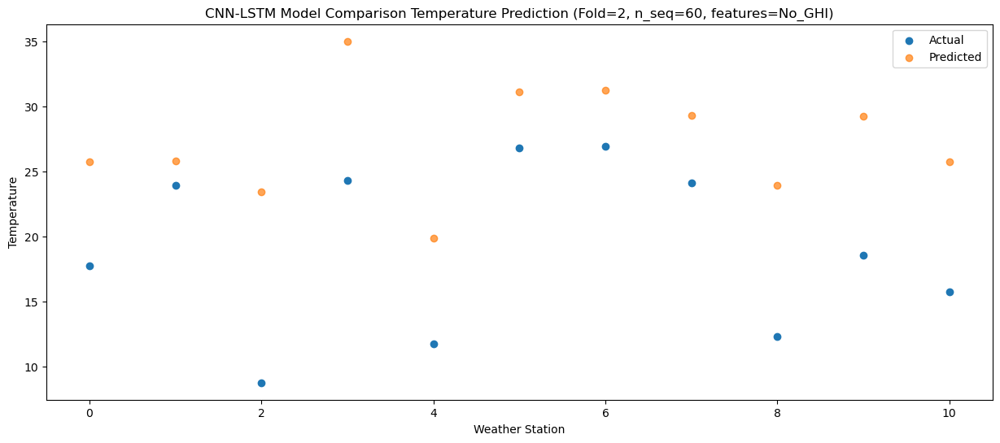

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  22.617308
1                 1   21.09  22.657314
2                 2    6.83  20.327408
3                 3   21.88  31.867382
4                 4    7.31  16.727371
5                 5   22.33  27.987339
6                 6   22.12  28.097319
7                 7   21.48  26.187362
8                 8    8.81  20.817435
9                 9   14.63  26.087377
10               10   12.96  22.617345


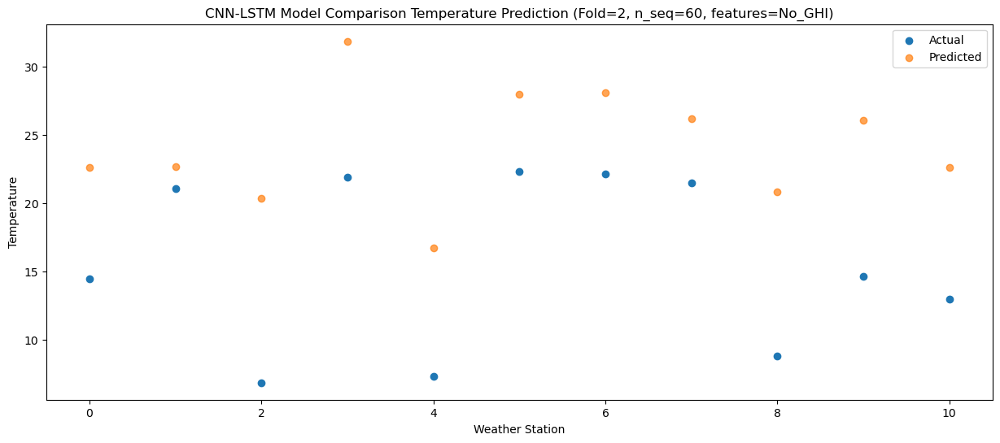

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28  16.274636
1                 1   12.05  16.314638
2                 2    3.25  13.984760
3                 3   16.86  25.524731
4                 4    1.15  10.384710
5                 5   14.44  21.644669
6                 6   13.40  21.754643
7                 7   14.74  19.844696
8                 8    7.22  14.474785
9                 9    9.34  19.744725
10               10    6.91  16.274690


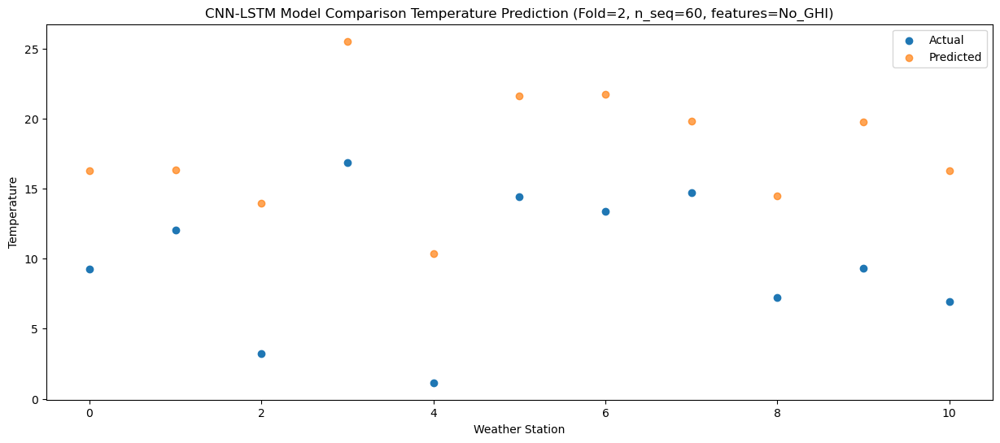

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   9.338660
1                 1    5.33   9.378661
2                 2   -0.73   7.048788
3                 3    8.88  18.588764
4                 4   -3.96   3.448738
5                 5    8.16  14.708693
6                 6    8.06  14.818665
7                 7    7.63  12.908715
8                 8    2.83   7.538807
9                 9    3.44  12.808755
10               10    0.70   9.338723


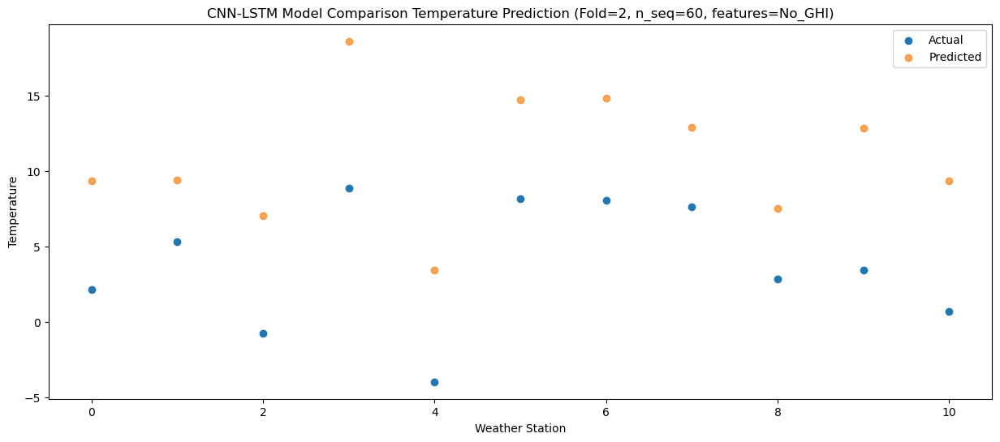

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89   7.579562
1                 1    1.66   7.619566
2                 2   -2.66   5.289671
3                 3    8.14  16.829655
4                 4   -6.56   1.689625
5                 5    6.05  12.949588
6                 6    5.08  13.059566
7                 7    2.59  11.149611
8                 8    0.50   5.779690
9                 9    0.97  11.049650
10               10   -2.15   7.579616


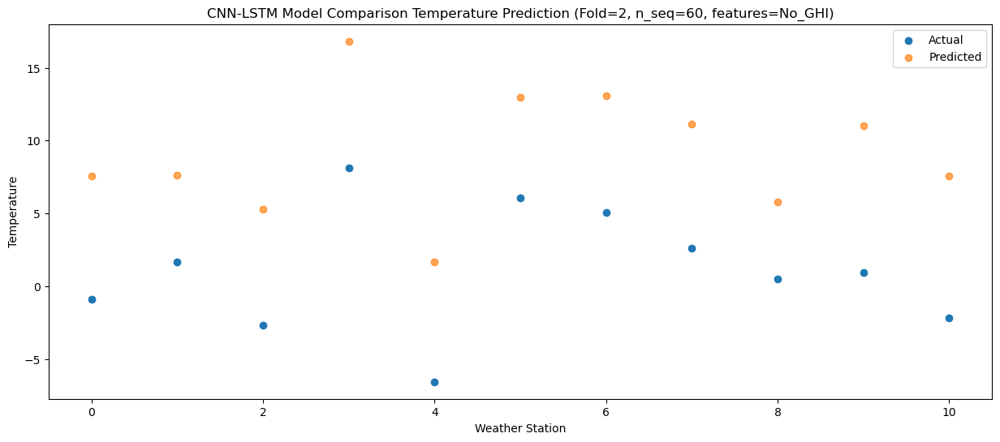

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68   2.221530
1                 1   -3.43   2.261541
2                 2   -4.66  -0.068363
3                 3    3.97  11.471619
4                 4   -8.64  -3.668409
5                 5    1.90   7.591562
6                 6   -0.10   7.701537
7                 7    2.26   5.791582
8                 8   -1.30   0.421662
9                 9   -0.88   5.691613
10               10   -5.47   2.221581


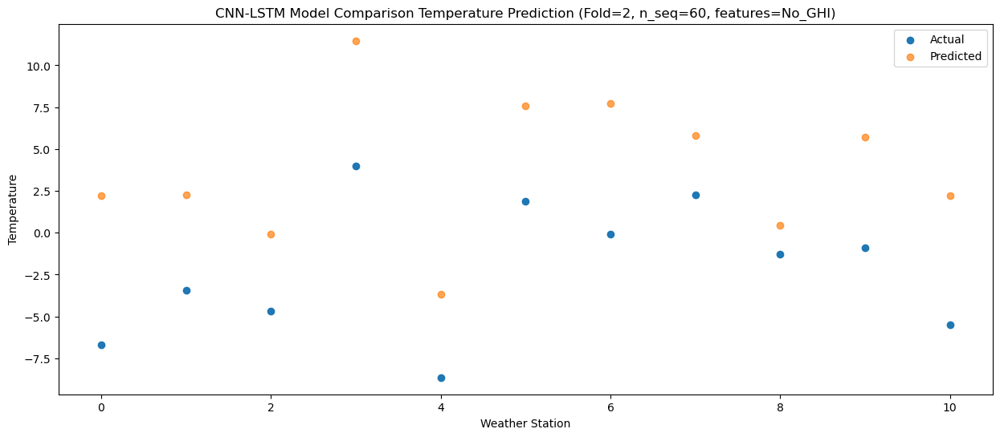

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64   8.276103
1                 1    4.05   8.316107
2                 2   -4.18   5.986222
3                 3    4.65  17.526203
4                 4   -4.48   2.386170
5                 5    8.66  13.646134
6                 6    8.16  13.756108
7                 7    5.47  11.846153
8                 8   -0.77   6.476241
9                 9    2.34  11.746194
10               10   -0.93   8.276162


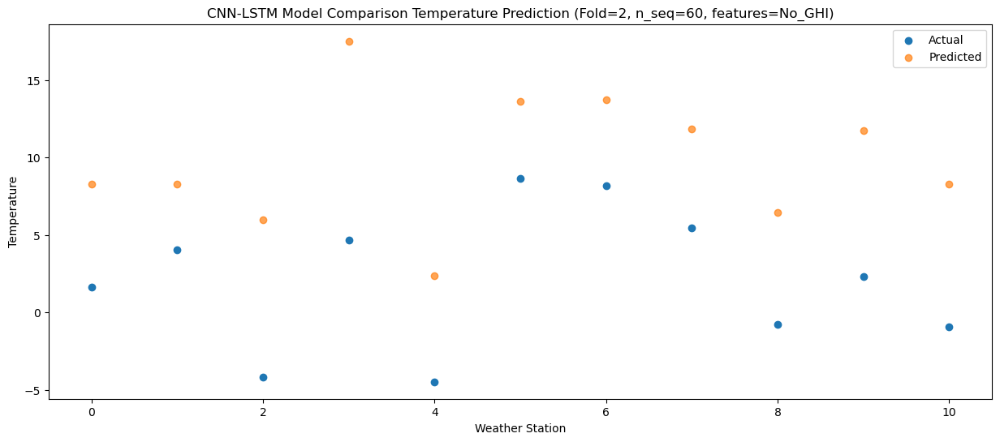

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53  11.328329
1                 1    6.82  11.368337
2                 2    0.24   9.038437
3                 3    9.05  20.578425
4                 4   -1.81   5.438388
5                 5   11.03  16.698356
6                 6   10.51  16.808334
7                 7    8.04  14.898379
8                 8    0.17   9.528467
9                 9    5.90  14.798414
10               10    3.24  11.328380


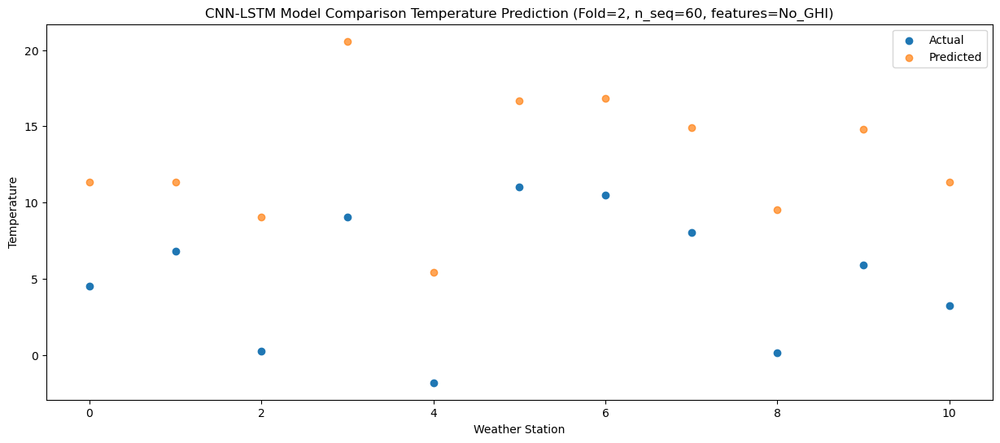

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29  16.349091
1                 1   12.23  16.389095
2                 2    1.63  14.059229
3                 3   11.48  25.599215
4                 4    1.85  10.459162
5                 5   14.77  21.719116
6                 6   13.96  21.829090
7                 7   12.45  19.919139
8                 8    2.28  14.549249
9                 9    9.96  19.819201
10               10    7.22  16.349166


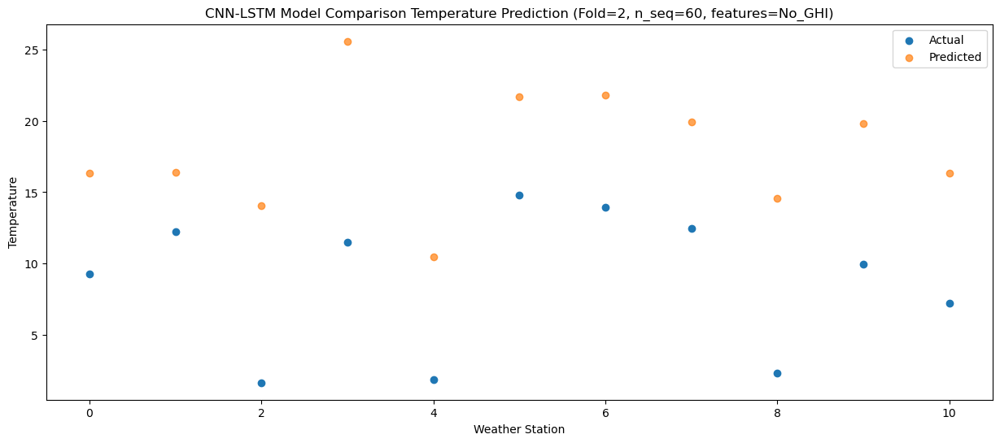

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  22.177083
1                 1   16.84  22.217087
2                 2    6.48  19.887185
3                 3   17.27  31.427180
4                 4    6.90  16.287136
5                 5   18.47  27.547096
6                 6   18.85  27.657082
7                 7   18.27  25.747117
8                 8    4.08  20.377207
9                 9   14.34  25.647171
10               10   11.68  22.177135


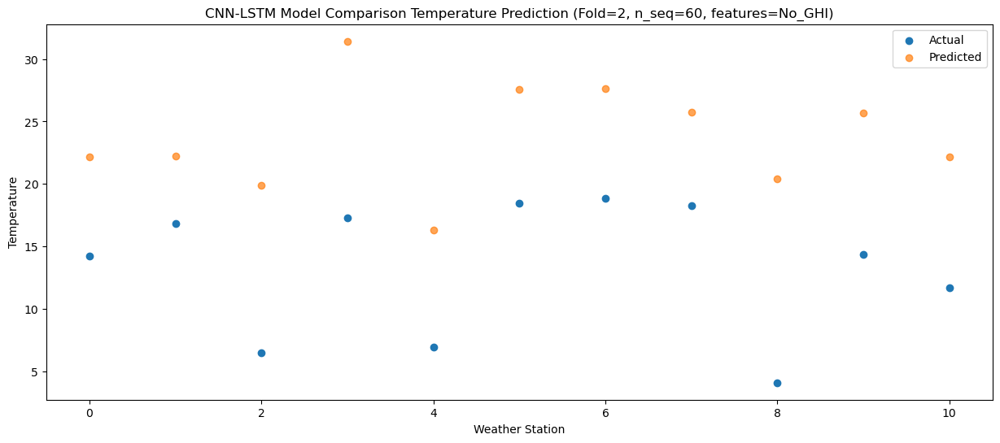

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  27.069630
1                 1   23.01  27.109628
2                 2    7.39  24.779734
3                 3   23.24  36.319733
4                 4    8.73  21.179687
5                 5   21.70  32.439641
6                 6   22.35  32.549627
7                 7   24.69  30.639662
8                 8    8.76  25.269750
9                 9   18.22  30.539724
10               10   16.03  27.069686


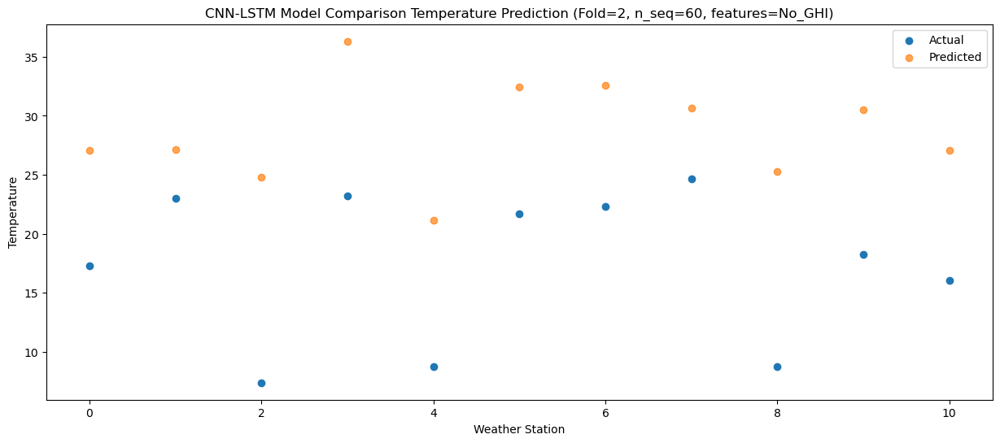

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  27.778336
1                 1   23.56  27.818340
2                 2    8.23  25.488420
3                 3   26.02  37.028419
4                 4    9.34  21.888379
5                 5   20.18  33.148349
6                 6   22.66  33.258341
7                 7   24.16  31.348377
8                 8   12.49  25.978446
9                 9   19.61  31.248406
10               10   17.26  27.778372


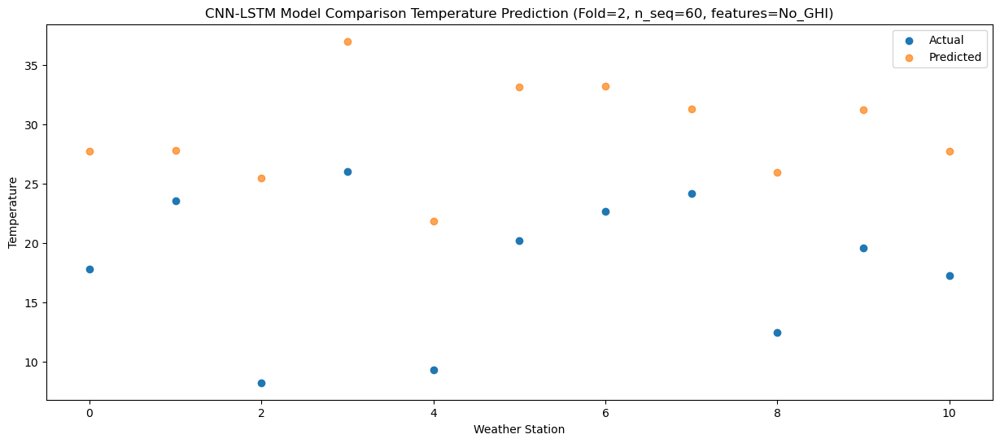

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  27.318759
1                 1   23.61  27.358764
2                 2    8.19  25.028826
3                 3   24.31  36.568824
4                 4    9.69  21.428792
5                 5   21.83  32.688769
6                 6   24.46  32.798767
7                 7   24.55  30.888797
8                 8   12.07  25.518853
9                 9   17.59  30.788811
10               10   15.64  27.318783


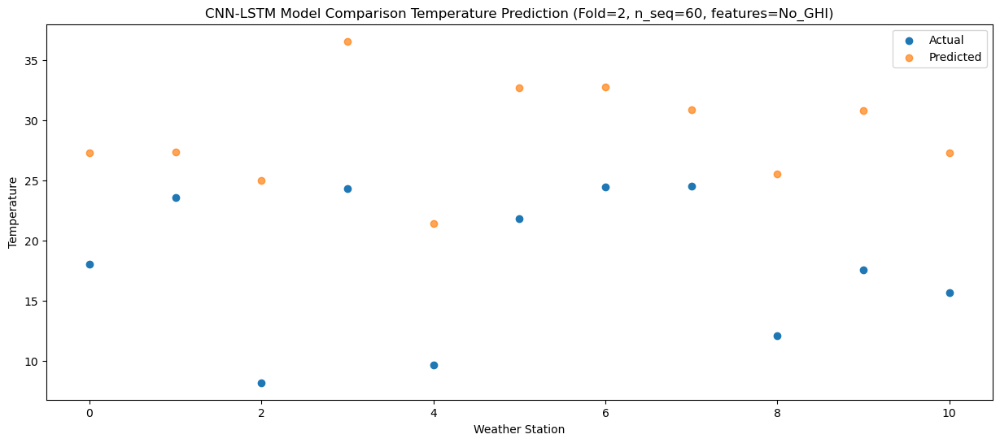

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  24.146687
1                 1   19.88  24.186710
2                 2    7.87  21.856753
3                 3   20.79  33.396740
4                 4    6.89  18.256720
5                 5   19.10  29.516704
6                 6   20.23  29.626706
7                 7   20.52  27.716745
8                 8   10.22  22.346801
9                 9   14.63  27.616724
10               10   13.05  24.146697


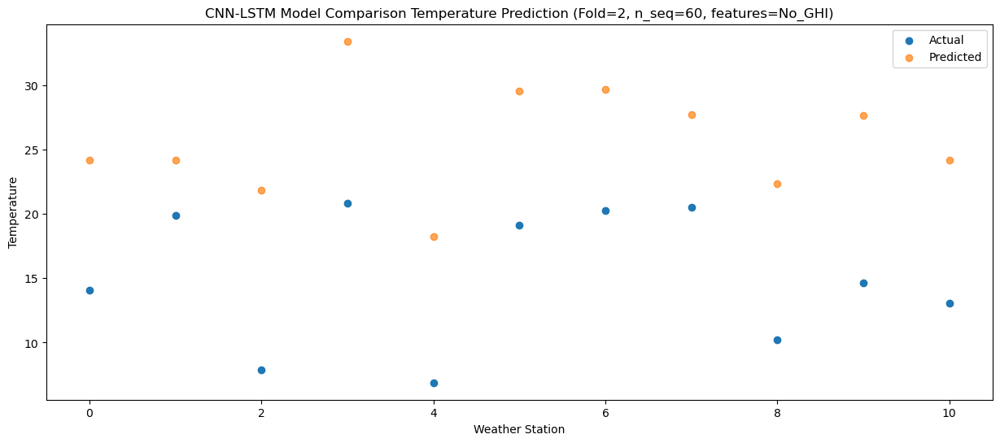

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77  18.875492
1                 1   14.91  18.915527
2                 2    4.40  16.585547
3                 3   15.53  28.125531
4                 4    2.20  12.985521
5                 5   16.45  24.245515
6                 6   17.26  24.355523
7                 7   16.26  22.445563
8                 8    7.23  17.075610
9                 9    9.41  22.345515
10               10    6.63  18.875489


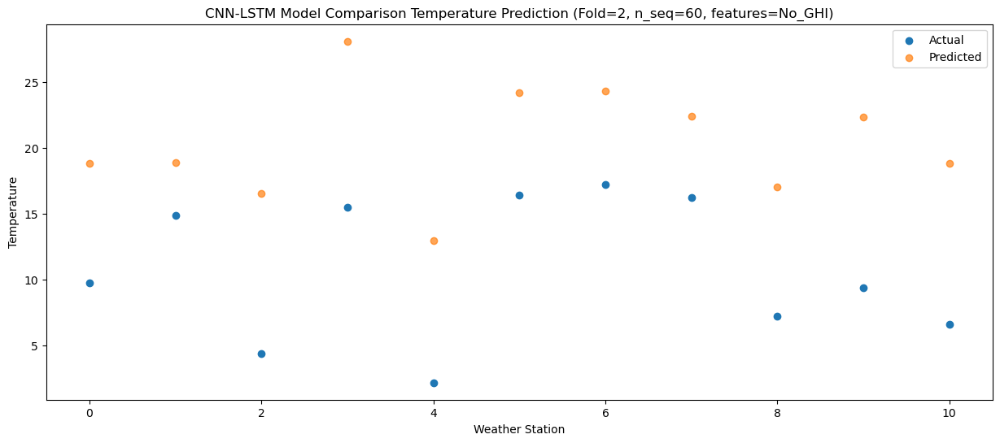

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

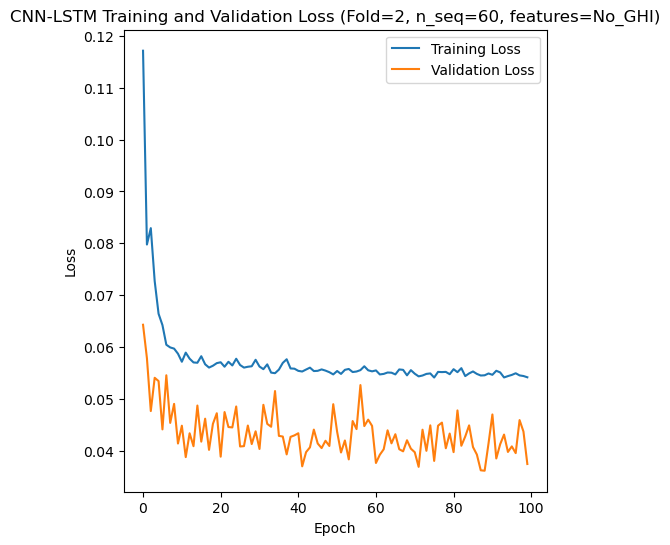

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 38s 224ms/step - loss: 0.1128 - accuracy: 0.3690 - mae: 0.0927 - rmse: 0.1128 - mape: 20.9249 - pearson: 0.6713 - val_loss: 0.0802 - val_accuracy: 0.5000 - val_mae: 0.0627 - val_rmse: 0.0802 - val_mape: 13.6757 - val_pearson: 0.7515
Epoch 2/100
84/84 [==============================] - 12s 142ms/step - loss: 0.0850 - accuracy: 0.4762 - mae: 0.0697 - rmse: 0.0850 - mape: 15.7535 - pearson: 0.8059 - val_loss: 0.0755 - val_accuracy: 0.5000 - val_mae: 0.0600 - val_rmse: 0.0755 - val_mape: 13.4308 - val_pearson: 0.7645
Epoch 3/100
84/84 [==============================] - 12s 140ms/step - loss: 0.0761 - accuracy: 0.5000 - mae: 0.0613 - rmse: 0.0761 - mape: 13.9452 - pearson: 0.8288

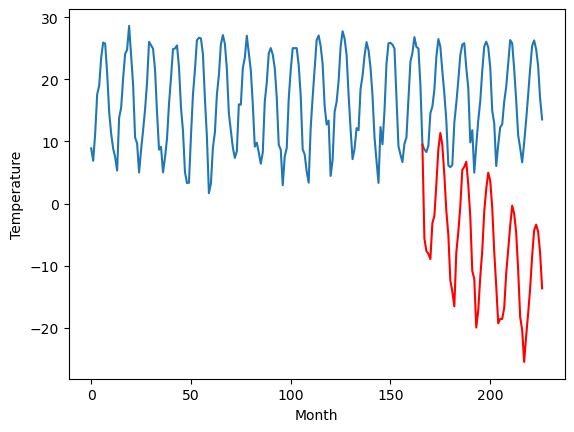

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		0.07		-2.15
0.87		-1.97		-2.84
0.03		-2.41		-2.44
0.18		-3.25		-3.43
7.67		2.53		-5.14
8.59		3.71		-4.88
12.99		8.83		-4.16
20.09		14.46		-5.63
21.95		17.06		-4.89
20.09		15.08		-5.01
16.42		10.31		-6.11
9.31		4.48		-4.83
6.49		0.67		-5.82
-0.06		-6.69		-6.63
-1.21		-8.47		-7.26
-4.93		-10.86		-5.93
7.04		-2.17		-9.21
8.90		1.12		-7.78
13.12		5.25		-7.87
19.83		11.13		-8.70
21.14		11.61		-9.53
21.71		12.43		-9.28
18.98		8.70		-10.28
12.38		3.59		-8.79
4.67		-5.16		-9.83
5.98		-6.43		-12.41
-2.85		-14.28		-11.43
-1.63		-11.49		-9.86
5.15		-6.12		-11.27
10.00		-1.94		-11.94
15.43		4.44		-10.99
20.58		8.09		-12.49
24.62		10.65		-13.97
21.54		9.38		-12.16
17.68		5.04		-12.64
11.13		-2.06		-13.19
3.90		-7.56		-11.46
-0.15		-13.60		-13.45
0.55		-12.89		-13.44
2.51		-12.89		-15.40
5.11		-11.12		-16.23
10.16		-5.56		-15.72
15.47		-1.78		-17.25
19.80		2.10		-17.70
22.06		5.36		-16.70
22.24		4.04

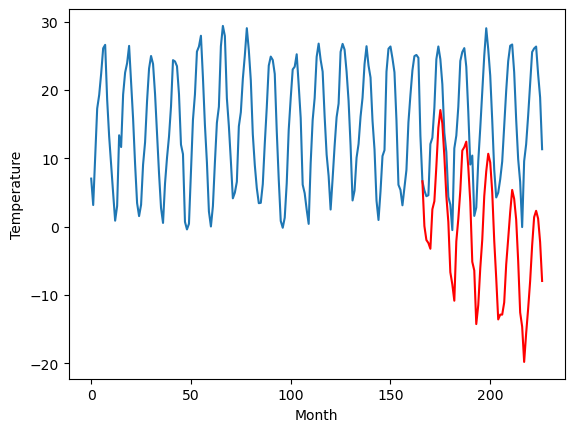

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-1.81		-4.52
0.18		-3.85		-4.03
-1.04		-4.29		-3.25
1.38		-5.13		-6.51
3.17		0.65		-2.52
7.83		1.83		-6.00
13.02		6.95		-6.07
16.37		12.58		-3.79
19.15		15.18		-3.97
19.68		13.20		-6.48
15.35		8.43		-6.92
9.86		2.60		-7.26
1.21		-1.21		-2.42
-1.99		-8.57		-6.58
-0.73		-10.35		-9.62
1.57		-12.74		-14.31
2.72		-4.05		-6.77
8.45		-0.76		-9.21
13.25		3.37		-9.88
18.10		9.25		-8.85
21.23		9.73		-11.50
19.03		10.55		-8.48
15.72		6.82		-8.90
7.06		1.71		-5.35
2.72		-7.04		-9.76
-1.20		-8.31		-7.11
-1.53		-16.16		-14.63
0.17		-13.37		-13.54
4.88		-8.00		-12.88
7.95		-3.82		-11.77
12.19		2.56		-9.63
17.58		6.21		-11.37
20.15		8.77		-11.38
20.33		7.50		-12.83
17.51		3.16		-14.35
10.33		-3.94		-14.27
-0.40		-9.44		-9.04
-1.36		-15.48		-14.12
0.03		-14.77		-14.80
-0.82		-14.77		-13.95
2.05		-13.00		-15.05
7.68		-7.44		-15.12
12.12		-3.66		-15.78
14.92		0.22		-14.70
20.58		3.48		-17.10
18.89		2.16		

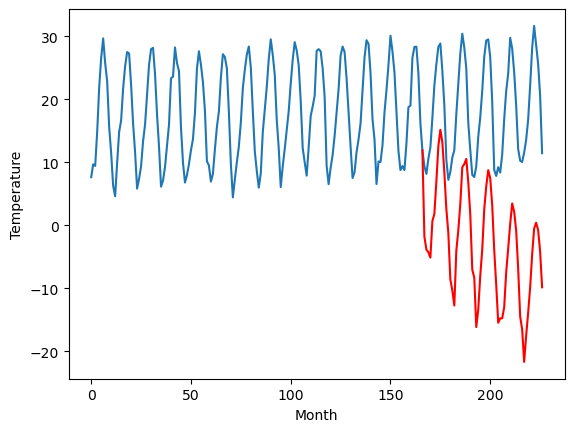

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-1.18		1.68
-2.85		-3.22		-0.37
-3.40		-3.66		-0.26
-3.75		-4.50		-0.75
3.16		1.28		-1.88
3.80		2.46		-1.34
8.37		7.58		-0.79
14.19		13.21		-0.98
17.99		15.81		-2.18
15.57		13.83		-1.74
11.51		9.06		-2.45
6.09		3.23		-2.86
2.17		-0.58		-2.75
-5.03		-7.94		-2.91
-6.49		-9.72		-3.23
-7.81		-12.11		-4.30
2.40		-3.42		-5.82
4.75		-0.13		-4.88
8.82		4.00		-4.82
14.74		9.88		-4.86
15.73		10.36		-5.37
16.25		11.18		-5.07
12.12		7.45		-4.67
8.54		2.34		-6.20
-1.12		-6.41		-5.29
0.37		-7.68		-8.05
-8.58		-15.53		-6.95
-4.06		-12.74		-8.68
1.69		-7.37		-9.06
4.70		-3.19		-7.89
11.48		3.19		-8.29
14.96		6.84		-8.12
16.51		9.40		-7.11
15.44		8.13		-7.31
11.46		3.79		-7.67
4.19		-3.31		-7.50
1.07		-8.81		-9.88
-4.20		-14.85		-10.65
-2.45		-14.14		-11.69
-0.11		-14.14		-14.03
0.13		-12.37		-12.50
6.37		-6.81		-13.18
9.06		-3.03		-12.09
12.80		0.85		-11.95
16.42		4.11		-12.31
15.31		2.79		-12.52
12.5

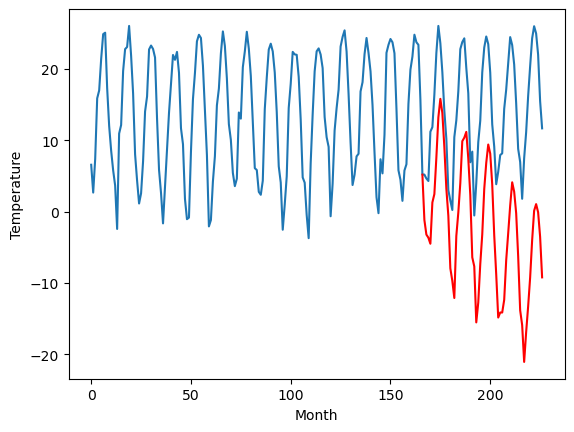

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-2.26		-5.57
0.05		-4.30		-4.35
-2.82		-4.74		-1.92
-1.67		-5.58		-3.91
5.74		0.20		-5.54
8.77		1.38		-7.39
14.84		6.50		-8.34
21.89		12.13		-9.76
23.35		14.73		-8.62
20.79		12.75		-8.04
16.72		7.98		-8.74
8.99		2.15		-6.84
6.17		-1.66		-7.83
-1.00		-9.02		-8.02
-2.47		-10.80		-8.33
-6.34		-13.19		-6.85
6.74		-4.50		-11.24
10.03		-1.21		-11.24
14.60		2.92		-11.68
22.08		8.80		-13.28
22.08		9.28		-12.80
22.20		10.10		-12.10
18.84		6.37		-12.47
13.42		1.26		-12.16
3.68		-7.49		-11.17
3.32		-8.76		-12.08
-6.15		-16.61		-10.46
-3.63		-13.82		-10.19
4.83		-8.45		-13.28
8.96		-4.27		-13.23
16.53		2.11		-14.42
21.98		5.76		-16.22
23.10		8.32		-14.78
21.28		7.05		-14.23
16.96		2.71		-14.25
9.69		-4.39		-14.08
3.80		-9.89		-13.69
-2.17		-15.93		-13.76
-0.45		-15.22		-14.77
6.07		-15.22		-21.29
3.11		-13.45		-16.56
10.32		-7.89		-18.21
16.32		-4.11		-20.43
20.42		-0.23		-20.65
22.12		3.03		-19.09

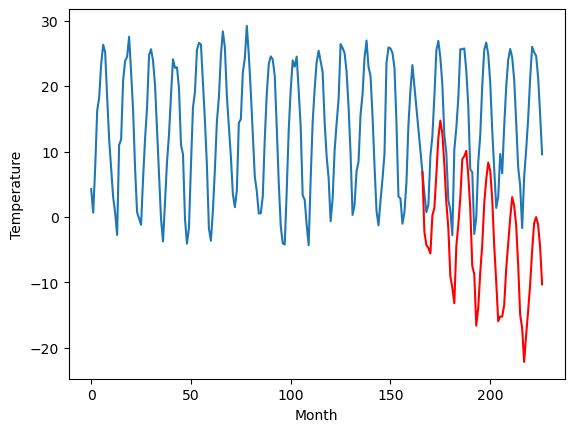

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-4.58		1.24
-5.61		-6.62		-1.01
-7.03		-7.06		-0.03
-7.44		-7.90		-0.46
-0.58		-2.12		-1.54
1.69		-0.94		-2.63
7.10		4.18		-2.92
14.09		9.81		-4.28
15.98		12.41		-3.57
13.47		10.43		-3.04
9.84		5.66		-4.18
3.84		-0.17		-4.01
-0.10		-3.98		-3.88
-7.71		-11.34		-3.63
-9.16		-13.12		-3.96
-11.88		-15.51		-3.63
-0.55		-6.82		-6.27
2.90		-3.53		-6.43
7.18		0.60		-6.58
13.89		6.48		-7.41
14.27		6.96		-7.31
14.59		7.78		-6.81
11.33		4.05		-7.28
6.75		-1.06		-7.81
-4.10		-9.81		-5.71
-3.05		-11.08		-8.03
-11.87		-18.93		-7.06
-8.68		-16.14		-7.46
-1.72		-10.77		-9.05
2.13		-6.59		-8.72
9.93		-0.21		-10.14
13.87		3.44		-10.43
15.86		6.00		-9.86
14.21		4.73		-9.48
10.26		0.39		-9.87
4.22		-6.71		-10.93
-2.33		-12.21		-9.88
-7.87		-18.25		-10.38
-5.73		-17.54		-11.81
-4.01		-17.54		-13.53
-3.11		-15.77		-12.66
3.12		-10.21		-13.33
8.53		-6.43		-14.96
11.99		-2.55		-14.54
15.25		0.71		-14.54
13.70

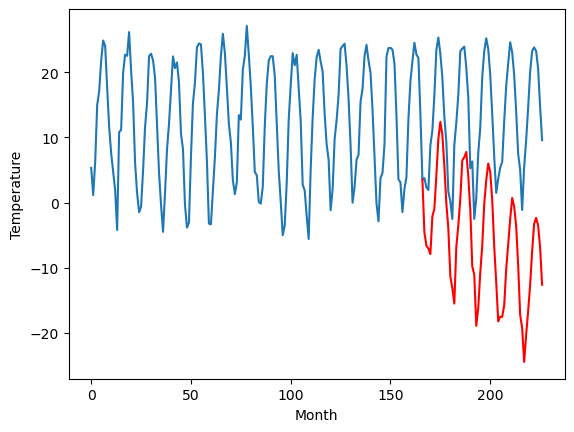

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-3.50		2.96
-12.13		-5.54		6.59
-12.22		-5.98		6.24
-12.03		-6.82		5.21
-7.10		-1.04		6.06
-4.12		0.14		4.26
2.99		5.26		2.27
7.20		10.89		3.69
9.19		13.49		4.30
9.94		11.51		1.57
4.44		6.74		2.30
0.70		0.91		0.21
-6.49		-2.90		3.59
-12.19		-10.26		1.93
-11.92		-12.04		-0.12
-11.82		-14.43		-2.61
-8.85		-5.74		3.11
-4.07		-2.45		1.62
0.98		1.68		0.70
8.37		7.56		-0.81
10.21		8.04		-2.17
8.29		8.86		0.57
6.42		5.13		-1.29
-1.55		0.02		1.57
-4.29		-8.73		-4.44
-9.05		-10.00		-0.95
-11.34		-17.85		-6.51
-13.06		-15.06		-2.00
-8.52		-9.69		-1.17
-4.20		-5.51		-1.31
1.71		0.87		-0.84
7.48		4.52		-2.96
9.40		7.08		-2.32
8.64		5.81		-2.83
6.48		1.47		-5.01
-1.78		-5.63		-3.85
-9.46		-11.13		-1.67
-11.63		-17.17		-5.54
-12.36		-16.46		-4.10
-12.33		-16.46		-4.13
-10.54		-14.69		-4.15
-5.20		-9.13		-3.93
2.01		-5.35		-7.36
6.59		-1.47		-8.06
12.73		1.79		-10.94
10.14		0.47		-9.67
5.99		-2.54		-

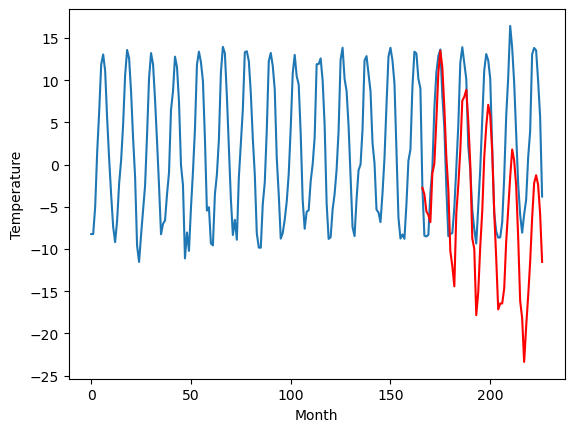

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-17.07		-3.91
-17.89		-19.11		-1.22
-16.73		-19.55		-2.82
-15.22		-20.39		-5.17
-12.11		-14.61		-2.50
-6.20		-13.43		-7.23
1.07		-8.31		-9.38
4.53		-2.68		-7.21
8.76		-0.08		-8.84
8.87		-2.06		-10.93
4.06		-6.83		-10.89
-2.88		-12.66		-9.78
-11.69		-16.47		-4.78
-17.38		-23.83		-6.45
-16.83		-25.61		-8.78
-13.98		-28.00		-14.02
-12.38		-19.31		-6.93
-4.41		-16.02		-11.61
0.02		-11.89		-11.91
7.66		-6.01		-13.67
8.74		-5.53		-14.27
7.51		-4.71		-12.22
3.54		-8.44		-11.98
-6.81		-13.55		-6.74
-9.33		-22.30		-12.97
-16.60		-23.57		-6.97
-16.67		-31.42		-14.75
-14.63		-28.63		-14.00
-9.92		-23.26		-13.34
-5.29		-19.08		-13.79
-0.62		-12.70		-12.08
5.86		-9.05		-14.91
8.09		-6.49		-14.58
6.50		-7.76		-14.26
4.14		-12.10		-16.24
-3.75		-19.20		-15.45
-15.17		-24.70		-9.53
-17.50		-30.74		-13.24
-18.01		-30.03		-12.02
-17.10		-30.03		-12.93
-14.27		-28.26		-13.99
-6.32		-22.70		-16.38
-0.52	

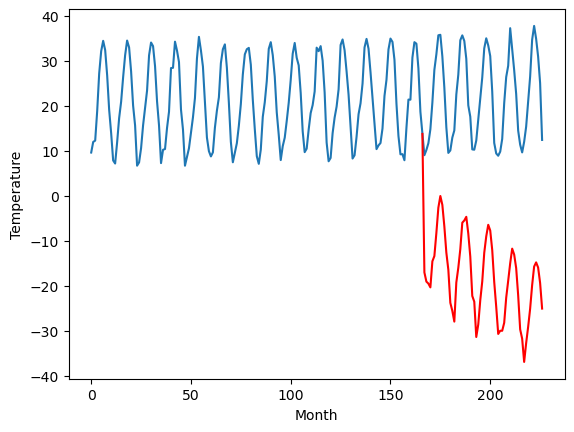

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		0.74		-4.54
4.03		-1.30		-5.33
3.40		-1.74		-5.14
5.42		-2.58		-8.00
4.86		3.20		-1.66
8.48		4.38		-4.10
10.88		9.50		-1.38
13.42		15.13		1.71
12.61		17.73		5.12
14.49		15.75		1.26
13.91		10.98		-2.93
11.69		5.15		-6.54
4.53		1.34		-3.19
2.48		-6.02		-8.50
3.70		-7.80		-11.50
4.63		-10.19		-14.82
4.41		-1.50		-5.91
6.60		1.79		-4.81
10.89		5.92		-4.97
12.59		11.80		-0.79
11.77		12.28		0.51
12.32		13.10		0.78
11.77		9.37		-2.40
9.01		4.26		-4.75
6.19		-4.49		-10.68
2.49		-5.76		-8.25
3.11		-13.61		-16.72
4.07		-10.82		-14.89
6.30		-5.45		-11.75
7.74		-1.27		-9.01
10.73		5.11		-5.62
13.88		8.76		-5.12
12.23		11.32		-0.91
13.65		10.05		-3.60
13.88		5.71		-8.17
9.15		-1.39		-10.54
3.42		-6.89		-10.31
2.22		-12.93		-15.15
3.89		-12.22		-16.11
2.09		-12.22		-14.31
3.55		-10.45		-14.00
7.63		-4.89		-12.52
8.66		-1.11		-9.77
10.56		2.77		-7.79
13.57		6.03		-7.54
14.60		4.71		-9.89
11.99		1.70		

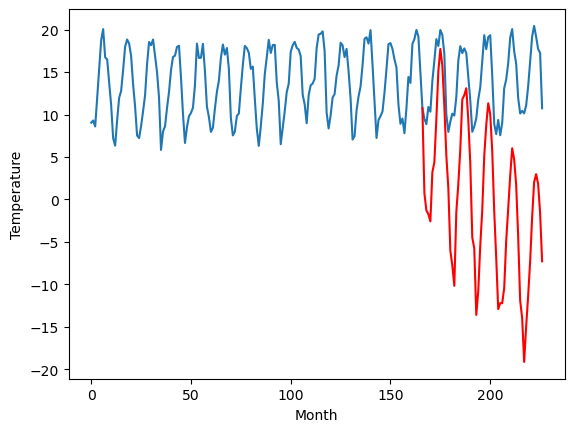

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		0.21		-0.42
-2.13		-1.83		0.30
-2.10		-2.27		-0.17
-1.66		-3.11		-1.45
1.92		2.67		0.75
3.36		3.85		0.49
8.92		8.97		0.05
15.90		14.60		-1.30
19.85		17.20		-2.65
18.67		15.22		-3.45
14.33		10.45		-3.88
9.01		4.62		-4.39
4.94		0.81		-4.13
-1.40		-6.55		-5.15
-4.42		-8.33		-3.91
-4.54		-10.72		-6.18
0.46		-2.03		-2.49
5.08		1.26		-3.82
9.91		5.39		-4.52
15.78		11.27		-4.51
17.92		11.75		-6.17
18.54		12.57		-5.97
15.22		8.84		-6.38
10.78		3.73		-7.05
1.86		-5.02		-6.88
0.26		-6.29		-6.55
-6.29		-14.14		-7.85
-3.53		-11.35		-7.82
0.43		-5.98		-6.41
4.72		-1.80		-6.52
10.51		4.58		-5.93
14.83		8.23		-6.60
19.38		10.79		-8.59
19.30		9.52		-9.78
14.39		5.18		-9.21
8.13		-1.92		-10.05
4.17		-7.42		-11.59
-2.19		-13.46		-11.27
-0.21		-12.75		-12.54
-1.94		-12.75		-10.81
0.03		-10.98		-11.01
6.08		-5.42		-11.50
9.72		-1.64		-11.36
13.71		2.24		-11.47
19.39		5.50		-13.89
17.14		4.18		-12.96
14.57

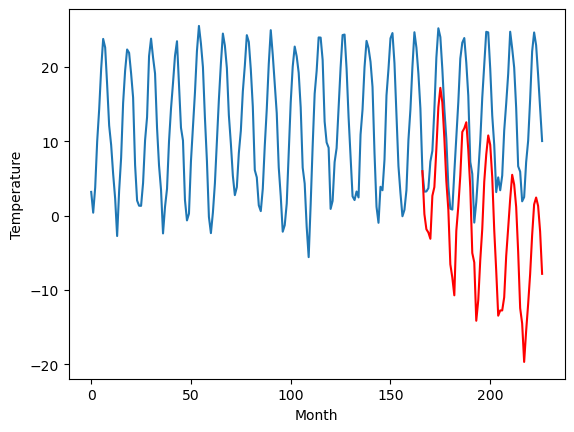

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-5.63		0.83
-9.42		-7.67		1.75
-9.01		-8.11		0.90
-8.09		-8.95		-0.86
-3.68		-3.17		0.51
-1.74		-1.99		-0.25
4.03		3.13		-0.90
10.75		8.76		-1.99
14.52		11.36		-3.16
12.65		9.38		-3.27
7.68		4.61		-3.07
2.19		-1.22		-3.41
-2.09		-5.03		-2.94
-8.91		-12.39		-3.48
-10.47		-14.17		-3.70
-11.27		-16.56		-5.29
-4.08		-7.87		-3.79
0.79		-4.58		-5.37
5.05		-0.45		-5.50
11.22		5.43		-5.79
12.86		5.91		-6.95
12.59		6.73		-5.86
8.33		3.00		-5.33
4.21		-2.11		-6.32
-6.01		-10.86		-4.85
-6.42		-12.13		-5.71
-13.40		-19.98		-6.58
-9.59		-17.19		-7.60
-4.41		-11.82		-7.41
-0.59		-7.64		-7.05
6.19		-1.26		-7.45
10.18		2.39		-7.79
13.96		4.95		-9.01
13.09		3.68		-9.41
7.86		-0.66		-8.52
0.25		-7.76		-8.01
-2.87		-13.26		-10.39
-9.90		-19.30		-9.40
-7.25		-18.59		-11.34
-7.04		-18.59		-11.55
-5.48		-16.82		-11.34
2.09		-11.26		-13.35
4.56		-7.48		-12.04
8.49		-3.60		-12.09
13.33		-0.34		-13.67
11.36		

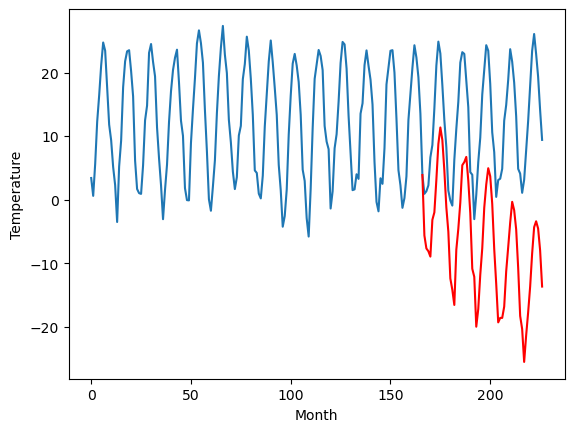

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.629121
1                 1    2.22   0.070879
2                 2    2.71  -1.809120
3                 3   -2.86  -1.179121
4                 4    3.31  -2.259120
5                 5   -5.82  -4.579120
6                 6   -6.46  -3.499120
7                 7  -13.16 -17.069121
8                 8    5.28   0.740879
9                 9    0.63   0.210879
10               10   -6.46  -5.629121


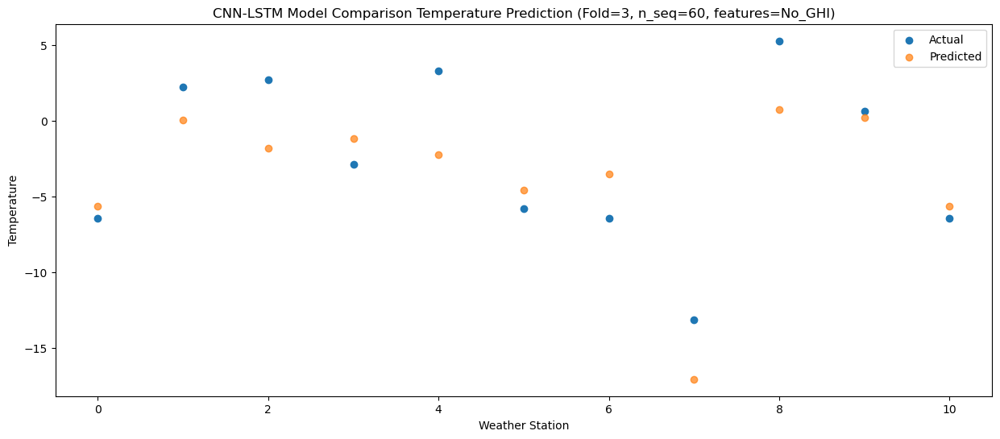

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -7.668427
1                 1    0.87  -1.968428
2                 2    0.18  -3.848426
3                 3   -2.85  -3.218429
4                 4    0.05  -4.298427
5                 5   -5.61  -6.618427
6                 6  -12.13  -5.538426
7                 7  -17.89 -19.108427
8                 8    4.03  -1.298427
9                 9   -2.13  -1.828428
10               10   -9.42  -7.668428


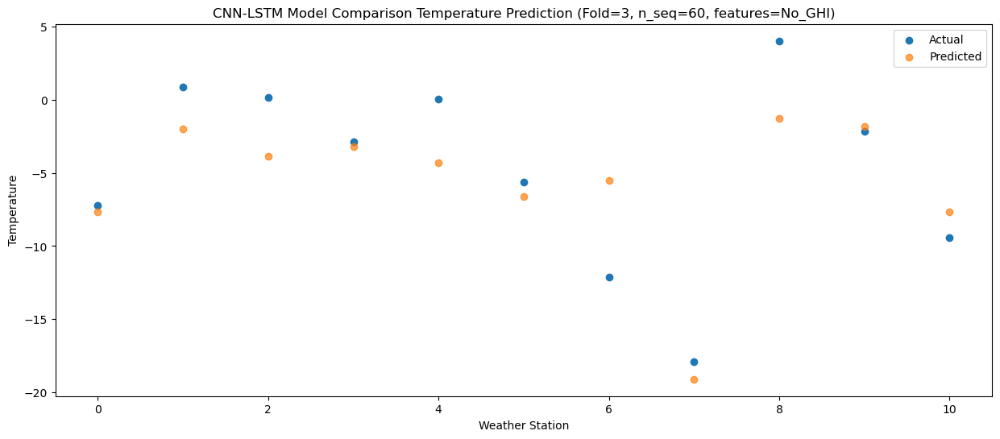

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -8.106929
1                 1    0.03  -2.406931
2                 2   -1.04  -4.286928
3                 3   -3.40  -3.656930
4                 4   -2.82  -4.736929
5                 5   -7.03  -7.056929
6                 6  -12.22  -5.976930
7                 7  -16.73 -19.546932
8                 8    3.40  -1.736931
9                 9   -2.10  -2.266930
10               10   -9.01  -8.106930


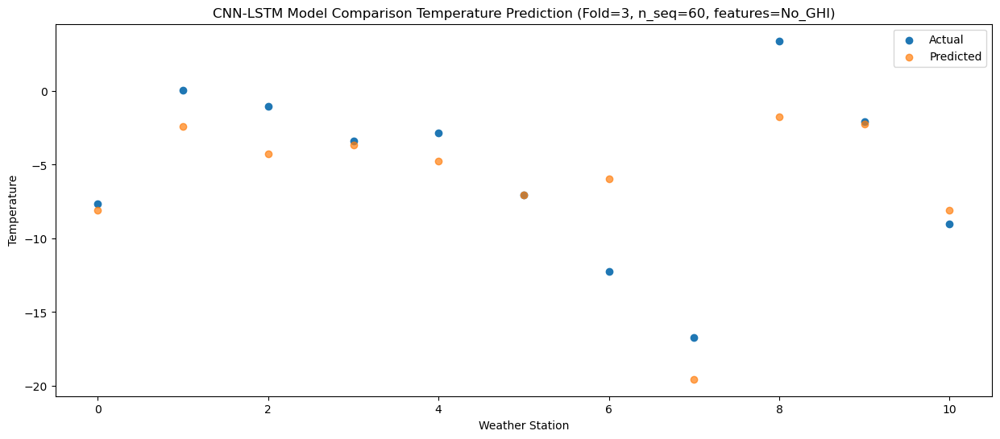

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -8.952926
1                 1    0.18  -3.252930
2                 2    1.38  -5.132926
3                 3   -3.75  -4.502928
4                 4   -1.67  -5.582927
5                 5   -7.44  -7.902927
6                 6  -12.03  -6.822926
7                 7  -15.22 -20.392929
8                 8    5.42  -2.582928
9                 9   -1.66  -3.112928
10               10   -8.09  -8.952929


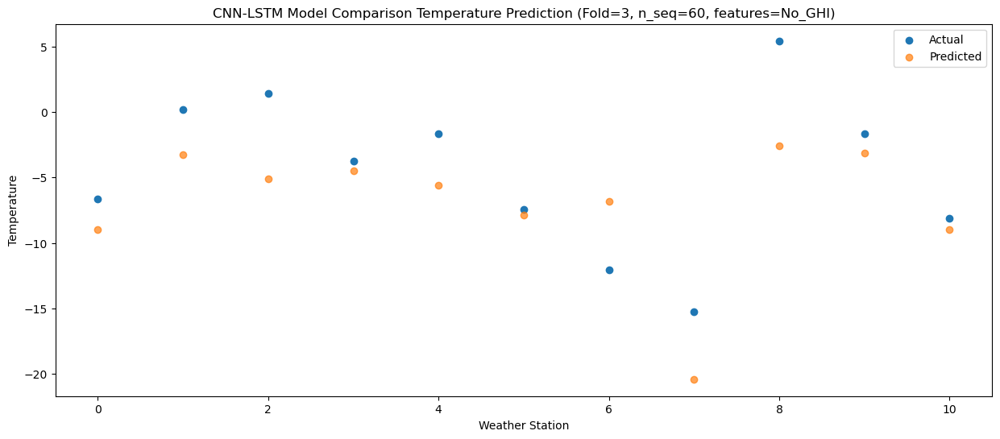

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -3.167679
1                 1    7.67   2.532318
2                 2    3.17   0.652319
3                 3    3.16   1.282320
4                 4    5.74   0.202321
5                 5   -0.58  -2.117679
6                 6   -7.10  -1.037680
7                 7  -12.11 -14.607683
8                 8    4.86   3.202316
9                 9    1.92   2.672320
10               10   -3.68  -3.167681


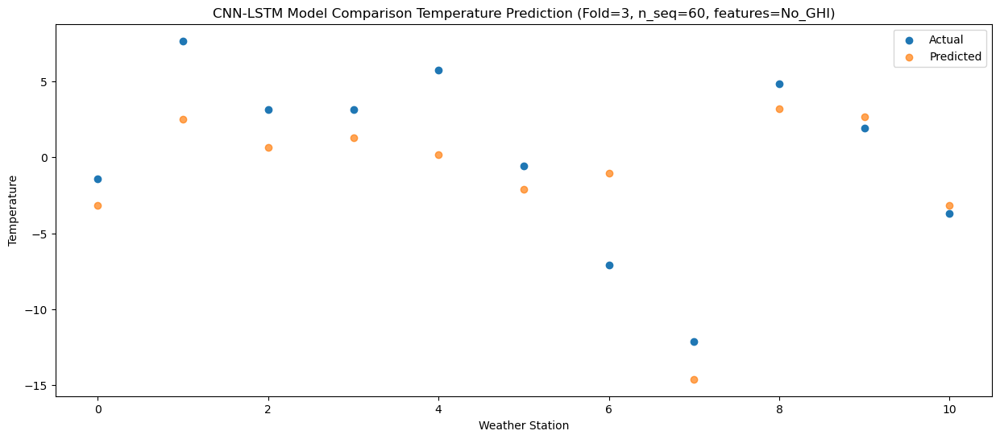

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32  -1.993239
1                 1    8.59   3.706762
2                 2    7.83   1.826759
3                 3    3.80   2.456764
4                 4    8.77   1.376765
5                 5    1.69  -0.943235
6                 6   -4.12   0.136764
7                 7   -6.20 -13.433241
8                 8    8.48   4.376756
9                 9    3.36   3.846764
10               10   -1.74  -1.993237


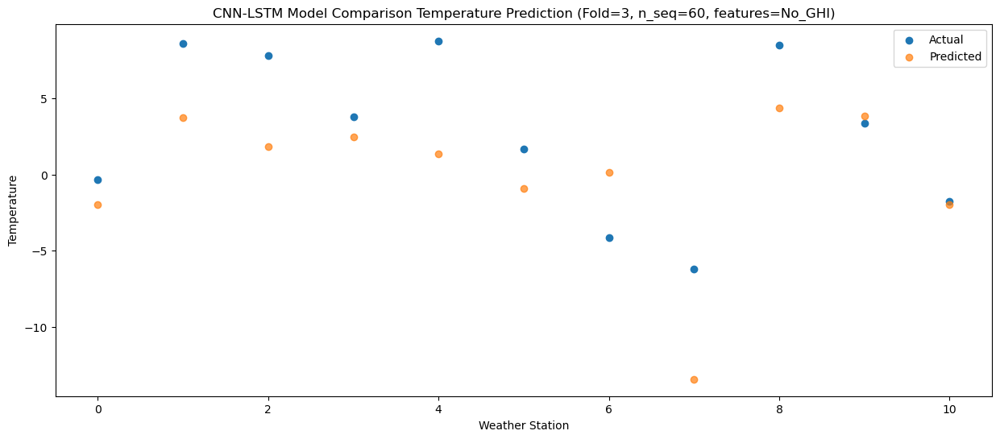

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   3.128475
1                 1   12.99   8.828474
2                 2   13.02   6.948472
3                 3    8.37   7.578476
4                 4   14.84   6.498473
5                 5    7.10   4.178473
6                 6    2.99   5.258476
7                 7    1.07  -8.311528
8                 8   10.88   9.498469
9                 9    8.92   8.968476
10               10    4.03   3.128475


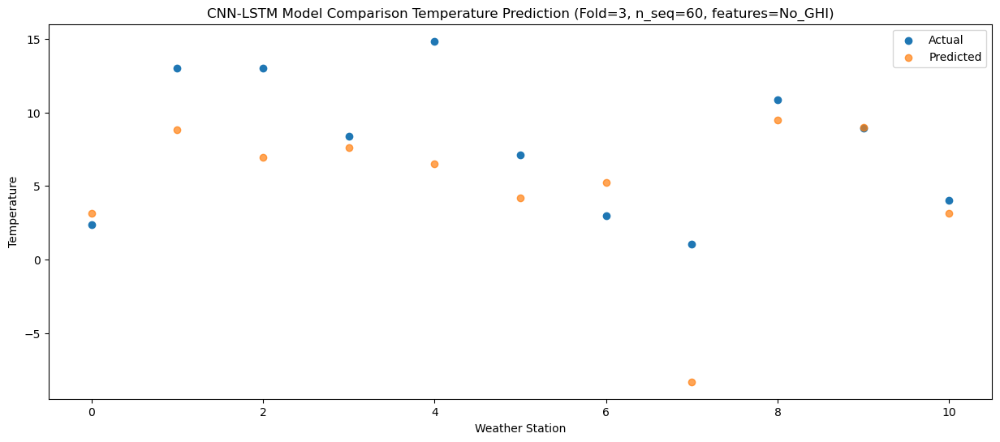

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69   8.760172
1                 1   20.09  14.460171
2                 2   16.37  12.580164
3                 3   14.19  13.210173
4                 4   21.89  12.130170
5                 5   14.09   9.810170
6                 6    7.20  10.890173
7                 7    4.53  -2.679832
8                 8   13.42  15.130162
9                 9   15.90  14.600173
10               10   10.75   8.760172


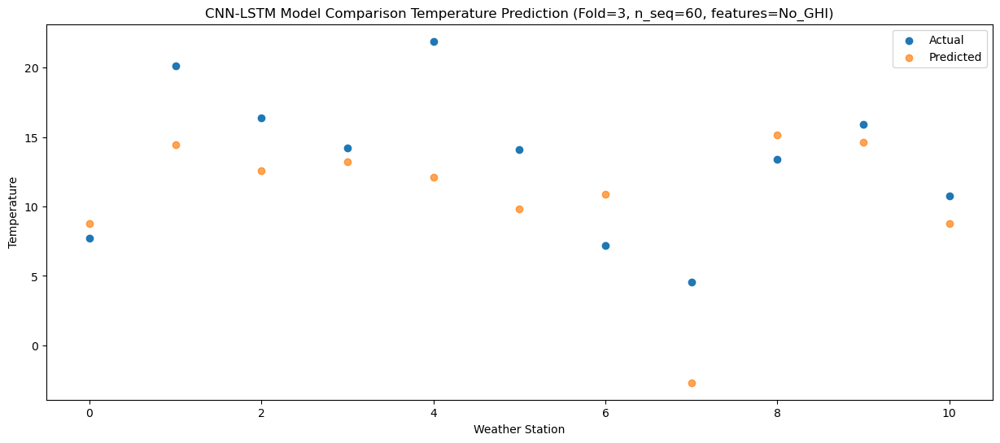

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.356648
1                 1   21.95  17.056649
2                 2   19.15  15.176643
3                 3   17.99  15.806651
4                 4   23.35  14.726648
5                 5   15.98  12.406648
6                 6    9.19  13.486651
7                 7    8.76  -0.083354
8                 8   12.61  17.726640
9                 9   19.85  17.196651
10               10   14.52  11.356650


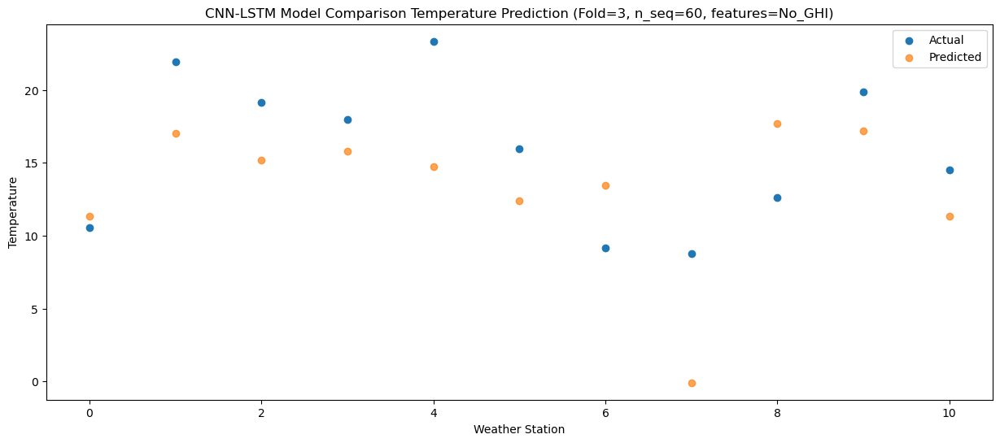

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32   9.376558
1                 1   20.09  15.076562
2                 2   19.68  13.196552
3                 3   15.57  13.826562
4                 4   20.79  12.746561
5                 5   13.47  10.426560
6                 6    9.94  11.506560
7                 7    8.87  -2.063444
8                 8   14.49  15.746549
9                 9   18.67  15.216562
10               10   12.65   9.376560


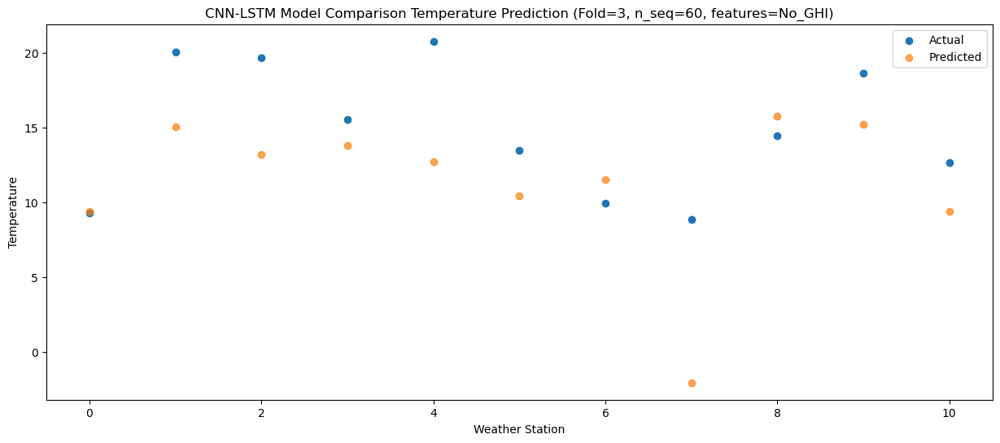

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   4.609211
1                 1   16.42  10.309214
2                 2   15.35   8.429205
3                 3   11.51   9.059215
4                 4   16.72   7.979217
5                 5    9.84   5.659214
6                 6    4.44   6.739214
7                 7    4.06  -6.830791
8                 8   13.91  10.979203
9                 9   14.33  10.449215
10               10    7.68   4.609213


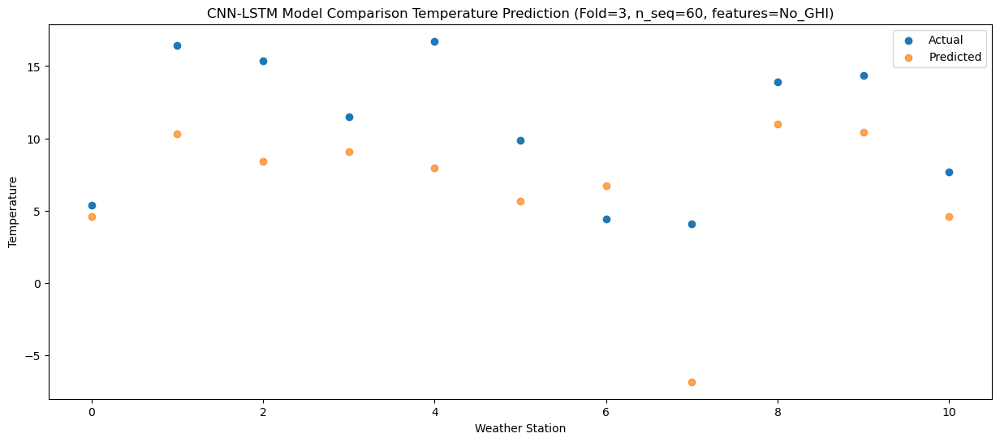

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78  -1.215029
1                 1    9.31   4.484973
2                 2    9.86   2.604963
3                 3    6.09   3.234974
4                 4    8.99   2.154977
5                 5    3.84  -0.165026
6                 6    0.70   0.914973
7                 7   -2.88 -12.655032
8                 8   11.69   5.154962
9                 9    9.01   4.624973
10               10    2.19  -1.215028


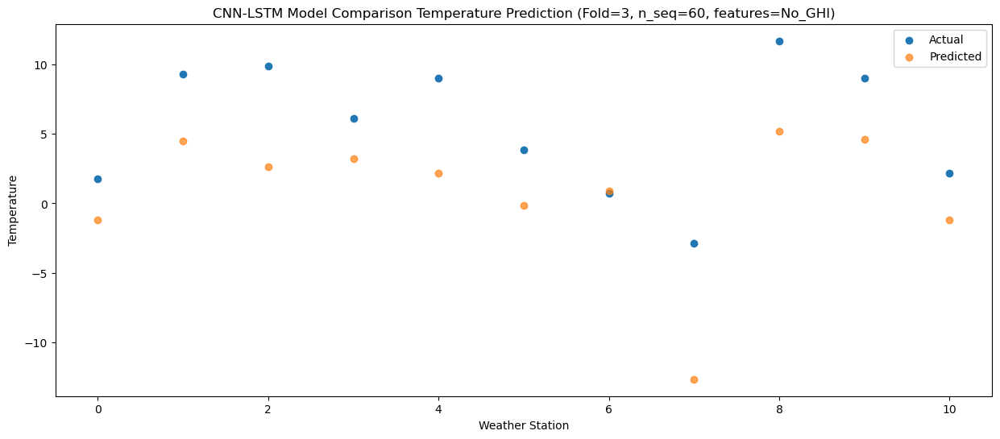

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -5.031152
1                 1    6.49   0.668850
2                 2    1.21  -1.211159
3                 3    2.17  -0.581147
4                 4    6.17  -1.661146
5                 5   -0.10  -3.981149
6                 6   -6.49  -2.901150
7                 7  -11.69 -16.471154
8                 8    4.53   1.338837
9                 9    4.94   0.808850
10               10   -2.09  -5.031151


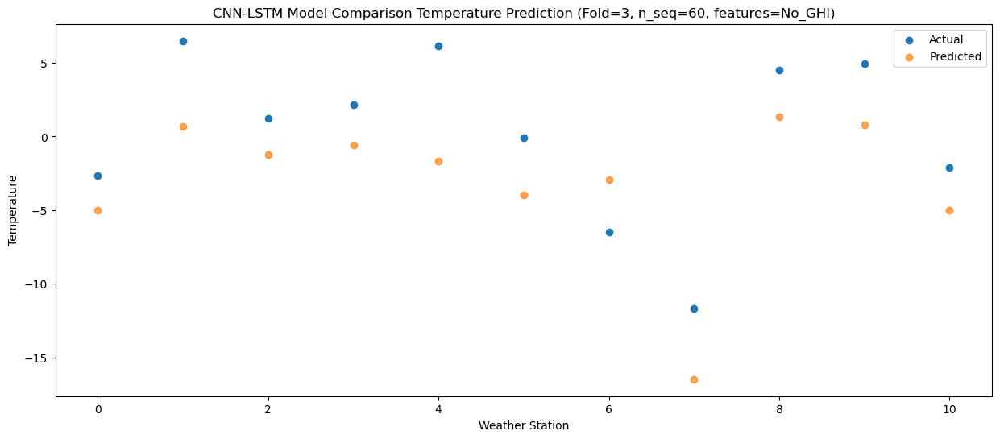

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82 -12.386634
1                 1   -0.06  -6.686632
2                 2   -1.99  -8.566642
3                 3   -5.03  -7.936629
4                 4   -1.00  -9.016628
5                 5   -7.71 -11.336631
6                 6  -12.19 -10.256631
7                 7  -17.38 -23.826637
8                 8    2.48  -6.016645
9                 9   -1.40  -6.546632
10               10   -8.91 -12.386633


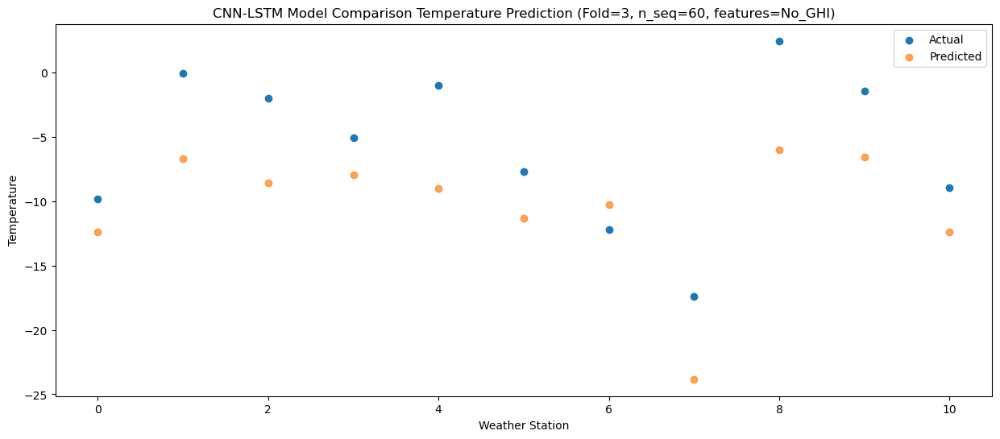

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10 -14.171134
1                 1   -1.21  -8.471131
2                 2   -0.73 -10.351142
3                 3   -6.49  -9.721128
4                 4   -2.47 -10.801127
5                 5   -9.16 -13.121129
6                 6  -11.92 -12.041131
7                 7  -16.83 -25.611136
8                 8    3.70  -7.801146
9                 9   -4.42  -8.331132
10               10  -10.47 -14.171133


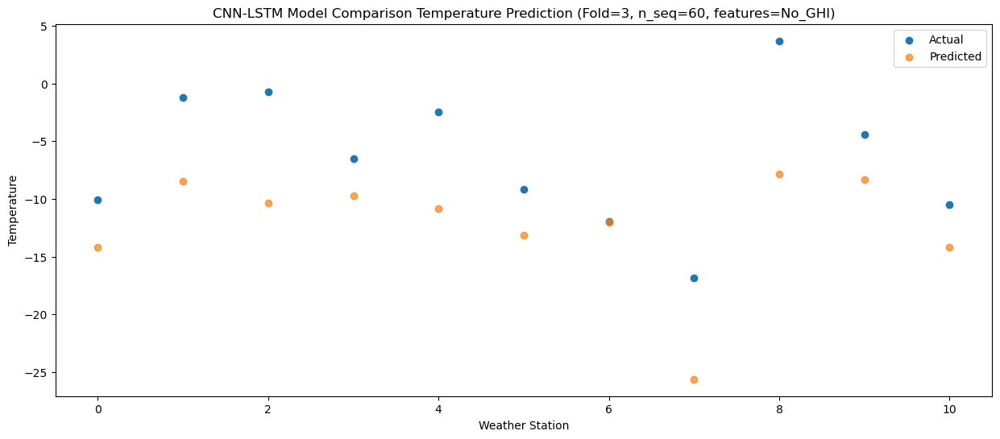

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -16.557859
1                 1   -4.93 -10.857855
2                 2    1.57 -12.737867
3                 3   -7.81 -12.107852
4                 4   -6.34 -13.187848
5                 5  -11.88 -15.507851
6                 6  -11.82 -14.427857
7                 7  -13.98 -27.997861
8                 8    4.63 -10.187871
9                 9   -4.54 -10.717858
10               10  -11.27 -16.557856


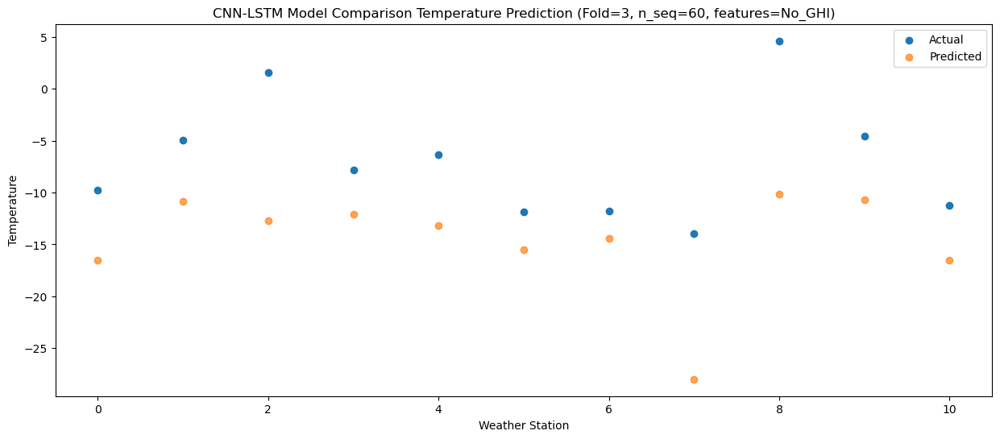

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -7.870224
1                 1    7.04  -2.170214
2                 2    2.72  -4.050230
3                 3    2.40  -3.420210
4                 4    6.74  -4.500207
5                 5   -0.55  -6.820209
6                 6   -8.85  -5.740221
7                 7  -12.38 -19.310226
8                 8    4.41  -1.500235
9                 9    0.46  -2.030222
10               10   -4.08  -7.870219


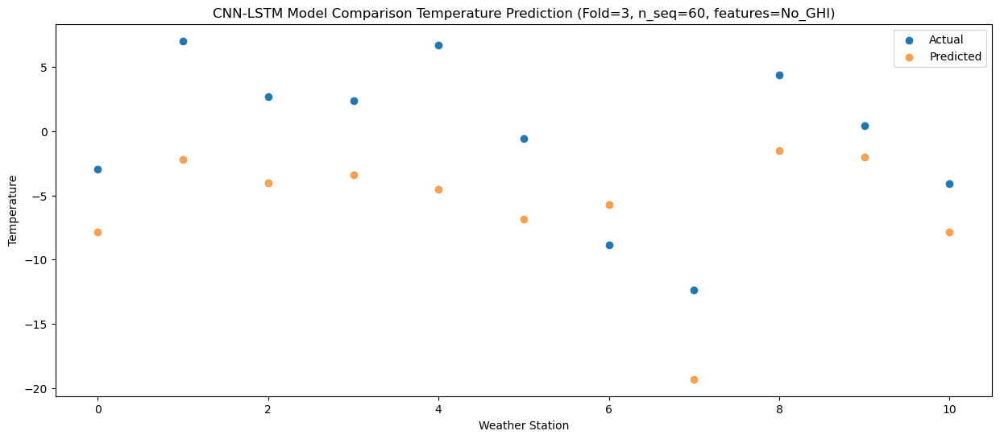

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23  -4.582505
1                 1    8.90   1.117503
2                 2    8.45  -0.762513
3                 3    4.75  -0.132493
4                 4   10.03  -1.212488
5                 5    2.90  -3.532488
6                 6   -4.07  -2.452503
7                 7   -4.41 -16.022507
8                 8    6.60   1.787483
9                 9    5.08   1.257496
10               10    0.79  -4.582501


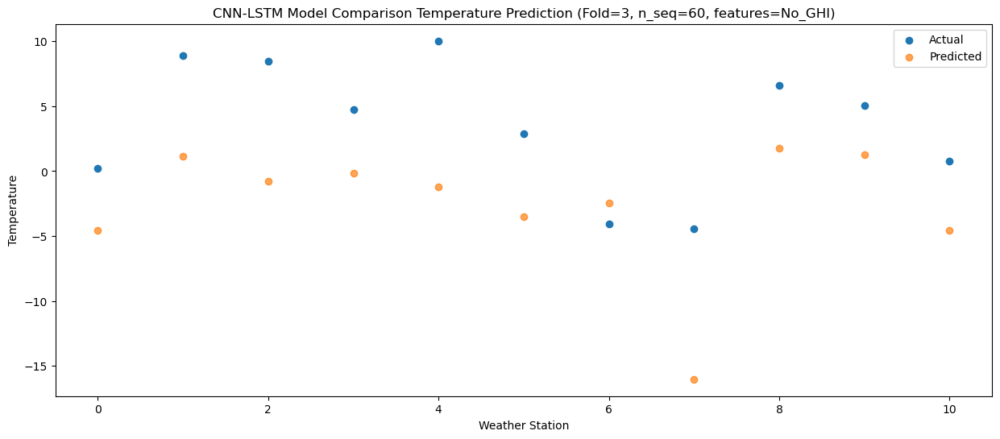

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89  -0.451030
1                 1   13.12   5.248978
2                 2   13.25   3.368958
3                 3    8.82   3.998982
4                 4   14.60   2.918987
5                 5    7.18   0.598989
6                 6    0.98   1.678972
7                 7    0.02 -11.891034
8                 8   10.89   5.918956
9                 9    9.91   5.388970
10               10    5.05  -0.451026


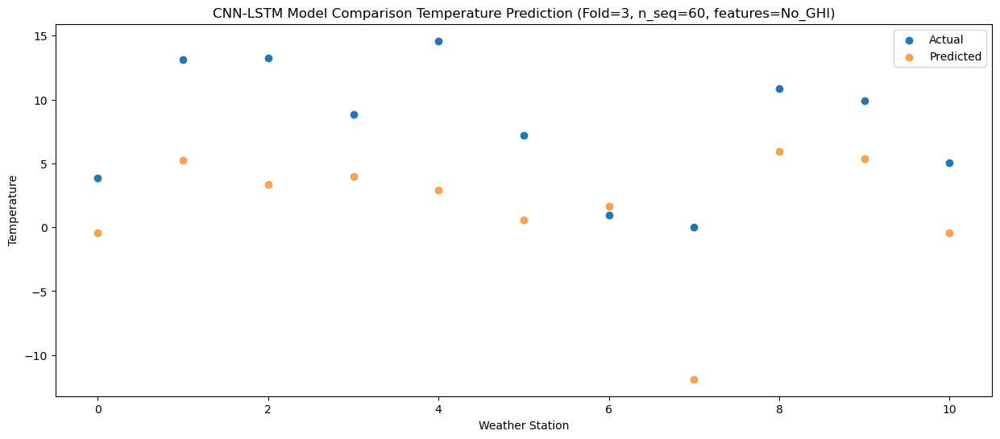

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95   5.426542
1                 1   19.83  11.126550
2                 2   18.10   9.246530
3                 3   14.74   9.876554
4                 4   22.08   8.796557
5                 5   13.89   6.476557
6                 6    8.37   7.556543
7                 7    7.66  -6.013464
8                 8   12.59  11.796528
9                 9   15.78  11.266542
10               10   11.22   5.426544


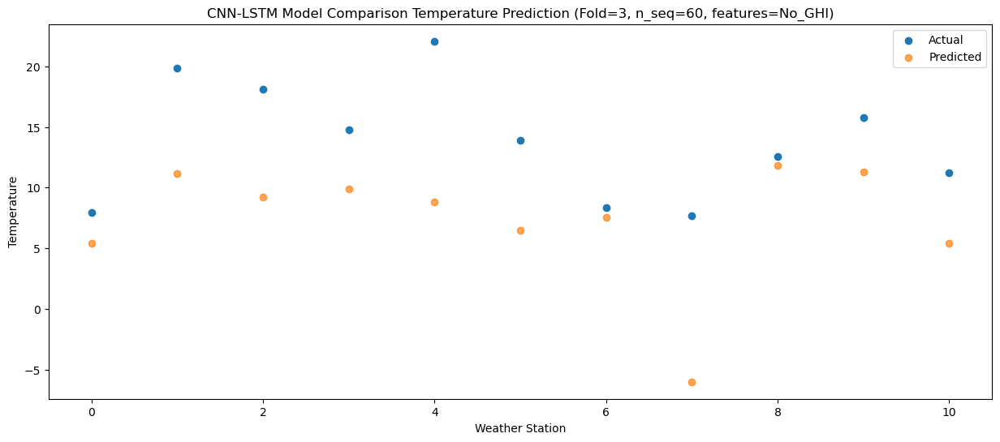

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66   5.913171
1                 1   21.14  11.613181
2                 2   21.23   9.733162
3                 3   15.73  10.363185
4                 4   22.08   9.283189
5                 5   14.27   6.963190
6                 6   10.21   8.043172
7                 7    8.74  -5.526834
8                 8   11.77  12.283160
9                 9   17.92  11.753172
10               10   12.86   5.913175


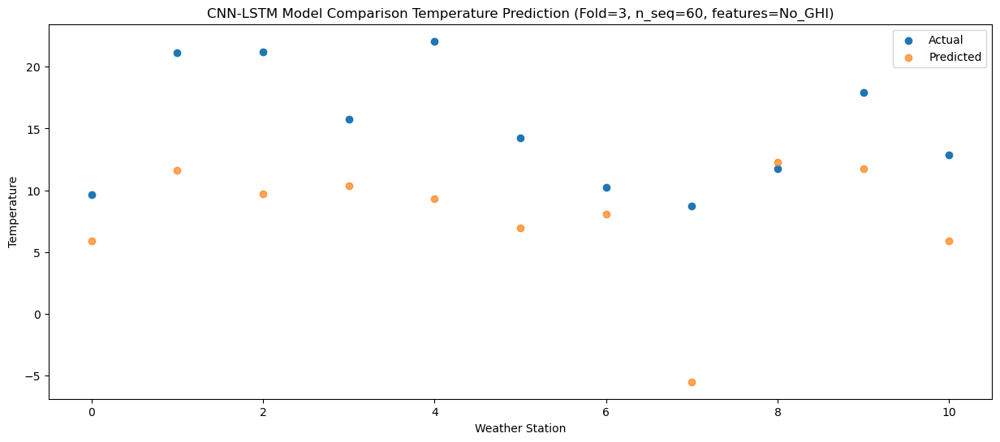

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88   6.728470
1                 1   21.71  12.428479
2                 2   19.03  10.548460
3                 3   16.25  11.178485
4                 4   22.20  10.098490
5                 5   14.59   7.778491
6                 6    8.29   8.858471
7                 7    7.51  -4.711536
8                 8   12.32  13.098458
9                 9   18.54  12.568471
10               10   12.59   6.728474


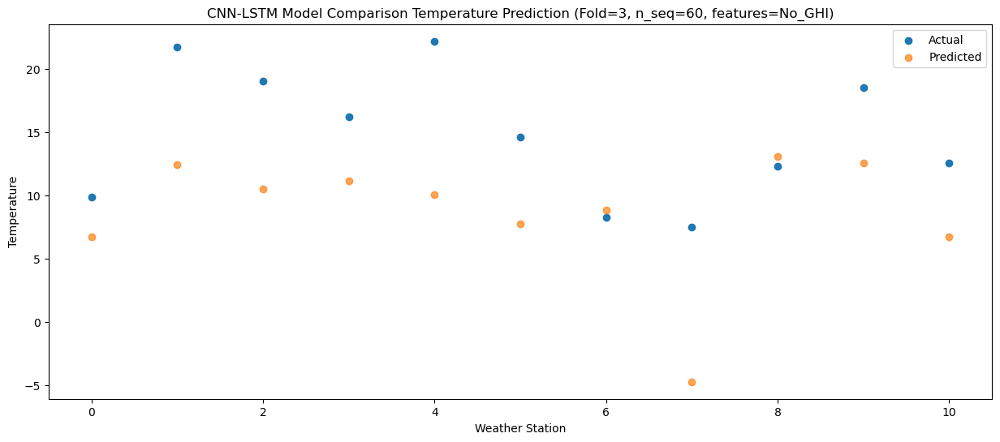

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   3.002759
1                 1   18.98   8.702768
2                 2   15.72   6.822749
3                 3   12.12   7.452775
4                 4   18.84   6.372781
5                 5   11.33   4.052780
6                 6    6.42   5.132760
7                 7    3.54  -8.437248
8                 8   11.77   9.372747
9                 9   15.22   8.842761
10               10    8.33   3.002764


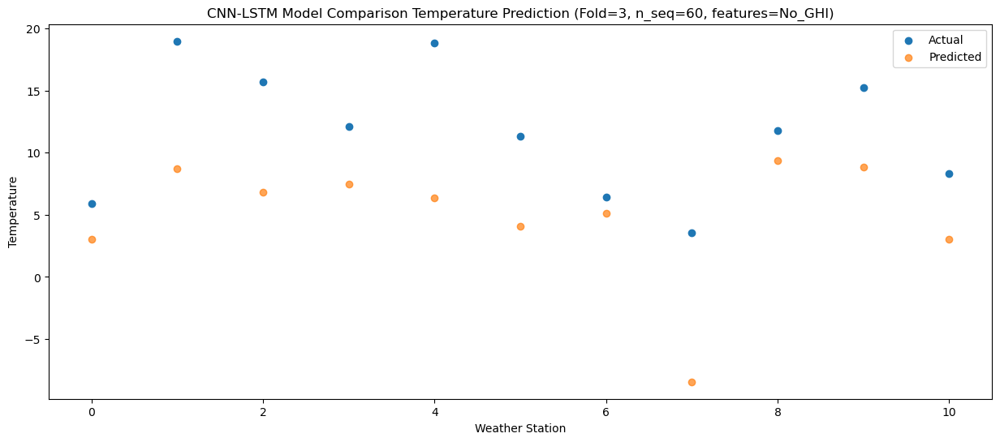

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66  -2.110045
1                 1   12.38   3.589965
2                 2    7.06   1.709945
3                 3    8.54   2.339972
4                 4   13.42   1.259979
5                 5    6.75  -1.060022
6                 6   -1.55   0.019956
7                 7   -6.81 -13.550052
8                 8    9.01   4.259941
9                 9   10.78   3.729957
10               10    4.21  -2.110040


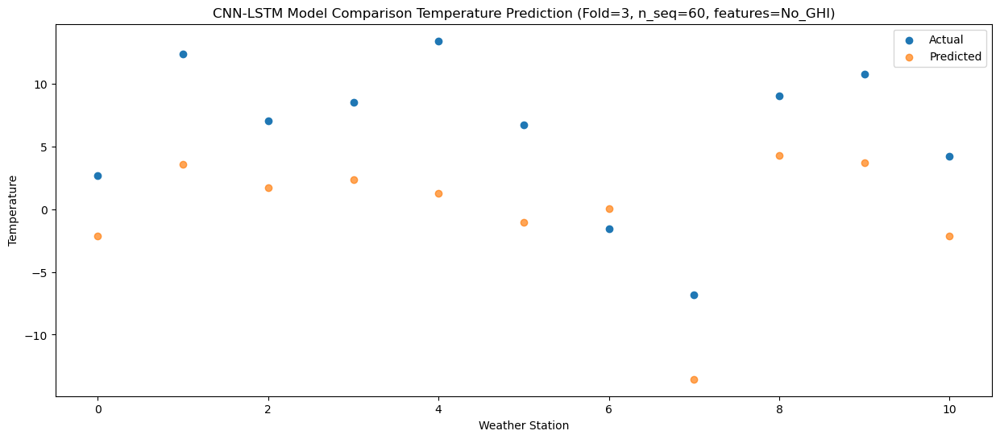

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10 -10.863284
1                 1    4.67  -5.163271
2                 2    2.72  -7.043294
3                 3   -1.12  -6.413266
4                 4    3.68  -7.493257
5                 5   -4.10  -9.813257
6                 6   -4.29  -8.733283
7                 7   -9.33 -22.303291
8                 8    6.19  -4.493297
9                 9    1.86  -5.023280
10               10   -6.01 -10.863278


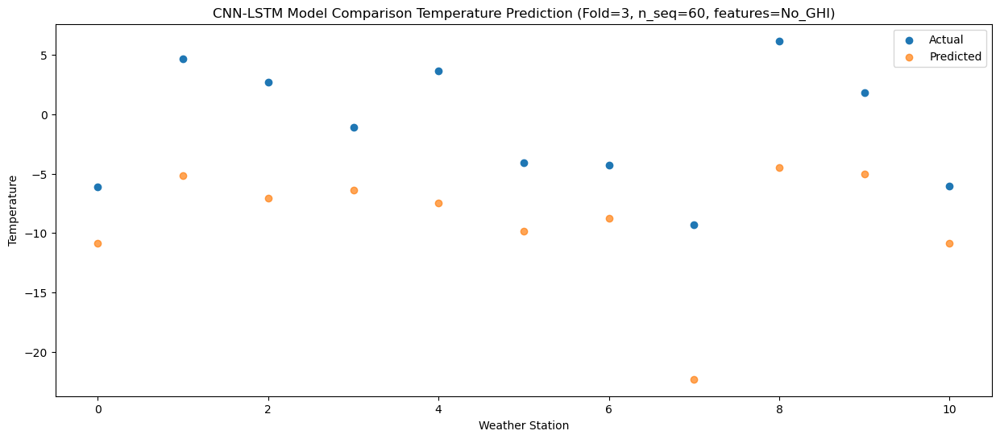

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14 -12.128174
1                 1    5.98  -6.428159
2                 2   -1.20  -8.308185
3                 3    0.37  -7.678154
4                 4    3.32  -8.758146
5                 5   -3.05 -11.078144
6                 6   -9.05  -9.998173
7                 7  -16.60 -23.568181
8                 8    2.49  -5.758187
9                 9    0.26  -6.288169
10               10   -6.42 -12.128168


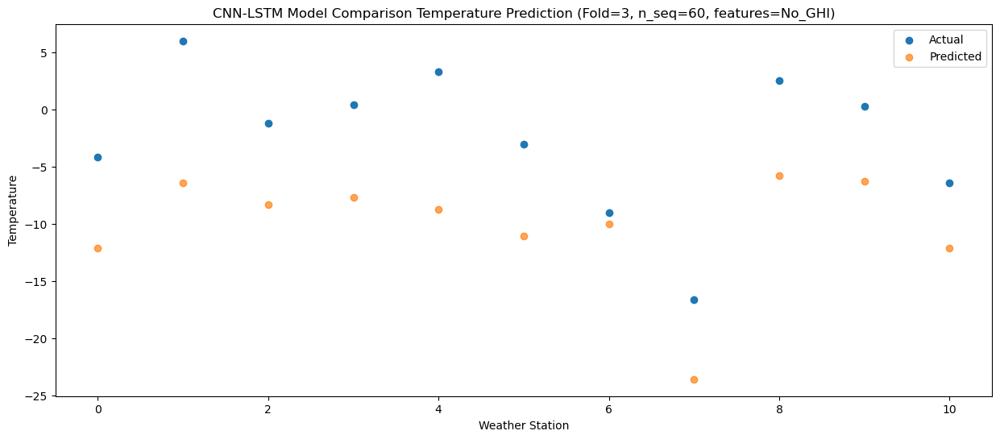

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -19.978487
1                 1   -2.85 -14.278471
2                 2   -1.53 -16.158497
3                 3   -8.58 -15.528466
4                 4   -6.15 -16.608458
5                 5  -11.87 -18.928458
6                 6  -11.34 -17.848485
7                 7  -16.67 -31.418493
8                 8    3.11 -13.608501
9                 9   -6.29 -14.138482
10               10  -13.40 -19.978482


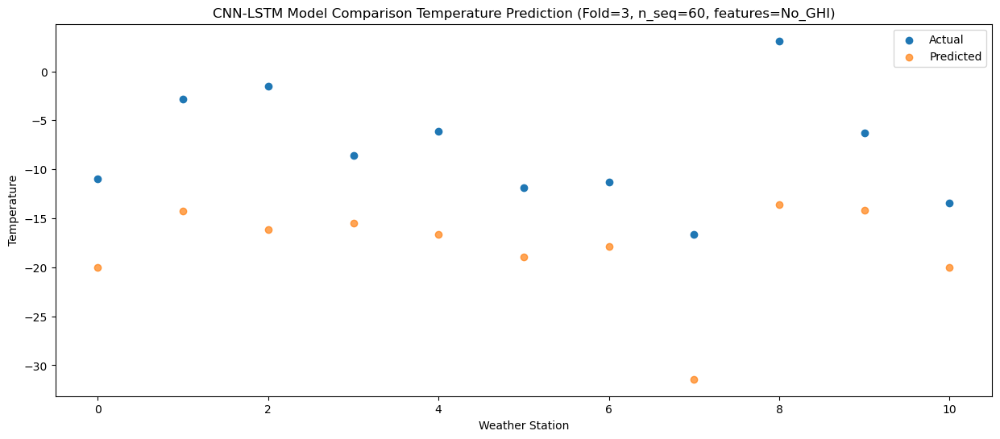

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60 -17.193703
1                 1   -1.63 -11.493686
2                 2    0.17 -13.373712
3                 3   -4.06 -12.743682
4                 4   -3.63 -13.823676
5                 5   -8.68 -16.143675
6                 6  -13.06 -15.063701
7                 7  -14.63 -28.633708
8                 8    4.07 -10.823718
9                 9   -3.53 -11.353696
10               10   -9.59 -17.193698


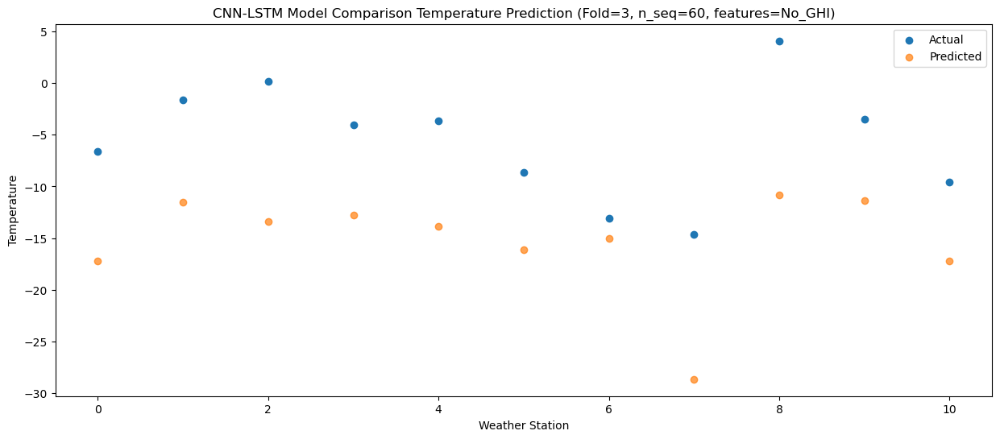

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54 -11.824356
1                 1    5.15  -6.124338
2                 2    4.88  -8.004366
3                 3    1.69  -7.374335
4                 4    4.83  -8.454329
5                 5   -1.72 -10.774328
6                 6   -8.52  -9.694354
7                 7   -9.92 -23.264362
8                 8    6.30  -5.454371
9                 9    0.43  -5.984349
10               10   -4.41 -11.824351


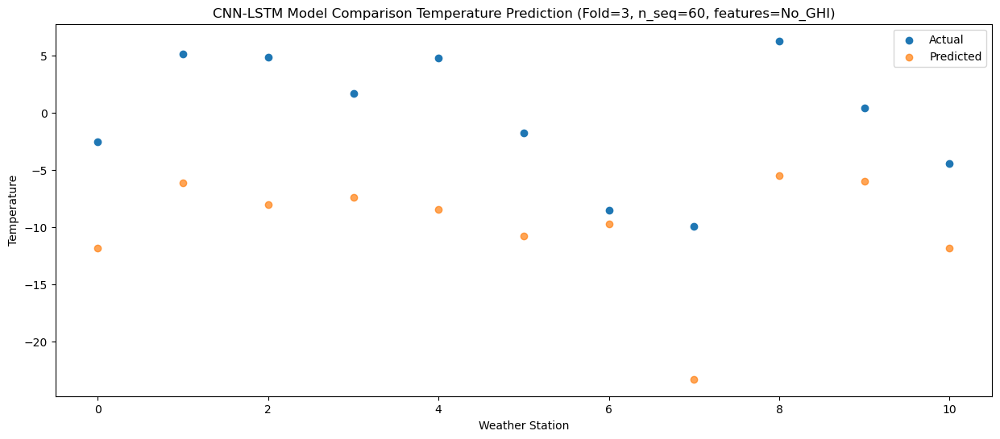

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56  -7.640533
1                 1   10.00  -1.940513
2                 2    7.95  -3.820541
3                 3    4.70  -3.190512
4                 4    8.96  -4.270506
5                 5    2.13  -6.590506
6                 6   -4.20  -5.510533
7                 7   -5.29 -19.080539
8                 8    7.74  -1.270549
9                 9    4.72  -1.800527
10               10   -0.59  -7.640529


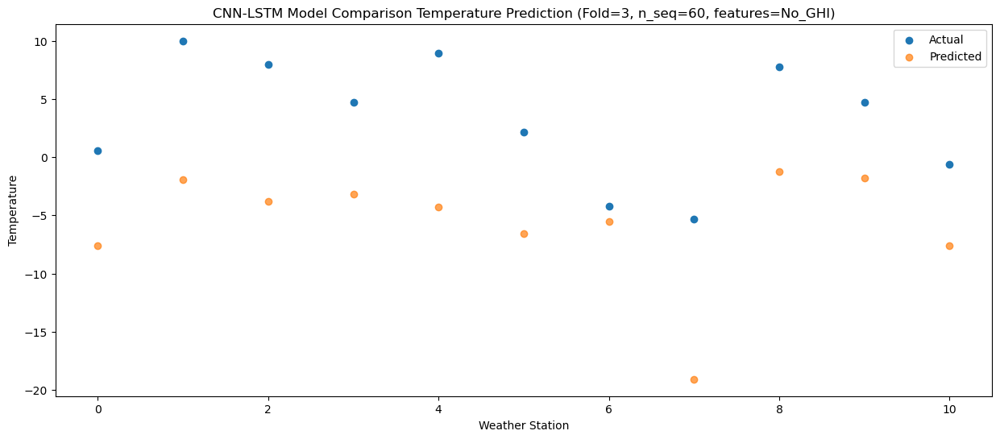

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40  -1.262481
1                 1   15.43   4.437540
2                 2   12.19   2.557512
3                 3   11.48   3.187540
4                 4   16.53   2.107546
5                 5    9.93  -0.212453
6                 6    1.71   0.867519
7                 7   -0.62 -12.702486
8                 8   10.73   5.107504
9                 9   10.51   4.577523
10               10    6.19  -1.262476


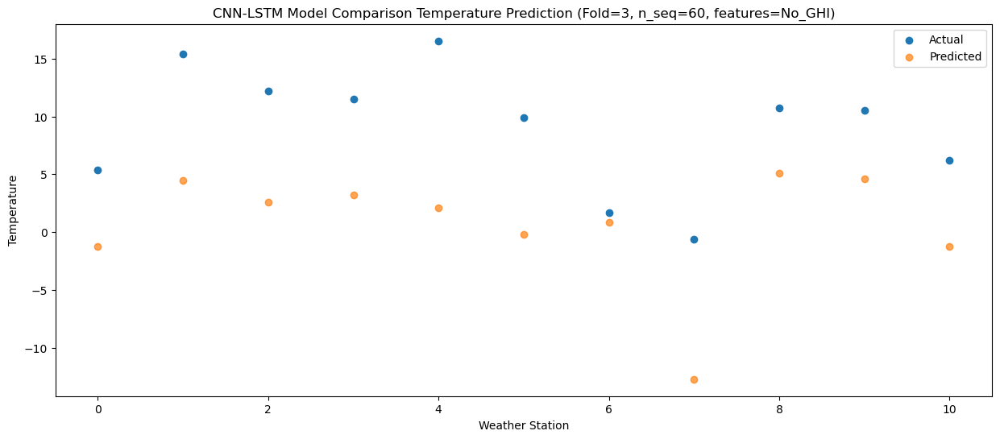

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36   2.386729
1                 1   20.58   8.086754
2                 2   17.58   6.206724
3                 3   14.96   6.836754
4                 4   21.98   5.756758
5                 5   13.87   3.436759
6                 6    7.48   4.516731
7                 7    5.86  -9.053274
8                 8   13.88   8.756716
9                 9   14.83   8.226736
10               10   10.18   2.386736


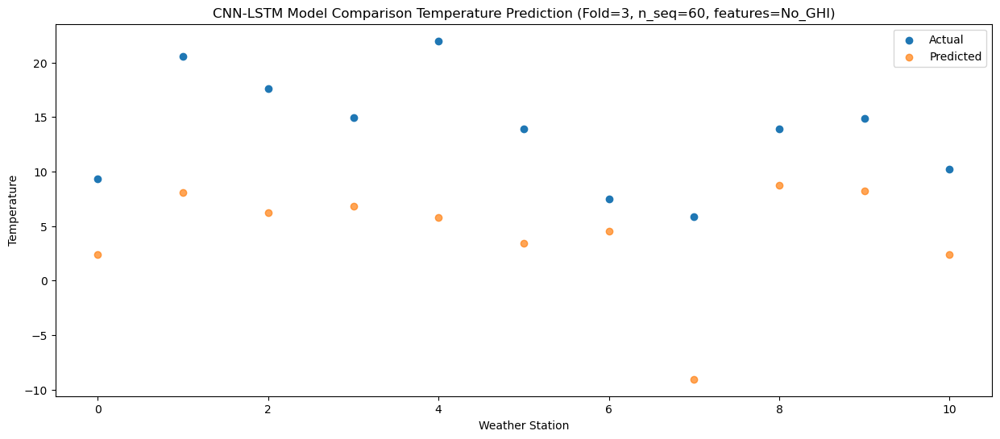

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13   4.952514
1                 1   24.62  10.652538
2                 2   20.15   8.772508
3                 3   16.51   9.402541
4                 4   23.10   8.322543
5                 5   15.86   6.002544
6                 6    9.40   7.082516
7                 7    8.09  -6.487490
8                 8   12.23  11.322501
9                 9   19.38  10.792521
10               10   13.96   4.952521


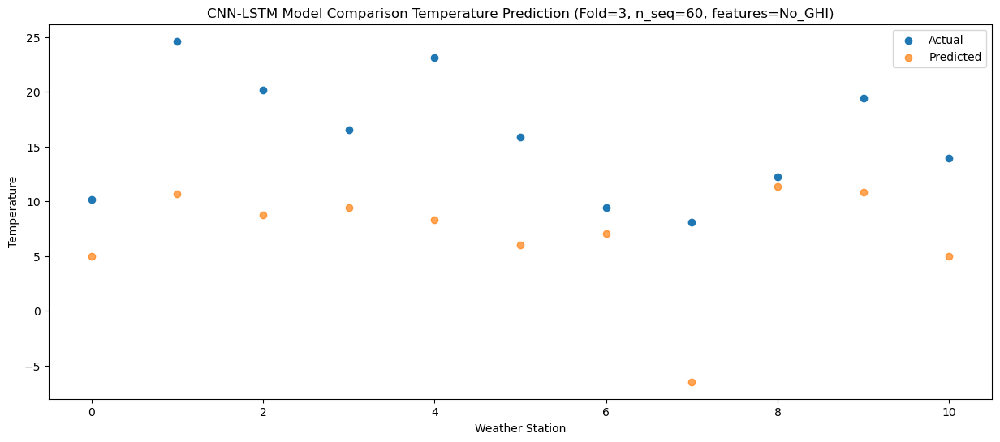

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22   3.676316
1                 1   21.54   9.376339
2                 2   20.33   7.496312
3                 3   15.44   8.126341
4                 4   21.28   7.046343
5                 5   14.21   4.726345
6                 6    8.64   5.806318
7                 7    6.50  -7.763689
8                 8   13.65  10.046302
9                 9   19.30   9.516322
10               10   13.09   3.676321


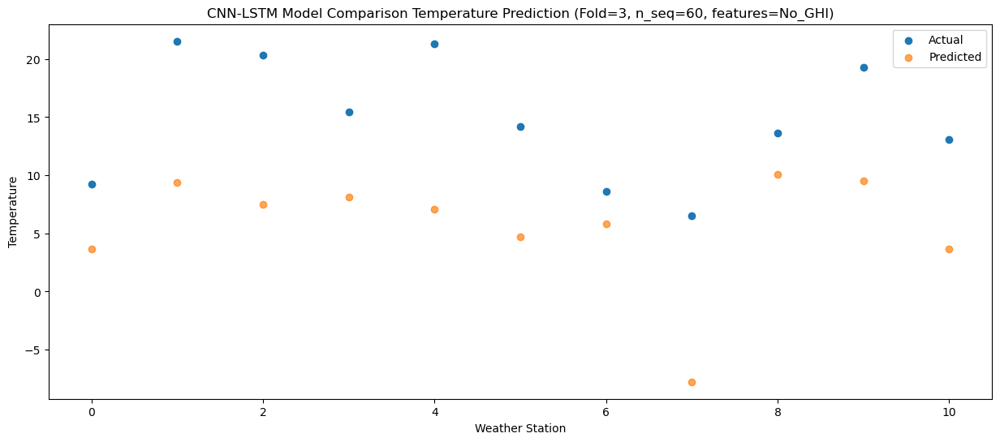

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01  -0.659410
1                 1   17.68   5.040613
2                 2   17.51   3.160587
3                 3   11.46   3.790616
4                 4   16.96   2.710617
5                 5   10.26   0.390619
6                 6    6.48   1.470592
7                 7    4.14 -12.099414
8                 8   13.88   5.710578
9                 9   14.39   5.180597
10               10    7.86  -0.659404


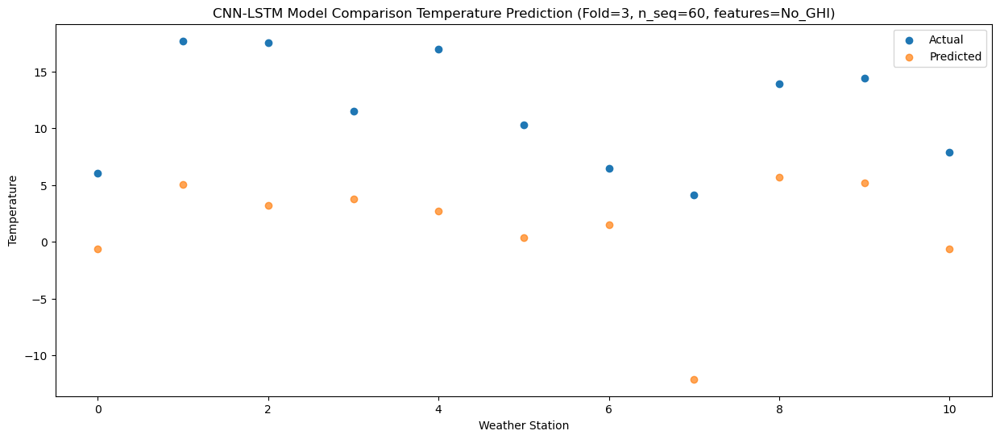

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -7.757581
1                 1   11.13  -2.057559
2                 2   10.33  -3.937585
3                 3    4.19  -3.307557
4                 4    9.69  -4.387557
5                 5    4.22  -6.707554
6                 6   -1.78  -5.627580
7                 7   -3.75 -19.197586
8                 8    9.15  -1.387593
9                 9    8.13  -1.917575
10               10    0.25  -7.757576


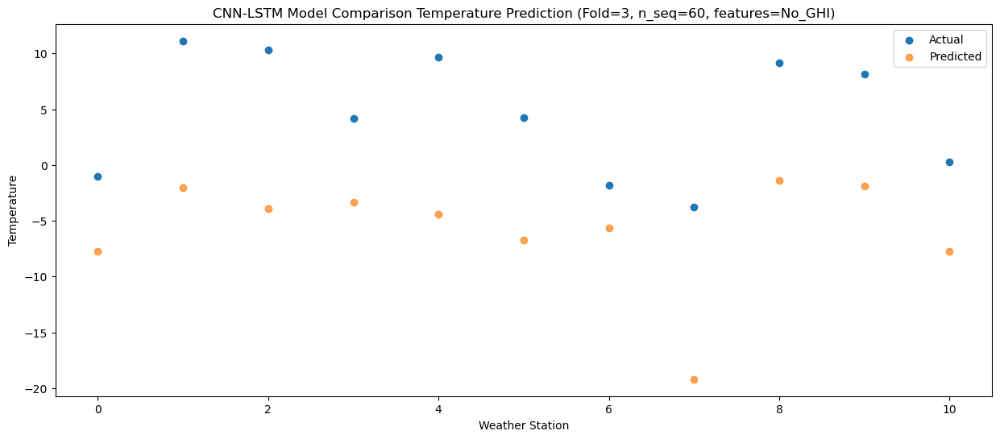

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03 -13.262393
1                 1    3.90  -7.562366
2                 2   -0.40  -9.442397
3                 3    1.07  -8.812366
4                 4    3.80  -9.892362
5                 5   -2.33 -12.212361
6                 6   -9.46 -11.132391
7                 7  -15.17 -24.702396
8                 8    3.42  -6.892406
9                 9    4.17  -7.422384
10               10   -2.87 -13.262387


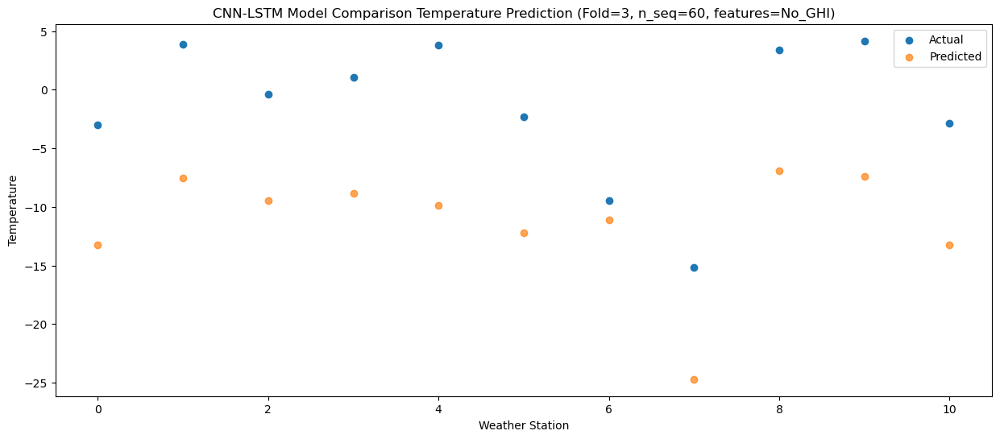

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91 -19.299725
1                 1   -0.15 -13.599699
2                 2   -1.36 -15.479730
3                 3   -4.20 -14.849700
4                 4   -2.17 -15.929694
5                 5   -7.87 -18.249694
6                 6  -11.63 -17.169723
7                 7  -17.50 -30.739729
8                 8    2.22 -12.929738
9                 9   -2.19 -13.459717
10               10   -9.90 -19.299720


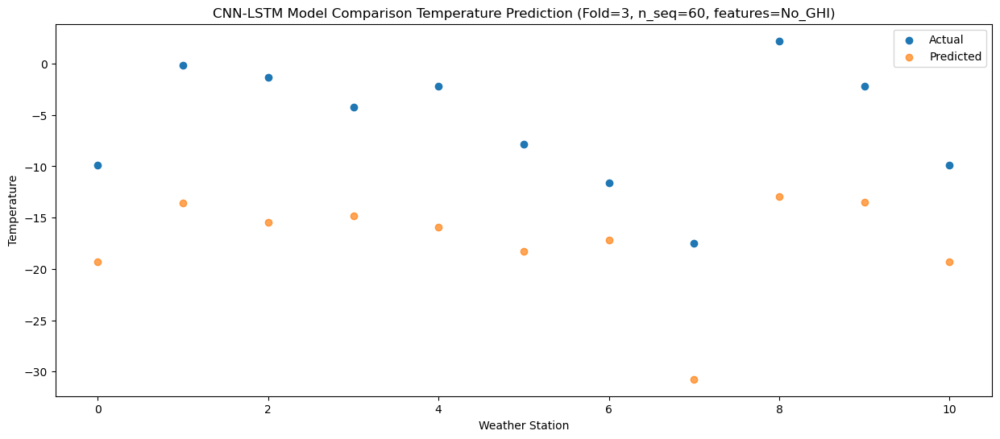

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49 -18.590719
1                 1    0.55 -12.890692
2                 2    0.03 -14.770723
3                 3   -2.45 -14.140696
4                 4   -0.45 -15.220690
5                 5   -5.73 -17.540689
6                 6  -12.36 -16.460717
7                 7  -18.01 -30.030722
8                 8    3.89 -12.220734
9                 9   -0.21 -12.750711
10               10   -7.25 -18.590716


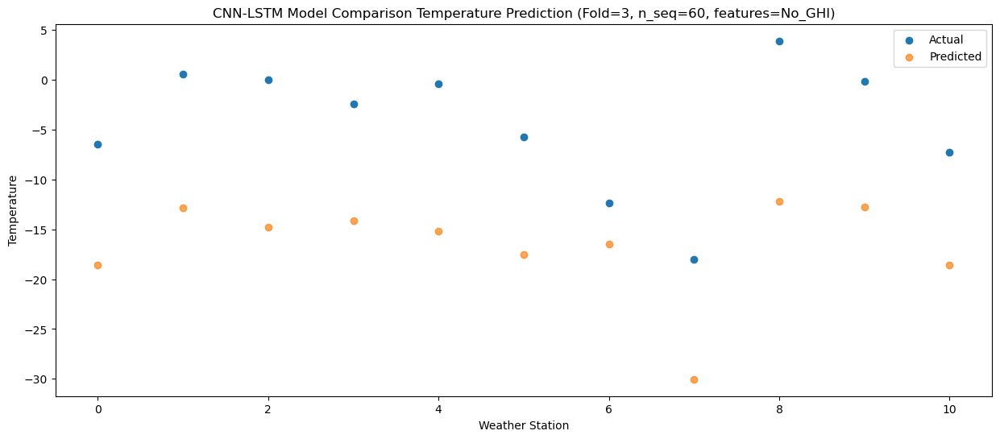

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67 -18.593375
1                 1    2.51 -12.893345
2                 2   -0.82 -14.773377
3                 3   -0.11 -14.143350
4                 4    6.07 -15.223342
5                 5   -4.01 -17.543341
6                 6  -12.33 -16.463371
7                 7  -17.10 -30.033376
8                 8    2.09 -12.223388
9                 9   -1.94 -12.753365
10               10   -7.04 -18.593370


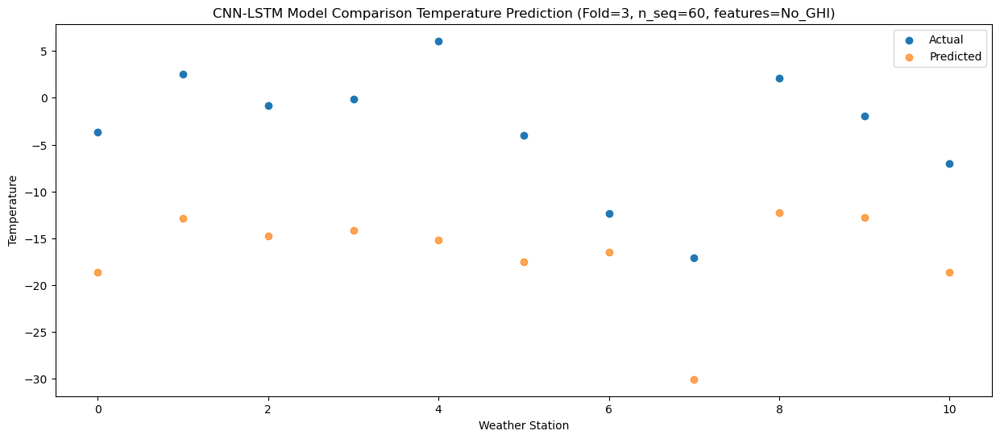

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20 -16.818412
1                 1    5.11 -11.118380
2                 2    2.05 -12.998413
3                 3    0.13 -12.368385
4                 4    3.11 -13.448377
5                 5   -3.11 -15.768376
6                 6  -10.54 -14.688408
7                 7  -14.27 -28.258413
8                 8    3.55 -10.448423
9                 9    0.03 -10.978400
10               10   -5.48 -16.818405


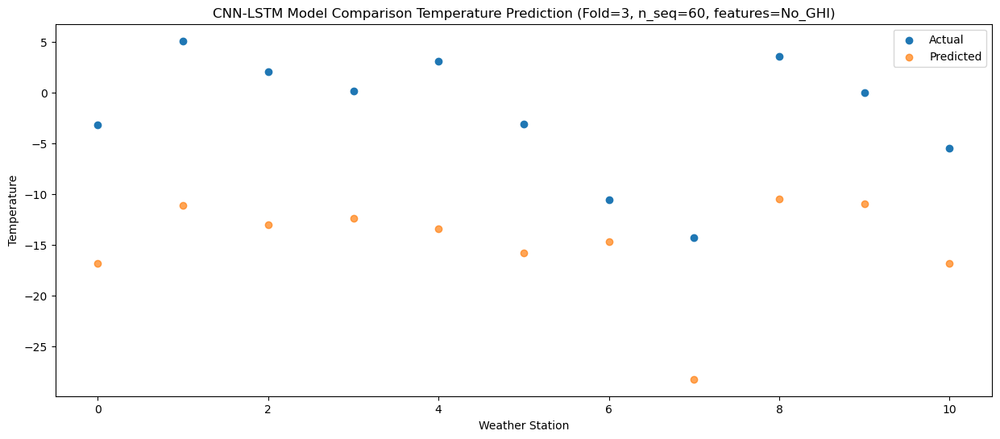

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47 -11.259062
1                 1   10.16  -5.559030
2                 2    7.68  -7.439063
3                 3    6.37  -6.809033
4                 4   10.32  -7.889025
5                 5    3.12 -10.209025
6                 6   -5.20  -9.129058
7                 7   -6.32 -22.699062
8                 8    7.63  -4.889073
9                 9    6.08  -5.419050
10               10    2.09 -11.259055


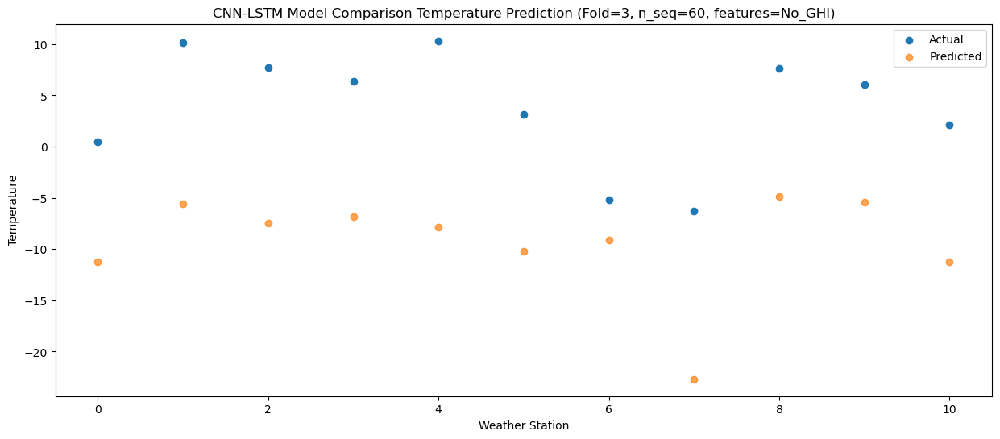

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83  -7.479790
1                 1   15.47  -1.779759
2                 2   12.12  -3.659793
3                 3    9.06  -3.029762
4                 4   16.32  -4.109754
5                 5    8.53  -6.429753
6                 6    2.01  -5.349787
7                 7   -0.52 -18.919790
8                 8    8.66  -1.109806
9                 9    9.72  -1.639779
10               10    4.56  -7.479784


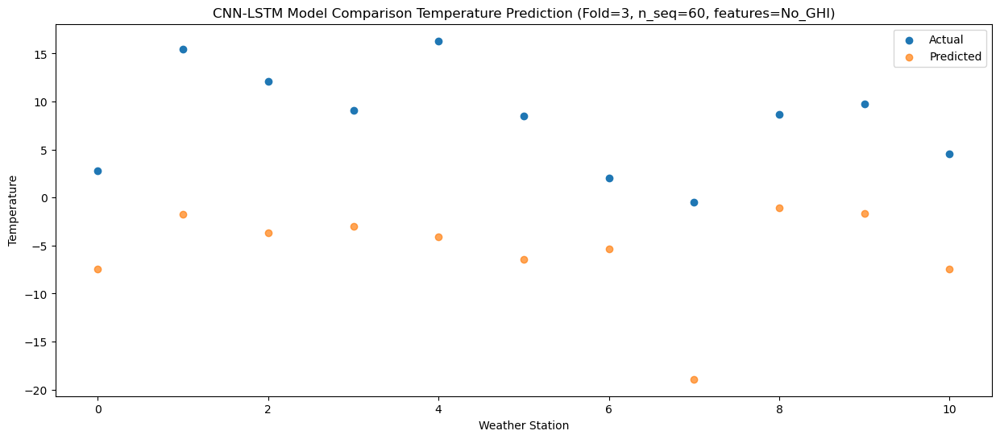

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60  -3.603283
1                 1   19.80   2.096749
2                 2   14.92   0.216714
3                 3   12.80   0.846744
4                 4   20.42  -0.233247
5                 5   11.99  -2.553246
6                 6    6.59  -1.473279
7                 7    1.98 -15.043283
8                 8   10.56   2.766702
9                 9   13.71   2.236729
10               10    8.49  -3.603276


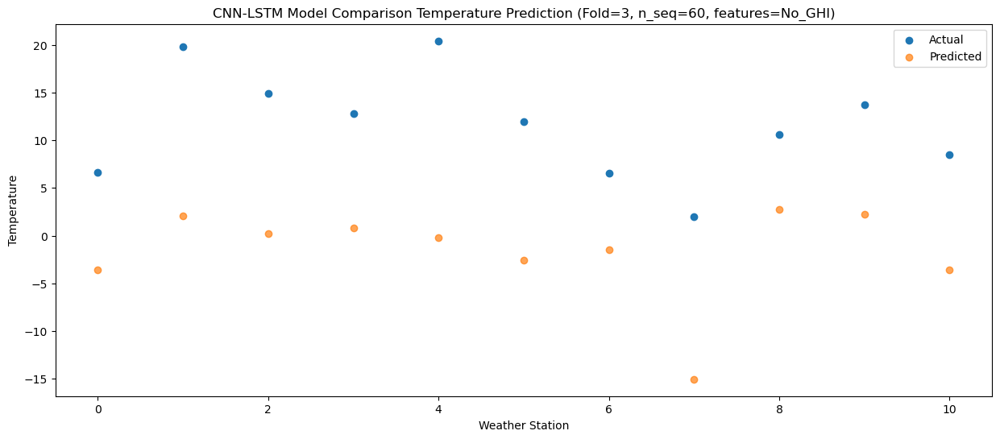

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  -0.342190
1                 1   22.06   5.357842
2                 2   20.58   3.477806
3                 3   16.42   4.107839
4                 4   22.12   3.027847
5                 5   15.25   0.707848
6                 6   12.73   1.787812
7                 7   10.34 -11.782190
8                 8   13.57   6.027793
9                 9   19.39   5.497822
10               10   13.33  -0.342183


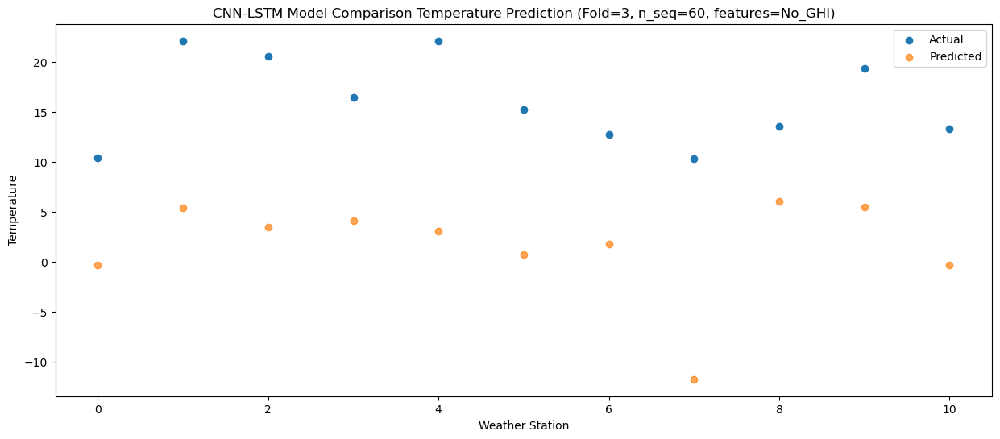

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  -1.660763
1                 1   22.24   4.039270
2                 2   18.89   2.159232
3                 3   15.31   2.789267
4                 4   20.83   1.709275
5                 5   13.70  -0.610722
6                 6   10.14   0.469239
7                 7    5.71 -13.100761
8                 8   14.60   4.709218
9                 9   17.14   4.179251
10               10   11.36  -1.660755


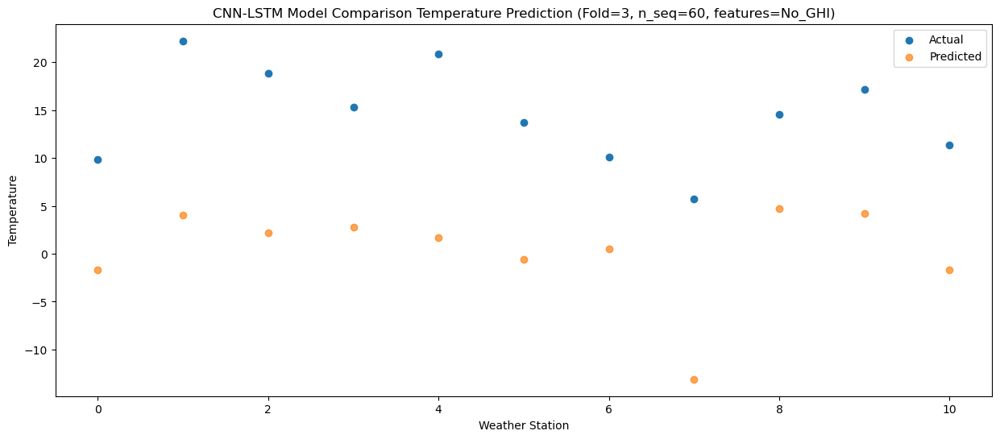

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73  -4.669330
1                 1   18.19   1.030701
2                 2   15.12  -0.849335
3                 3   12.58  -0.219301
4                 4   17.47  -1.299292
5                 5   10.24  -3.619288
6                 6    5.99  -2.539330
7                 7    1.01 -16.109329
8                 8   11.99   1.700652
9                 9   14.57   1.170681
10               10    8.07  -4.669323


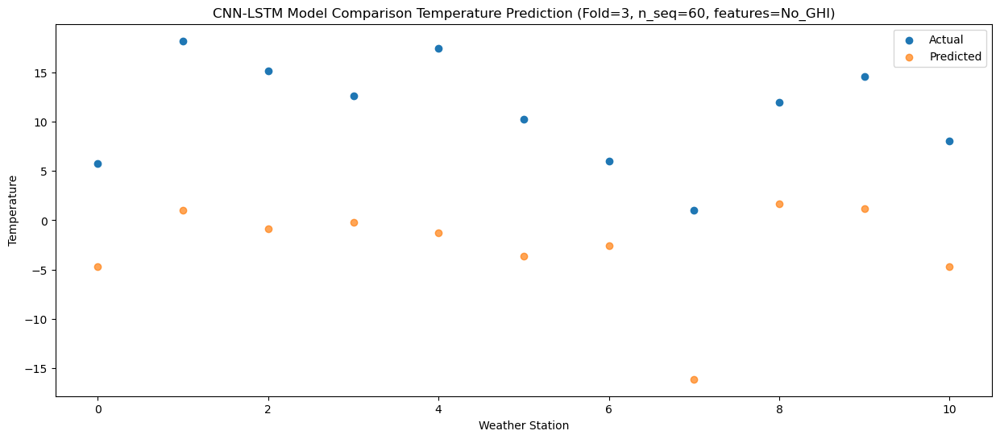

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70 -10.711286
1                 1   11.25  -5.011255
2                 2    9.81  -6.891291
3                 3    7.14  -6.261259
4                 4   11.01  -7.341247
5                 5    4.59  -9.661243
6                 6   -0.14  -8.581286
7                 7   -4.28 -22.151285
8                 8   10.53  -4.341304
9                 9    9.14  -4.871276
10               10    2.78 -10.711281


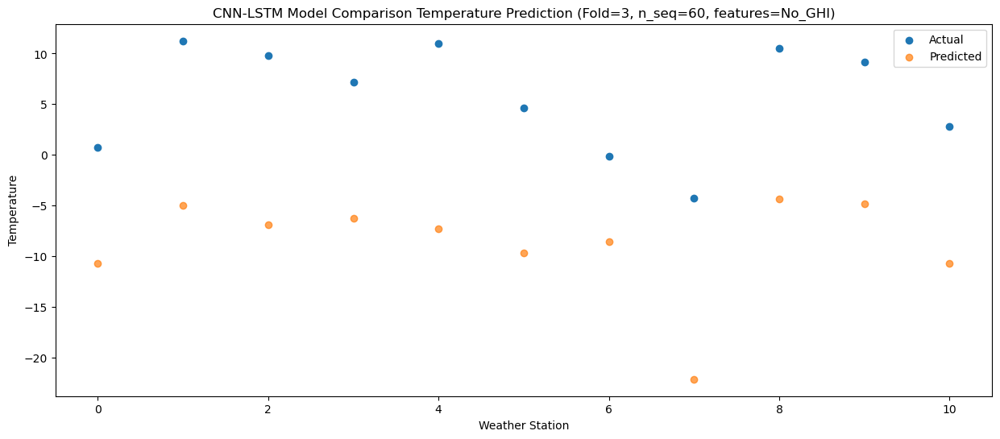

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96 -18.282661
1                 1    5.47 -12.582630
2                 2    2.90 -14.462666
3                 3    0.75 -13.832633
4                 4    4.06 -14.912622
5                 5   -1.89 -17.232617
6                 6   -6.00 -16.152661
7                 7  -12.42 -29.722660
8                 8    6.49 -11.912679
9                 9    1.29 -12.442650
10               10   -5.49 -18.282655


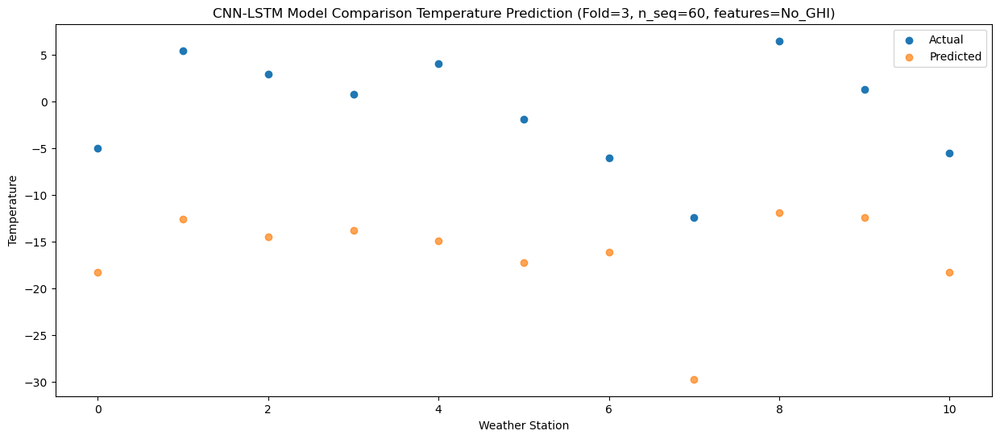

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01 -20.348002
1                 1    2.12 -14.647972
2                 2    1.06 -16.528007
3                 3   -1.08 -15.897975
4                 4    1.25 -16.977964
5                 5   -4.35 -19.297959
6                 6   -9.63 -18.218002
7                 7  -15.55 -31.788001
8                 8    4.65 -13.978022
9                 9    0.56 -14.507991
10               10   -6.24 -20.347997


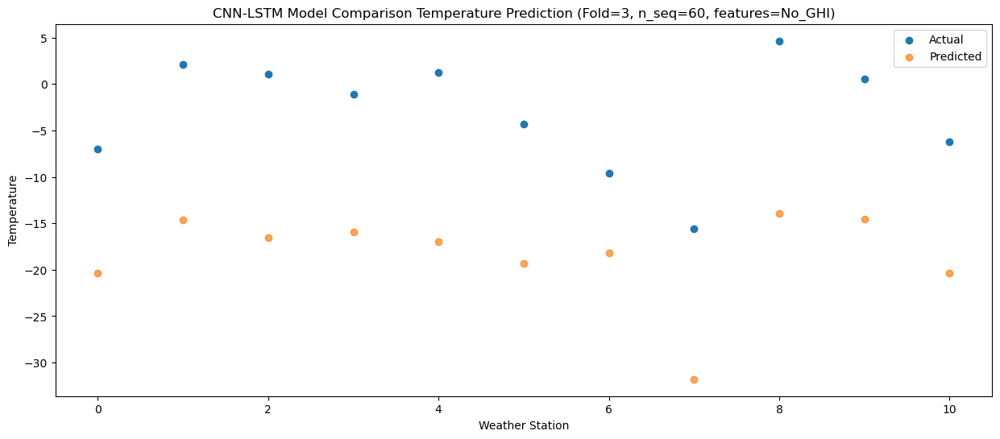

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32 -25.518442
1                 1   -4.49 -19.818411
2                 2    0.85 -21.698446
3                 3   -6.24 -21.068414
4                 4   -5.25 -22.148405
5                 5  -10.51 -24.468399
6                 6  -11.77 -23.388441
7                 7  -17.27 -36.958440
8                 8    4.96 -19.148462
9                 9   -3.43 -19.678430
10               10   -9.26 -25.518435


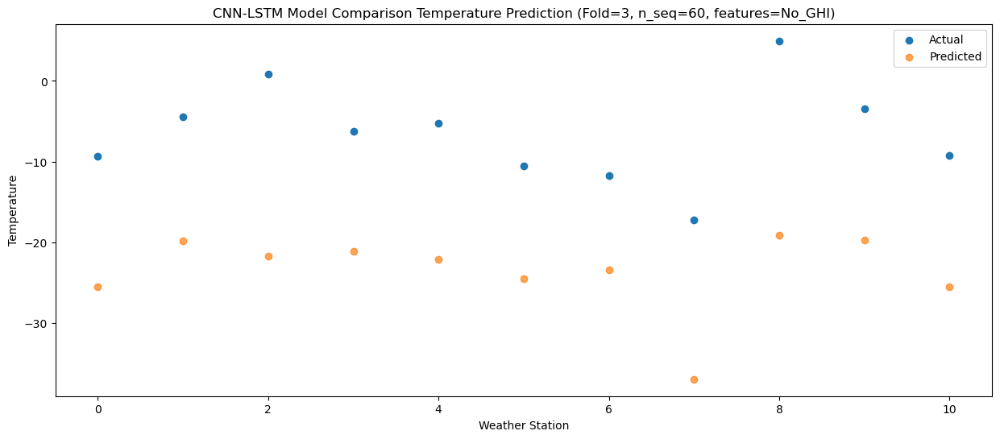

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18 -21.352249
1                 1    5.16 -15.652214
2                 2    2.34 -17.532251
3                 3   -0.56 -16.902218
4                 4    2.56 -17.982207
5                 5   -3.88 -20.302202
6                 6   -9.61 -19.222246
7                 7  -14.91 -32.792245
8                 8    4.67 -14.982267
9                 9   -2.86 -15.512235
10               10   -7.22 -21.352240


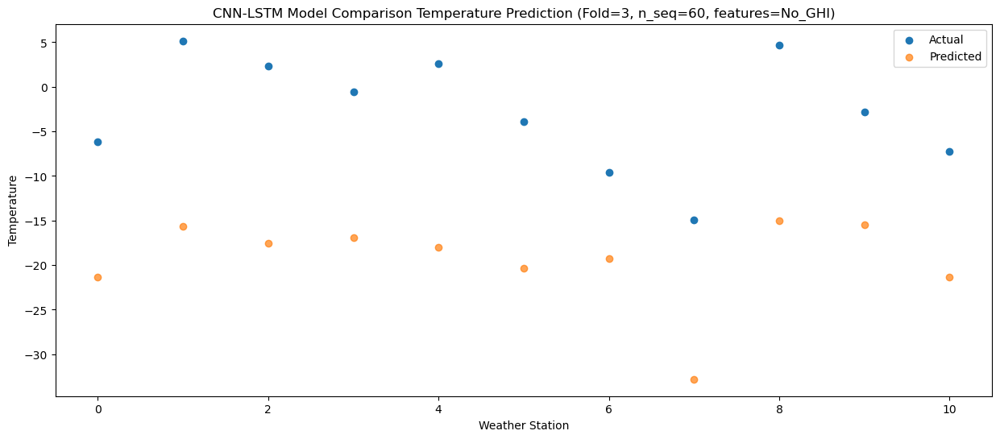

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51 -17.735230
1                 1    7.64 -12.035197
2                 2    4.37 -13.915230
3                 3    3.09 -13.285200
4                 4    6.67 -14.365189
5                 5    0.19 -16.685184
6                 6   -7.87 -15.605228
7                 7  -11.55 -29.175227
8                 8    5.60 -11.365247
9                 9    1.84 -11.895217
10               10   -2.56 -17.735222


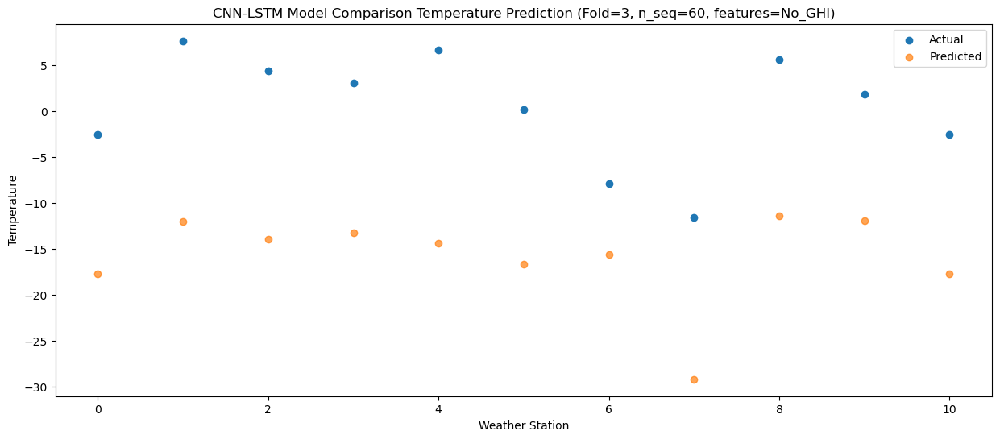

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51 -13.689665
1                 1   11.81  -7.989630
2                 2    7.56  -9.869665
3                 3    8.15  -9.239632
4                 4   11.42 -10.319620
5                 5    5.16 -12.639614
6                 6   -2.89 -11.559662
7                 7   -6.05 -25.129661
8                 8    7.83  -7.319683
9                 9    4.71  -7.849653
10               10    2.02 -13.689656


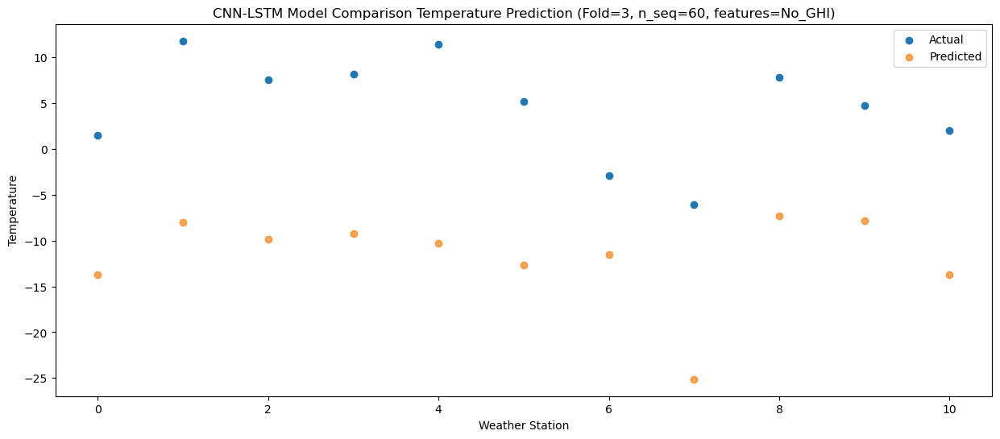

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78  -8.482803
1                 1   16.58  -2.782767
2                 2   12.95  -4.662803
3                 3   12.34  -4.032770
4                 4   17.58  -5.112757
5                 5   10.68  -7.432753
6                 6    0.22  -6.352800
7                 7   -0.42 -19.922799
8                 8   10.80  -2.112825
9                 9   10.26  -2.642791
10               10    7.69  -8.482795


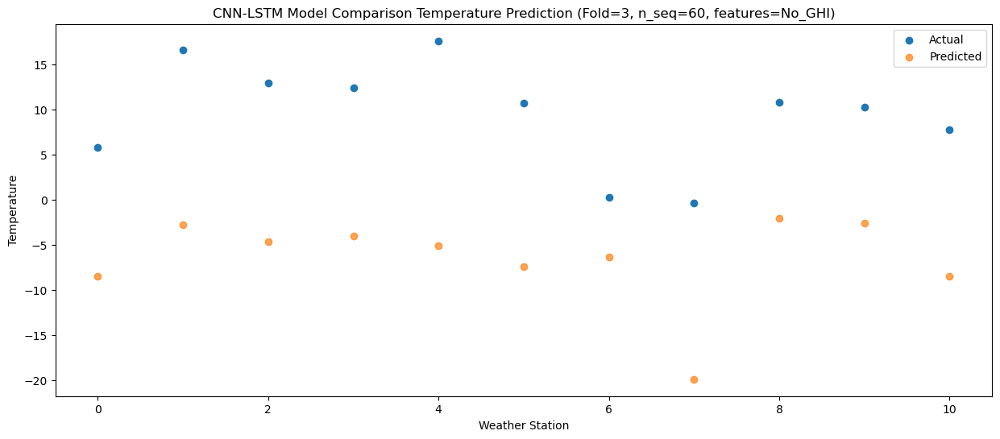

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  -4.327457
1                 1   21.14   1.372578
2                 2   18.90  -0.507459
3                 3   16.24   0.122575
4                 4   22.45  -0.957412
5                 5   13.91  -3.277408
6                 6    9.37  -2.197456
7                 7    7.76 -15.767455
8                 8   13.71   2.042519
9                 9   16.73   1.512553
10               10   13.06  -4.327450


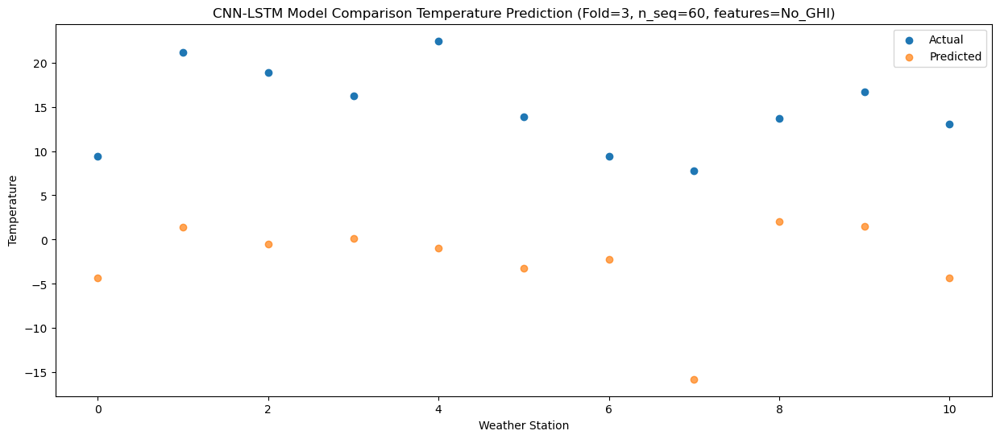

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  -3.397428
1                 1   21.66   2.302607
2                 2   22.47   0.422570
3                 3   17.95   1.052604
4                 4   21.61  -0.027383
5                 5   14.46  -2.347377
6                 6   10.12  -1.267427
7                 7   10.84 -14.837426
8                 8   14.97   2.972548
9                 9   19.29   2.442582
10               10   15.72  -3.397421


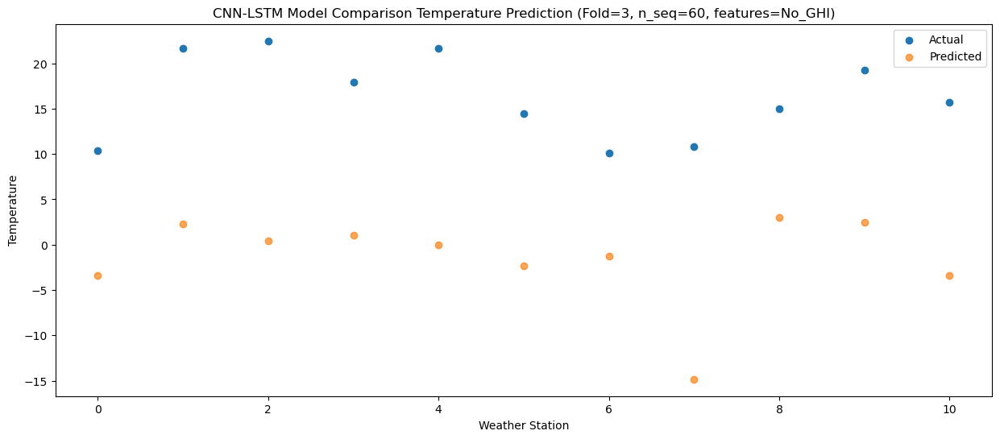

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93  -4.537264
1                 1   21.94   1.162770
2                 2   19.50  -0.717266
3                 3   16.93  -0.087233
4                 4   21.06  -1.167220
5                 5   13.91  -3.487214
6                 6    9.83  -2.407264
7                 7    7.98 -15.977263
8                 8   13.69   1.832710
9                 9   17.57   1.302745
10               10   12.58  -4.537258


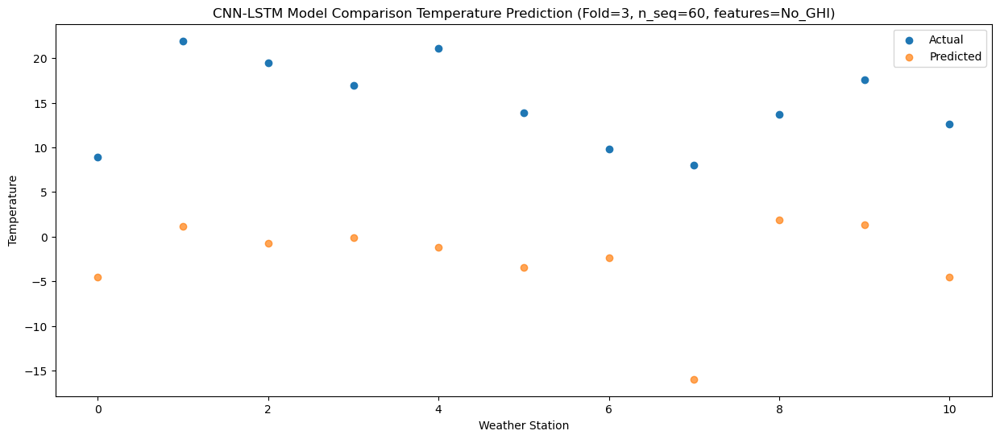

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  -7.971609
1                 1   17.90  -2.271575
2                 2   16.47  -4.151613
3                 3   13.96  -3.521578
4                 4   17.80  -4.601565
5                 5   11.22  -6.921559
6                 6    6.21  -5.841610
7                 7    4.03 -19.411608
8                 8   12.25  -1.601637
9                 9   13.56  -2.131600
10               10    8.99  -7.971603


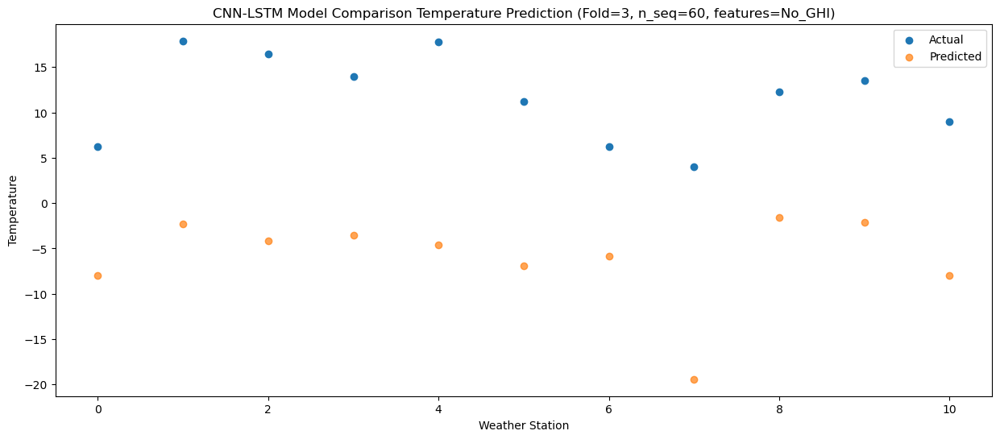

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93 -13.666026
1                 1   14.51  -7.965990
2                 2   11.44  -9.846029
3                 3    7.46  -9.215993
4                 4   12.17 -10.295979
5                 5    5.34 -12.615974
6                 6    1.98 -11.536026
7                 7   -1.86 -25.106023
8                 8   11.79  -7.296053
9                 9    9.03  -7.826016
10               10    3.75 -13.666019


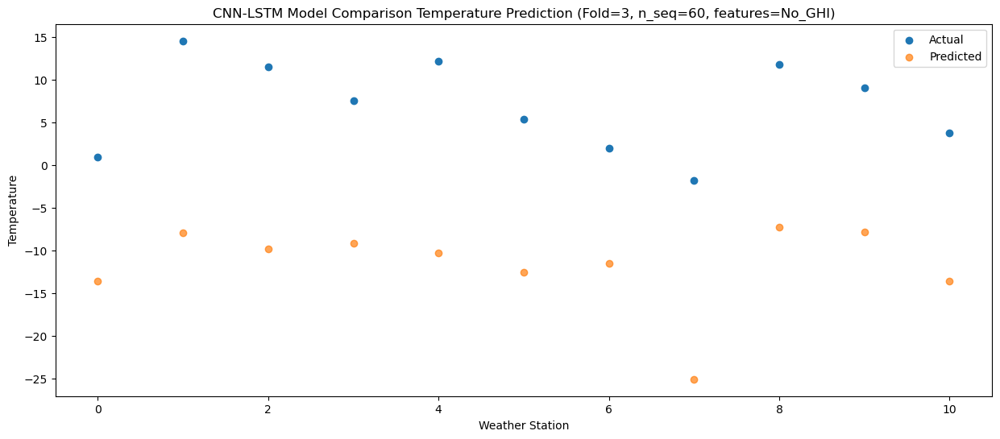

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

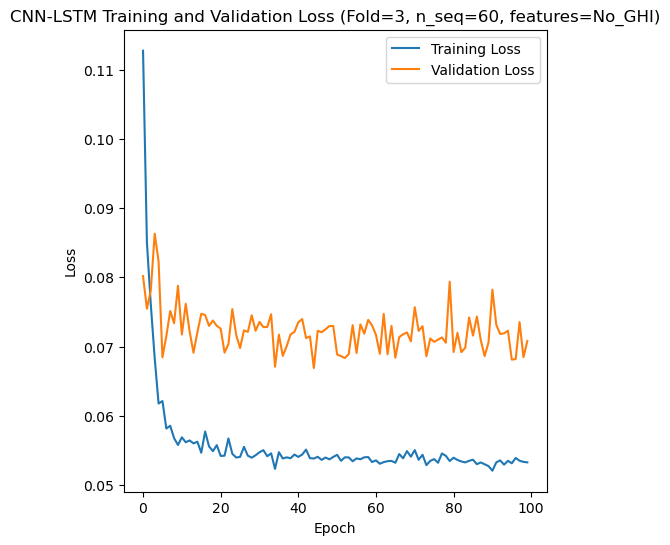

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 37s 174ms/step - loss: 0.1227 - accuracy: 0.2024 - mae: 0.1008 - rmse: 0.1227 - mape: inf - pearson: 0.6233 - val_loss: 0.0871 - val_accuracy: 0.0000e+00 - val_mae: 0.0681 - val_rmse: 0.0871 - val_mape: 15.2852 - val_pearson: 0.7441
Epoch 2/100
84/84 [==============================] - 9s 104ms/step - loss: 0.0789 - accuracy: 0.4048 - mae: 0.0635 - rmse: 0.0789 - mape: inf - pearson: 0.7811 - val_loss: 0.0676 - val_accuracy: 0.6000 - val_mae: 0.0541 - val_rmse: 0.0676 - val_mape: 12.6809 - val_pearson: 0.8335
Epoch 3/100
84/84 [==============================] - 8s 96ms/step - loss: 0.0706 - accuracy: 0.3929 - mae: 0.0569 - rmse: 0.0706 - mape: inf - pearson: 0.8221 - val_loss

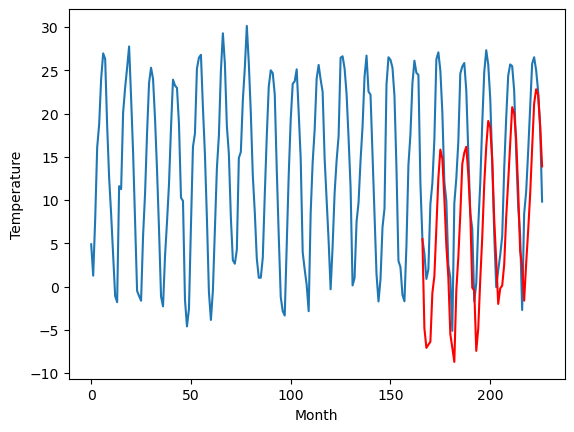

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-3.55		-1.17
-2.56		-5.82		-3.26
-4.02		-5.45		-1.43
-2.47		-5.11		-2.64
1.60		0.52		-1.08
3.28		2.48		-0.80
4.68		8.03		3.35
6.44		13.78		7.34
6.76		17.10		10.34
6.61		16.04		9.43
6.03		11.50		5.47
4.53		6.03		1.50
1.14		2.36		1.22
-6.61		-4.22		2.39
-5.91		-5.82		0.09
-2.48		-7.44		-4.96
-0.88		0.82		1.70
0.56		4.65		4.09
4.60		9.63		5.03
6.23		15.46		9.23
6.60		16.74		10.14
6.88		17.44		10.56
5.59		14.26		8.67
3.75		9.82		6.07
-3.41		1.14		4.55
-1.61		0.81		2.42
-6.37		-6.17		0.20
-2.94		-3.54		-0.60
-0.12		2.06		2.18
2.22		6.99		4.77
5.04		13.13		8.09
6.76		17.43		10.67
7.13		20.42		13.29
7.08		19.66		12.58
5.64		15.88		10.24
1.81		8.99		7.18
0.35		4.31		3.96
-4.50		-0.74		3.76
-4.65		1.05		5.70
-1.35		1.38		2.73
0.37		3.81		3.44
3.09		9.29		6.20
3.87		13.41		9.54
6.08		17.77		11.69
7.69		22.01		14.32
8.20		21.29		13.09
6.10		18.29		12.19
2.45		12.48		10.03
-1.26		5.38		6.64
-3.38	

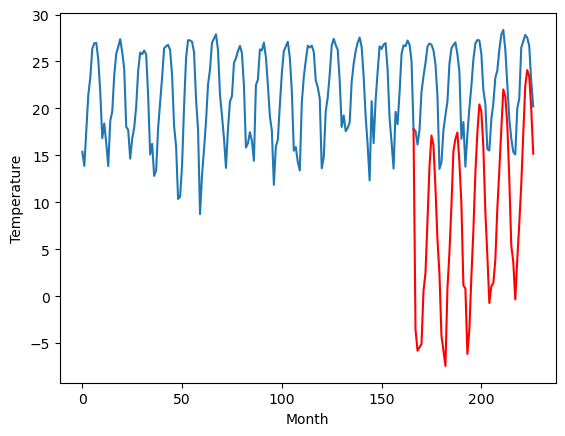

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		6.94		0.19
6.81		4.67		-2.14
6.62		5.04		-1.58
6.88		5.38		-1.50
14.68		11.01		-3.67
13.73		12.97		-0.76
17.61		18.52		0.91
21.70		24.27		2.57
23.27		27.59		4.32
22.44		26.53		4.09
20.34		21.99		1.65
15.00		16.52		1.52
11.00		12.85		1.85
4.75		6.27		1.52
4.78		4.67		-0.11
2.86		3.05		0.19
12.19		11.31		-0.88
13.26		15.14		1.88
17.73		20.12		2.39
21.99		25.95		3.96
22.65		27.23		4.58
23.30		27.93		4.63
20.18		24.75		4.57
16.79		20.31		3.52
8.12		11.63		3.51
11.63		11.30		-0.33
3.35		4.32		0.97
5.71		6.95		1.24
10.45		12.55		2.10
14.66		17.48		2.82
20.46		23.62		3.16
23.75		27.92		4.17
23.95		30.91		6.96
22.41		30.15		7.74
20.34		26.37		6.03
14.21		19.48		5.27
9.62		14.80		5.18
7.19		9.75		2.56
7.60		11.54		3.94
9.54		11.87		2.33
11.69		14.30		2.61
13.44		19.78		6.34
18.30		23.90		5.60
21.89		28.26		6.37
23.67		32.50		8.83
25.75		31.78		6.03
22.00		28.78		6.78
15.89		22.97		7.08
8.93		15.

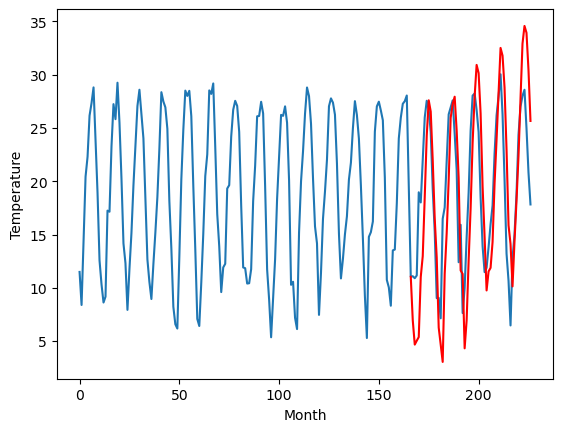

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		3.05		-1.18
2.58		0.78		-1.80
2.82		1.15		-1.67
2.49		1.49		-1.00
9.95		7.12		-2.83
10.61		9.08		-1.53
15.74		14.63		-1.11
20.70		20.38		-0.32
22.56		23.70		1.14
22.31		22.64		0.33
16.53		18.10		1.57
10.80		12.63		1.83
8.19		8.96		0.77
1.91		2.38		0.47
0.99		0.78		-0.21
-2.47		-0.84		1.63
8.49		7.42		-1.07
10.18		11.25		1.07
14.34		16.23		1.89
20.02		22.06		2.04
21.61		23.34		1.73
21.98		24.04		2.06
19.19		20.86		1.67
14.54		16.42		1.88
6.54		7.74		1.20
8.54		7.41		-1.13
0.07		0.43		0.36
0.33		3.06		2.73
6.51		8.66		2.15
12.56		13.59		1.03
17.27		19.73		2.46
21.82		24.03		2.21
25.12		27.02		1.90
22.39		26.26		3.87
18.96		22.48		3.52
12.09		15.59		3.50
5.04		10.91		5.87
2.35		5.86		3.51
3.34		7.65		4.31
3.40		7.98		4.58
7.93		10.41		2.48
10.53		15.89		5.36
16.21		20.01		3.80
20.40		24.37		3.97
22.95		28.61		5.66
25.50		27.89		2.39
20.80		24.89		4.09
12.67		19.08		6.41
6.60		11.98		5.38
3

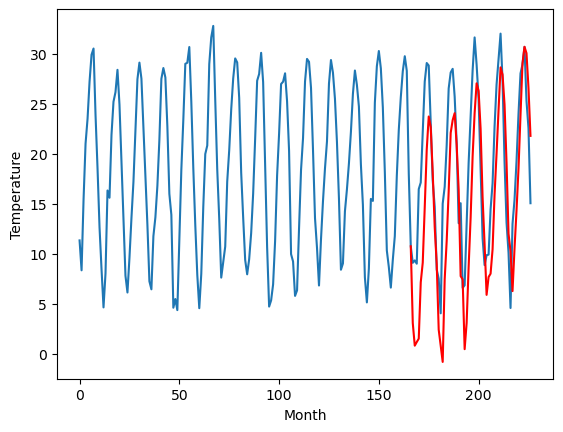

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.87		-0.78
1.87		0.60		-1.27
2.49		0.97		-1.52
2.11		1.31		-0.80
9.99		6.94		-3.05
10.68		8.90		-1.78
16.33		14.45		-1.88
21.04		20.20		-0.84
23.48		23.52		0.04
22.80		22.46		-0.34
16.50		17.92		1.42
10.75		12.45		1.70
7.99		8.78		0.79
1.42		2.20		0.78
0.82		0.60		-0.22
-3.07		-1.02		2.05
7.85		7.24		-0.61
10.03		11.07		1.04
13.56		16.05		2.49
20.41		21.88		1.47
21.90		23.16		1.26
22.27		23.86		1.59
18.84		20.68		1.84
13.97		16.24		2.27
6.13		7.56		1.43
7.87		7.23		-0.64
-1.03		0.25		1.28
-0.41		2.88		3.29
6.51		8.48		1.97
13.20		13.41		0.21
18.03		19.55		1.52
22.70		23.85		1.15
26.12		26.84		0.72
23.28		26.08		2.80
19.19		22.30		3.11
12.04		15.41		3.37
4.95		10.73		5.78
1.98		5.68		3.70
2.75		7.47		4.72
2.98		7.80		4.82
7.83		10.23		2.40
10.48		15.71		5.23
16.64		19.83		3.19
21.75		24.19		2.44
24.83		28.43		3.60
26.70		27.71		1.01
21.61		24.71		3.10
12.78		18.90		6.12
6.25		11.80		5.5

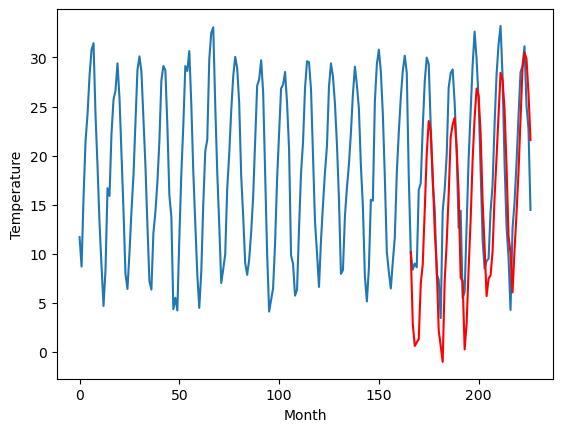

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.25		-1.87
3.48		0.98		-2.50
2.75		1.35		-1.40
1.99		1.69		-0.30
9.55		7.32		-2.23
12.52		9.28		-3.24
19.09		14.83		-4.26
22.42		20.58		-1.84
25.25		23.90		-1.35
24.63		22.84		-1.79
16.90		18.30		1.40
12.94		12.83		-0.11
9.06		9.16		0.10
2.08		2.58		0.50
0.98		0.98		-0.00
-0.59		-0.64		-0.05
8.66		7.62		-1.04
10.89		11.45		0.56
16.38		16.43		0.05
21.34		22.26		0.92
21.08		23.54		2.46
21.40		24.24		2.84
20.71		21.06		0.35
15.01		16.62		1.61
8.07		7.94		-0.13
8.48		7.61		-0.87
1.11		0.63		-0.48
0.91		3.26		2.35
8.23		8.86		0.63
15.74		13.79		-1.95
21.43		19.93		-1.50
23.80		24.23		0.43
25.70		27.22		1.52
22.40		26.46		4.06
19.50		22.68		3.18
12.69		15.79		3.10
4.84		11.11		6.27
3.24		6.06		2.82
3.61		7.85		4.24
3.78		8.18		4.40
8.85		10.61		1.76
13.07		16.09		3.02
17.99		20.21		2.22
24.47		24.57		0.10
25.93		28.81		2.88
26.02		28.09		2.07
22.54		25.09		2.55
14.01		19.28		5.27
7.30		12.18

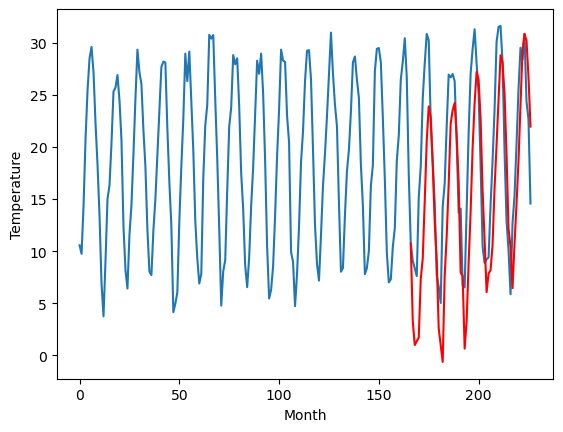

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		2.12		1.26
0.51		-0.15		-0.66
0.34		0.22		-0.12
0.81		0.56		-0.25
6.42		6.19		-0.23
7.69		8.15		0.46
10.48		13.70		3.22
15.07		19.45		4.38
18.11		22.77		4.66
16.91		21.71		4.80
13.11		17.17		4.06
9.29		11.70		2.41
4.98		8.03		3.05
-2.27		1.45		3.72
-2.04		-0.15		1.89
-1.37		-1.77		-0.40
5.03		6.49		1.46
7.76		10.32		2.56
11.21		15.30		4.09
15.23		21.13		5.90
16.97		22.41		5.44
17.10		23.11		6.01
13.13		19.93		6.80
9.33		15.49		6.16
1.17		6.81		5.64
3.08		6.48		3.40
-2.98		-0.50		2.48
1.30		2.13		0.83
4.86		7.73		2.87
7.52		12.66		5.14
13.50		18.80		5.30
16.71		23.10		6.39
17.98		26.09		8.11
16.46		25.33		8.87
13.37		21.55		8.18
6.50		14.66		8.16
3.80		9.98		6.18
-2.15		4.93		7.08
0.87		6.72		5.85
4.29		7.05		2.76
4.77		9.48		4.71
7.88		14.96		7.08
10.50		19.08		8.58
14.14		23.44		9.30
18.01		27.68		9.67
17.45		26.96		9.51
13.61		23.96		10.35
8.17		18.15		9.98
2.44		11.05		8.61
0.23		9.3

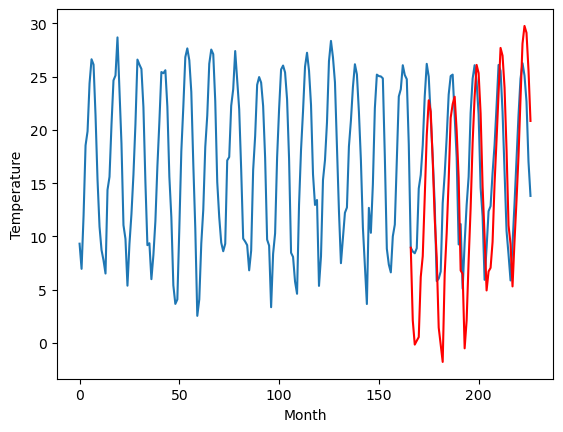

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.88		-1.13
1.20		-1.39		-2.59
-0.45		-1.02		-0.57
0.12		-0.68		-0.80
7.05		4.95		-2.10
8.63		6.91		-1.72
12.73		12.46		-0.27
19.08		18.21		-0.87
21.62		21.53		-0.09
19.63		20.47		0.84
16.05		15.93		-0.12
9.12		10.46		1.34
6.57		6.79		0.22
0.04		0.21		0.17
-1.63		-1.39		0.24
-5.24		-3.01		2.23
7.03		5.25		-1.78
8.93		9.08		0.15
12.97		14.06		1.09
19.27		19.89		0.62
20.56		21.17		0.61
21.08		21.87		0.79
18.04		18.69		0.65
12.27		14.25		1.98
4.33		5.57		1.24
5.79		5.24		-0.55
-3.28		-1.74		1.54
-1.22		0.89		2.11
5.44		6.49		1.05
9.30		11.42		2.12
14.97		17.56		2.59
20.29		21.86		1.57
23.99		24.85		0.86
20.47		24.09		3.62
16.88		20.31		3.43
10.51		13.42		2.91
3.96		8.74		4.78
-0.89		3.69		4.58
0.76		5.48		4.72
2.90		5.81		2.91
4.62		8.24		3.62
10.24		13.72		3.48
15.02		17.84		2.82
19.10		22.20		3.10
21.06		26.44		5.38
20.87		25.72		4.85
16.93		22.72		5.79
11.03		16.91		5.88
5.13		9.81		4.6

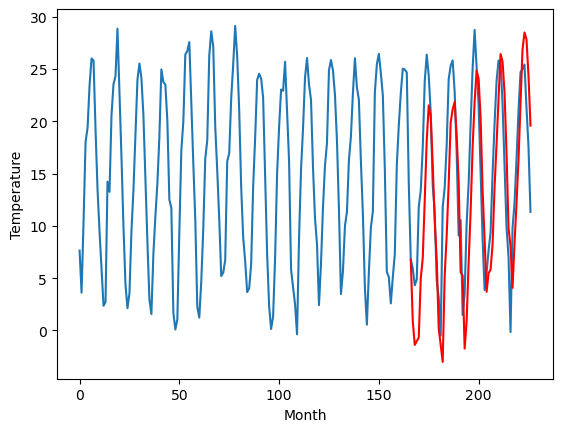

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.80		1.84
-3.46		-3.07		0.39
-4.39		-2.70		1.69
-5.22		-2.36		2.86
1.60		3.27		1.67
4.59		5.23		0.64
10.17		10.78		0.61
17.46		16.53		-0.93
19.50		19.85		0.35
17.30		18.79		1.49
13.54		14.25		0.71
6.70		8.78		2.08
2.86		5.11		2.25
-4.65		-1.47		3.18
-6.23		-3.07		3.16
-9.59		-4.69		4.90
2.38		3.57		1.19
6.03		7.40		1.37
10.44		12.38		1.94
17.68		18.21		0.53
18.25		19.49		1.24
19.11		20.19		1.08
15.62		17.01		1.39
10.27		12.57		2.30
-0.59		3.89		4.48
-0.27		3.56		3.83
-9.11		-3.42		5.69
-6.09		-0.79		5.30
1.38		4.81		3.43
5.16		9.74		4.58
13.66		15.88		2.22
18.14		20.18		2.04
20.08		23.17		3.09
17.85		22.41		4.56
13.94		18.63		4.69
6.45		11.74		5.29
0.66		7.06		6.40
-5.12		2.01		7.13
-3.16		3.80		6.96
-1.57		4.13		5.70
-0.30		6.56		6.86
6.20		12.04		5.84
11.91		16.16		4.25
15.79		20.52		4.73
18.52		24.76		6.24
17.36		24.04		6.68
14.27		21.04		6.77
8.13		15.23		7.10
1.06		8.13		7.07
-0

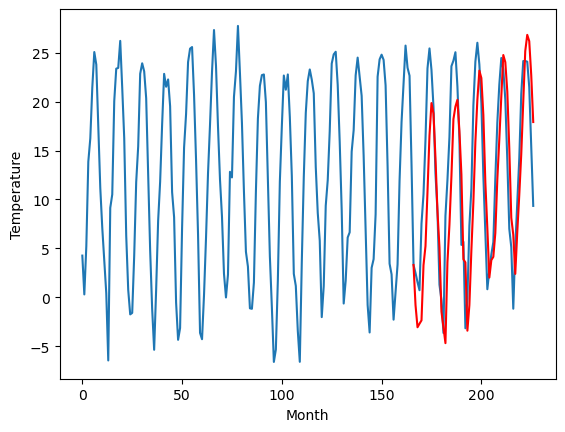

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.18		0.70
-5.20		-6.45		-1.25
-7.64		-6.08		1.56
-7.89		-5.74		2.15
-0.29		-0.11		0.18
2.82		1.85		-0.97
8.70		7.40		-1.30
16.43		13.15		-3.28
17.64		16.47		-1.17
15.04		15.41		0.37
11.14		10.87		-0.27
3.80		5.40		1.60
1.16		1.73		0.57
-6.72		-4.85		1.87
-8.75		-6.45		2.30
-13.19		-8.07		5.12
0.67		0.19		-0.48
4.38		4.02		-0.36
9.16		9.00		-0.16
16.55		14.83		-1.72
16.26		16.11		-0.15
16.54		16.81		0.27
13.43		13.63		0.20
7.97		9.19		1.22
-2.34		0.51		2.85
-2.59		0.18		2.77
-12.07		-6.80		5.27
-9.24		-4.17		5.07
-1.03		1.43		2.46
3.09		6.36		3.27
11.62		12.50		0.88
16.23		16.80		0.57
17.05		19.79		2.74
15.75		19.03		3.28
11.61		15.25		3.64
4.14		8.36		4.22
-1.40		3.68		5.08
-8.13		-1.37		6.76
-5.89		0.42		6.31
-4.70		0.75		5.45
-2.16		3.18		5.34
5.17		8.66		3.49
10.93		12.78		1.85
15.24		17.14		1.90
16.77		21.38		4.61
15.51		20.66		5.15
12.47		17.66		5.19
6.06		11.85		5.79
-1.03		4.

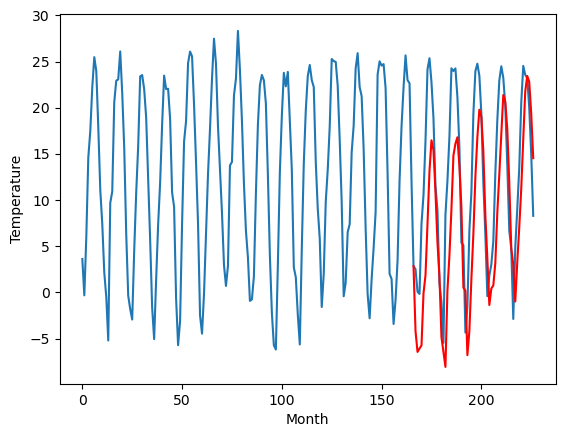

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-4.82		1.97
-7.57		-7.09		0.48
-8.77		-6.72		2.05
-9.58		-6.38		3.20
-3.42		-0.75		2.67
-2.04		1.21		3.25
4.70		6.76		2.06
11.19		12.51		1.32
14.63		15.83		1.20
12.22		14.77		2.55
8.23		10.23		2.00
2.07		4.76		2.69
-1.16		1.09		2.25
-8.72		-5.49		3.23
-10.64		-7.09		3.55
-12.88		-8.71		4.17
-2.99		-0.45		2.54
0.81		3.38		2.57
5.34		8.36		3.02
12.23		14.19		1.96
12.39		15.47		3.08
13.59		16.17		2.58
9.30		12.99		3.69
5.77		8.55		2.78
-4.63		-0.13		4.50
-5.49		-0.46		5.03
-14.32		-7.44		6.88
-10.76		-4.81		5.95
-4.79		0.79		5.58
-0.79		5.72		6.51
7.79		11.86		4.07
11.06		16.16		5.10
13.66		19.15		5.49
12.59		18.39		5.80
8.54		14.61		6.07
1.68		7.72		6.04
-2.40		3.04		5.44
-9.11		-2.01		7.10
-7.48		-0.22		7.26
-7.34		0.11		7.45
-6.46		2.54		9.00
2.01		8.02		6.01
5.70		12.14		6.44
10.01		16.50		6.49
13.10		20.74		7.64
11.77		20.02		8.25
9.43		17.02		7.59
4.17		11.21		7.04
-3.22		4.11		7.3

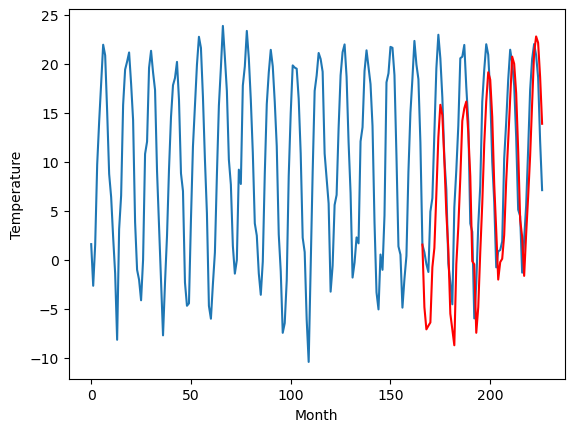

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.818174
1                 1   -2.38  -3.548175
2                 2    6.75   6.941824
3                 3    4.23   3.051825
4                 4    3.65   2.871825
5                 5    5.12   3.251825
6                 6    0.86   2.121825
7                 7    2.01   0.881825
8                 8   -2.64  -0.798175
9                 9   -4.88  -4.178175
10               10   -6.79  -4.818175


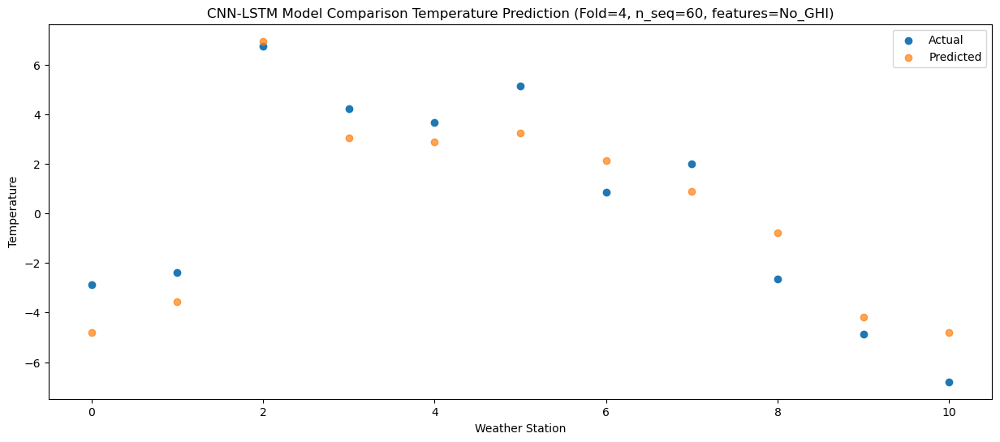

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -7.087421
1                 1   -2.56  -5.817422
2                 2    6.81   4.672578
3                 3    2.58   0.782578
4                 4    1.87   0.602578
5                 5    3.48   0.982578
6                 6    0.51  -0.147420
7                 7    1.20  -1.387422
8                 8   -3.46  -3.067420
9                 9   -5.20  -6.447422
10               10   -7.57  -7.087422


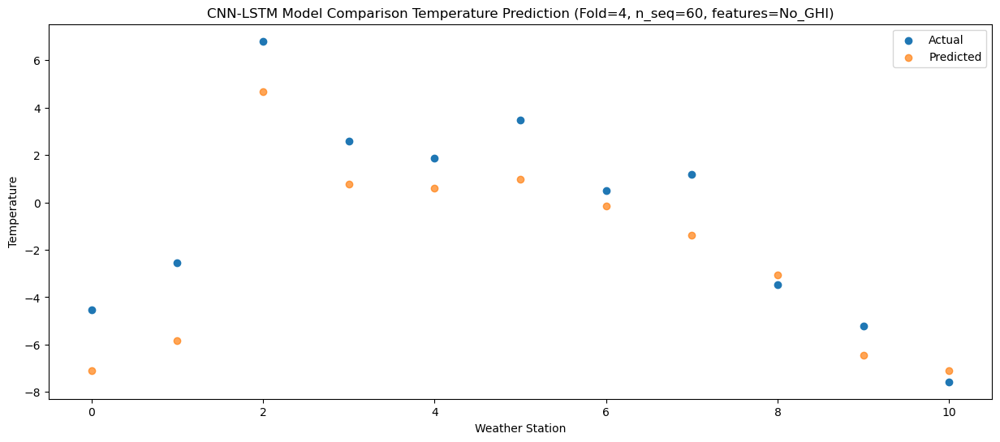

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -6.722819
1                 1   -4.02  -5.452818
2                 2    6.62   5.037181
3                 3    2.82   1.147182
4                 4    2.49   0.967182
5                 5    2.75   1.347182
6                 6    0.34   0.217183
7                 7   -0.45  -1.022818
8                 8   -4.39  -2.702817
9                 9   -7.64  -6.082819
10               10   -8.77  -6.722818


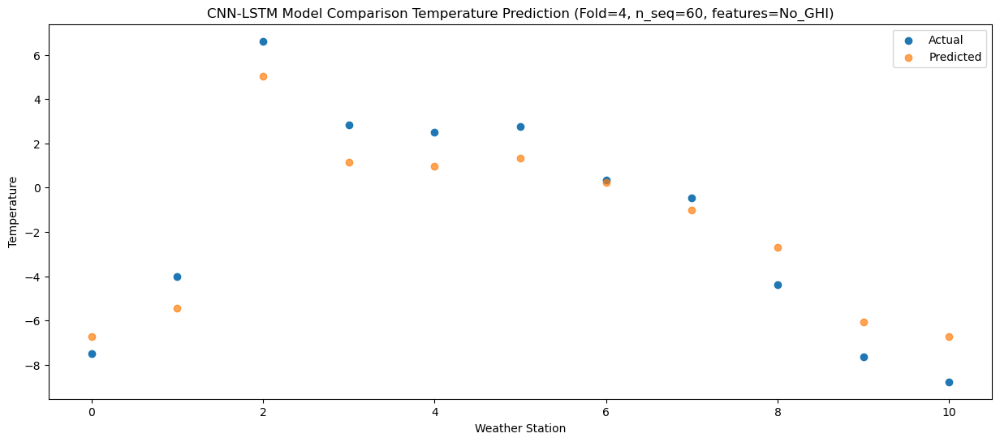

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -6.382341
1                 1   -2.47  -5.112338
2                 2    6.88   5.377659
3                 3    2.49   1.487660
4                 4    2.11   1.307660
5                 5    1.99   1.687660
6                 6    0.81   0.557664
7                 7    0.12  -0.682340
8                 8   -5.22  -2.362338
9                 9   -7.89  -5.742339
10               10   -9.58  -6.382340


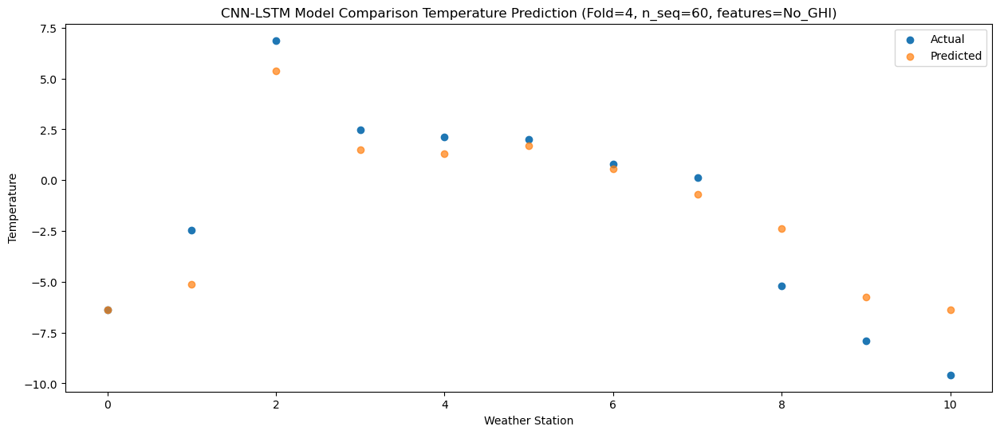

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16  -0.746127
1                 1    1.60   0.523876
2                 2   14.68  11.013871
3                 3    9.95   7.123874
4                 4    9.99   6.943874
5                 5    9.55   7.323874
6                 6    6.42   6.193877
7                 7    7.05   4.953874
8                 8    1.60   3.273873
9                 9   -0.29  -0.106125
10               10   -3.42  -0.746128


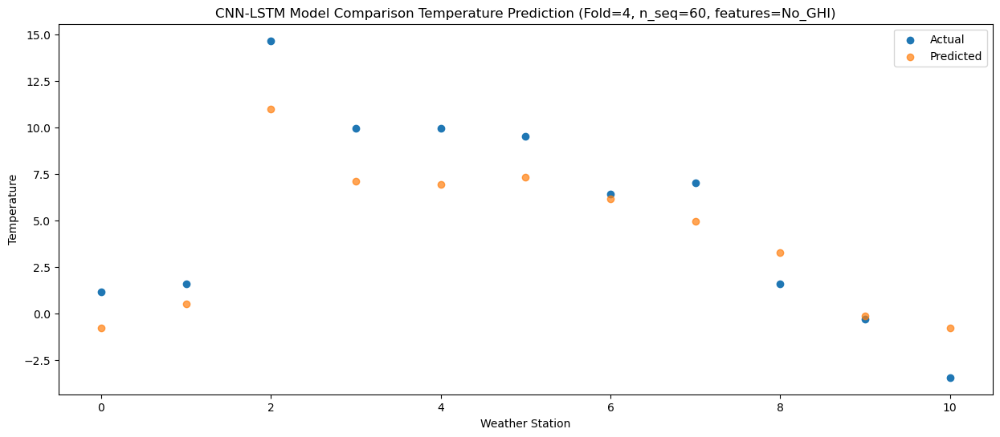

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.212384
1                 1    3.28   2.482387
2                 2   13.73  12.972383
3                 3   10.61   9.082386
4                 4   10.68   8.902386
5                 5   12.52   9.282386
6                 6    7.69   8.152389
7                 7    8.63   6.912386
8                 8    4.59   5.232385
9                 9    2.82   1.852387
10               10   -2.04   1.212384


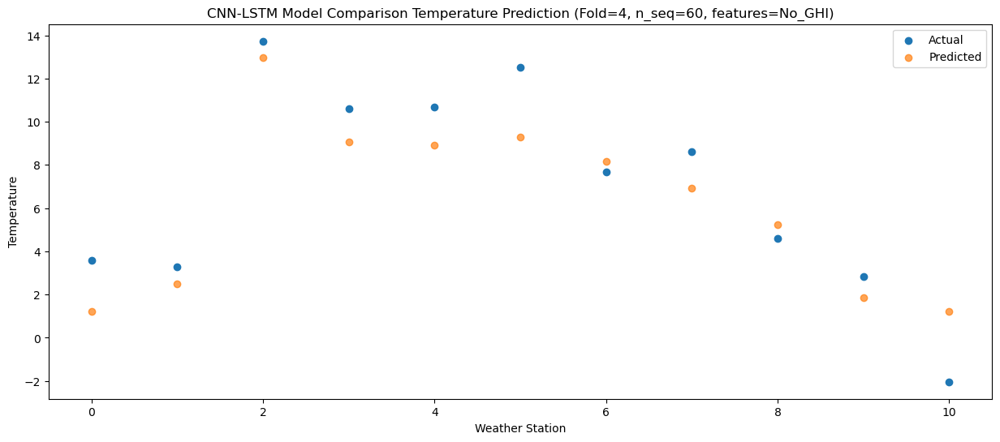

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   6.757927
1                 1    4.68   8.027930
2                 2   17.61  18.517925
3                 3   15.74  14.627928
4                 4   16.33  14.447928
5                 5   19.09  14.827928
6                 6   10.48  13.697931
7                 7   12.73  12.457928
8                 8   10.17  10.777928
9                 9    8.70   7.397929
10               10    4.70   6.757926


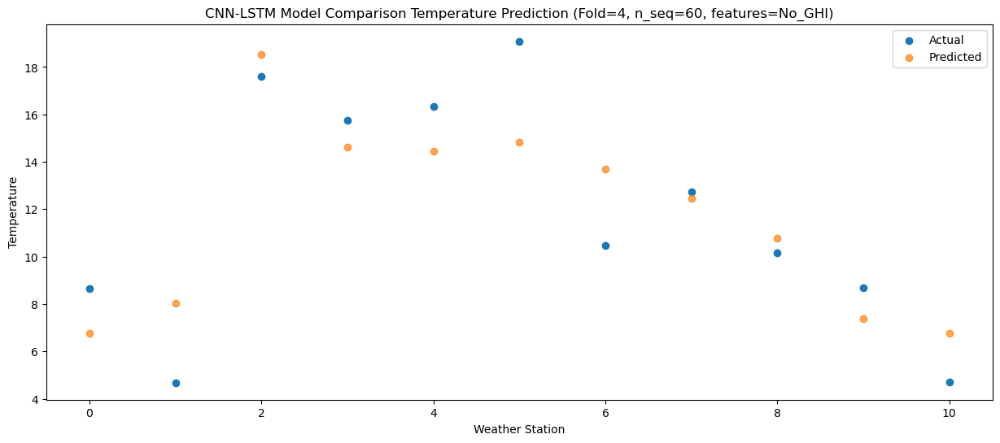

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  12.513812
1                 1    6.44  13.783815
2                 2   21.70  24.273810
3                 3   20.70  20.383813
4                 4   21.04  20.203813
5                 5   22.42  20.583813
6                 6   15.07  19.453817
7                 7   19.08  18.213813
8                 8   17.46  16.533813
9                 9   16.43  13.153814
10               10   11.19  12.513811


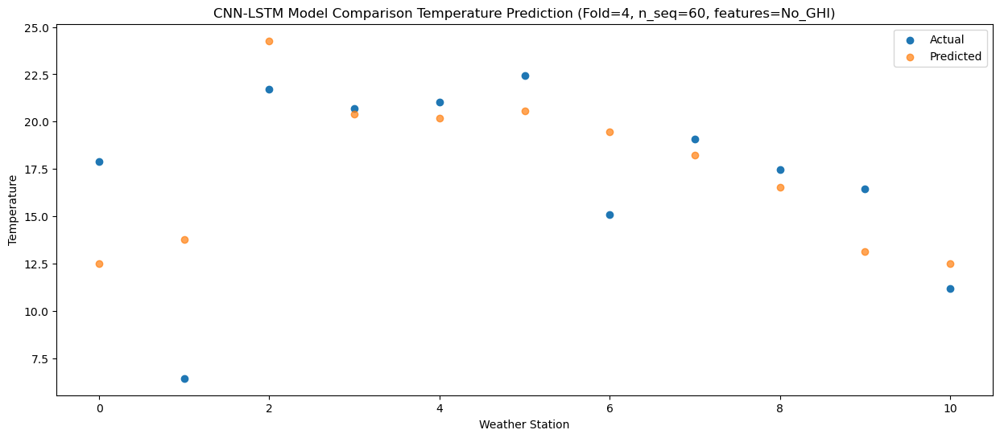

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  15.831055
1                 1    6.76  17.101060
2                 2   23.27  27.591055
3                 3   22.56  23.701056
4                 4   23.48  23.521056
5                 5   25.25  23.901056
6                 6   18.11  22.771061
7                 7   21.62  21.531056
8                 8   19.50  19.851057
9                 9   17.64  16.471059
10               10   14.63  15.831054


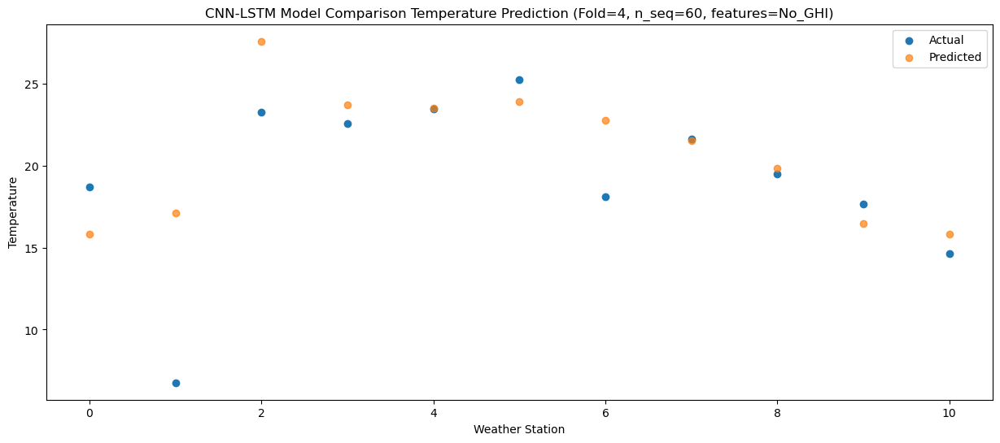

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  14.771469
1                 1    6.61  16.041475
2                 2   22.44  26.531470
3                 3   22.31  22.641470
4                 4   22.80  22.461470
5                 5   24.63  22.841470
6                 6   16.91  21.711476
7                 7   19.63  20.471470
8                 8   17.30  18.791471
9                 9   15.04  15.411473
10               10   12.22  14.771468


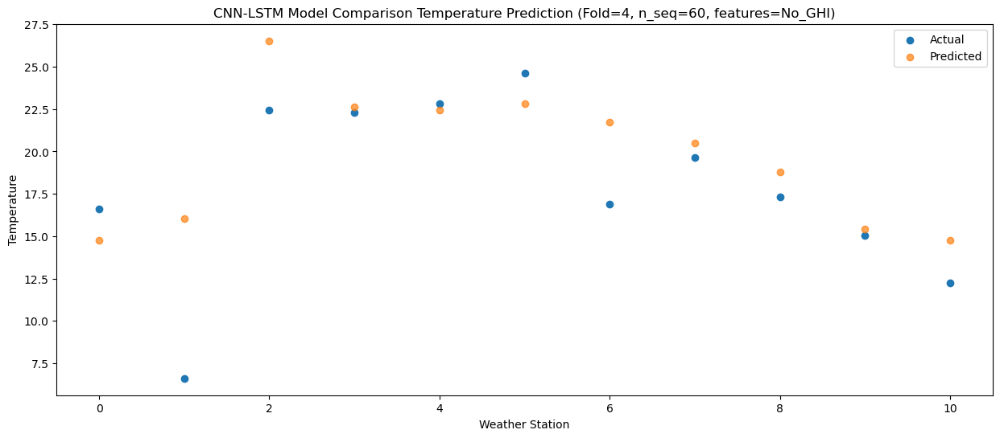

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78  10.227145
1                 1    6.03  11.497151
2                 2   20.34  21.987147
3                 3   16.53  18.097146
4                 4   16.50  17.917146
5                 5   16.90  18.297146
6                 6   13.11  17.167152
7                 7   16.05  15.927146
8                 8   13.54  14.247147
9                 9   11.14  10.867149
10               10    8.23  10.227144


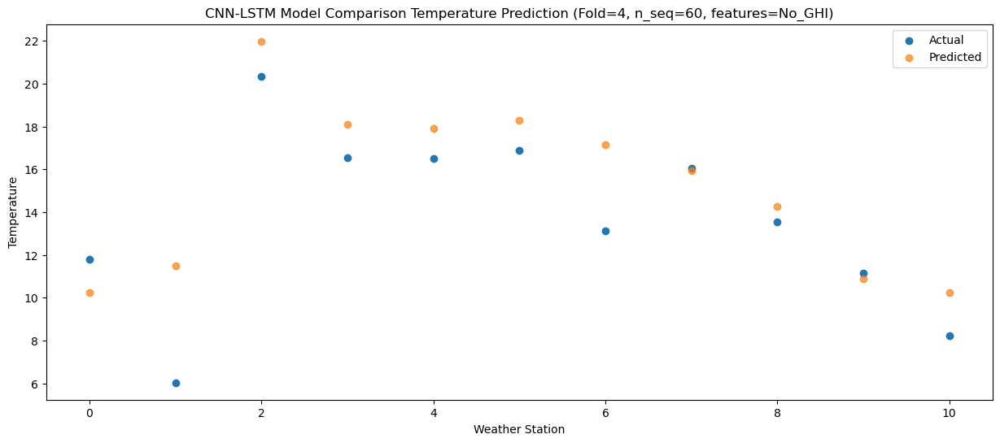

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   4.758272
1                 1    4.53   6.028278
2                 2   15.00  16.518274
3                 3   10.80  12.628273
4                 4   10.75  12.448273
5                 5   12.94  12.828273
6                 6    9.29  11.698279
7                 7    9.12  10.458273
8                 8    6.70   8.778274
9                 9    3.80   5.398276
10               10    2.07   4.758271


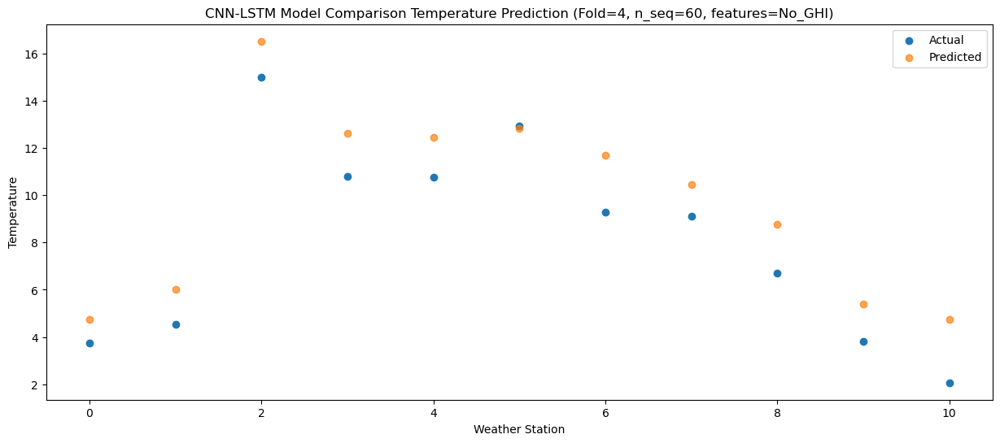

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54   1.089997
1                 1    1.14   2.360004
2                 2   11.00  12.849999
3                 3    8.19   8.959998
4                 4    7.99   8.779997
5                 5    9.06   9.159998
6                 6    4.98   8.030005
7                 7    6.57   6.789998
8                 8    2.86   5.109999
9                 9    1.16   1.730002
10               10   -1.16   1.089996


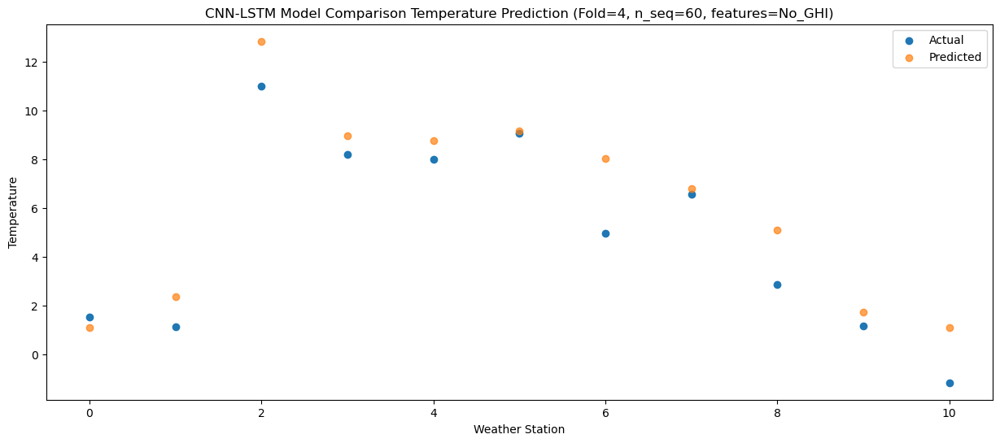

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -5.488681
1                 1   -6.61  -4.218674
2                 2    4.75   6.271321
3                 3    1.91   2.381320
4                 4    1.42   2.201319
5                 5    2.08   2.581320
6                 6   -2.27   1.451327
7                 7    0.04   0.211320
8                 8   -4.65  -1.468678
9                 9   -6.72  -4.848676
10               10   -8.72  -5.488682


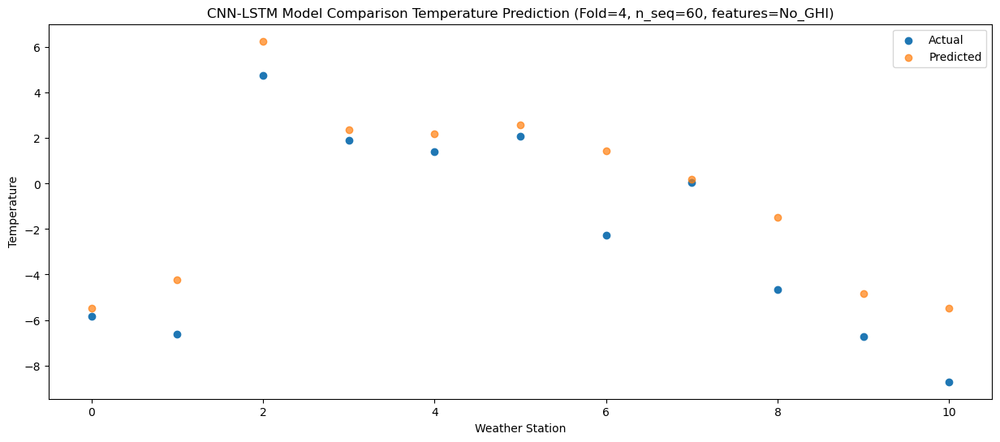

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -7.090192
1                 1   -5.91  -5.820185
2                 2    4.78   4.669811
3                 3    0.99   0.779809
4                 4    0.82   0.599808
5                 5    0.98   0.979809
6                 6   -2.04  -0.150183
7                 7   -1.63  -1.390192
8                 8   -6.23  -3.070189
9                 9   -8.75  -6.450187
10               10  -10.64  -7.090194


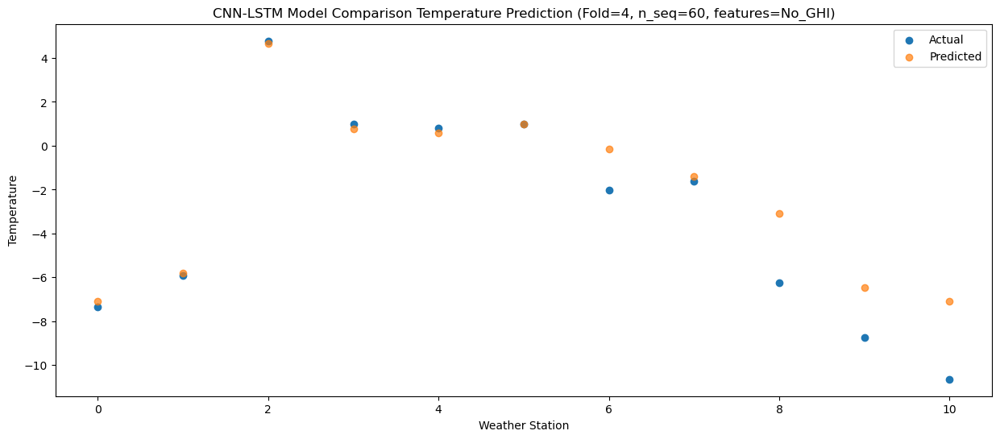

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48  -8.711781
1                 1   -2.48  -7.441776
2                 2    2.86   3.048220
3                 3   -2.47  -0.841781
4                 4   -3.07  -1.021782
5                 5   -0.59  -0.641782
6                 6   -1.37  -1.771773
7                 7   -5.24  -3.011781
8                 8   -9.59  -4.691777
9                 9  -13.19  -8.071776
10               10  -12.88  -8.711782


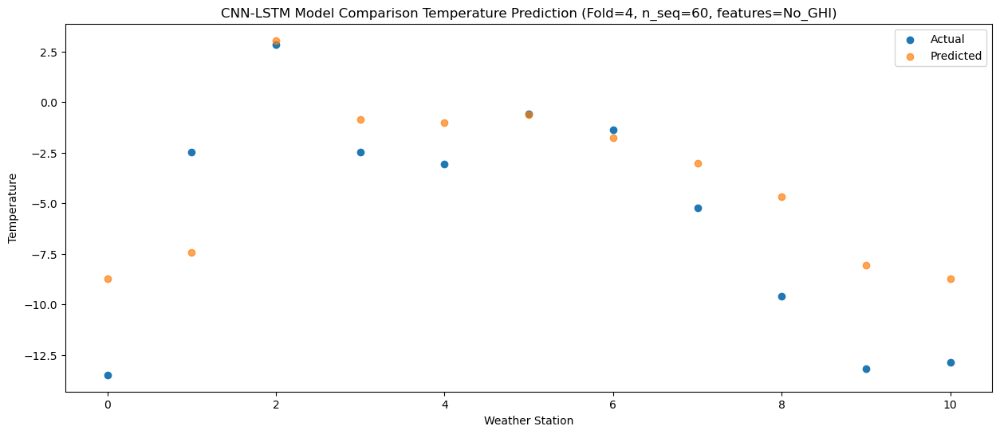

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -0.446100
1                 1   -0.88   0.823903
2                 2   12.19  11.313899
3                 3    8.49   7.423900
4                 4    7.85   7.243897
5                 5    8.66   7.623897
6                 6    5.03   6.493905
7                 7    7.03   5.253898
8                 8    2.38   3.573901
9                 9    0.67   0.193905
10               10   -2.99  -0.446104


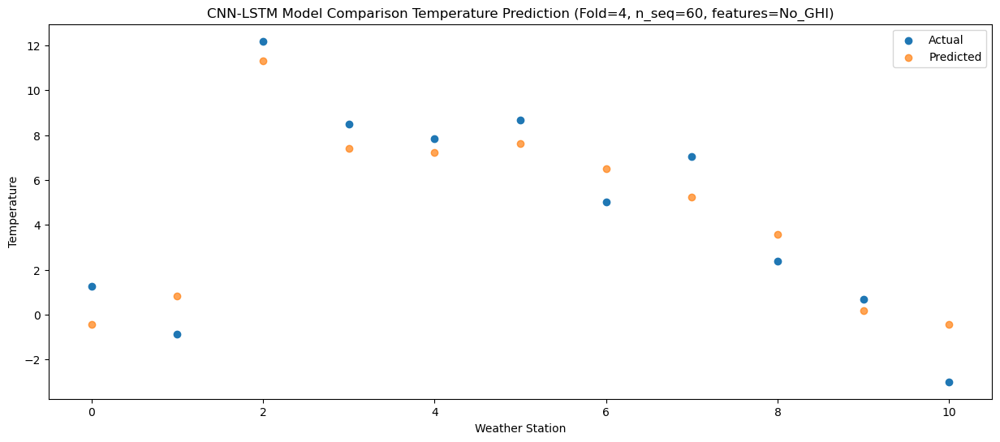

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   3.380109
1                 1    0.56   4.650112
2                 2   13.26  15.140108
3                 3   10.18  11.250109
4                 4   10.03  11.070106
5                 5   10.89  11.450106
6                 6    7.76  10.320114
7                 7    8.93   9.080107
8                 8    6.03   7.400110
9                 9    4.38   4.020114
10               10    0.81   3.380105


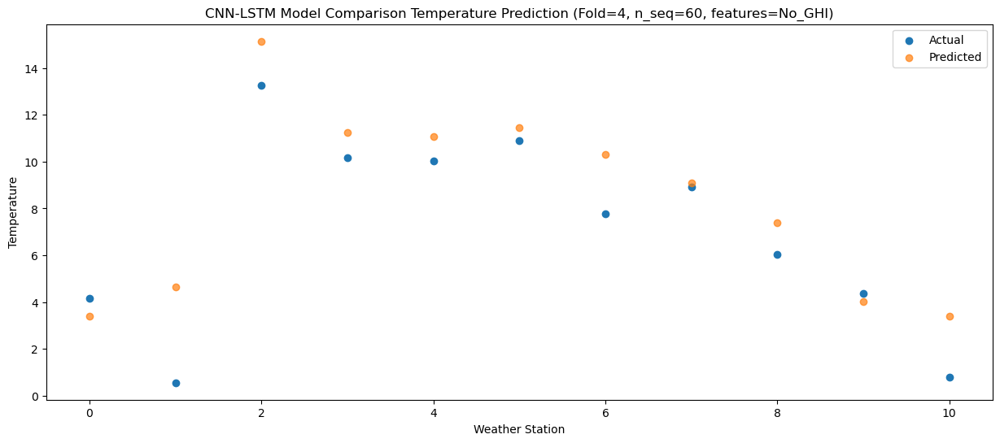

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   8.361555
1                 1    4.60   9.631558
2                 2   17.73  20.121554
3                 3   14.34  16.231555
4                 4   13.56  16.051552
5                 5   16.38  16.431552
6                 6   11.21  15.301560
7                 7   12.97  14.061553
8                 8   10.44  12.381556
9                 9    9.16   9.001560
10               10    5.34   8.361551


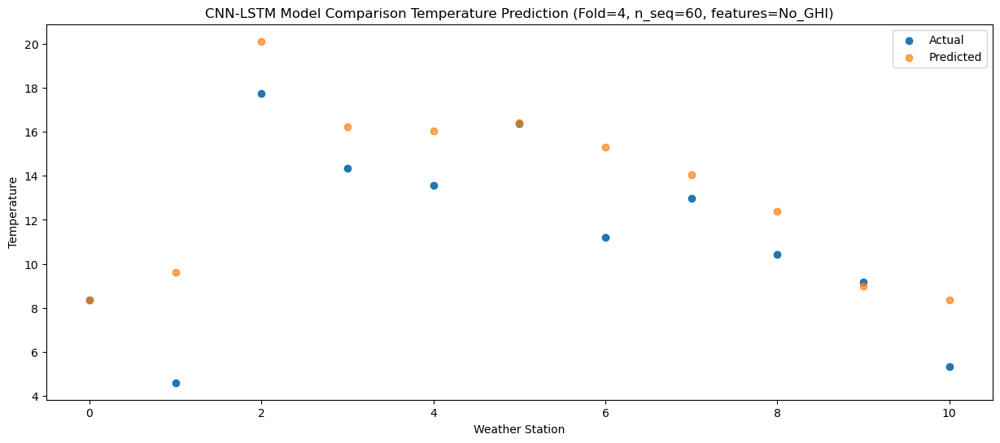

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  14.190510
1                 1    6.23  15.460511
2                 2   21.99  25.950507
3                 3   20.02  22.060508
4                 4   20.41  21.880505
5                 5   21.34  22.260505
6                 6   15.23  21.130513
7                 7   19.27  19.890508
8                 8   17.68  18.210511
9                 9   16.55  14.830515
10               10   12.23  14.190506


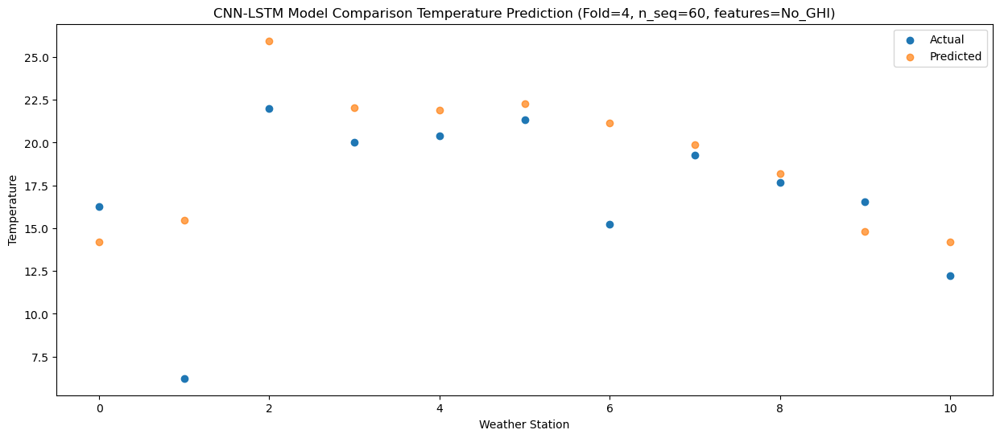

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  15.470647
1                 1    6.60  16.740648
2                 2   22.65  27.230644
3                 3   21.61  23.340645
4                 4   21.90  23.160642
5                 5   21.08  23.540642
6                 6   16.97  22.410650
7                 7   20.56  21.170645
8                 8   18.25  19.490648
9                 9   16.26  16.110652
10               10   12.39  15.470643


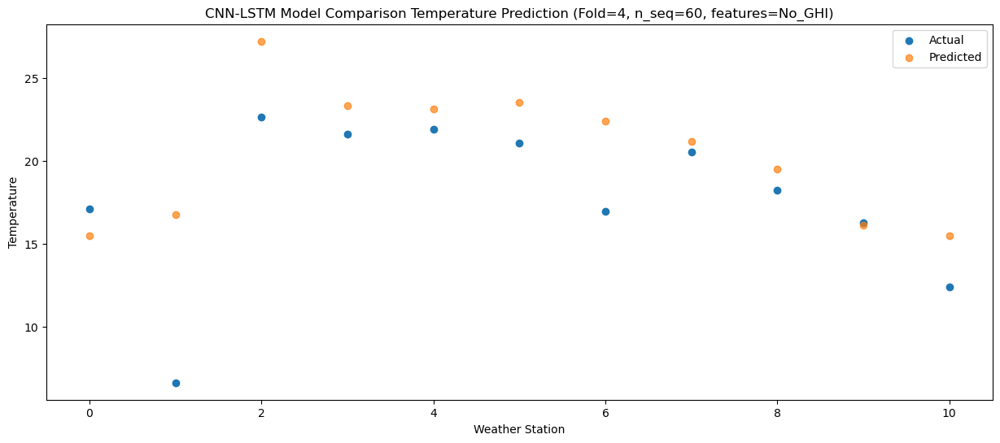

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  16.165953
1                 1    6.88  17.435953
2                 2   23.30  27.925950
3                 3   21.98  24.035951
4                 4   22.27  23.855951
5                 5   21.40  24.235948
6                 6   17.10  23.105957
7                 7   21.08  21.865951
8                 8   19.11  20.185955
9                 9   16.54  16.805958
10               10   13.59  16.165950


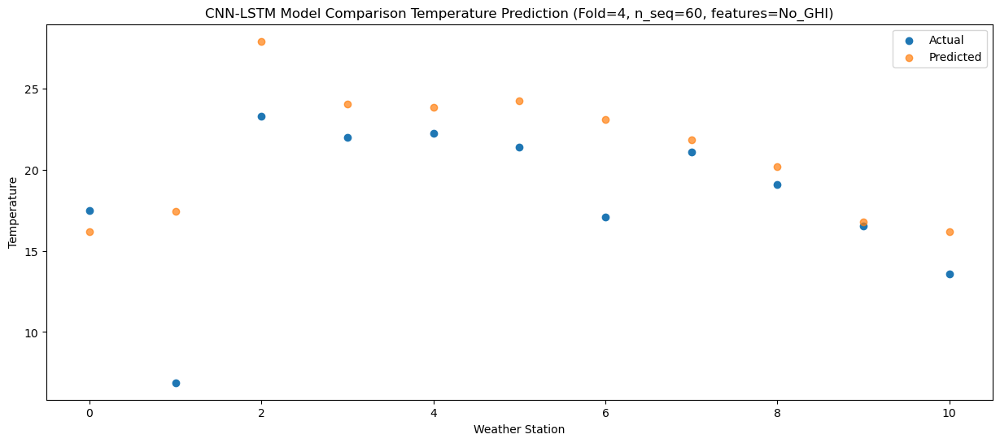

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  12.992521
1                 1    5.59  14.262520
2                 2   20.18  24.752518
3                 3   19.19  20.862520
4                 4   18.84  20.682519
5                 5   20.71  21.062516
6                 6   13.13  19.932524
7                 7   18.04  18.692520
8                 8   15.62  17.012523
9                 9   13.43  13.632527
10               10    9.30  12.992518


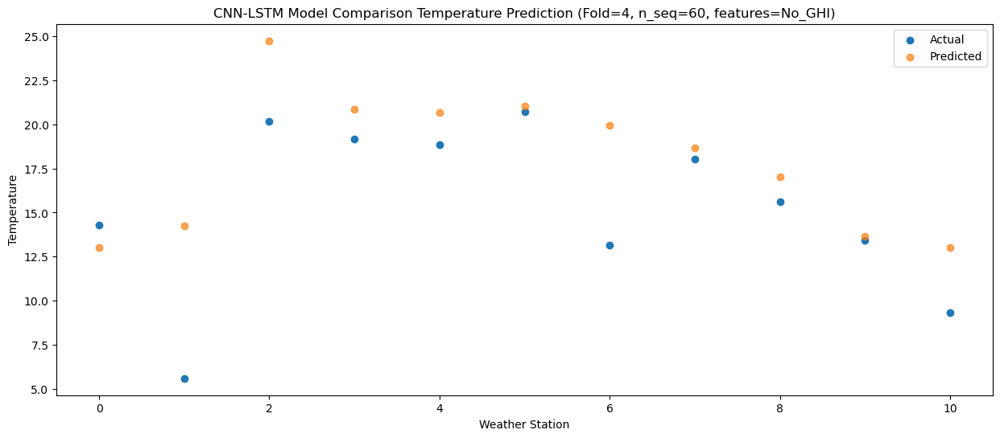

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   8.545182
1                 1    3.75   9.815179
2                 2   16.79  20.305177
3                 3   14.54  16.415179
4                 4   13.97  16.235178
5                 5   15.01  16.615175
6                 6    9.33  15.485183
7                 7   12.27  14.245179
8                 8   10.27  12.565182
9                 9    7.97   9.185187
10               10    5.77   8.545177


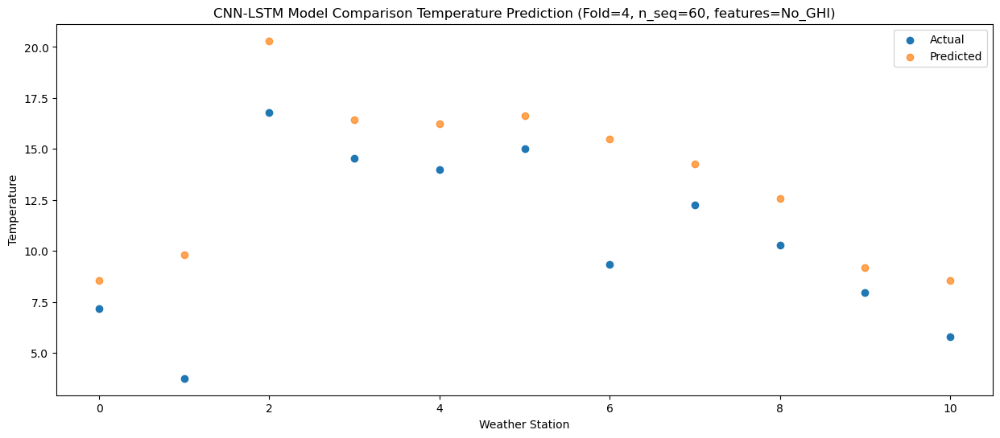

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10  -0.133678
1                 1   -3.41   1.136317
2                 2    8.12  11.626317
3                 3    6.54   7.736318
4                 4    6.13   7.556317
5                 5    8.07   7.936315
6                 6    1.17   6.806322
7                 7    4.33   5.566318
8                 8   -0.59   3.886321
9                 9   -2.34   0.506327
10               10   -4.63  -0.133684


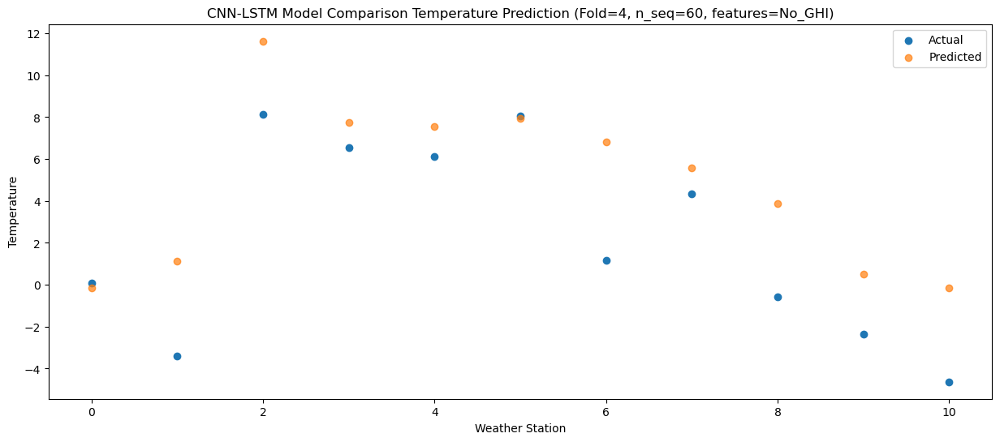

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.456964
1                 1   -1.61   0.813030
2                 2   11.63  11.303029
3                 3    8.54   7.413032
4                 4    7.87   7.233030
5                 5    8.48   7.613027
6                 6    3.08   6.483035
7                 7    5.79   5.243030
8                 8   -0.27   3.563034
9                 9   -2.59   0.183039
10               10   -5.49  -0.456971


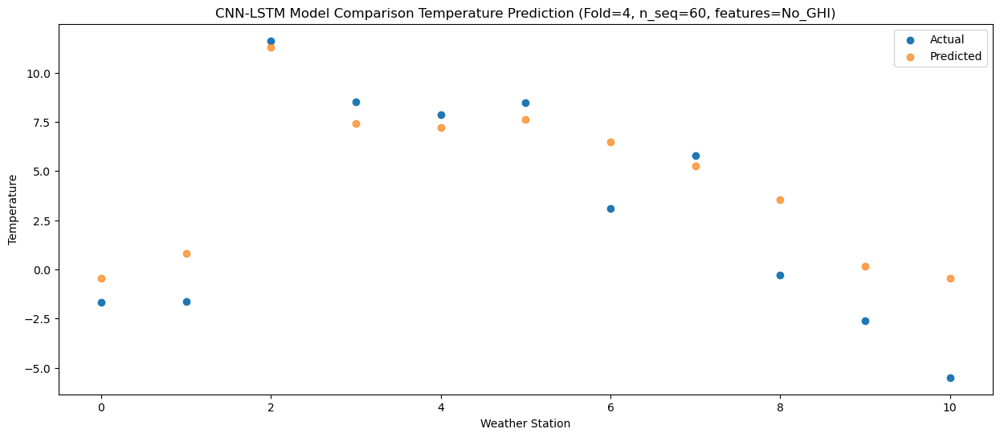

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07  -7.437121
1                 1   -6.37  -6.167126
2                 2    3.35   4.322872
3                 3    0.07   0.432875
4                 4   -1.03   0.252873
5                 5    1.11   0.632871
6                 6   -2.98  -0.497122
7                 7   -3.28  -1.737126
8                 8   -9.11  -3.417123
9                 9  -12.07  -6.797118
10               10  -14.32  -7.437128


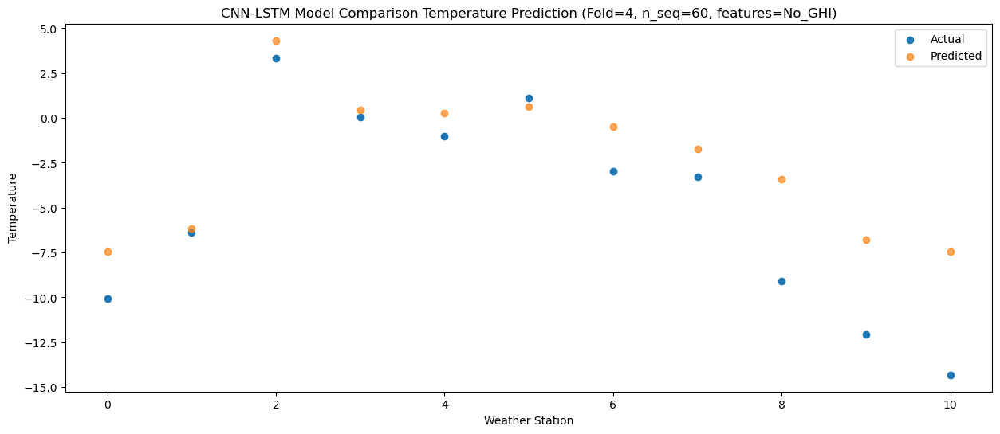

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -4.814127
1                 1   -2.94  -3.544132
2                 2    5.71   6.945866
3                 3    0.33   3.055869
4                 4   -0.41   2.875867
5                 5    0.91   3.255865
6                 6    1.30   2.125872
7                 7   -1.22   0.885867
8                 8   -6.09  -0.794129
9                 9   -9.24  -4.174124
10               10  -10.76  -4.814134


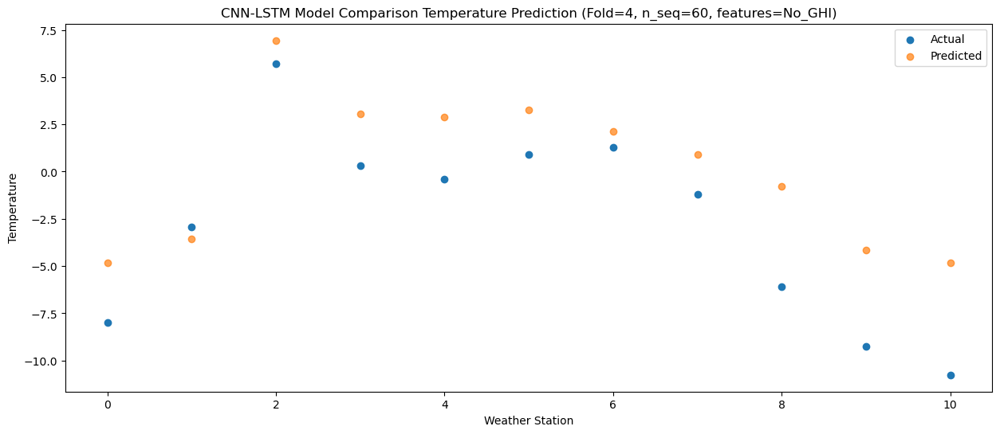

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29   0.792448
1                 1   -0.12   2.062442
2                 2   10.45  12.552437
3                 3    6.51   8.662444
4                 4    6.51   8.482441
5                 5    8.23   8.862439
6                 6    4.86   7.732446
7                 7    5.44   6.492442
8                 8    1.38   4.812445
9                 9   -1.03   1.432451
10               10   -4.79   0.792436


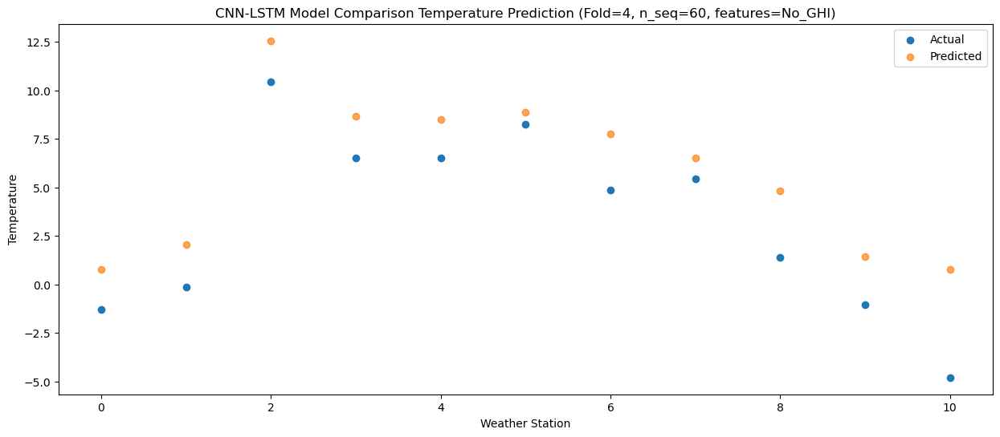

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   5.715032
1                 1    2.22   6.985026
2                 2   14.66  17.475021
3                 3   12.56  13.585028
4                 4   13.20  13.405025
5                 5   15.74  13.785023
6                 6    7.52  12.655030
7                 7    9.30  11.415026
8                 8    5.16   9.735029
9                 9    3.09   6.355035
10               10   -0.79   5.715020


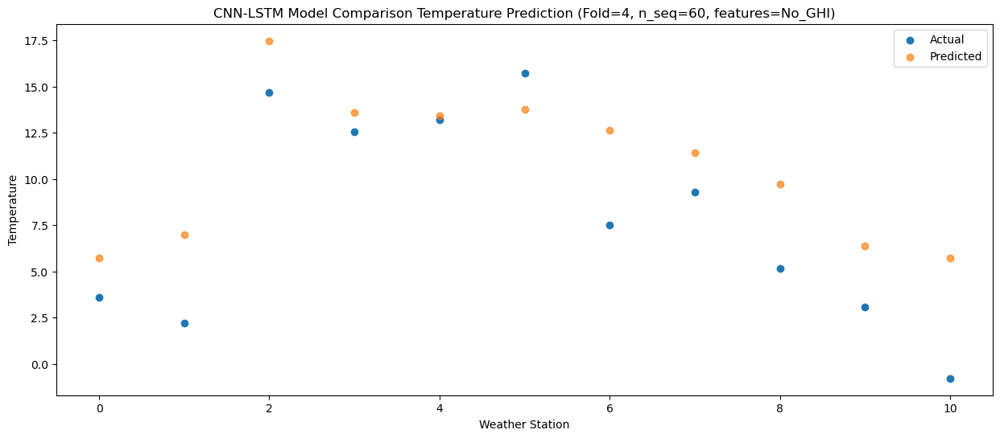

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53  11.858784
1                 1    5.04  13.128776
2                 2   20.46  23.618773
3                 3   17.27  19.728780
4                 4   18.03  19.548777
5                 5   21.43  19.928775
6                 6   13.50  18.798782
7                 7   14.97  17.558778
8                 8   13.66  15.878781
9                 9   11.62  12.498787
10               10    7.79  11.858772


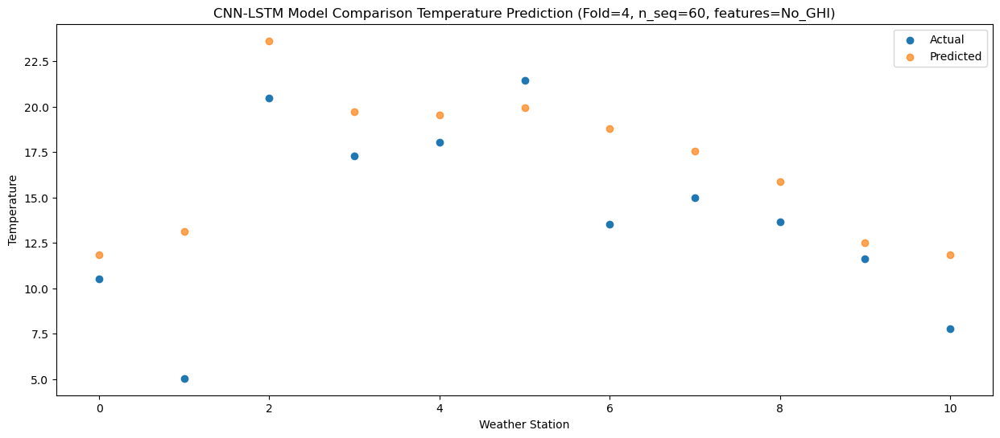

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  16.161035
1                 1    6.76  17.431028
2                 2   23.75  27.921025
3                 3   21.82  24.031031
4                 4   22.70  23.851029
5                 5   23.80  24.231027
6                 6   16.71  23.101034
7                 7   20.29  21.861030
8                 8   18.14  20.181033
9                 9   16.23  16.801036
10               10   11.06  16.161024


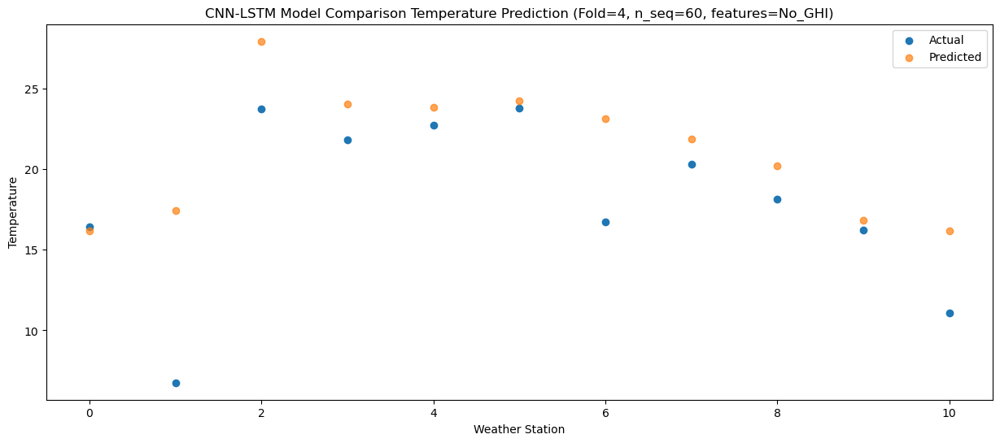

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  19.148931
1                 1    7.13  20.418923
2                 2   23.95  30.908920
3                 3   25.12  27.018929
4                 4   26.12  26.838924
5                 5   25.70  27.218924
6                 6   17.98  26.088929
7                 7   23.99  24.848925
8                 8   20.08  23.168928
9                 9   17.05  19.788932
10               10   13.66  19.148919


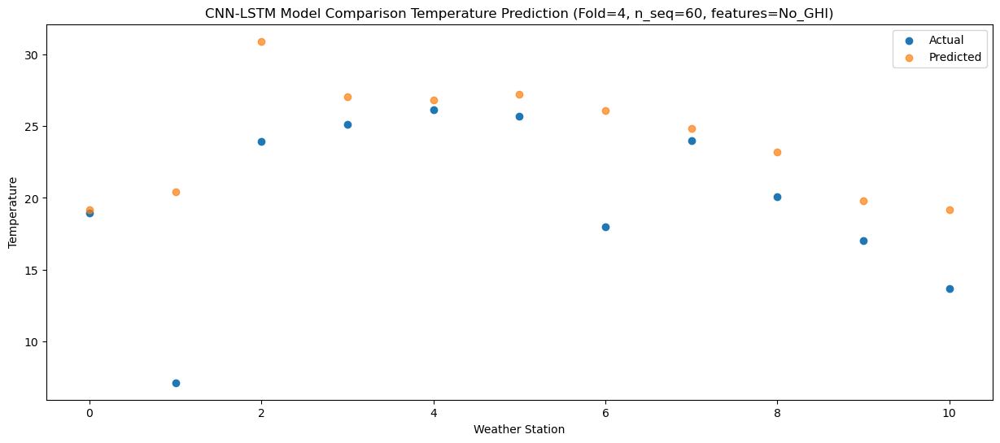

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  18.391556
1                 1    7.08  19.661550
2                 2   22.41  30.151546
3                 3   22.39  26.261554
4                 4   23.28  26.081548
5                 5   22.40  26.461550
6                 6   16.46  25.331555
7                 7   20.47  24.091550
8                 8   17.85  22.411552
9                 9   15.75  19.031557
10               10   12.59  18.391544


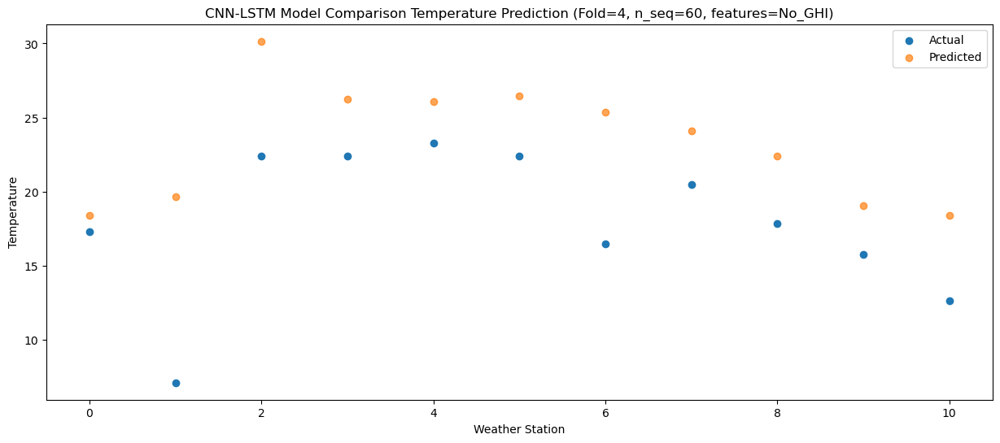

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39  14.609630
1                 1    5.64  15.879625
2                 2   20.34  26.369620
3                 3   18.96  22.479628
4                 4   19.19  22.299622
5                 5   19.50  22.679624
6                 6   13.37  21.549629
7                 7   16.88  20.309624
8                 8   13.94  18.629625
9                 9   11.61  15.249630
10               10    8.54  14.609618


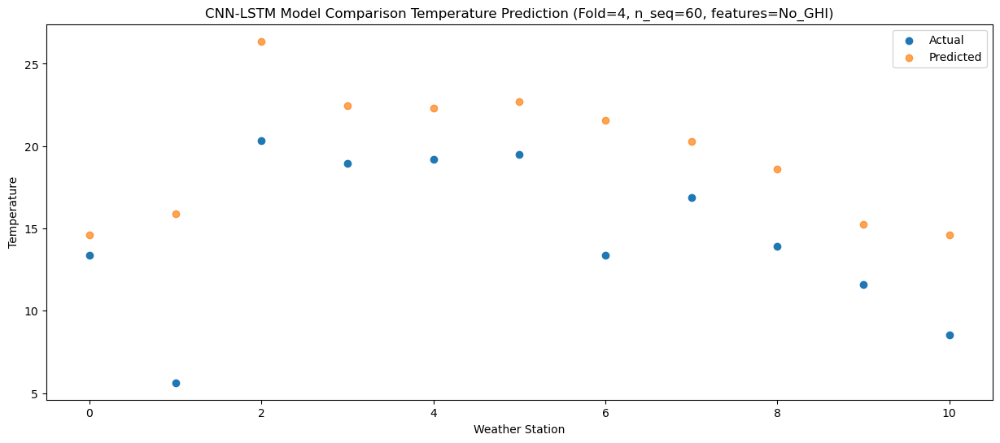

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   7.715542
1                 1    1.81   8.985538
2                 2   14.21  19.475533
3                 3   12.09  15.585540
4                 4   12.04  15.405535
5                 5   12.69  15.785536
6                 6    6.50  14.655542
7                 7   10.51  13.415536
8                 8    6.45  11.735538
9                 9    4.14   8.355542
10               10    1.68   7.715531


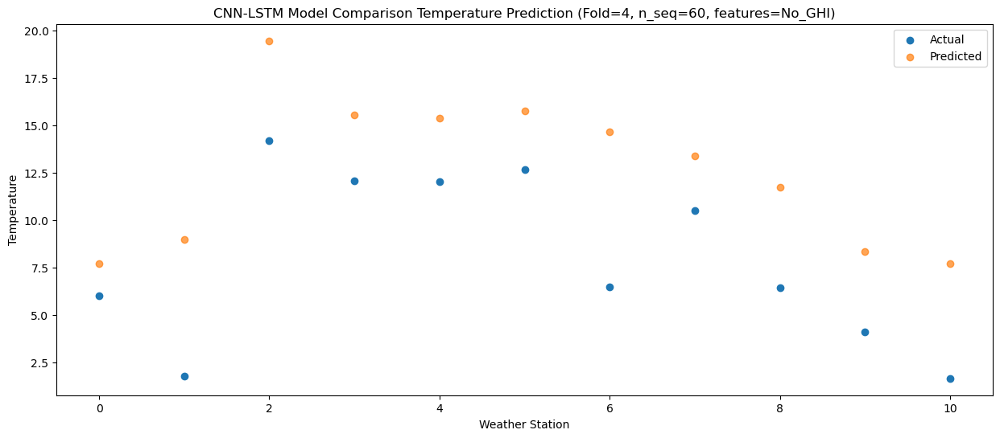

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29   3.037290
1                 1    0.35   4.307285
2                 2    9.62  14.797280
3                 3    5.04  10.907287
4                 4    4.95  10.727282
5                 5    4.84  11.107284
6                 6    3.80   9.977289
7                 7    3.96   8.737284
8                 8    0.66   7.057284
9                 9   -1.40   3.677290
10               10   -2.40   3.037278


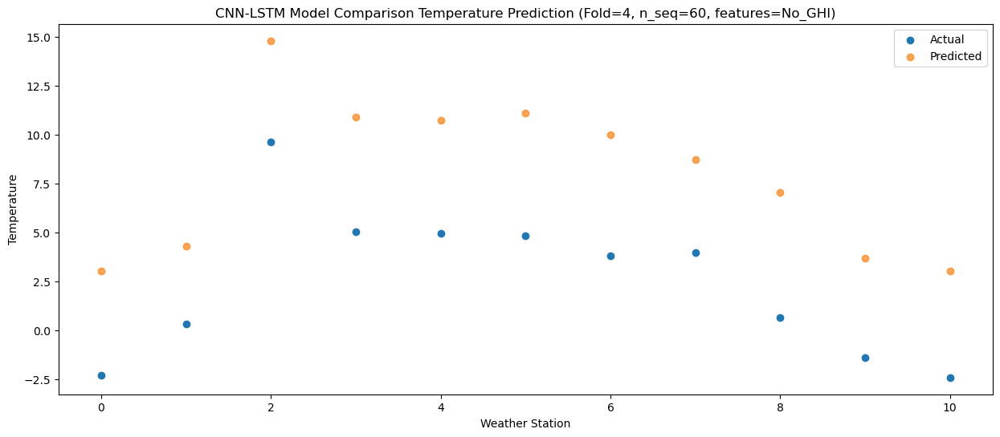

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -2.006114
1                 1   -4.50  -0.736118
2                 2    7.19   9.753877
3                 3    2.35   5.863884
4                 4    1.98   5.683879
5                 5    3.24   6.063881
6                 6   -2.15   4.933886
7                 7   -0.89   3.693882
8                 8   -5.12   2.013881
9                 9   -8.13  -1.366113
10               10   -9.11  -2.006125


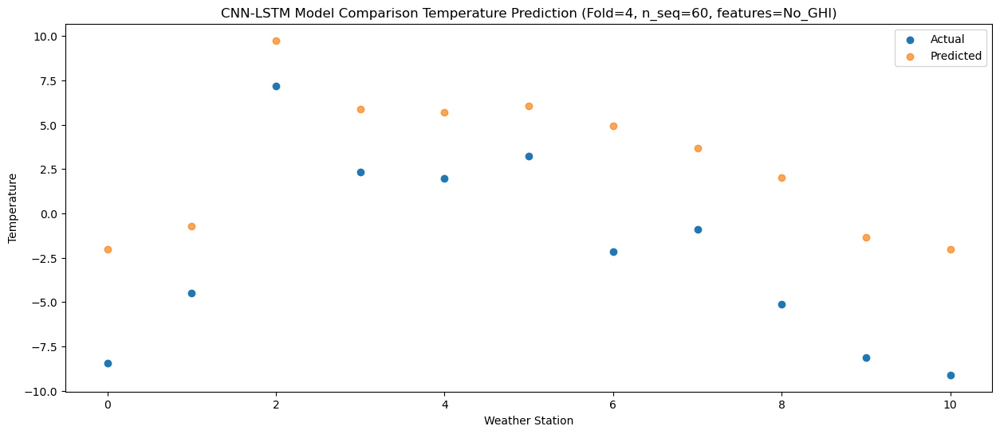

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -0.223922
1                 1   -4.65   1.046074
2                 2    7.60  11.536069
3                 3    3.34   7.646076
4                 4    2.75   7.466071
5                 5    3.61   7.846072
6                 6    0.87   6.716078
7                 7    0.76   5.476073
8                 8   -3.16   3.796073
9                 9   -5.89   0.416078
10               10   -7.48  -0.223933


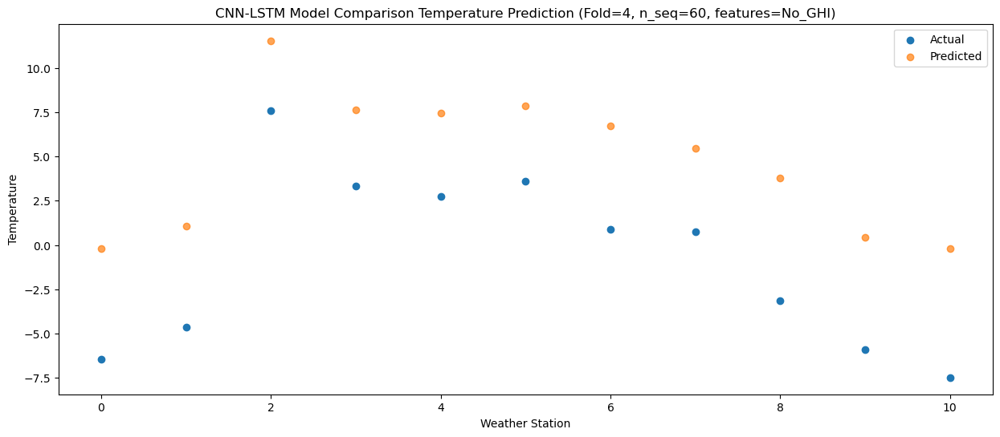

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72   0.114791
1                 1   -1.35   1.384786
2                 2    9.54  11.874781
3                 3    3.40   7.984789
4                 4    2.98   7.804783
5                 5    3.78   8.184785
6                 6    4.29   7.054790
7                 7    2.90   5.814786
8                 8   -1.57   4.134785
9                 9   -4.70   0.754791
10               10   -7.34   0.114779


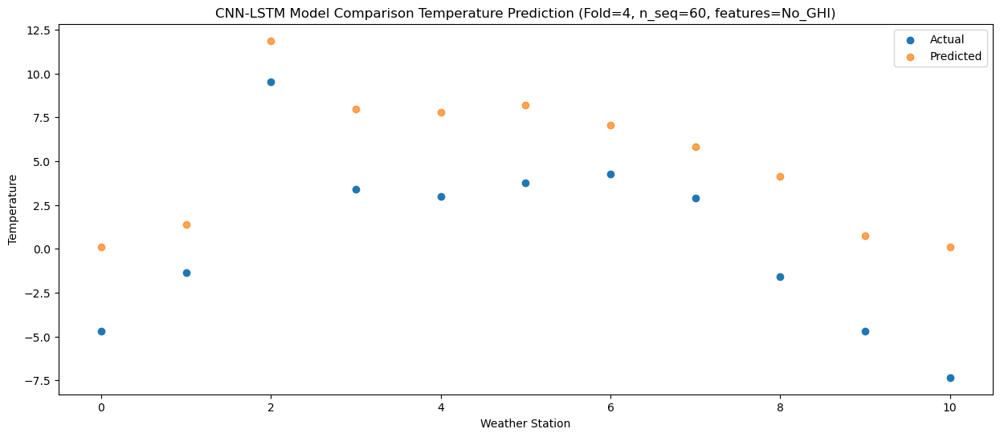

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54   2.543891
1                 1    0.37   3.813887
2                 2   11.69  14.303882
3                 3    7.93  10.413889
4                 4    7.83  10.233884
5                 5    8.85  10.613885
6                 6    4.77   9.483891
7                 7    4.62   8.243886
8                 8   -0.30   6.563884
9                 9   -2.16   3.183891
10               10   -6.46   2.543880


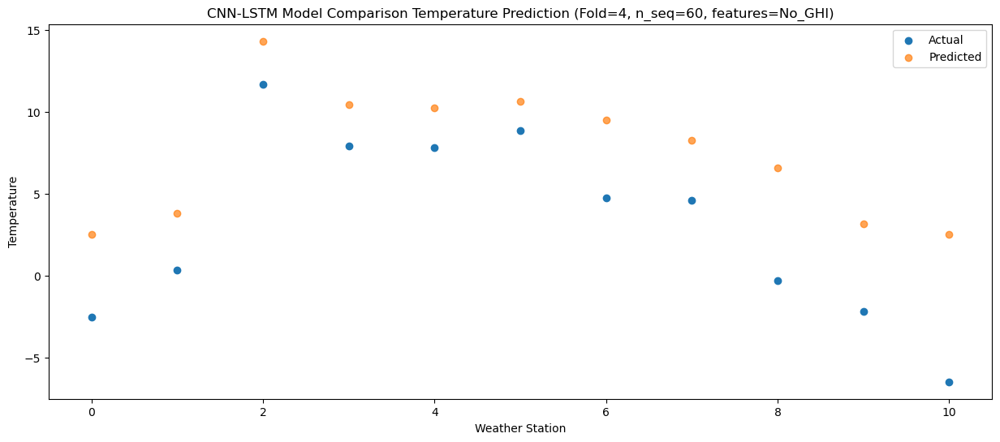

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   8.023402
1                 1    3.09   9.293398
2                 2   13.44  19.783391
3                 3   10.53  15.893401
4                 4   10.48  15.713395
5                 5   13.07  16.093395
6                 6    7.88  14.963400
7                 7   10.24  13.723398
8                 8    6.20  12.043395
9                 9    5.17   8.663401
10               10    2.01   8.023391


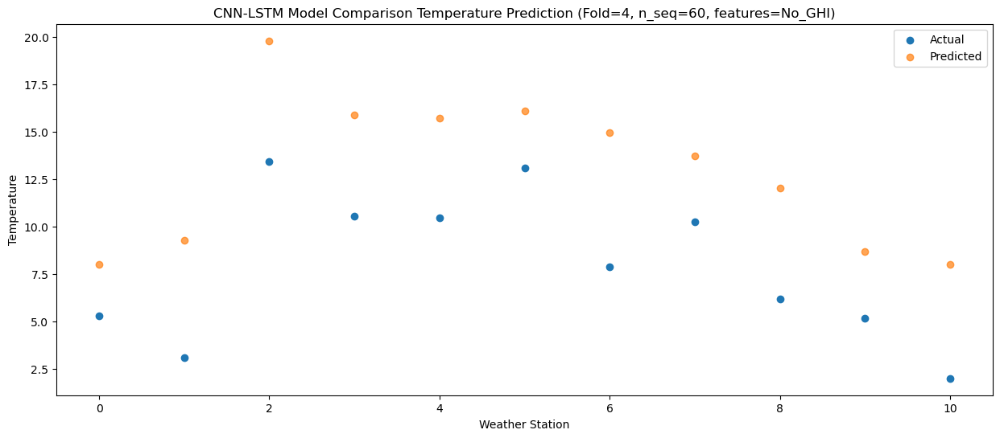

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10  12.138549
1                 1    3.87  13.408547
2                 2   18.30  23.898540
3                 3   16.21  20.008548
4                 4   16.64  19.828542
5                 5   17.99  20.208544
6                 6   10.50  19.078549
7                 7   15.02  17.838545
8                 8   11.91  16.158542
9                 9   10.93  12.778548
10               10    5.70  12.138538


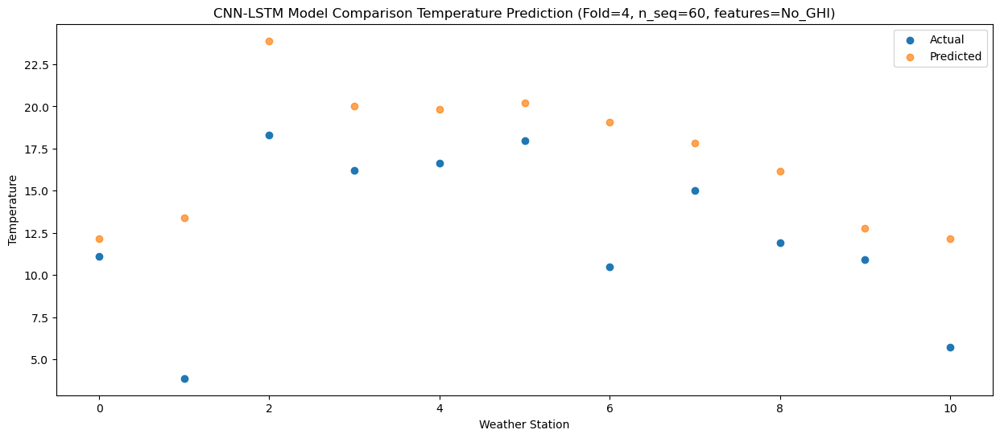

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  16.498226
1                 1    6.08  17.768224
2                 2   21.89  28.258217
3                 3   20.40  24.368224
4                 4   21.75  24.188219
5                 5   24.47  24.568221
6                 6   14.14  23.438226
7                 7   19.10  22.198222
8                 8   15.79  20.518219
9                 9   15.24  17.138222
10               10   10.01  16.498215


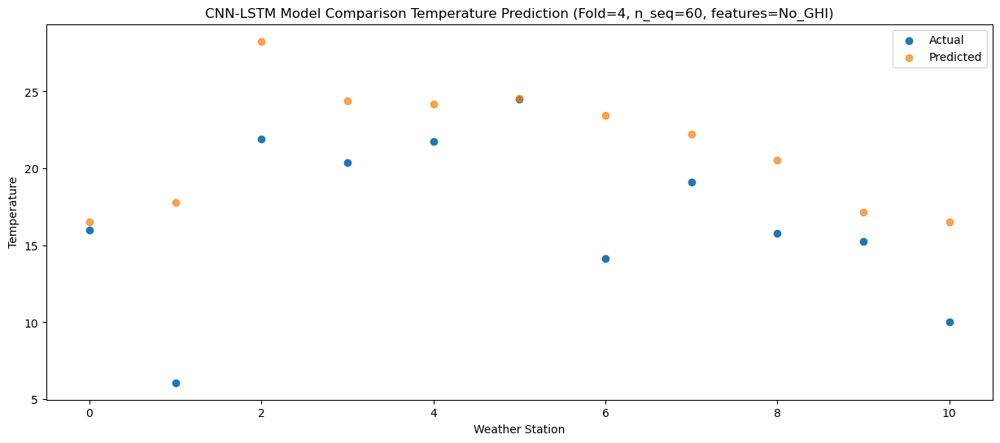

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  20.742409
1                 1    7.69  22.012406
2                 2   23.67  32.502399
3                 3   22.95  28.612407
4                 4   24.83  28.432401
5                 5   25.93  28.812403
6                 6   18.01  27.682408
7                 7   21.06  26.442402
8                 8   18.52  24.762400
9                 9   16.77  21.382405
10               10   13.10  20.742397


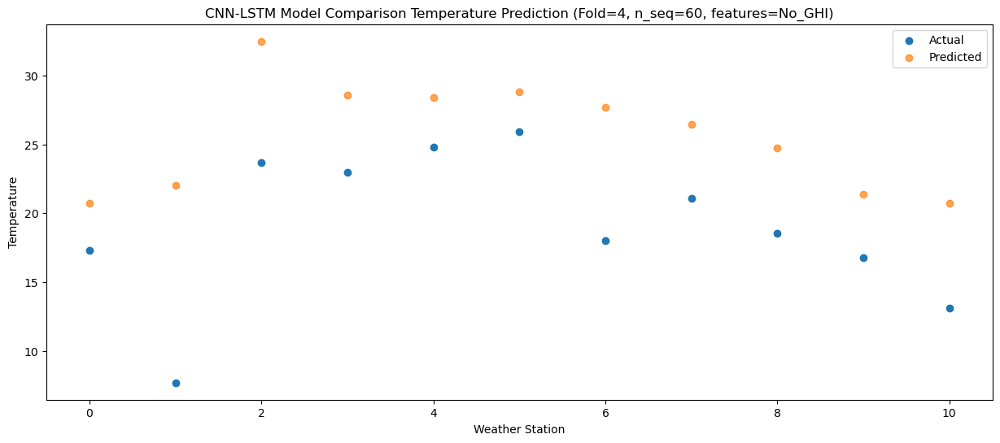

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  20.017489
1                 1    8.20  21.287486
2                 2   25.75  31.777477
3                 3   25.50  27.887486
4                 4   26.70  27.707480
5                 5   26.02  28.087481
6                 6   17.45  26.957487
7                 7   20.87  25.717481
8                 8   17.36  24.037478
9                 9   15.51  20.657485
10               10   11.77  20.017476


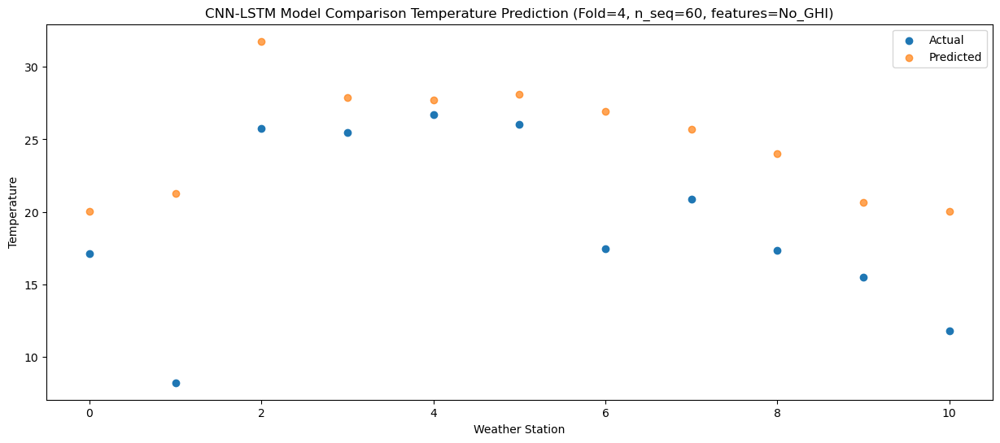

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29  17.020407
1                 1    6.10  18.290402
2                 2   22.00  28.780395
3                 3   20.80  24.890403
4                 4   21.61  24.710398
5                 5   22.54  25.090398
6                 6   13.61  23.960404
7                 7   16.93  22.720398
8                 8   14.27  21.040396
9                 9   12.47  17.660403
10               10    9.43  17.020394


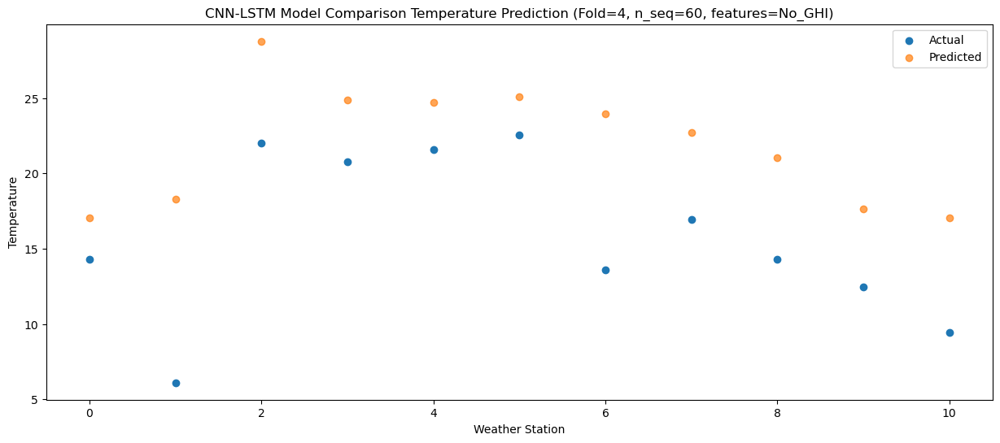

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17  11.205375
1                 1    2.45  12.475370
2                 2   15.89  22.965362
3                 3   12.67  19.075372
4                 4   12.78  18.895366
5                 5   14.01  19.275366
6                 6    8.17  18.145372
7                 7   11.03  16.905366
8                 8    8.13  15.225364
9                 9    6.06  11.845371
10               10    4.17  11.205362


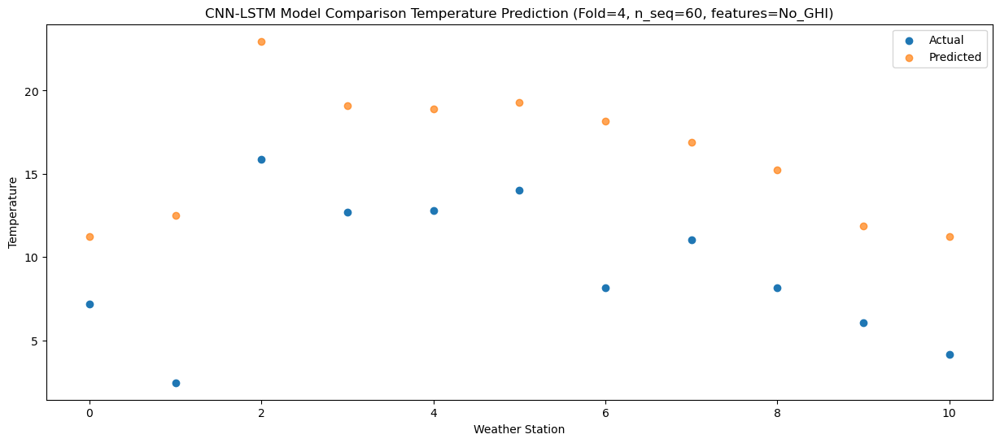

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92   4.105422
1                 1   -1.26   5.375416
2                 2    8.93  15.865408
3                 3    6.60  11.975419
4                 4    6.25  11.795412
5                 5    7.30  12.175413
6                 6    2.44  11.045419
7                 7    5.13   9.805413
8                 8    1.06   8.125411
9                 9   -1.03   4.745418
10               10   -3.22   4.105409


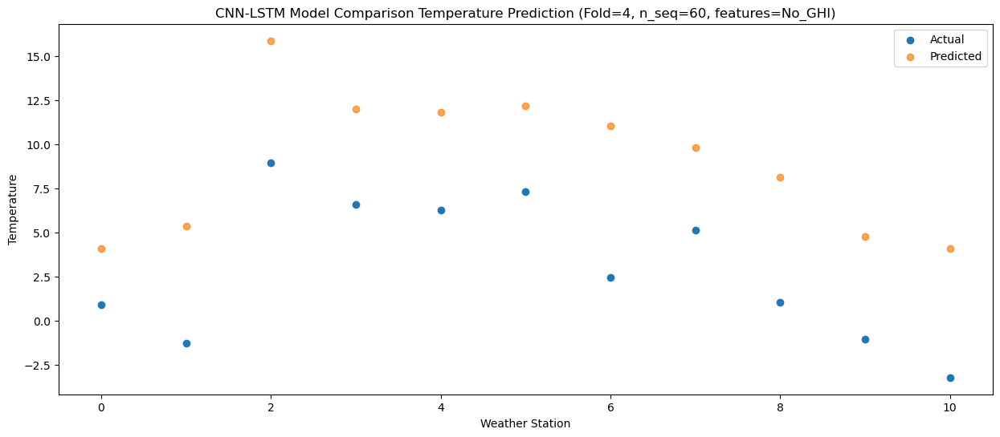

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48   2.359070
1                 1   -3.38   3.629067
2                 2    6.38  14.119059
3                 3    3.58  10.229068
4                 4    3.12  10.049062
5                 5    4.50  10.429064
6                 6    0.23   9.299069
7                 7    2.25   8.059062
8                 8   -0.83   6.379058
9                 9   -3.02   2.999067
10               10   -3.88   2.359057


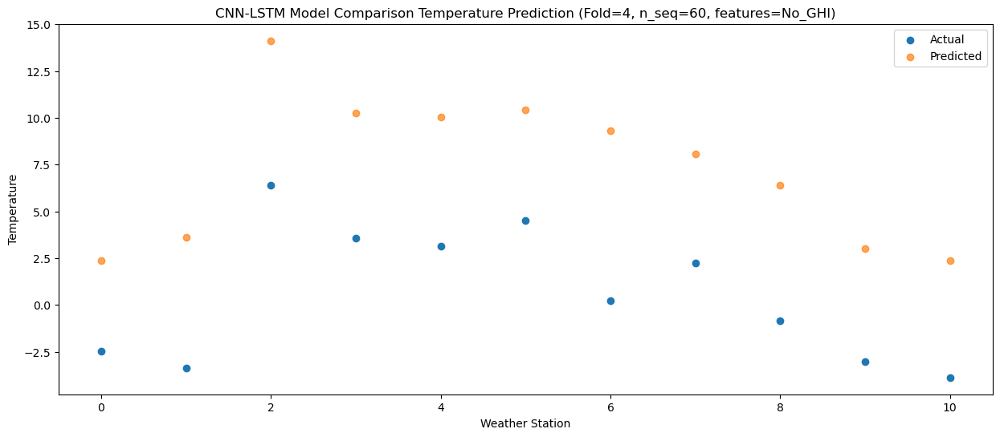

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07  -1.629502
1                 1   -4.80  -0.359504
2                 2    2.19  10.130488
3                 3   -1.94   6.240497
4                 4   -2.23   6.060492
5                 5    0.25   6.440492
6                 6   -2.21   5.310498
7                 7   -4.91   4.070491
8                 8   -7.11   2.390487
9                 9  -10.60  -0.989505
10               10   -9.65  -1.629514


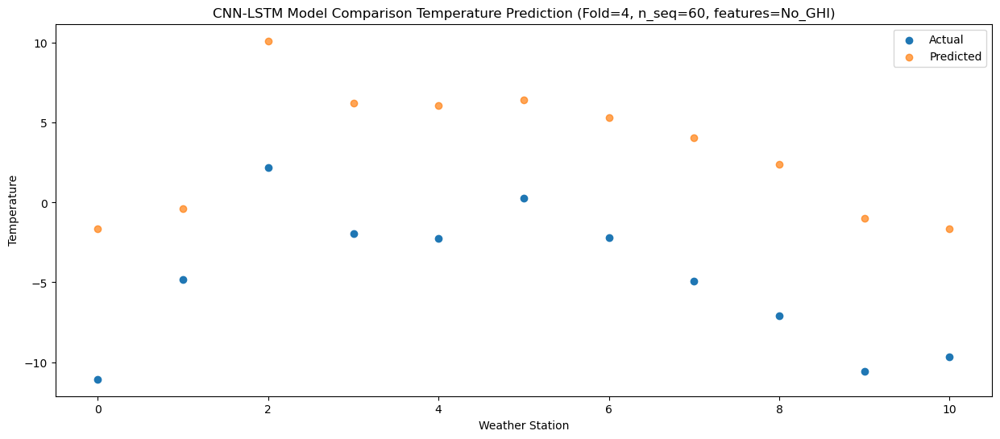

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04   2.631928
1                 1   -5.07   3.901930
2                 2    8.51  14.391922
3                 3    6.47  10.501931
4                 4    6.09  10.321926
5                 5    7.07  10.701927
6                 6    1.20   9.571932
7                 7    5.00   8.331925
8                 8   -0.77   6.651921
9                 9   -2.83   3.271925
10               10   -6.17   2.631918


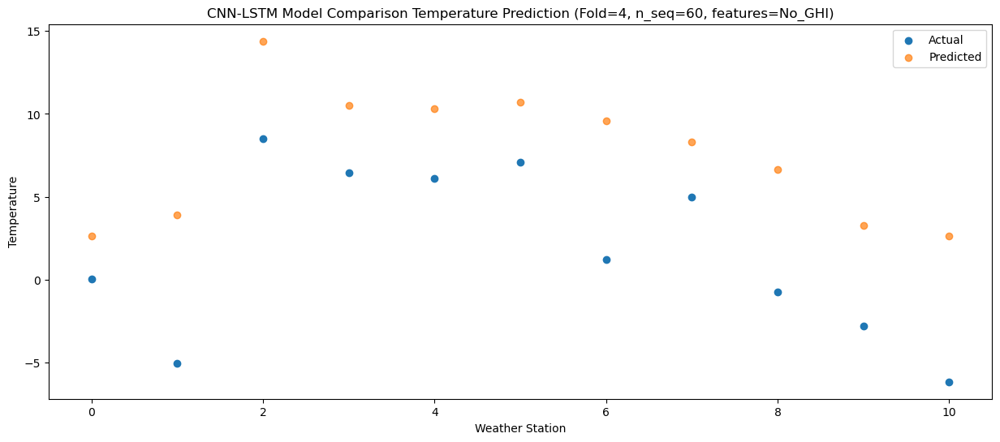

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57   6.426352
1                 1   -0.17   7.696356
2                 2   10.74  18.186348
3                 3    8.88  14.296357
4                 4    8.66  14.116352
5                 5    9.67  14.496352
6                 6    4.99  13.366358
7                 7    7.43  12.126351
8                 8    3.67  10.446347
9                 9    1.32   7.066349
10               10   -2.82   6.426344


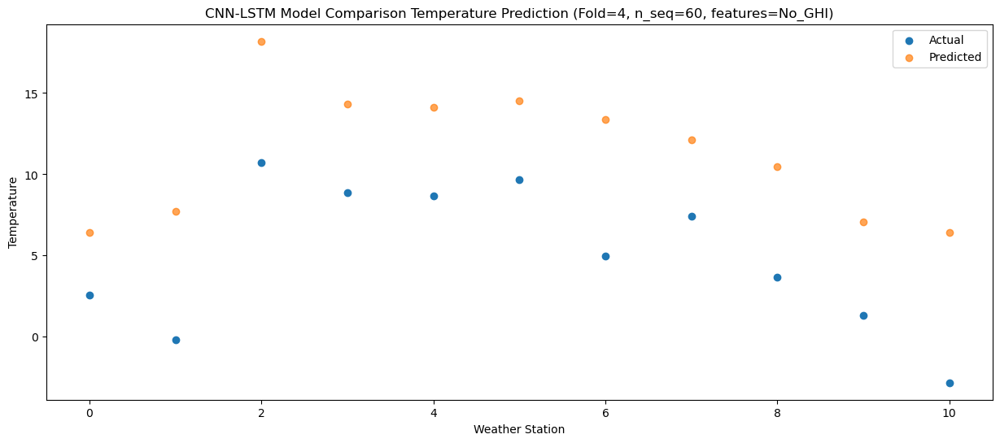

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19  10.621238
1                 1    0.88  11.891244
2                 2   14.56  22.381236
3                 3   12.73  18.491242
4                 4   12.71  18.311238
5                 5   14.63  18.691241
6                 6    9.22  17.561246
7                 7   11.57  16.321237
8                 8    8.25  14.641233
9                 9    5.81  11.261235
10               10    2.90  10.621230


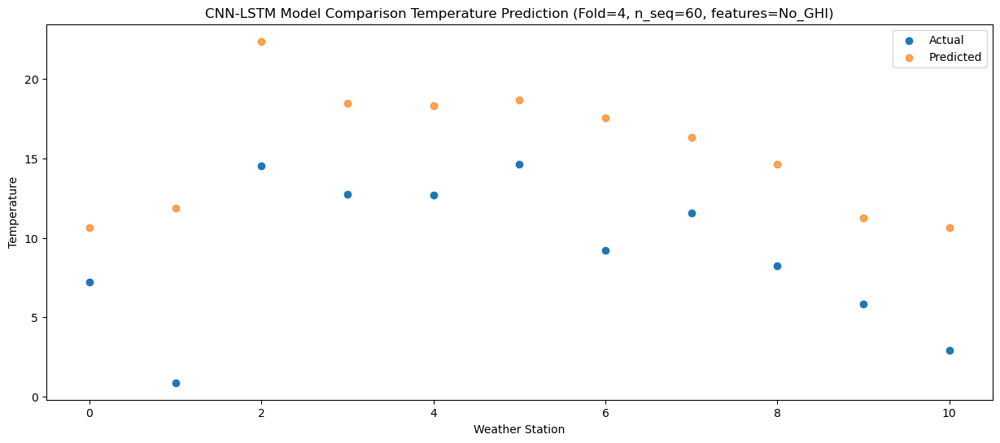

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20  15.975303
1                 1    6.33  17.245309
2                 2   20.08  27.735301
3                 3   17.49  23.845308
4                 4   17.51  23.665303
5                 5   19.92  24.045308
6                 6   13.29  22.915311
7                 7   16.22  21.675302
8                 8   14.85  19.995298
9                 9   12.84  16.615300
10               10    9.00  15.975297


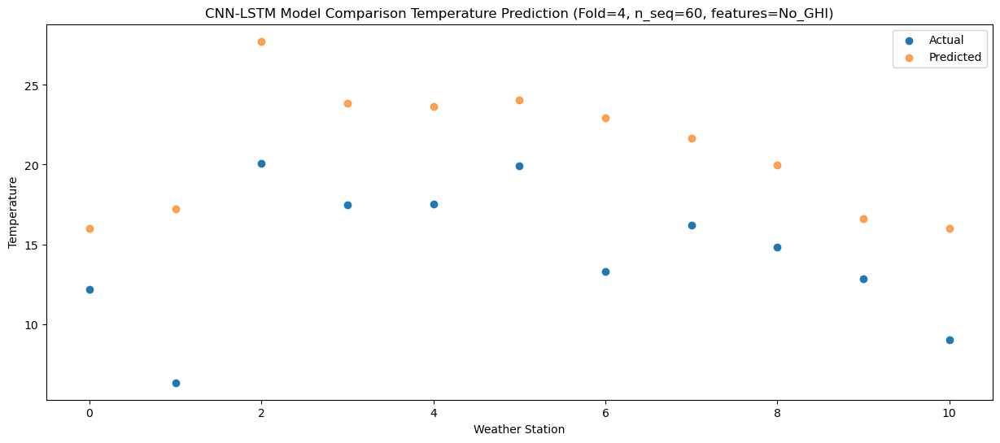

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  21.144101
1                 1    6.98  22.414102
2                 2   22.71  32.904094
3                 3   21.52  29.014104
4                 4   21.96  28.834098
5                 5   23.93  29.214101
6                 6   16.71  28.084105
7                 7   19.94  26.844095
8                 8   18.21  25.164096
9                 9   16.81  21.784095
10               10   12.16  21.144090


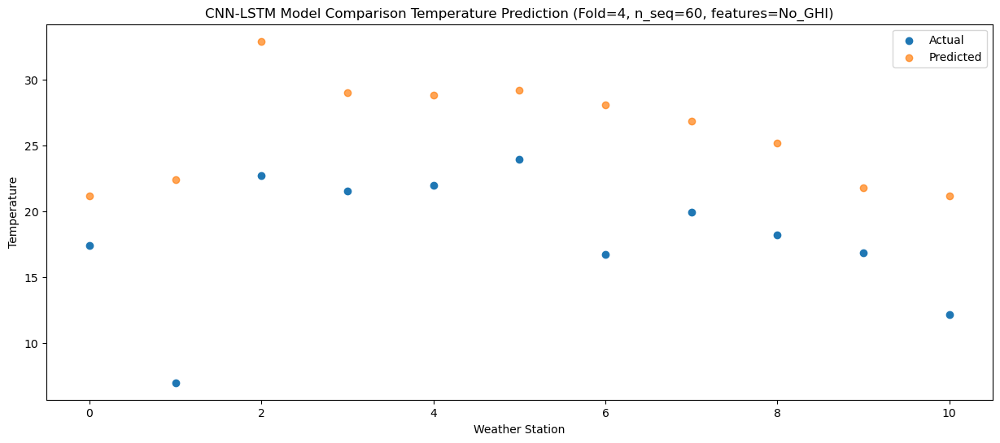

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  22.807062
1                 1    7.67  24.077062
2                 2   23.73  34.567056
3                 3   22.42  30.677065
4                 4   22.67  30.497060
5                 5   22.76  30.877063
6                 6   18.17  29.747064
7                 7   20.24  28.507057
8                 8   18.22  26.827057
9                 9   15.84  23.447057
10               10   13.68  22.807050


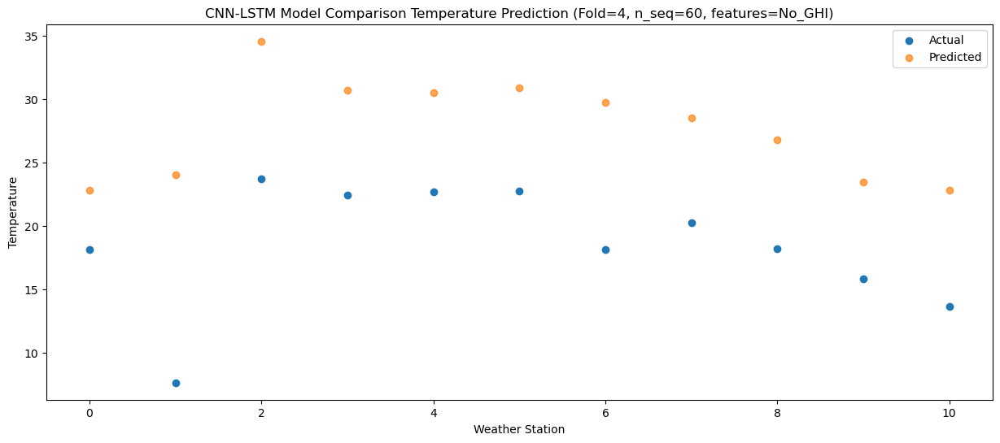

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  22.163189
1                 1    7.37  23.433191
2                 2   24.30  33.923183
3                 3   24.17  30.033192
4                 4   24.63  29.853186
5                 5   25.22  30.233189
6                 6   17.01  29.103191
7                 7   20.68  27.863183
8                 8   18.14  26.183184
9                 9   15.50  22.803184
10               10   12.54  22.163177


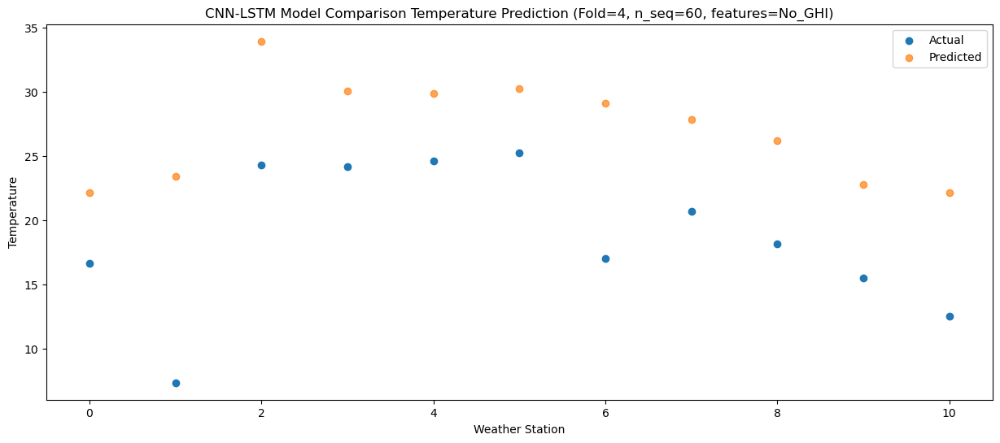

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23  18.677330
1                 1    6.50  19.947332
2                 2   20.69  30.437324
3                 3   18.78  26.547333
4                 4   18.62  26.367328
5                 5   18.77  26.747331
6                 6   14.57  25.617332
7                 7   16.54  24.377324
8                 8   15.53  22.697325
9                 9   12.27  19.317324
10               10   10.27  18.677318


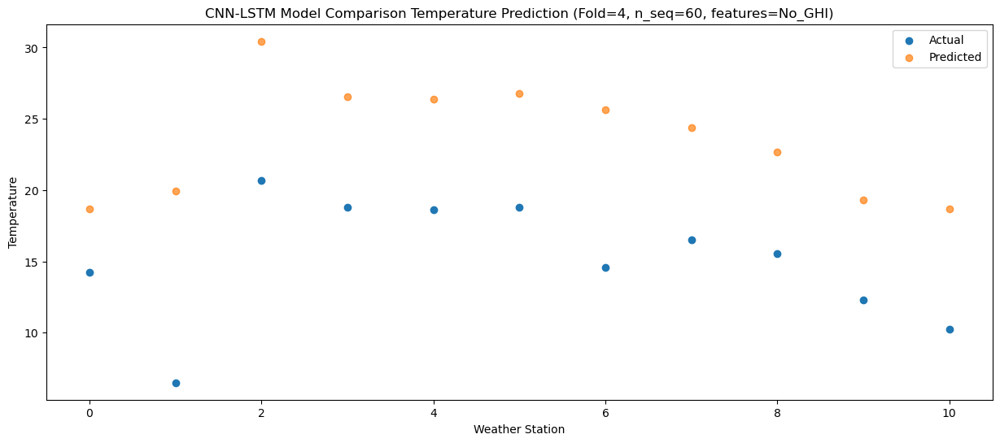

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10  13.893728
1                 1    2.73  15.163728
2                 2   16.55  25.653721
3                 3   16.03  21.763730
4                 4   16.20  21.583725
5                 5   17.06  21.963728
6                 6    8.95  20.833729
7                 7   12.86  19.593720
8                 8    9.60  17.913722
9                 9    7.20  14.533721
10               10    3.80  13.893715


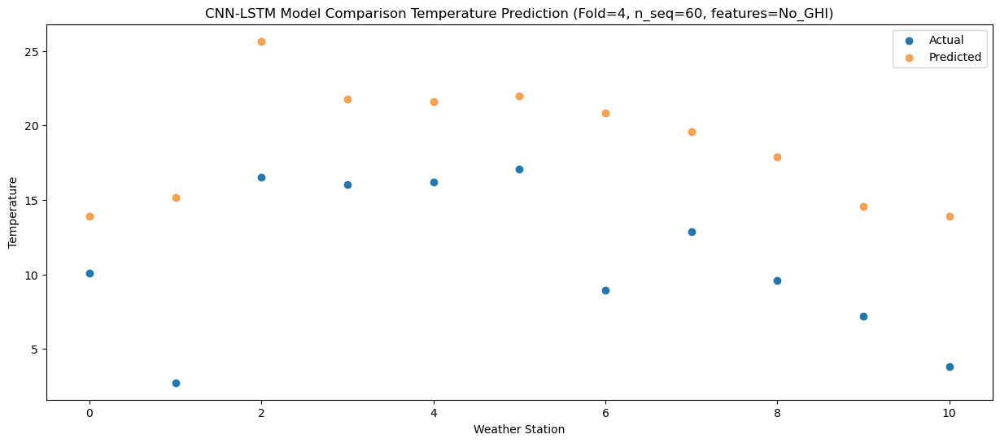

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

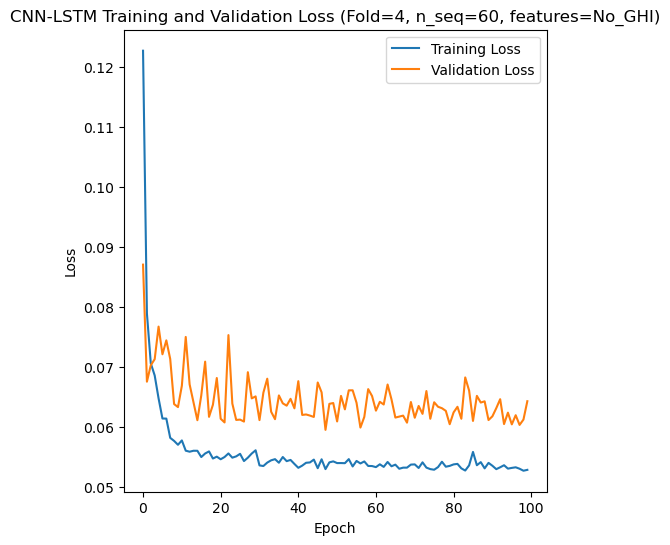

[[5.691122851209989], [3.387154008453731], [6.5664492650054855], [11.389447502881321], [5.0376062569361375]]
[[array(5.69112285)], [array(3.38715401)], [array(6.56644927)], [array(11.3894475)], [array(5.03760626)]]
[[4.775239343336135], [2.6653922620849175], [5.4096517394157955], [9.77690361896105], [4.002713863486593]]
[[2.2114712188071115], [1.0153591544670642], [2.032315058718301], [6.155785510601464], [1.2133190835870606]]
[[0.4796513614538227], [0.8223734091224271], [0.39383904622219135], [-0.47717987286828123], [0.6940097635820357]]
[[array(-0.0155991)], [array(0.11817092)], [array(0.22627867)], [array(2.86102023)], [array(0.35405361)]]
[[array(0.83969501)], [array(0.88460112)], [array(0.81878888)], [array(0.62847967)], [array(0.86614201)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-3.37138458 -4.67481097 -5.89856871 ... 22.16317659 18.67731791
 13.8937152 ]
Accuracy Results:
RMSE for each fold:
[[5.691122851209989], [3.387154008453731], [6.5664492650054855], [11.389447502881321

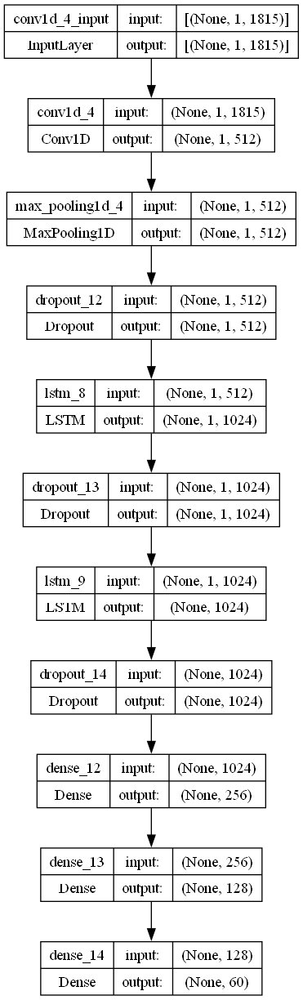

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 512
    lr = 0.0012821726838092452
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 1024
    dropout_rate = 0.15053071753197886

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_GHI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_GHI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)